## Analyzing all data together

In [5]:
import matplotlib.pyplot as plt
import xarray as xr
import numpy as np

import hvplot.xarray


import cartopy.crs as crs

import pandas as pd
import geopandas as gpd
import glob
import hvplot.pandas  # noqa
from datetime import timedelta
from datetime import datetime
import scipy.io

import scipy.signal
from random import random
import cmocean
from natsort import natsorted

Trying the daily SST fronts product...
    
https://coastwatch.noaa.gov/erddap/griddap/noaacwLEOACSPOSSTL3SCDaily.nc?sea_surface_temperature%5B(2020-09-15T12:00:00Z):1:(2022-05-15T12:00:00Z)%5D%5B(37.6):1:(34.2)%5D%5B(-76.6):1:(-73.0)%5D

In [16]:
data_src='data/'

pull in GOES data for this full two year period via

http://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2020-09-01):1:(2022-04-15T13:00:00Z)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

Had to split it into two downloads to finish without error:

http://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2020-09-01):1:(2021-06-15T13:00:00Z)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

http://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2021-06-15T14:00:00Z):1:(2022-04-15T13:00:00Z)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

this finall worked

from https://www.ncei.noaa.gov/access/metadata/landing-page/bin/iso?id=gov.noaa.nodc:GHRSST-ABI_G16-STAR-L3C

https://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2020-09-01):1:(2021-01-01T13:00:00Z)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

https://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2021-01-01T13:00:00Z):1:(2021-04-01T13:00:00Z)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

https://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2021-04-01):1:(2021-07-15)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

https://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2021-07-15):1:(2021-10-15)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

https://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2021-10-15):1:(2022-01-01)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

https://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2022-01-15):1:(2022-03-15)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D

https://coastwatch.pfeg.noaa.gov/erddap/griddap/jplStarG16SSTv270.nc?sea_surface_temperature%5B(2022-03-15):1:(2022-05-15)%5D%5B(37.5):1:(34.2)%5D%5B(-76.6):1:(-72.99)%5D


In [2]:
# fns = glob.glob(data_src+'all_goes/*.nc')
# goes_ds = xr.open_dataset(fns[0])

# for fn in fns[1:]:
#     new_ds = xr.open_dataset(fn)
#     goes_ds = xr.concat([goes_ds,new_ds],dim='time')
#     goes_ds = goes_ds.mean(dim='time')
#     break

# 

In [1]:
# # datetimeindex = goes_ds.indexes['time'].to_datetimeindex()  
# # goes_ds['time'] = datetimeindex
# goes_ds = goes_ds.sortby('time')
# goes_ds

Make the study area overview figure

In [11]:
sst_ds = xr.open_zarr('data/sst.zarr')
sst_ds

<xarray.Dataset>
Dimensions:       (lat: 360, lon: 320, time: 1089)
Coordinates:
  * lat           (lat) float32 26.02 26.08 26.12 26.17 ... 43.88 43.92 43.97
  * lon           (lon) float32 -81.97 -81.93 -81.88 ... -66.12 -66.07 -66.03
  * time          (time) datetime64[ns] 2017-01-01T12:00:00 ... 2019-12-31T12...
Data variables:
    analysed_sst  (time, lat, lon) float32 dask.array<chunksize=(200, 360, 320), meta=np.ndarray>
Attributes: (12/47)
    Conventions:                CF-1.4, Unidata Observation Dataset v1.0
    Metadata_Conventions:       Unidata Observation Dataset v1.0
    acknowledgment:             NOAA/NESDIS
    cdm_data_type:              grid
    comment:                    The Geo-Polar Blended Sea Surface Temperature...
    creator_email:              john.sapper@noaa.gov
    ...                         ...
    summary:                    An SST estimation scheme which combines multi...
    time_coverage_end:          20191231T000000Z
    time_coverage_start:        20191230T000000Z
    title:                      Analysed blended sea surface temperature over...
    uuid:                       ce60c901-9989-40f1-8457-b4963ceb55b0
    westernmost_longitude:      -180.0

In [12]:
sst_ds_mean = sst_ds.mean(dim='time')

In [27]:
bathy_ds = xr.open_dataset('data/gebco_2020_n44.0_s26.0_w-82.0_e-66.0.nc')

In [6]:
! pip install geopy

  Using cached geopy-2.3.0-py3-none-any.whl (119 kB)
  Using cached geographiclib-2.0-py3-none-any.whl (40 kB)


In [73]:
from geopy import distance

adcp_gdf_list = []
for idx,fn in enumerate(filenames):
        if idx in [0,1,2,3,37]:
            continue
#         if idx not in archetype_idxs:
        print(idx)
        print(fn)
#         print(archetype_titles[idx_counter])

#     try:
        
        dist = scipy.io.loadmat(fn+'_distance.mat')['distance']
        sst = scipy.io.loadmat(fn+'_SST.mat')['SST']
        time = scipy.io.loadmat(fn+'_time.mat')['time']
        timestamps = pd.to_datetime(time[0,:]-719529, unit='D')

        X = scipy.io.loadmat(fn+'_X.mat')['X']
        Y = scipy.io.loadmat(fn+'_Y.mat')['Y']
        lat = scipy.io.loadmat(fn+'_lat.mat')['lat']
        long = scipy.io.loadmat(fn+'_long.mat')['long']

        # the distances are crazy wrong sometimes so re-calcuating the distance
        coords_1 = (lat[0], long[0])
        distances = []
        for i in range(len(lat)):
            coords_2 = (lat[i], long[i])
            distances.append(distance.geodesic(coords_1, coords_2).meters)
        dist = np.array(distances)       
    #         bogus_dist_locations = dist > 35000        
    #         dist[dist > 25000] = np.nan
    #         dist = pd.Series(dist).interpolate().values
        # checking if the current point is within 500 of one that was good, assuming the first point is good
        # then if not setting it to nan and interpolating it out
        last_good_idx = 0
        bad_idxs = []
        for di,d in enumerate(dist):
            if dist[di] - dist[last_good_idx] < 500:
                last_good_idx = di
            else:
                bad_idxs.append(di)
        dist[bad_idxs] = np.nan
        dist = pd.Series(dist).interpolate().values

        dist = dist.reshape(-1,1)

        adcp_df = pd.DataFrame({'dt':timestamps,
                        'datetime':timestamps,
                                'sst':sst[:,0],
                       'lat': lat[:,0],
                       'lon':long[:,0],
                               'dist':dist[:,0]})

        adcp_df = adcp_df.set_index('dt')
        adcp_df = adcp_df.sort_index(ascending=True)
        
        adcp_gdf = gpd.GeoDataFrame(
            adcp_df, geometry=gpd.points_from_xy(adcp_df.lon, adcp_df.lat))
        adcp_gdf_list.append(adcp_gdf)

4
data/all_adcp/processed/101706_20201010T132417UTC_100s
5
data/all_adcp/processed/101706_20201010T141504UTC_100s
6
data/all_adcp/processed/101706_20201011T135347UTC_100s
7
data/all_adcp/processed/101706_20201015T142907UTC_100s
8
data/all_adcp/processed/101706_20201015T164414UTC_100s
9
data/all_adcp/processed/101706_20201016T130156UTC_100s
10
data/all_adcp/processed/101706_20201016T161245UTC_100s
11
data/all_adcp/processed/101706_20201020T131543UTC_100s
12
data/all_adcp/processed/101706_20201020T133400UTC_100s
13
data/all_adcp/processed/101706_20201020T155242UTC_100s
14
data/all_adcp/processed/101706_20210414T131027UTC_100s
15
data/all_adcp/processed/101706_20210414T155313UTC_100s
16
data/all_adcp/processed/101706_20210420T123333UTC_100s
17
data/all_adcp/processed/101706_20210420T151905UTC_100s
18
data/all_adcp/processed/101706_20210421T123205UTC_100s
19
data/all_adcp/processed/101706_20210421T150145UTC_100s
20
data/all_adcp/processed/101706_20210427T122655UTC_100s
21
data/all_adcp/pro

In [74]:
full_adcp_gdf = pd.concat(adcp_gdf_list)

In [7]:
plt.rcParams.update({'font.size': 16})

/srv/conda/envs/notebook/lib/python3.8/site-packages/dask/array/numpy_compat.py:39: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)
/srv/conda/envs/notebook/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:324: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/srv/conda/envs/notebook/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:348: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/srv/conda/envs/notebook/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:360: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '


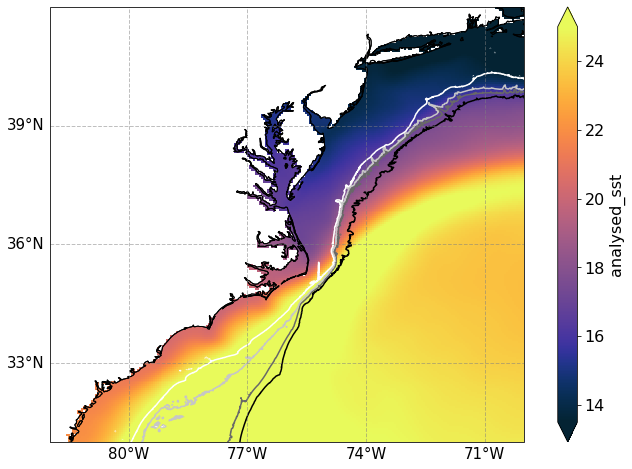

In [85]:
import matplotlib.patches as patches
from matplotlib import colors
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import cartopy.crs as ccrs

from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

fig, ax = plt.subplots(figsize=(12,8), subplot_kw=dict(projection=crs.PlateCarree()))
ax.coastlines(resolution='10m')

vmin=25
vmax=13.5

(sst_ds_mean.analysed_sst-273.15).plot(ax=ax,x='lon', y='lat', cmap=cmocean.cm.thermal, vmin=vmin, vmax=vmax, add_colorbar=True)

# station_gdf.plot(ax=ax,markersize=15, color='pink', alpha=.8)



ax.coastlines(resolution='10m')
ax.set_xlim(-82,-70)
ax.set_ylim(31,42)
ax.set_title("")

gl = ax.gridlines(crs=crs.PlateCarree(), draw_labels=True,
              linewidth=1, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top = False
gl.ylabels_left = True
gl.ylabels_right = False
# gl.xlines = False
gl.xlocator = mticker.FixedLocator([-80,-77,-74,-71])
gl.ylocator = mticker.FixedLocator([33,36,39])
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'black'}
gl.ylabel_style = {'size': 15, 'color': 'black'}
# plt.colorbar(im,fraction=0.046, pad=0.02)

bathy_ds.elevation[1000:4000,0:3500].plot.contour(ax=ax, center=-1000, levels=[-100,-450,-1000,-2000], cmap='Greys_r')


# fig.savefig('bathy_transects.png',dpi=400)
# ax[1].set_title(titles[i] + ' zoom')
# fig.tight_layout()
#     fig.savefig('figs/'+titles[i] +'sat_overview.png')
#     plt.close()

# fcm_gdf.plot(ax=ax, markersize=15, column='Chla_Avg', vmin=.1,vmax=.25, cmap='jet')
plt.savefig('gs_overview_study_area.png',dpi=300)
plt.show()

/srv/conda/envs/notebook/lib/python3.8/site-packages/dask/array/numpy_compat.py:39: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)
/srv/conda/envs/notebook/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:324: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/srv/conda/envs/notebook/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:348: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/srv/conda/envs/notebook/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:360: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/srv/conda/envs/notebook/lib/python3.8/site-

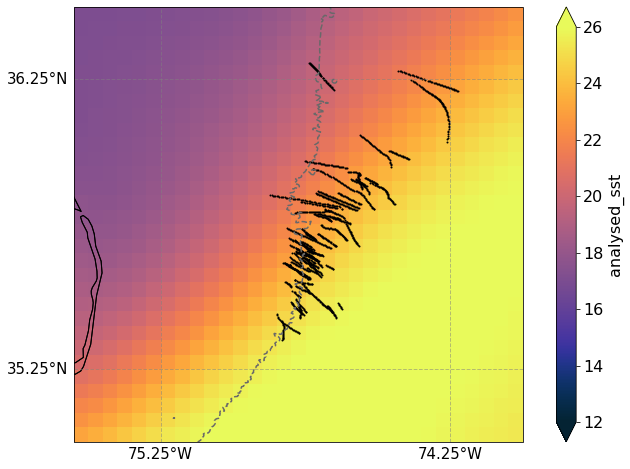

In [84]:
import matplotlib.patches as patches
from matplotlib import colors
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import cartopy.crs as ccrs

from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

fig, ax = plt.subplots(figsize=(12,8), subplot_kw=dict(projection=crs.PlateCarree()))
ax.coastlines(resolution='10m')

vmin=26
vmax=12

(sst_ds_mean.analysed_sst-273.15).plot(ax=ax,x='lon', y='lat', cmap=cmocean.cm.thermal, vmin=vmin, vmax=vmax, add_colorbar=True)

# station_gdf.plot(ax=ax,markersize=15, color='pink', alpha=.8)



ax.coastlines(resolution='10m')
ax.set_xlim(-75.55,-74)
ax.set_ylim(35,36.5)
ax.set_title("")

gl = ax.gridlines(crs=crs.PlateCarree(), draw_labels=True,
              linewidth=1, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top = False
gl.ylabels_left = True
gl.ylabels_right = False
# gl.xlines = False
gl.xlocator = mticker.FixedLocator([-75.25,-74.25])
gl.ylocator = mticker.FixedLocator([35.25,36.25])
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'black'}
gl.ylabel_style = {'size': 15, 'color': 'black'}
# plt.colorbar(im,fraction=0.046, pad=0.02)

bathy_ds.elevation[1000:4000,0:3500].plot.contour(ax=ax, levels=[-1000], cmap='dimgrey', ls='-',alpha=1)

full_adcp_gdf.iloc[::200].plot(ax=ax, markersize=1, color='black')

# fig.savefig('bathy_transects.png',dpi=400)
# ax[1].set_title(titles[i] + ' zoom')
# fig.tight_layout()
#     fig.savefig('figs/'+titles[i] +'sat_overview.png')
#     plt.close()

# fcm_gdf.plot(ax=ax, markersize=15, column='Chla_Avg', vmin=.1,vmax=.25, cmap='jet')
plt.savefig('gs_transects_zoom.png',dpi=300)
plt.show()

Yes I did print these out and individually click on them to download them

In [3]:
# url = "https://coastwatch.noaa.gov/erddap/griddap/noaacwLEOACSPOSSTL3SCDaily.nc?sea_surface_temperature%5B("
# middle_url = "T12:00:00Z):1:("
# end_url = "T12:00:00Z)%5D%5B(37.6):1:(34.2)%5D%5B(-76.6):1:(-73.0)%5D"
# for d in np.unique(datetimes):
#     date = d.strftime("%Y-%m-%d")
#     start_date = (pd.to_datetime(date)-pd.Timedelta(days=1)).strftime("%Y-%m-%d")
#     end_date = (pd.to_datetime(date)+pd.Timedelta(days=1)).strftime("%Y-%m-%d")
#     complete_url = url+start_date+middle_url+end_date+end_url
#     print(complete_url)

In [8]:
sst_files = ["noaacwLEOACSPOSSTL3SCDaily_af09_2827_c851_U1678991105072.nc",
"noaacwLEOACSPOSSTL3SCDaily_af09_2827_c851_U1678991108644.nc",
"noaacwLEOACSPOSSTL3SCDaily_628a_5c37_1153_U1678991111063.nc",
"noaacwLEOACSPOSSTL3SCDaily_628a_5c37_1153_U1678991121463.nc",
"noaacwLEOACSPOSSTL3SCDaily_abfa_8ab6_222e_U1678991123994.nc",
"noaacwLEOACSPOSSTL3SCDaily_abfa_8ab6_222e_U1678991133727.nc",
"noaacwLEOACSPOSSTL3SCDaily_4877_a342_5fbd_U1678991136272.nc",
"noaacwLEOACSPOSSTL3SCDaily_3e01_da98_cc8d_U1678991140744.nc",
"noaacwLEOACSPOSSTL3SCDaily_3e01_da98_cc8d_U1678991150930.nc",
"noaacwLEOACSPOSSTL3SCDaily_6226_8177_06a2_U1678991152920.nc",
"noaacwLEOACSPOSSTL3SCDaily_6226_8177_06a2_U1678991157450.nc",
"noaacwLEOACSPOSSTL3SCDaily_7182_c2c2_1f3c_U1678991159508.nc",
"noaacwLEOACSPOSSTL3SCDaily_7182_c2c2_1f3c_U1678991169613.nc",
"noaacwLEOACSPOSSTL3SCDaily_7182_c2c2_1f3c_U1678991171724.nc",
"noaacwLEOACSPOSSTL3SCDaily_7433_9e8d_473f_U1678991174001.nc",
"noaacwLEOACSPOSSTL3SCDaily_7433_9e8d_473f_U1678991184952.nc",
"noaacwLEOACSPOSSTL3SCDaily_1cd6_e95d_ef01_U1678991187031.nc",
"noaacwLEOACSPOSSTL3SCDaily_1cd6_e95d_ef01_U1678991197098.nc",
"noaacwLEOACSPOSSTL3SCDaily_445e_da6e_df9d_U1678991199075.nc",
"noaacwLEOACSPOSSTL3SCDaily_445e_da6e_df9d_U1678991213941.nc",
"noaacwLEOACSPOSSTL3SCDaily_1832_c7c9_ac6c_U1678991216951.nc",
"noaacwLEOACSPOSSTL3SCDaily_1832_c7c9_ac6c_U1678991227512.nc",
"noaacwLEOACSPOSSTL3SCDaily_9ef1_a4dc_22f9_U1678991229701.nc",
"noaacwLEOACSPOSSTL3SCDaily_9ef1_a4dc_22f9_U1678991241091.nc",
"noaacwLEOACSPOSSTL3SCDaily_6eef_e492_95ac_U1678991243463.nc",
"noaacwLEOACSPOSSTL3SCDaily_6eef_e492_95ac_U1678991248689.nc",
"noaacwLEOACSPOSSTL3SCDaily_70a0_1000_5443_U1678991250863.nc",
"noaacwLEOACSPOSSTL3SCDaily_70a0_1000_5443_U1678991257059.nc",
"noaacwLEOACSPOSSTL3SCDaily_25aa_d2de_3636_U1678991259078.nc",
"noaacwLEOACSPOSSTL3SCDaily_25aa_d2de_3636_U1678991283668.nc",
"noaacwLEOACSPOSSTL3SCDaily_25aa_d2de_3636_U1678991285657.nc",
"noaacwLEOACSPOSSTL3SCDaily_238a_9c04_7a4d_U1678991287526.nc",
"noaacwLEOACSPOSSTL3SCDaily_238a_9c04_7a4d_U1678991295083.nc",
"noaacwLEOACSPOSSTL3SCDaily_238a_9c04_7a4d_U1678991296726.nc",
"noaacwLEOACSPOSSTL3SCDaily_5562_29d6_7700_U1678991298443.nc",
"noaacwLEOACSPOSSTL3SCDaily_5562_29d6_7700_U1678991305596.nc",
"noaacwLEOACSPOSSTL3SCDaily_5562_29d6_7700_U1678991334187.nc",
"noaacwLEOACSPOSSTL3SCDaily_039a_7581_ee6c_U1678991336155.nc",
"noaacwLEOACSPOSSTL3SCDaily_039a_7581_ee6c_U1678991341408.nc",
"noaacwLEOACSPOSSTL3SCDaily_1878_ee15_afdf_U1678991343870.nc",
"noaacwLEOACSPOSSTL3SCDaily_eb71_5363_e357_U1678991360654.nc",
"noaacwLEOACSPOSSTL3SCDaily_eb71_5363_e357_U1678991368504.nc",
"noaacwLEOACSPOSSTL3SCDaily_6e33_5bf4_68b6_U1678991371807.nc",
"noaacwLEOACSPOSSTL3SCDaily_a5ee_32a7_23e1_U1678991379323.nc",
"noaacwLEOACSPOSSTL3SCDaily_a5ee_32a7_23e1_U1678991395923.nc",
"noaacwLEOACSPOSSTL3SCDaily_e2ac_8050_adb0_U1678991397652.nc",
"noaacwLEOACSPOSSTL3SCDaily_e2ac_8050_adb0_U1678991404454.nc",
"noaacwLEOACSPOSSTL3SCDaily_c87e_f15e_dc4d_U1678991406168.nc",
"noaacwLEOACSPOSSTL3SCDaily_1fe5_da16_7c7a_U1678991417237.nc",
"noaacwLEOACSPOSSTL3SCDaily_1fe5_da16_7c7a_U1678991428732.nc",
"noaacwLEOACSPOSSTL3SCDaily_1fe5_da16_7c7a_U1678991430336.nc",
"noaacwLEOACSPOSSTL3SCDaily_f9e1_e23d_54eb_U1678991431954.nc",
"noaacwLEOACSPOSSTL3SCDaily_f9e1_e23d_54eb_U1678991443141.nc",
"noaacwLEOACSPOSSTL3SCDaily_3609_961a_ff32_U1678991444990.nc",
"noaacwLEOACSPOSSTL3SCDaily_3609_961a_ff32_U1678991455888.nc",
"noaacwLEOACSPOSSTL3SCDaily_0b03_ff21_ab1f_U1678991457379.nc",
"noaacwLEOACSPOSSTL3SCDaily_0b03_ff21_ab1f_U1678991461756.nc",
"noaacwLEOACSPOSSTL3SCDaily_5156_254b_0c27_U1678991463497.nc",
"noaacwLEOACSPOSSTL3SCDaily_5156_254b_0c27_U1678991467415.nc",
"noaacwLEOACSPOSSTL3SCDaily_7732_ecfc_1f56_U1678991468988.nc",
"noaacwLEOACSPOSSTL3SCDaily_7732_ecfc_1f56_U1678991480183.nc",
"noaacwLEOACSPOSSTL3SCDaily_7732_ecfc_1f56_U1678991482113.nc",
"noaacwLEOACSPOSSTL3SCDaily_7732_ecfc_1f56_U1678991483751.nc",
"noaacwLEOACSPOSSTL3SCDaily_dd3b_f109_c05f_U1678991485731.nc",
"noaacwLEOACSPOSSTL3SCDaily_dd3b_f109_c05f_U1678991492883.nc",
"noaacwLEOACSPOSSTL3SCDaily_dd3b_f109_c05f_U1678991494615.nc",
"noaacwLEOACSPOSSTL3SCDaily_ba02_35a9_33ad_U1678991496419.nc",
"noaacwLEOACSPOSSTL3SCDaily_ba02_35a9_33ad_U1678991500498.nc",
"noaacwLEOACSPOSSTL3SCDaily_ba02_35a9_33ad_U1678991502915.nc",]

In [9]:
len(sst_files)

69

## Pull in Chla

In [286]:
chla_ds = xr.open_dataset("../../Downloads/CCI_ALL-v5.0-DAILY.nc")

In [287]:
chla_ds

<xarray.Dataset>
Dimensions:  (lat: 83, lon: 88, time: 487)
Coordinates:
  * time     (time) datetime64[ns] 2020-09-01 2020-09-02 ... 2021-12-31
  * lat      (lat) float64 37.6 37.56 37.52 37.48 ... 34.31 34.27 34.23 34.19
  * lon      (lon) float64 -76.6 -76.56 -76.52 -76.48 ... -73.06 -73.02 -72.98
Data variables:
    chlor_a  (time, lat, lon) float32 ...
Attributes: (12/49)
    Conventions:                       CF-1.7
    start_date:                        30-DEC-2021 00:00:00.000000
    stop_date:                         30-DEC-2021 23:59:00.000000
    Metadata_Conventions:              Unidata Dataset Discovery v1.0
    cdm_data_type:                     Grid
    comment:                           See summary attribute
    ...                                ...
    time_coverage_end:                 202112302359Z
    time_coverage_resolution:          P1D
    time_coverage_start:               202112300000Z
    title:                             ESA CCI Ocean Colour Product
    tracking_id:                       332587d5-faae-4968-a7c5-babf3626a796
    History:                           Translated to CF-1.0 Conventions by Ne...

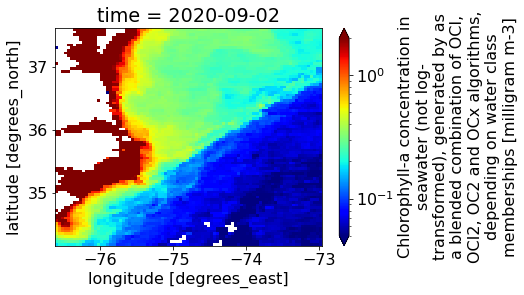

In [344]:
from matplotlib.colors import LogNorm

chla_ds.chlor_a[0].plot(cmap='jet', norm=LogNorm(vmin=0.05, vmax=2))

In [ ]:
https://coastwatch.noaa.gov/erddap/griddap/noaacwLEOACSPOSSTL3SCDaily.nc?sea_surface_temperature%5B(2021-07-01T12:00:00Z):1:(2021-12-31T12:00:00Z)%5D%5B(36.15):1:(35.12)%5D%5B(-75.3):1:(-74.2)%5D

### making the hovmoller plot

In [5]:
tmp_adcp_df = pd.read_csv("20210616adcp_gdf.csv")

In [6]:
tmp_adcp_df.lat.mean(),tmp_adcp_df.lon.mean()

(35.62640206751189, -74.73792095899017)

In [3]:
fns = ['data/all_front_sst/'+sst_files[0],'data/all_front_sst/'+sst_files[25]]

NameError: name 'sst_files' is not defined

In [4]:
sst_hov_list=[]
for fn in [
    "noaacwLEOACSPOSSTL3SCDaily_6299_1734_78b0_U1679589111149.nc",
    "noaacwLEOACSPOSSTL3SCDaily_6ce3_5b9d_959a_U1679588635585.nc",
    "noaacwLEOACSPOSSTL3SCDaily_fab5_fe3e_e8eb_U1679589251839.nc"]:
    sst_hov_list.append(xr.open_dataset('../../Downloads/'+fn))


In [98]:
sst_ds_hov = xr.concat(sst_hov_list,dim='time')

In [99]:
mid_lat = 35.626
mid_lon = -74.738
sst_lat_list = xr.DataArray(np.arange(mid_lat+.5,mid_lat-0.5,step=-0.02), dims='z')
sst_lon_list = xr.DataArray(np.arange(mid_lon-.5,mid_lon+0.5,step=0.02), dims='z')

In [100]:
sst_hov = sst_ds_hov.sel(longitude=sst_lon_list, latitude=sst_lat_list, method="nearest", tolerance=0.02)
sst_hov = sst_hov.sortby('time')

In [375]:
mid_lat = 35.626
mid_lon = -74.738
sst_lat_list = xr.DataArray(np.arange(mid_lat+.5,mid_lat-0.5,step=-0.04), dims='z')
sst_lon_list = xr.DataArray(np.arange(mid_lon-.5,mid_lon+0.5,step=0.04), dims='z')

In [376]:
chla_hov = chla_ds.sel(lon=sst_lon_list, lat=sst_lat_list, method="nearest", tolerance=0.03)

In [377]:
chla_hov = chla_hov.sortby('time')

In [11]:
import matplotlib

In [227]:
isnans_list = []
for da in sst_hov.sea_surface_temperature.sortby('time'):
    isnans_list.append(np.count_nonzero(np.isnan(da.values))>3)
#     isnans_list.append(np.isnan(da.values).any())

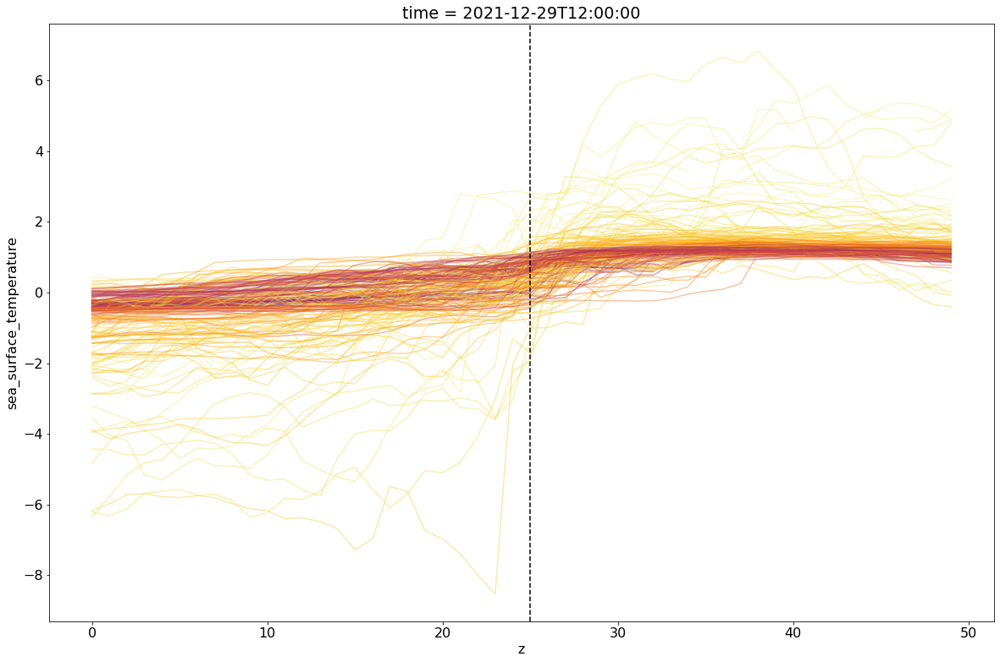

In [302]:
fig, ax = plt.subplots(figsize=(20,13))
for i, da in enumerate(sst_hov.sea_surface_temperature.sortby('time')):
    coastal_t = provide_coastal_temp_threshold(da.time.dt.dayofyear,buffer=-1.4)
    gs_t = provide_gs_temp_threshold(da.time.dt.dayofyear,buffer=0.4)
#     print(abs(int(da.time.dt.dayofyear.values)-180)/185)
#     da.plot(ax=ax,c=cmap(abs(int(da.time.dt.dayofyear.values)-225)/225),alpha=0.4)
    if isnans_list[i]:
        continue
    ((da-float(coastal_t.values))/(float(gs_t.values)-float(coastal_t.values))).plot(ax=ax,c=cmap(da.min()/29),alpha=0.4)
# ax.set_ylim(8,30)
ax.axvline(25,c='k',ls='--')
plt.show()

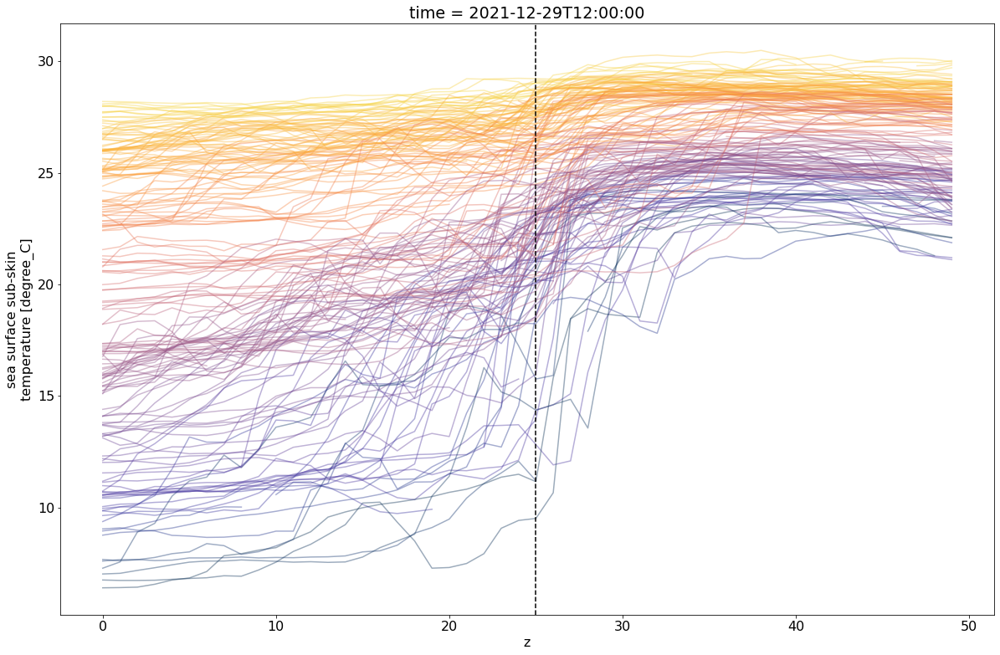

In [393]:
cmap = matplotlib.cm.get_cmap(cmocean.cm.thermal)
fig, ax = plt.subplots(figsize=(20,13))
for i, da in enumerate(sst_hov.sea_surface_temperature.sortby('time')):
#     print(abs(int(da.time.dt.dayofyear.values)-180)/185)
#     da.plot(ax=ax,c=cmap(abs(int(da.time.dt.dayofyear.values)-225)/225),alpha=0.4)
    if isnans_list[i]:
        continue
    da.plot(ax=ax,c=cmap((da.min()-5)/25),alpha=0.4)
# ax.set_ylim(8,30)
ax.axvline(25,c='k',ls='--')
plt.show()

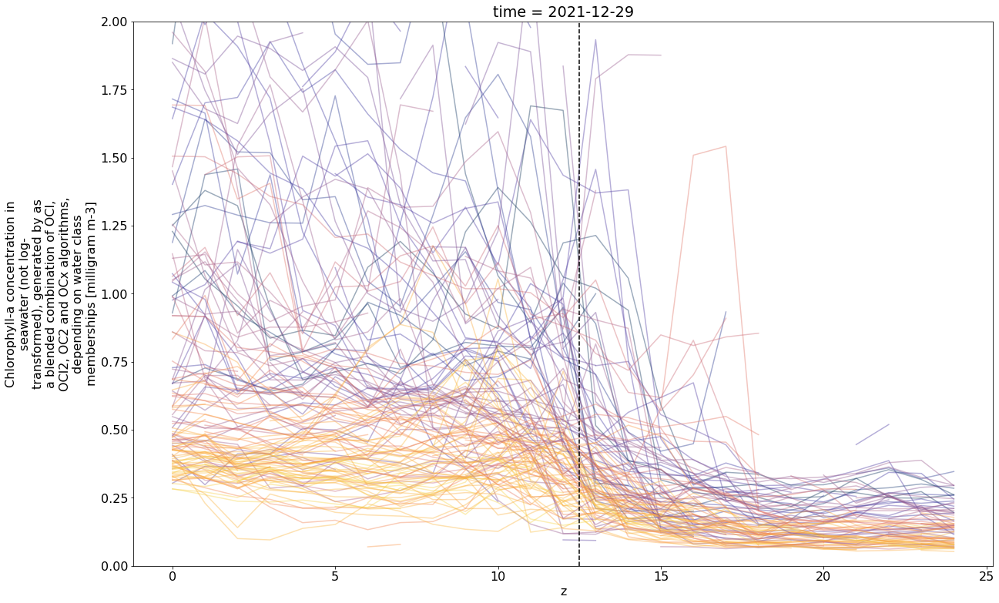

In [397]:
cmap = matplotlib.cm.get_cmap(cmocean.cm.thermal)
fig, ax = plt.subplots(figsize=(20,13))
for i, da in enumerate(chla_hov.chlor_a[122:122+365].sortby('time')):
#     print(abs(int(da.time.dt.dayofyear.values)-180)/185)
#     da.plot(ax=ax,c=cmap(abs(int(da.time.dt.dayofyear.values)-225)/225),alpha=0.4)
    if isnans_list[i]:
        continue
    da.plot(ax=ax,c=cmap((sst_hov.sea_surface_temperature[i].min()-5)/25),alpha=0.4)
# ax.set_ylim(8,30)
ax.axvline(25/2,c='k',ls='--')
# ax.set_yscale('log')
ax.set_ylim(0,2)
plt.show()

In [291]:
sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[37]) # sst_files[47]
sst_ds

<xarray.Dataset>
Dimensions:                  (latitude: 170, longitude: 182, time: 3)
Coordinates:
  * time                     (time) datetime64[ns] 2021-08-28T12:00:00 ... 20...
  * latitude                 (latitude) float32 37.59 37.57 ... 34.23 34.21
  * longitude                (longitude) float32 -76.61 -76.59 ... -73.01 -72.99
Data variables:
    sea_surface_temperature  (time, latitude, longitude) float32 ...
Attributes: (12/60)
    acknowledgement:                        Please acknowledge the use of the...
    aggregator_version:                     V1.00
    cdm_data_type:                          Grid
    col_count:                              18000
    col_start:                              0
    collation_version:                      2.7.0
    ...                                     ...
    summary:                                Sea surface temperature retrieval...
    testOutOfDate:                          now-95days
    time_coverage_end:                      2021-08-30T12:00:00Z
    time_coverage_start:                    2021-08-28T12:00:00Z
    title:                                  Sea-Surface Temperature, NOAA ACS...
    Westernmost_Easting:                    -76.61

In [314]:
mid_lat = adcp_gdf.lat.median()
mid_lon = adcp_gdf.lon.median()
sst_lat_list = xr.DataArray(np.arange(mid_lat+.5,mid_lat-0.5,step=-0.02), dims='z')
sst_lon_list = xr.DataArray(np.arange(mid_lon-.5,mid_lon+0.5,step=0.02), dims='z')

sst_loc_df = pd.DataFrame(
    {'value': np.arange(0,50),
     'Latitude': sst_lat_list.values,
     'Longitude': sst_lon_list.values})

sst_loc_gdf = gpd.GeoDataFrame(
    sst_loc_df, geometry=gpd.points_from_xy(sst_loc_df.Longitude, sst_loc_df.Latitude))

3

In [337]:
sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[37]) # sst_files[47]
sst_ds

<xarray.Dataset>
Dimensions:                  (latitude: 170, longitude: 182, time: 3)
Coordinates:
  * time                     (time) datetime64[ns] 2021-08-28T12:00:00 ... 20...
  * latitude                 (latitude) float32 37.59 37.57 ... 34.23 34.21
  * longitude                (longitude) float32 -76.61 -76.59 ... -73.01 -72.99
Data variables:
    sea_surface_temperature  (time, latitude, longitude) float32 ...
Attributes: (12/60)
    acknowledgement:                        Please acknowledge the use of the...
    aggregator_version:                     V1.00
    cdm_data_type:                          Grid
    col_count:                              18000
    col_start:                              0
    collation_version:                      2.7.0
    ...                                     ...
    summary:                                Sea surface temperature retrieval...
    testOutOfDate:                          now-95days
    time_coverage_end:                      2021-08-30T12:00:00Z
    time_coverage_start:                    2021-08-28T12:00:00Z
    title:                                  Sea-Surface Temperature, NOAA ACS...
    Westernmost_Easting:                    -76.61

In [338]:
my_ids = ((37,33),(41,36),(58,53))

In [340]:
my_ids[0][0]

37

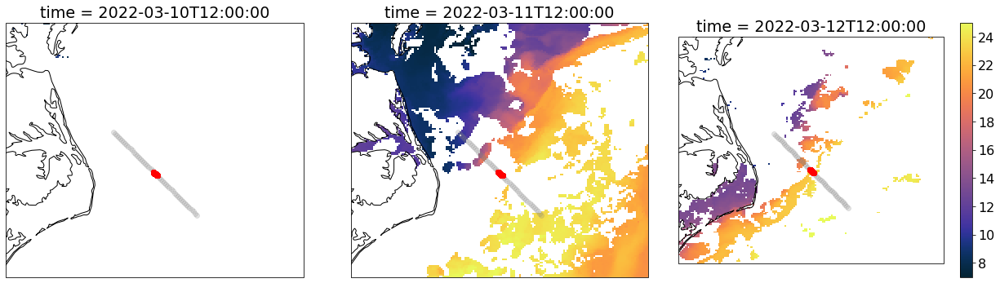

In [352]:
my_ids = ((37,33),(41,36),(58,53))
vmins = [26.2,23,7]
vmaxs = [29.3,29.2,25]
names = ['august_pcc_sst.png','sept_pcc_sst.png','march_pcc_sst.png']

iterate = 2

fig,ax = plt.subplots(1,3,figsize=(18,5),subplot_kw=dict(projection=crs.PlateCarree()))

sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[my_ids[iterate][0]]) # sst_files[47]

for i in range(3):
    ax[i].coastlines(resolution='10m')
    if i < 2:
        show_legend = False
    else:
        show_legend = True
    im = sst_ds.sea_surface_temperature[i].plot(ax=ax[i], cmap=cmocean.cm.thermal,vmin=vmins[iterate],vmax=vmaxs[iterate], add_colorbar=False)
    adcp_gdf = adcp_gdf_list[my_ids[iterate][1]]
    
    mid_lat = adcp_gdf.lat.median()
    mid_lon = adcp_gdf.lon.median()
    sst_lat_list = xr.DataArray(np.arange(mid_lat+.5,mid_lat-0.5,step=-0.02), dims='z')
    sst_lon_list = xr.DataArray(np.arange(mid_lon-.5,mid_lon+0.5,step=0.02), dims='z')

    sst_loc_df = pd.DataFrame(
        {'value': np.arange(0,50),
         'Latitude': sst_lat_list.values,
         'Longitude': sst_lon_list.values})

    sst_loc_gdf = gpd.GeoDataFrame(sst_loc_df, geometry=gpd.points_from_xy(sst_loc_df.Longitude, sst_loc_df.Latitude))
    
    sst_loc_gdf.plot(ax=ax[i],c='grey',alpha=0.2)
    adcp_gdf.plot(ax=ax[i],c='red')
    
    ax[i].set_xlim(-76.5,-73)
    ax[i].set_ylim(34.5,37.5)
fig.colorbar(im)
fig.tight_layout()
plt.savefig(names[iterate],dpi=300)
plt.show()

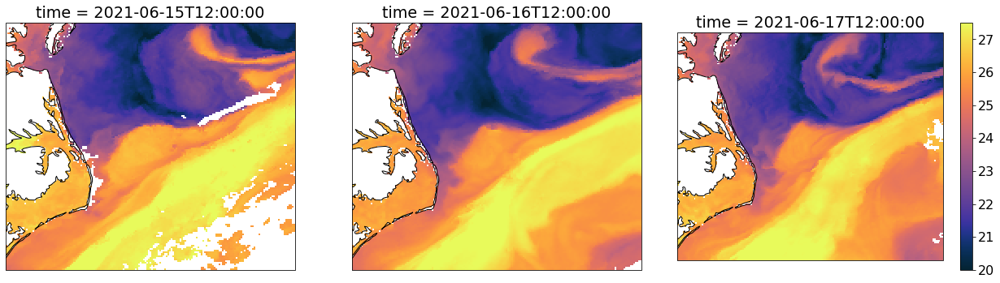

In [72]:
fig,ax = plt.subplots(1,3,figsize=(18,5),subplot_kw=dict(projection=crs.PlateCarree()))

sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[25]) # sst_files[47]

for i in range(3):
    ax[i].coastlines(resolution='10m')
    if i < 2:
        show_legend = False
    else:
        show_legend = True
    im = sst_ds.sea_surface_temperature[i].plot(ax=ax[i], cmap=cmocean.cm.thermal,vmin=20,vmax=27.5, add_colorbar=False)
#     adcp_gdf.plot(ax=ax[i])
    ax[i].set_xlim(-76.5,-73)
    ax[i].set_ylim(34.5,37.5)
fig.colorbar(im)
fig.tight_layout()
plt.savefig('impressive_eddy_front_15062021_cn.png',dpi=300)
plt.show()

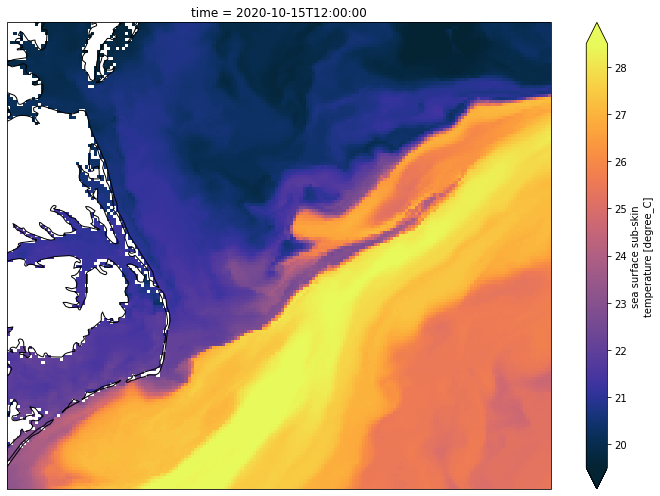

In [16]:
fig,ax = plt.subplots(figsize=(10,7),subplot_kw=dict(projection=crs.PlateCarree()))

sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[7]) # sst_files[47]

ax.coastlines(resolution='10m')
sst_ds.sea_surface_temperature[1].plot(ax=ax, cmap=cmocean.cm.thermal,vmin=19.5,vmax=28.5)
ax.set_xlim(-76.5,-73)
ax.set_ylim(34.5,37.5)
fig.tight_layout()
plt.savefig('clear_meander_period_20201015.png',dpi=300)
plt.show()

In [1]:
for i, fn in enumerate(sst_files):
    if i == 7
    print(i)
    print(fn)
    fig,ax = plt.subplots(1,3,figsize=(18,5),subplot_kw=dict(projection=crs.PlateCarree()))

    sst_ds = xr.open_dataset('data/all_front_sst/'+fn) # sst_files[47]

    for i in range(3):
        ax[i].coastlines(resolution='10m')
        if i < 2:
            show_legend = False
        else:
            show_legend = True
        im = sst_ds.sea_surface_temperature[i].plot(ax=ax[i], cmap=cmocean.cm.thermal, add_colorbar=False)
    #     adcp_gdf.plot(ax=ax[i])
        ax[i].set_xlim(-76.5,-73)
        ax[i].set_ylim(34.5,37.5)
    fig.colorbar(im)
    fig.tight_layout()
#     plt.savefig('impressive_eddy_front_15062021_cn.png',dpi=300)
    plt.show()

In [677]:
plt.rcParams.update({'font.size': 18})

In [668]:
profiles_fig = profiles[profiles.chla_clean < 2]

Text(0, 0.5, 'Chlorophyll-a')

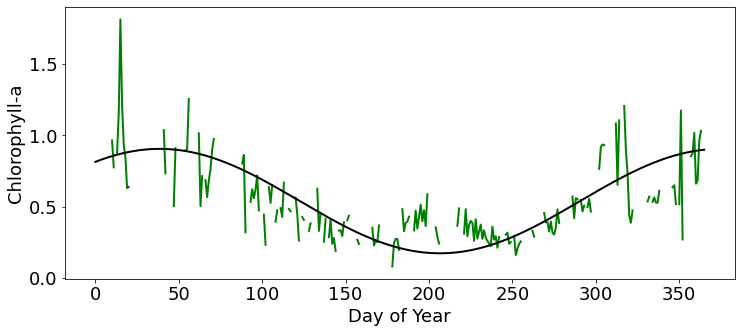

In [679]:
fig, ax = plt.subplots(figsize=(12,5))
ax.plot(chla_hov.chlor_a[122:122+365,10:13].mean(dim='z',skipna=True).time.dt.dayofyear,chla_hov.chlor_a[122:122+365,7:17].mean(dim='z',skipna=True),c='green',lw=2)
ax.plot(fine_t, data_fit_custom-0.2, label='after fitting',c='black',lw=2)
# ax.scatter(profiles_fig.datetime.dt.dayofyear,profiles_fig.chla_clean+0.1,s=2,alpha=0.05)
ax.set_xlabel('Day of Year')
ax.set_ylabel('Chlorophyll-a')


In [562]:
dist_list = []
for i, da in enumerate(sst_hov.sea_surface_temperature.sortby('time')):
    if isnans_list[i]:
        continue
    print(da.time.values)
    coastal_t = provide_coastal_temp_threshold(da.time.dt.dayofyear,buffer=-1.4)
    gs_t = provide_gs_temp_threshold(da.time.dt.dayofyear,buffer=0.4)
    
    g = da[da > gs_t]
    c = da[da < coastal_t]
    fig, (ax,ax2) = plt.subplots(1,2,figsize=(18,4))
    try:
        d = distance.distance((g[0].latitude,g[0].longitude),(c[-1].latitude,c[-1].longitude))
        d = d.meters
#         ax.axhline(c[-1])
#         ax.axhline(g[0])
    except Exception as e: 
#         print(e)
        d = np.nan
    dist_list.append(d)
    
    da.plot(ax=ax,marker='o')
    ax.axhline(gs_t,color='blue')
    ax.axhline(coastal_t,color='green')
#     ax.set_ylim(8,30)
    ax.set_xlim(0,50)
    
    axc = ax.twinx()
    axc = axc.twiny()
    
    chla_hov.chlor_a[122:122+365][i].plot(c='green',lw=3,ax=axc,marker='o')
    axc.set_xlim(0,25)
    
    ax2.scatter(da[::2],chla_hov.chlor_a[122:122+365][i])
    
    plt.show()


NameError: name 'sst_hov' is not defined

In [719]:
args_of_gs_thresh = []
for i, d in enumerate(sst_hov.sea_surface_temperature.resample(time='3D').mean().time.dt.dayofyear.values):
    args_of_gs_thresh.append(np.nanargmax(sst_hov.sea_surface_temperature.resample(time='3D').mean().values[i]>provide_gs_temp_threshold(d,buffer=2)))

In [721]:
args_of_gs_thresh = np.array(args_of_gs_thresh).astype(np.float16)
args_of_gs_thresh[args_of_gs_thresh==0]=np.nan

In [722]:
args_of_gs_thresh

array([25., 23., nan, 26., 29., 25., 26., 27., nan, nan, nan, 33., 32.,
       29., nan, 31., 29., 31., 30., 29., 26., 25., 27., 26., 20., 33.,
       34., 22., 28., 23., 20., 26., 26., 26., 26., 31., 30., 26., 27.,
       26., 25., 26., 25., 30., 24., 25., 27., 25., 27., 27., 29., 23.,
       15., 10., 14.,  7.,  6.,  8., 27., 12., 13., 28., 21.,  5.,  4.,
       nan, nan,  5.,  7.,  6., nan,  5., 21., 24.,  7., nan, nan, nan,
       nan, nan, nan, nan, 18., 18., 17., 10.,  7., 14., 25., 25., 25.,
       17., 21., 21., 26., 23., 24., 25., 33., 33., 31., 32., 28., 27.,
       28., 27., 25., 19., 38., 21., 23., 26., 25., 24., 24., 21., 18.,
       23., 24., 24., 26., 26.], dtype=float16)

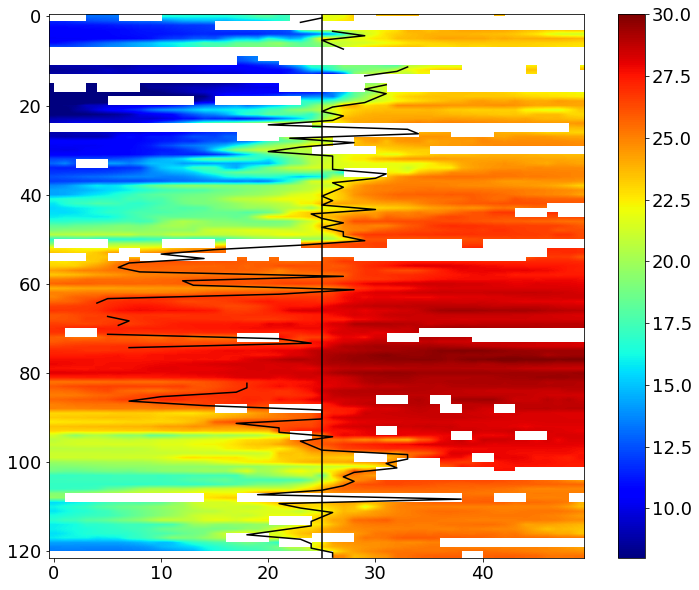

In [725]:
fig, ax = plt.subplots(figsize=(12,10))
im = ax.imshow(sst_hov.sea_surface_temperature.resample(time='3D').mean().values,cmap='jet',aspect='auto',vmin=8,vmax=30,interpolation='bilinear')
ax.plot(args_of_gs_thresh,sst_hov.sea_surface_temperature.resample(time='3D').mean().time.dt.dayofyear.values/3,c='k',ls='-')
ax.axvline(25,c='black')
fig.colorbar(im)

# plt.savefig('hovmoller_sst.png',dpi=600)
plt.show()

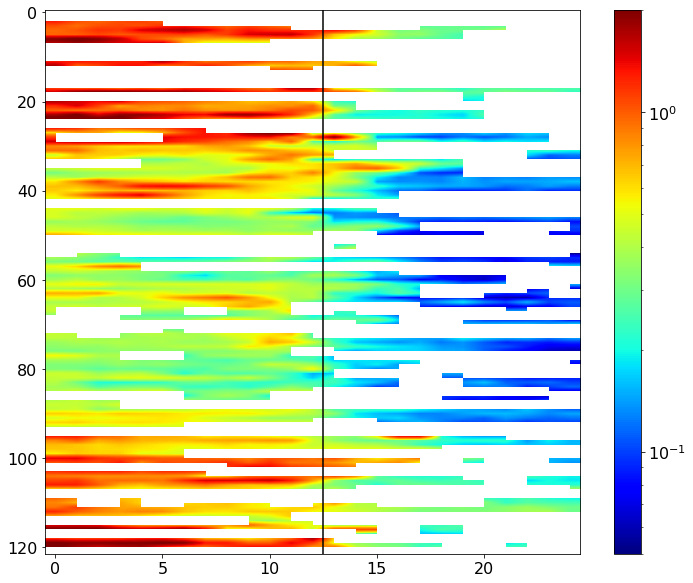

In [482]:
fig, ax = plt.subplots(figsize=(12,10))
im = ax.imshow(chla_hov.chlor_a[122:122+365].resample(time='3D').mean().values,cmap='jet',aspect='auto',norm=LogNorm(vmin=0.05, vmax=2),interpolation='bilinear')
ax.axvline(25/2,c='black')
fig.colorbar(im)

plt.savefig('hovmoller_chla.png',dpi=600)
plt.show()

In [19]:
sst_hov_goes

<xarray.Dataset>
Dimensions:                  (time: 500, z: 50)
Coordinates:
  * time                     (time) datetime64[ns] 2021-01-01 ... 2022-05-15
    latitude                 (z) float64 36.13 36.11 36.09 ... 35.19 35.17 35.15
    longitude                (z) float64 -75.23 -75.21 -75.19 ... -74.27 -74.25
Dimensions without coordinates: z
Data variables:
    sea_surface_temperature  (time, z) float32 nan nan nan nan ... nan nan nan

In [ ]:
vmin=42950,vmax=44500
(20.5+273.15-149)/0.00341802

In [260]:
(44500*0.00341802)+149-273.15

27.95189000000005

In [267]:
sst_ds.longitude.min(),sst_ds.longitude.max()

(<xarray.DataArray 'longitude' ()>
 array(-76.61000061),
 <xarray.DataArray 'longitude' ()>
 array(-72.98999786))

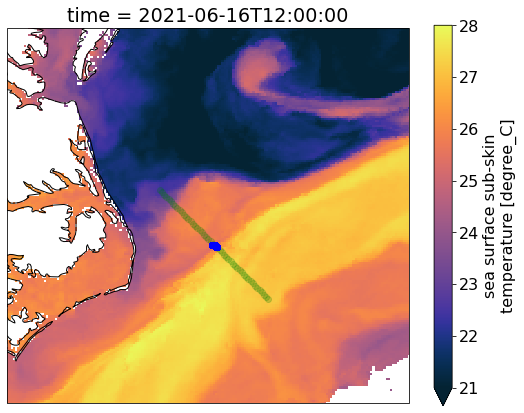

In [265]:
# ssh_ds = xr.open_dataset('data/tmp/dataset-duacs-nrt-global-merged-allsat-phy-l4_1678289248163.nc')
sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[25])

fig,ax = plt.subplots(figsize=(9,7),subplot_kw=dict(projection=crs.PlateCarree()))
# fig,ax = plt.subplots(figsize=(8,8))#,subplot_kw=dict(projection=crs.PlateCarree()))
# ssh_ds.isel(time=341).plot.streamplot(x='longitude',y='latitude', u='ugosa',v='vgosa',ax=ax)
sst_ds.sea_surface_temperature[1].plot(ax=ax, cmap=cmocean.cm.thermal,vmin=21,vmax=28)
ax.coastlines(resolution='10m')
list_of_sst_gdf[21].plot(ax=ax,c='green',alpha=0.2)
list_of_sst_adcp_gdf[21].plot(ax=ax,c='blue')

ax.set_ylim(sst_ds.latitude.min(),sst_ds.latitude.max())
ax.set_xlim(sst_ds.longitude.min(),sst_ds.longitude.max())

fig.savefig('merged_sst_gs.png',dpi=300)

plt.show()

# Begin Processing ADCP RIGHT HERE

In [12]:
pd.options.mode.chained_assignment = None  # default='warn'

In [17]:
import glob

all_files = glob.glob(data_src+'all_adcp/processed/*.mat')

In [18]:
files = []
for f in all_files:
    files.append(f.split('100s')[0])
filenames = list(np.unique(files))
filenames = [f+'100s' for f in filenames]

In [19]:
datetimes = [datetime.strptime(f.split('_')[2][:-5], '%Y%m%dT%H%S') for f in filenames]

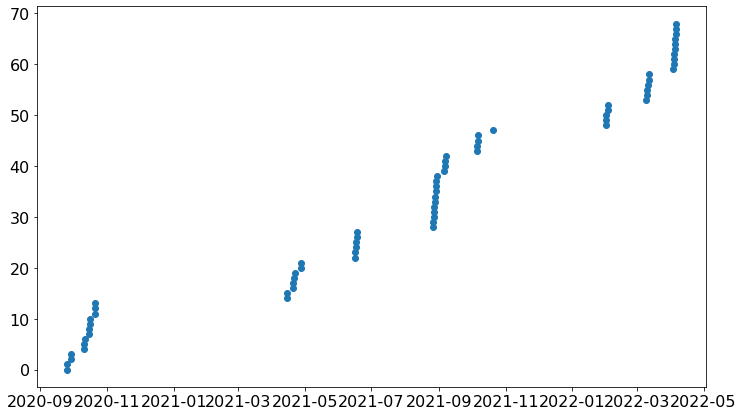

In [20]:
fig,ax = plt.subplots(figsize=(12,7))
ax.scatter(datetimes, range(len(datetimes)))

In [21]:
tentative_good_idxs = [4,5,6,7,8,9,10,11,12,13,16,17,20,21,22,23,26,27,28,30,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,57,58,59,60,61,62,63,64,65,66,67,68]

### pulling in profile code

In [22]:
! pip install colour

In [23]:
! pip install geopy

In [24]:
# yes I realize this is an ugly brute force way to do this but it works

In [25]:
count = 0

vmp_fns = glob.glob(data_src+'VMP/2020*.mat')
vmp_fns.sort()

names = ['t'+str(i) for i in np.arange(count,len(vmp_fns)+count)]
count += len(vmp_fns)

li = []
for i, fn in enumerate(vmp_fns):
    mat = scipy.io.loadmat(fn)
    for item in list(mat.keys()):
        if item not in ['__header__', '__version__', '__globals__']:
            df_tmp = pd.DataFrame(data=mat[item], columns=['time', 'depth (dBars)', 'temp (C)','salinity (PSU)', 'potential density (kg/m^3 -1000)', 
                                                    'chla (ppb)', 'turbidity (FTU)', 'turb kinetic energy 1 (W/kg)', 'turb kinetic energy 2 (W/kg)'])
            df_tmp['transect'] = names[i]
            df_tmp['profile_num'] = names[i]+'_'+item.split('profile')[-1]
            li.append(df_tmp)

profiles_2020 = pd.concat(li, axis=0, ignore_index=True)
profiles_2020['dt'] = pd.to_datetime('2020-1-1') + pd.to_timedelta(profiles_2020.time, unit='D') - pd.Timedelta(days=1)
profiles_2020 = profiles_2020.set_index('dt')
profiles_2020 = profiles_2020.sort_index(ascending=True)
profiles_2020['datetime'] = pd.to_datetime('2020-1-1') + pd.to_timedelta(profiles_2020.time, unit='D') - pd.Timedelta(days=1)

In [26]:
# this does make the transect# out of order with dates but doens't matter it is just a unique identifier

vmp_fns = glob.glob(data_src+'VMP/YD*.mat') + glob.glob(data_src+'VMP/Cruise1/*.mat') + glob.glob(data_src+'VMP/Cruise2/*.mat')
vmp_fns.sort()

names = ['t'+str(i) for i in np.arange(count,len(vmp_fns)+count)]
count += len(vmp_fns)

li = []
for i, fn in enumerate(vmp_fns):
    mat = scipy.io.loadmat(fn)
    for item in list(mat.keys()):
        if item not in ['__header__', '__version__', '__globals__']:
            df_tmp = pd.DataFrame(data=mat[item], columns=['time', 'depth (dBars)', 'temp (C)','salinity (PSU)', 'potential density (kg/m^3 -1000)', 
                                                    'chla (ppb)', 'turbidity (FTU)', 'turb kinetic energy 1 (W/kg)', 'turb kinetic energy 2 (W/kg)'])
            df_tmp['transect'] = names[i]
            df_tmp['profile_num'] = names[i]+'_'+item.split('profile')[-1]
            li.append(df_tmp)

profiles_2021 = pd.concat(li, axis=0, ignore_index=True)
profiles_2021['dt'] = pd.to_datetime('2021-1-1') + pd.to_timedelta(profiles_2021.time, unit='D') - pd.Timedelta(days=1)
profiles_2021 = profiles_2021.set_index('dt')
profiles_2021 = profiles_2021.sort_index(ascending=True)
profiles_2021['datetime'] = pd.to_datetime('2021-1-1') + pd.to_timedelta(profiles_2021.time, unit='D') - pd.Timedelta(days=1)

In [27]:
vmp_fns = glob.glob(data_src+'VMP/VMP*.mat')
vmp_fns.sort()

names = ['t'+str(i) for i in np.arange(count,len(vmp_fns)+count)]
count += len(vmp_fns)

li = []
for i, fn in enumerate(vmp_fns):
    mat = scipy.io.loadmat(fn)
    for item in list(mat.keys()):
        if item not in ['__header__', '__version__', '__globals__']:
            df_tmp = pd.DataFrame(data=mat[item], columns=['time', 'depth (dBars)', 'temp (C)','salinity (PSU)', 'potential density (kg/m^3 -1000)', 
                                                    'chla (ppb)', 'turbidity (FTU)', 'turb kinetic energy 1 (W/kg)', 'turb kinetic energy 2 (W/kg)'])
            df_tmp['transect'] = names[i]
            df_tmp['profile_num'] = names[i]+'_'+item.split('profile')[-1]
            li.append(df_tmp)

profiles_2022 = pd.concat(li, axis=0, ignore_index=True)
profiles_2022['dt'] = pd.to_datetime('2022-1-1') + pd.to_timedelta(profiles_2022.time, unit='D') - pd.Timedelta(days=1)
profiles_2022 = profiles_2022.set_index('dt')
profiles_2022 = profiles_2022.sort_index(ascending=True)
profiles_2022['datetime'] = pd.to_datetime('2022-1-1') + pd.to_timedelta(profiles_2022.time, unit='D') - pd.Timedelta(days=1)

In [28]:
profiles = pd.concat([profiles_2020,profiles_2021,profiles_2022])

In [29]:
from geopy import distance

def get_dist(df, df_start, flip=False):
    distances = []
    # flip allows you to swap the starting side so that it can always do dist from the same side
    if flip == False:
        first_row = df_start.iloc[0]
    else:
        first_row = df_start.iloc[-1]
    for row in df.itertuples(index=False):
        distances.append(distance.distance((row.lat, row.lon),(first_row.lat,first_row.lon)).meters)
    return(distances)

In [30]:
def profile_locs(df, adcp_df):
    # add in lat and lon
    lats = []
    lons = []
    dists = []
    for i in range(len(df)):
        row = adcp_df.iloc[adcp_df.index.get_loc(pd.to_datetime(df.iloc[i].datetime), method='nearest')]
        lats.append(row.lat)
        lons.append(row.lon)
        dists.append(row.dist)
    df['lat'] = lats
    df['lon'] = lons
    df['dist'] = dists

    # now make it the same for each profile depending on the first row with that profile_num
    profile_nums = df.profile_num.unique()
    profile_num_idx = 0
    
    lats = []
    lons = []
    dists = []
    for row in df.itertuples(index=False):
#         print(profile_num_idx)
        try:
            if row.profile_num == profile_nums[profile_num_idx]:
                top_lat = row.lat
                top_lon = row.lon
                dist = row.dist
                profile_num_idx+=1
        except IndexError:
#             print('index error')
            pass
        lats.append(top_lat)
        lons.append(top_lon)
        dists.append(dist)
        
    df['lat'] = lats
    df['lon'] = lons
    df['dist'] = dists
    return(df)

In [31]:
import matplotlib.colors as mat_colors

In [60]:
from colour import Color
def plot_profiles(df, adcp_df, start_time, end_time, data_variables, plot=False, density_y=False, global_lims=False):

#     print('##############################')
# #     print('Transect ' + str(i+1))
#     print('##############################')
    df_subset = df.loc[start_time:end_time]
    
    df_subset = profile_locs(df_subset, adcp_df)
    
    fig, ax = plt.subplots(1,4, figsize=(30,5))
    
    if len(df_subset) == 0:
        print('Did not have profile data.')
        return(ax)
    
    # Original data (e.g. measurements)
    for i, data_var in enumerate(data_variables):
        if plot:
            cmap='viridis'
            norm=None
#             fig, ax = plt.subplots(figsize=(17.2,7))
            if data_var == 'temp (C)':
                cmap = cmocean.cm.thermal
#                 vmin=21
#                 vmax=27.5
            elif data_var == 'salinity (PSU)':
                cmap = cmocean.cm.haline
                pass
#                 vmin=34.8
#                 vmax=36.2
            elif data_var == 'potential density (kg/m^3 -1000)':
                cmap = cmocean.cm.dense
#                 vmin=22.5
#                 vmax=23.5
            elif data_var == 'chla (ppb)':
                vmin=0.0
                vmax=0.6
                cmap = cmocean.cm.algae
            elif data_var == 'turbidity (FTU)':
                pass
#                 vmin=1
#                 vmax=1.12
            elif data_var == 'turb kinetic energy 1 (W/kg)':
                vmin=1e-10
                vmax=1e-6
                norm=mat_colors.LogNorm()
            elif data_var == 'turb kinetic energy 2 (W/kg)':
                vmin=1e-10
                vmax=1e-6
                norm=mat_colors.LogNorm()
            elif data_var == 'cluster':
                vmin=0
                vmax=6
                cmap='jet'
#                 norm=mat_colors.LogNorm()
                
#             flip=False
#             if transect in [1,8]:
#                 flip=True
            
#             df_subset_distances = get_dist(df_subset, adcp_df.loc[start_time:end_time], flip=False)
            if data_var == 'predicted_chla':
                var_to_viz = lr.predict(df_subset.turbidity_clean.values.reshape(-1,1))
            elif data_var == 'chla_bb':
                var_to_viz = df_subset.chla_clean/df_subset.turbidity_clean
            elif data_var == 'real_predict_chla':
                var_to_viz = df_subset.chla_clean/lr.predict(df_subset.turbidity_clean.values.reshape(-1,1))
            elif data_var == 'chla_sal':
                var_to_viz = df_subset.chla_clean/df_subset['salinity (PSU)']
            else:
                var_to_viz = df_subset[data_var]

            vmin = np.nanpercentile(var_to_viz, 5)
            vmax = np.nanpercentile(var_to_viz, 95)
            if data_var == 'ekbackscatter':
                vmin=97.5
                vmax=115
            if data_var == 'cluster':
                vmin=0
                vmax=6
            if data_var == 'salinity (PSU)':
                if global_lims:
                    vmin=35
                    vmax=36.5
            if data_var == 'chla (ppb)':
                vmin=0
                vmax=0.6
                cmap = cmocean.cm.algae
            if data_var == 'turbidity (FTU)':
                vmin=1
                vmax=2.5
                cmap = cmocean.cm.turbid
            if data_var == 'predicted_chla':
                vmin=0
                vmax=0.6
                cmap = cmocean.cm.algae
            if data_var == 'chla_clean':
#                 vmin=0
#                 vmax=0.6
                cmap = cmocean.cm.algae
                if global_lims:
                    vmin=0
                    vmax=1.3
            if data_var == 'chla_bb':
                vmin=0.0
                vmax=.8
            if data_var == 'chla_sal':
                vmin = 0.005
                vmax = 0.045
            if data_var == 'real_predict_chla':
                vmin=1.4
                vmax=.6
                cmap='cividis'
            if data_var == 'spice':
                cmap=cmocean.cm.deep_r
                
            y_var = 'depth (dBars)'
            if density_y==True:
                y_var = 'potential density (kg/m^3 -1000)'
                
            gs_threshold = provide_gs_temp_threshold(df_subset.iloc[:1].datetime.dt.day_of_year.values,buffer=0.4)
            coastal_threshold = provide_coastal_temp_threshold(df_subset.iloc[:1].datetime.dt.day_of_year.values,buffer=-1.4)
            
            surface_ts = []
            dists = []
            for pn in natsorted(df_subset.profile_num.unique()):
                surface_ts.append(df_subset[(df_subset.profile_num==pn)&(df_subset['depth (dBars)']>-3)]['temp (C)'].mean())
                dists.append(df_subset[(df_subset.profile_num==pn)&(df_subset['depth (dBars)']>-3)]['dist'].mean())
            
            front_idx = np.nanargmin(np.abs(np.array(surface_ts) - gs_threshold))
            front_dist = dists[front_idx]
#             print("Front location is:  " + str(front_dist))
            
            sc = ax[i].scatter(df_subset['dist']-front_dist, df_subset[y_var],c=var_to_viz,cmap=cmap, s=150, alpha=.7, vmin=vmin,vmax=vmax,)# norm=norm)
            
            # just to classify the top of the profile into water mass via T
            gs_threshold = provide_gs_temp_threshold(df_subset.iloc[:1].datetime.dt.day_of_year.values,buffer=0.4)
            coastal_threshold = provide_coastal_temp_threshold(df_subset.iloc[:1].datetime.dt.day_of_year.values,buffer=-1.4)
            try:
                t_colors = []
                dist_t = []
                for pn in natsorted(df_subset.profile_num.unique()):
                    t = df_subset[(df_subset.profile_num==pn)&(df_subset['depth (dBars)']>-3)]['temp (C)'].mean()
                    dist_t.append(df_subset[(df_subset.profile_num==pn)&(df_subset['depth (dBars)']>-3)]['dist'].mean())
                    if np.isnan(t):
                        t_colors.append('white')
                    elif t>gs_threshold:
                        t_colors.append('blue')
                    elif t<coastal_threshold: 
                        t_colors.append('green')
                    else:
                        t_colors.append('yellow')

                ax[i].scatter(np.array(dist_t)-front_dist, [-1]*len(dist_t),c=t_colors, s=200, alpha=.8)
            except Exception as e: 
                print(e)
                

#             if transect==0:

#                 Sep 05 2021 13:15:33 [System UTC, header]
#                 Sep 05 2021 15:21:30 [System UTC, header]
#                 Sep 05 2021 17:14:42 [System UTC, header]


#                 if data_var == 'temp (C)':
#                     for t_string in ['Sep 05 2021 13:15:33']:
#                         df_idx = df_subset.index.get_loc(pd.to_datetime('Sep 05 2021 13:15:33'), method='nearest')
#                         ax.scatter(df_subset_distances, df_subset['depth (dBars)'],c=df_subset[data_var]

#             sc = ax.scatter(df_subset['datetime'], df_subset['depth (dBars)'],c=df_subset[data_var],cmap=cmap, s=150, alpha=.7, vmin=vmin,vmax=vmax, norm=norm)
#             ax[i].set_ylim(-120,0)
#             ax.set_xlim(df_subset['datetime'].max()+timedelta(hours=.1),df_subset['datetime'].min()-timedelta(hours=.1))
            cb = fig.colorbar(sc,ax=ax[i])
#             cb.set_label(data_var)
            ax[i].set_title(data_var)
#             depths = [-5,-10,-20,-30,-60]

#             colors = list(Color("black").range_to(Color("blue"),len(depths)))
#             hex_colors = [j.hex for j in colors]
#             # integrate down to z depth
#             ax2 = ax.twinx()
#             for idx,z in enumerate(depths):
#                 # cut it off at depth (dBars) >= z
#                 df_tmp = df_subset[df_subset['depth (dBars)'] >= z] 
#                 df_tmp_grouped = df_tmp.groupby('profile_num').mean()
#                 df_tmp_grouped['datetime'] = pd.to_datetime('2021-1-1') + pd.to_timedelta(df_tmp_grouped.time, unit='D') - pd.Timedelta(days=1)


#                 ax2.plot(df_tmp_grouped['datetime'],df_tmp_grouped[data_var], label=str(z), color=hex_colors[idx])
#                 ax2.set_ylim(vmin,vmax)
#                 ax2.legend(loc='lower left',title='Depth Integrated Values')



            ax[i].set_ylabel('Depth (m')
            ax[i].set_xlabel('Distance (m)')
#             ax.set_xlim(pd.to_datetime(start_time), pd.to_datetime(end_time))
#             ax.set_xlim(pd.to_datetime(end_time),pd.to_datetime(start_time))
        #     ax[1].xaxis.set_major_locator(plt.MaxNLocator(7))
#     fig.autofmt_xdate(rotation=45)
#             ax.xaxis.set_major_locator(plt.MaxNLocator(15))
#             print(data_var[:20]+'.png')
#             fig.savefig('figs/sept_transect_'+str(transect+1)+'_'+data_var[:20]+'.png')
    return(ax, front_dist)

In [34]:
from colour import Color
def grab_vmp_data(df, adcp_df, start_time, end_time):

    df_subset = df.loc[start_time:end_time]
    df_subset['DOY'] = df_subset.datetime.dt.day_of_year
    df_subset.sort_index(inplace=True, ascending=True)
    
    df_subset = profile_locs(df_subset, adcp_df)
    z = -4.5
    df_tmp = df_subset[df_subset['depth (dBars)'] >= z] 
    df_tmp_grouped = df_tmp.groupby('profile_num').mean()
    
    df_tmp_grouped.sort_values('dist', inplace=True)
    
    return(df_tmp_grouped['salinity (PSU)'].values, df_tmp_grouped['temp (C)'].values, df_tmp_grouped['chla (ppb)'].values, df_tmp_grouped['turbidity (FTU)'].values, df_tmp_grouped['DOY'].values, df_tmp_grouped['dist'].values)
    

In [35]:
plt.rcParams.update({'font.size': 16})

In [36]:
# August 27 2021 at 16:10 UTC
# profiles.loc['2021-08-27 14:15:00':'2021-08-27 20:15:00']

In [38]:
sst_seasonal = pd.read_csv(data_src+'sst_gs_coastal.csv',names=['datetime', 'coastal_sst', 'gs_sst'], skiprows=1)
chla_seasonal = pd.read_csv(data_src+'chla_gs_coastal.csv',names=['datetime', 'coastal_chla', 'gs_chla'], skiprows=1)

sst_seasonal.datetime = pd.to_datetime(sst_seasonal.datetime)
sst_seasonal['utc'] = sst_seasonal.datetime
sst_seasonal = sst_seasonal.set_index('datetime')

chla_seasonal.datetime = pd.to_datetime(chla_seasonal.datetime)
chla_seasonal = chla_seasonal.set_index('datetime')

In [39]:
sst_seasonal['doy'] = sst_seasonal.utc.dt.day_of_year

In [40]:
sst_avgs = sst_seasonal.groupby('doy').mean()

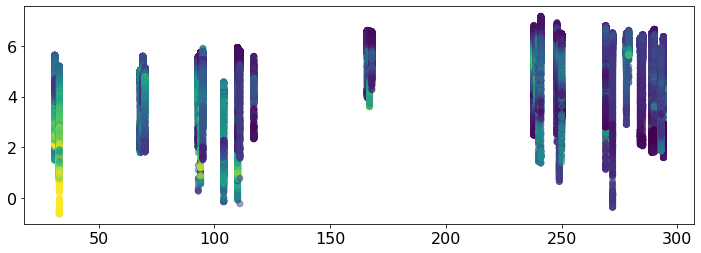

In [572]:
fig, ax = plt.subplots(figsize=(12,4))
ax.scatter(profiles.datetime.dt.day_of_year, profiles['spice'],c=profiles.chla_clean,alpha=0.5,vmin=0,vmax=1.5)
plt.show()

Text(0.5, 0, 'Day of Year')

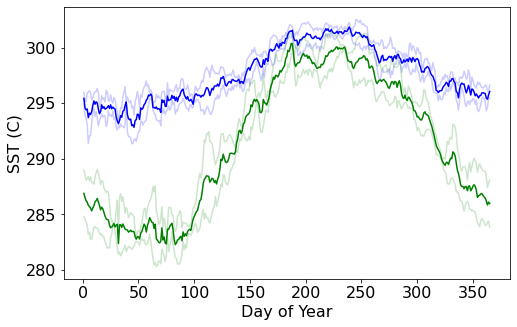

In [77]:
fig,ax = plt.subplots(figsize=(8,5))

dates_x_sst = np.arange(1,366,1)

####################

sst_mean = sst_seasonal.groupby([sst_seasonal.index.month, sst_seasonal.index.day]).mean()
sst_std = sst_seasonal.groupby([sst_seasonal.index.month, sst_seasonal.index.day]).std()

ax.plot(dates_x_sst,sst_mean.gs_sst, c='blue', label='Gulf Stream')
ax.plot(dates_x_sst,sst_mean.gs_sst+sst_std.gs_sst, c='blue', alpha=0.2)
ax.plot(dates_x_sst,sst_mean.gs_sst-sst_std.gs_sst, c='blue', alpha=0.2)

###################

ax.plot(dates_x_sst,sst_mean.coastal_sst, c='green', label='Coastal')
ax.plot(dates_x_sst,sst_mean.coastal_sst+sst_std.coastal_sst, c='green', alpha=0.2)
ax.plot(dates_x_sst,sst_mean.coastal_sst-sst_std.coastal_sst, c='green', alpha=0.2)

################3

# ax.legend(loc='lower right')

ax.set_ylabel('SST (C)')
ax.set_xlabel('Day of Year')

# plt.savefig('gs_coastal_sst.png',dpi=300)

In [104]:
full_adcp_gdf['date'] = full_adcp_gdf.datetime.dt.date
full_adcp_gdf['doy'] = full_adcp_gdf.datetime.dt.day_of_year

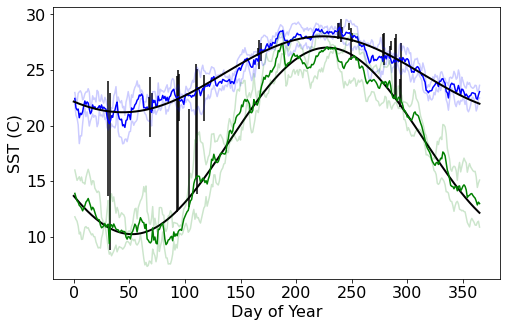

In [122]:
fig,ax = plt.subplots(figsize=(8,5))

dates_x_sst = np.arange(1,366,1)

####################

sst_mean = sst_seasonal.groupby([sst_seasonal.index.month, sst_seasonal.index.day]).mean()
sst_std = sst_seasonal.groupby([sst_seasonal.index.month, sst_seasonal.index.day]).std()

# ax.scatter(full_adcp_gdf.datetime.dt.day_of_year.unique(),[30]*30,c='none',edgecolor='k')

for i in range(len(full_adcp_gdf.groupby('date').mean().doy)):
    ax.vlines(full_adcp_gdf.groupby('date').mean().doy.iloc[i],full_adcp_gdf.groupby('date').min().sst.iloc[i],full_adcp_gdf.groupby('date').max().sst.iloc[i],color='k')

ax.plot(dates_x_sst,sst_mean.gs_sst-273, c='blue', label='Gulf Stream')
ax.plot(dates_x_sst,sst_mean.gs_sst+sst_std.gs_sst-273, c='blue', alpha=0.2)
ax.plot(dates_x_sst,sst_mean.gs_sst-sst_std.gs_sst-273, c='blue', alpha=0.2)
ax.plot(fine_t_coast, data_fit_coast-273, label='after fitting',c='black',lw=2)

###################

ax.plot(dates_x_sst,sst_mean.coastal_sst-273, c='green', label='Coastal')
ax.plot(dates_x_sst,sst_mean.coastal_sst+sst_std.coastal_sst-273, c='green', alpha=0.2)
ax.plot(dates_x_sst,sst_mean.coastal_sst-sst_std.coastal_sst-273, c='green', alpha=0.2)
ax.plot(fine_t_coast, data_fit_gs-273, label='after fitting',c='black',lw=2)


################3

# ax.legend(loc='lower right')

ax.set_ylabel('SST (C)')
ax.set_xlabel('Day of Year')

plt.savefig('gs_coastal_sst.png',dpi=300)


# fig,ax = plt.subplots(figsize=(8,5))

# chla_mean = chla_seasonal.groupby([chla_seasonal.index.month, chla_seasonal.index.day]).mean()
# chla_std = chla_seasonal.groupby([chla_seasonal.index.month, chla_seasonal.index.day]).std()

# str_dts = []
# for i in range(len(chla_mean.index)):
#     str_dts.append(str(chla_mean.index[i][1])+','+str(chla_mean.index[i][0]))
    
# day_of_year_chla = [datetime.strptime(dt,"%d,%m").timetuple().tm_yday for dt in str_dts]

# dates_x_chla = day_of_year_chla

# ####################

# ax.plot(dates_x_chla,chla_mean.gs_chla, c='blue', label='Gulf Stream')
# ax.plot(dates_x_chla,chla_mean.gs_chla+chla_std.gs_chla, c='blue', alpha=0.2)
# ax.plot(dates_x_chla,chla_mean.gs_chla-chla_std.gs_chla, c='blue', alpha=0.2)


# ###################

# ax.plot(dates_x_chla,chla_mean.coastal_chla, c='green', label='Coastal')
# ax.plot(dates_x_chla,chla_mean.coastal_chla+chla_std.coastal_chla, c='green', alpha=0.2)
# ax.plot(dates_x_chla,chla_mean.coastal_chla-chla_std.coastal_chla, c='green', alpha=0.2)
# ax.plot(fine_t, data_fit, label='after fitting',c='black',lw=2)
# ax.plot(fine_t_custom, data_fit_custom, label='after fitting',c='black',lw=2)

# ################3

# ax.set_ylim(0,2.75)

# # ax.legend()

# ax.set_ylabel('Chla (mg/m3)')
# ax.set_xlabel('Day of Year')
# plt.savefig('gs_coastal_chla.png',dpi=300)

135

datetime  datetime
1         1           0.645041
          6           0.550543
          11          0.468311
          16          0.472370
          21          0.430702
                        ...   
12        21          0.416396
          22          0.377745
          26          0.456868
          27          0.675752
          31          0.546258
Name: gs_chla, Length: 135, dtype: float64

### Define the salinity and temp models

In [36]:
dist_list = []
front_location_list = []
sst_list = []
current_list = []
echo_list = []
interp_sst_list = []
interp_current_list = []
interp_echo_list = []

sal_front_list = []

vmp_sal_list = []
vmp_temp_list = []
vmp_chla_list = []
vmp_dt_list = []

for idx,fn in enumerate(filenames):
    if idx in [0,1,2,3]:
        continue
    try:
        ##########
        
        dist = scipy.io.loadmat(fn+'_distance.mat')['distance']
        sst = scipy.io.loadmat(fn+'_SST.mat')['SST']
        time = scipy.io.loadmat(fn+'_time.mat')['time']
        timestamps = pd.to_datetime(time[0,:]-719529, unit='D')
  
        lat = scipy.io.loadmat(fn+'_lat.mat')['lat']
        long = scipy.io.loadmat(fn+'_long.mat')['long']
        
        # the distances are crazy wrong sometimes so re-calcuating the distance
        coords_1 = (lat[0], long[0])
        distances = []
        for i in range(len(lat)):
            coords_2 = (lat[i], long[i])
            distances.append(distance.geodesic(coords_1, coords_2).meters)
        dist = np.array(distances)       

        # checking if the current point is within 500 of one that was good, assuming the first point is good
        # then if not setting it to nan and interpolating it out
        last_good_idx = 0
        bad_idxs = []
        for di,d in enumerate(dist):
            if dist[di] - dist[last_good_idx] < 500:
                last_good_idx = di
            else:
                bad_idxs.append(di)
        dist[bad_idxs] = np.nan
        dist = pd.Series(dist).interpolate().values

        dist = dist.reshape(-1,1)
        
        adcp_df = pd.DataFrame({'dt':timestamps,
                    'datetime':timestamps,
                    'sst':sst[:,0],
                    'lat': lat[:,0],
                    'lon':long[:,0],
                    'dist':dist[:,0]})

        adcp_df = adcp_df.set_index('dt')
        adcp_df = adcp_df.sort_index(ascending=True)
        
        
        ##########
        
        sal_vmp, temp_vmp, chla_vmp, turb_vmp, dt_vmp, dist_vmp = grab_vmp_data(profiles, adcp_df, timestamps[0],timestamps[-1])
            
        vmp_sal_list.append(sal_vmp)
        vmp_temp_list.append(temp_vmp)
        vmp_chla_list.append(chla_vmp)
        vmp_dt_list.append(dt_vmp)
        

    except Exception as e: 
        print(e)



cannot convert input with unit 'D'


how many transects do we have with VMP data

In [43]:
import gsw

## calculate the seasonal dependence of salinity

In [39]:
max_sal_list = []
for i in vmp_sal_list:
    if len(i) == 0:
        continue
    max_sal_list.append(np.percentile(i, 95))

doy_list = []
for i in vmp_dt_list:
    if len(i) == 0:
        continue
    doy_list.append(np.max(i))

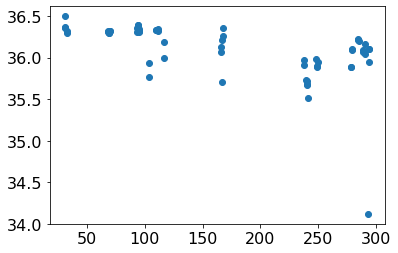

In [40]:
# plt.scatter(abs(np.array(doy_list)-225),max_sal_list)
plt.scatter(doy_list,max_sal_list)

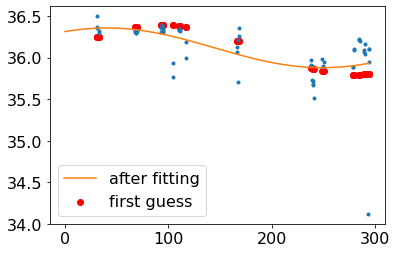

In [41]:
import numpy as np
from scipy.optimize import leastsq
import pylab as plt

t = np.array(doy_list)
data = np.array(max_sal_list)

guess_mean = np.mean(data)
guess_std = 3*np.std(data)/(2**0.5)/(2**0.5)
guess_phase = 0
guess_freq = 1/60
guess_amp = .3

# we'll use this to plot our first estimate. This might already be good enough for you
data_first_guess = guess_amp*np.sin(guess_freq*t+guess_phase) + guess_mean

# Define the function to optimize, in this case, we want to minimize the difference
# between the actual data and our "guessed" parameters
optimize_func = lambda x: x[0]*np.sin(x[1]*t+x[2]) + x[3] - data
est_amp, est_freq, est_phase, est_mean = leastsq(optimize_func, [guess_amp, guess_freq, guess_phase, guess_mean])[0]

# recreate the fitted curve using the optimized parameters
data_fit = est_amp*np.sin(est_freq*t+est_phase) + est_mean

# recreate the fitted curve using the optimized parameters

fine_t = np.arange(0,max(t),0.1)
data_fit=est_amp*np.sin(est_freq*fine_t+est_phase)+est_mean

plt.plot(t, data, '.')
plt.scatter(t, data_first_guess, label='first guess', color='red')
plt.plot(fine_t, data_fit, label='after fitting')
plt.legend()
plt.show()

In [42]:
est_amp, 1/est_freq, est_phase, est_mean

(0.2392686076602295, 66.21767384561808, 0.9582906669663458, 36.11812100461708)

## calculate the seasonal dependence of temperature

In [43]:
max_temp_list = []
for i in vmp_temp_list:
    if len(i) == 0:
        continue
    max_temp_list.append(np.percentile(i, 95))

In [44]:

chla_mean = chla_seasonal.groupby([chla_seasonal.index.month, chla_seasonal.index.day]).mean()
chla_std = chla_seasonal.groupby([chla_seasonal.index.month, chla_seasonal.index.day]).std()

str_dts = []
for i in range(len(chla_mean.index)):
    str_dts.append(str(chla_mean.index[i][1])+','+str(chla_mean.index[i][0]))
    
day_of_year_chla = [datetime.strptime(dt,"%d,%m").timetuple().tm_yday for dt in str_dts]

dates_x_chla = day_of_year_chla

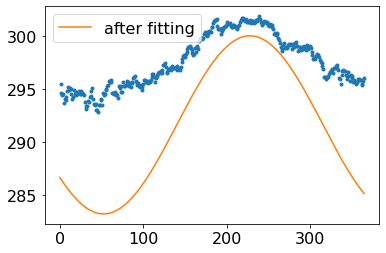

In [93]:
import numpy as np
from scipy.optimize import leastsq
import pylab as plt

t = dates_x_sst
# data = sst_mean.gs_sst-273

# t = np.array(doy_list)
# data = np.array(max_temp_list)

# t = np.array(day_of_year_chla)
# data = (chla_mean.coastal_chla + chla_mean.gs_chla)/2

data = sst_mean.gs_sst


# data = sst_seasonal.groupby('doy').mean().coastal_sst-273.15
# t = sst_seasonal.groupby('doy').mean().index


guess_mean = np.mean(data)
guess_std = 3*np.std(data)/(2**0.5)/(2**0.5)
guess_phase = 365-200
guess_freq = 1/60
guess_amp = np.quantile(data,.7) - np.quantile(data,.3)

# we'll use this to plot our first estimate. This might already be good enough for you
data_first_guess = guess_amp*np.sin(guess_freq*t+guess_phase) + guess_mean

# Define the function to optimize, in this case, we want to minimize the difference
# between the actual data and our "guessed" parameters
optimize_func = lambda x: x[0]*np.sin(x[1]*t+x[2]) + x[3] - data
sst_est_amp, sst_est_freq, sst_est_phase, sst_est_mean = leastsq(optimize_func, [guess_amp, guess_freq, guess_phase, guess_mean])[0]

# recreate the fitted curve using the optimized parameters
data_fit = sst_est_amp*np.sin(sst_est_freq*t+sst_est_phase) + sst_est_mean

# recreate the fitted curve using the optimized parameters

fine_t_coast = np.arange(0,max(t),0.1)
# fine_t_custom = np.arange(0,max(t),0.1)
# data_fit_coast=sst_est_amp*np.sin(sst_est_freq*fine_t_coast+sst_est_phase)+sst_est_mean
data_fit_gs=sst_est_amp*np.sin(sst_est_freq*fine_t_coast+sst_est_phase)+sst_est_mean
# data_fit_custom=sst_est_amp*np.sin(sst_est_freq*fine_t+sst_est_phase)+sst_est_mean

plt.plot(t, data, '.')
# plt.scatter(t, data_first_guess, label='first guess')
plt.plot(fine_t_coast, data_fit_coast, label='after fitting')
plt.legend()
plt.show()

In [627]:
sst_est_freq

0.01997109545231175

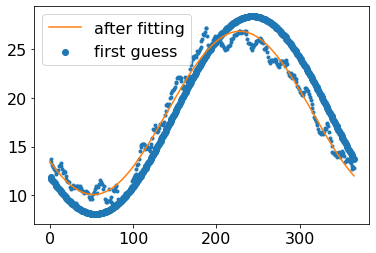

In [410]:
import numpy as np
from scipy.optimize import leastsq
import pylab as plt

# t = dates_x_sst
# data = sst_mean.gs_sst-273

# t = np.array(doy_list)
# data = np.array(max_temp_list)

data = sst_seasonal.groupby('doy').mean().coastal_sst-273.15
t = sst_seasonal.groupby('doy').mean().index


guess_mean = np.mean(data)
guess_std = 3*np.std(data)/(2**0.5)/(2**0.5)
guess_phase = 230
guess_freq = 1/60
guess_amp = np.quantile(data,.7) - np.quantile(data,.3)

# we'll use this to plot our first estimate. This might already be good enough for you
data_first_guess = guess_amp*np.sin(guess_freq*t+guess_phase) + guess_mean

# Define the function to optimize, in this case, we want to minimize the difference
# between the actual data and our "guessed" parameters
optimize_func = lambda x: x[0]*np.sin(x[1]*t+x[2]) + x[3] - data
sst_est_amp, sst_est_freq, sst_est_phase, sst_est_mean = leastsq(optimize_func, [guess_amp, guess_freq, guess_phase, guess_mean])[0]

# recreate the fitted curve using the optimized parameters
data_fit = sst_est_amp*np.sin(sst_est_freq*t+sst_est_phase) + sst_est_mean

# recreate the fitted curve using the optimized parameters

fine_t = np.arange(0,max(t),0.1)
data_fit=sst_est_amp*np.sin(sst_est_freq*fine_t+sst_est_phase)+sst_est_mean

plt.plot(t, data, '.')
plt.scatter(t, data_first_guess, label='first guess')
plt.plot(fine_t, data_fit, label='after fitting')
plt.legend()
plt.show()

almost the exact same when fitting with the satellite data

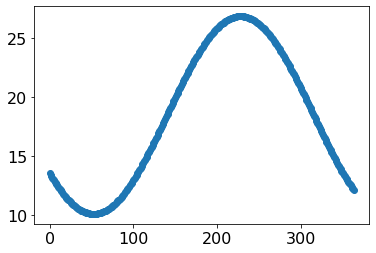

In [45]:
doy = np.arange(0,365,1)
def provide_coastal_temp_threshold(doy,buffer=0.0):
    temp_est = 8.4014*np.sin(0.017901*doy+229.96753) + 18.46590
    return(temp_est-buffer)

temp_est = provide_coastal_temp_threshold(doy)

plt.scatter(doy,temp_est)

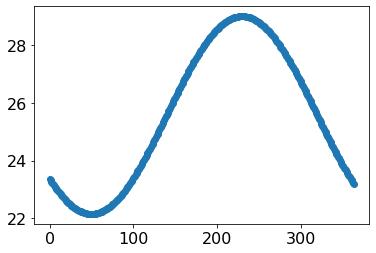

In [46]:
doy = np.arange(0,365,1)
def provide_gs_temp_threshold(doy,buffer=0.0):
    temp_est = 3.41998*np.sin(0.01744*doy+230.0397) + 25.5743
    return(temp_est-buffer)

temp_est = provide_gs_temp_threshold(doy)

plt.scatter(doy,temp_est)

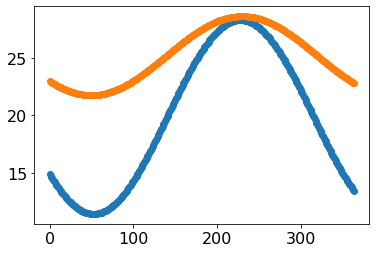

In [47]:
temp_est = provide_coastal_temp_threshold(doy,buffer=-1.4)

plt.scatter(doy,temp_est)
temp_est = provide_gs_temp_threshold(doy,buffer=0.4)

plt.scatter(doy,temp_est)

### Here we're adding acoustic backscatter and current speed into the profile data so we can compare that with the other measurements

In [63]:
profiles['ekbackscatter'] = np.nan
profiles['current_mag'] = np.nan

for idx,fn in enumerate(filenames):
    if idx in [0,1,2,3]:
        continue
    try:
        ##########
#     else:
        dist = scipy.io.loadmat(fn+'_distance.mat')['distance']
        sst = scipy.io.loadmat(fn+'_SST.mat')['SST']
        time = scipy.io.loadmat(fn+'_time.mat')['time']
        timestamps = pd.to_datetime(time[0,:]-719529, unit='D')
       
        
#         if idx in [5,28,39,40,41]:
#             dist = (dist - dist[-1])*-1
        
        X = scipy.io.loadmat(fn+'_X.mat')['X']
        Y = scipy.io.loadmat(fn+'_Y.mat')['Y']
        vMag = scipy.io.loadmat(fn+'_vmag.mat')['C']

        vDir = scipy.io.loadmat(fn+'_vdir.mat')['C']
        
        vShear = scipy.io.loadmat(fn+'_vshear.mat')['C']
        
        echo = scipy.io.loadmat(fn+'_echo.mat')['C']
        Xecho = scipy.io.loadmat(fn+'_Xecho.mat')['X']
        Yecho = scipy.io.loadmat(fn+'_Yecho.mat')['Y']
        
        # correcting for the smaller bin size
        Yecho = (Yecho*0.502)-1
        
        echo_reshape = echo.reshape(-1,127).T
        vMag_reshape = vMag.reshape(-1,69).T
        
        lat = scipy.io.loadmat(fn+'_lat.mat')['lat']
        long = scipy.io.loadmat(fn+'_long.mat')['long']
        
        # the distances are crazy wrong sometimes so re-calcuating the distance
        coords_1 = (lat[0], long[0])
        distances = []
        for i in range(len(lat)):
            coords_2 = (lat[i], long[i])
            distances.append(distance.geodesic(coords_1, coords_2).meters)
        dist = np.array(distances)       
#         bogus_dist_locations = dist > 35000        
#         dist[dist > 25000] = np.nan
#         dist = pd.Series(dist).interpolate().values
        # checking if the current point is within 500 of one that was good, assuming the first point is good
        # then if not setting it to nan and interpolating it out
        last_good_idx = 0
        bad_idxs = []
        for di,d in enumerate(dist):
            if dist[di] - dist[last_good_idx] < 500:
                last_good_idx = di
            else:
                bad_idxs.append(di)
        dist[bad_idxs] = np.nan
        dist = pd.Series(dist).interpolate().values

        dist = dist.reshape(-1,1)
        
        adcp_df = pd.DataFrame({'dt':timestamps,
                    'datetime':timestamps,
                    'sst':sst[:,0],
                    'lat': lat[:,0],
                    'lon':long[:,0],
                    'dist':dist[:,0]})

        adcp_df = adcp_df.set_index('dt')
        adcp_df = adcp_df.sort_index(ascending=True)
        
        
        # find the adcp data with the closest location to each profile in distance space 
        # and then grab the echosounder data from that
        
        # the logic could be
        # grab the closest ek sounding in time with the profile data
        # then use that distance to average +/- the last 10 EK soundings
        # interpolate that into the profile depth and don't extrapolate
        # do this for each transect via just having a time tolerance of ~30 seconds
        profiles_subset = profiles.loc[timestamps[0]:timestamps[-1]]
        profiles_subset = profile_locs(profiles_subset, adcp_df)
        
        profile_nums = profiles_subset.profile_num.unique()
        profile_num_idx = 0

        for row in profiles_subset.itertuples(index=False):
            try:
                if row.profile_num == profile_nums[profile_num_idx]:
#                     print(np.abs(dist - row.dist).min())
                    dist_arg = np.abs(dist - row.dist).argmin()
                    # we don't want the matchs to be very far away and better to keep as nans if so
                    if np.abs(dist - row.dist).min() > 5:
                        print('greater than 5m')
                        continue
                    ek_for_profile = np.interp(abs(profiles_subset[profiles_subset.profile_num == profile_nums[profile_num_idx]]['depth (dBars)'].values), abs(Yecho[:127,0]), np.nanmedian(echo_reshape[:,dist_arg-20:dist_arg+20],axis=1),left=np.nan, right=np.nan)
                    mag_for_profile = np.interp(abs(profiles_subset[profiles_subset.profile_num == profile_nums[profile_num_idx]]['depth (dBars)'].values), abs(Y[:69,0]), np.nanmedian(vMag_reshape[:,dist_arg-20:dist_arg+20],axis=1),left=np.nan, right=np.nan)
         
                    
                    m = profiles_subset.profile_num == profile_nums[profile_num_idx]
                    
                    profiles_subset.loc[m,'ekbackscatter'] = ek_for_profile
                    profiles_subset.loc[m,'current_mag'] = mag_for_profile
                    
                    profile_num_idx+=1

            except IndexError:
        #         print('index error')
                pass

        profiles.loc[timestamps[0]:timestamps[-1],'ekbackscatter'] = profiles_subset.ekbackscatter 
        profiles.loc[timestamps[0]:timestamps[-1],'current_mag'] = profiles_subset.current_mag 
#         break
        
    except Exception as e: 
        print(e)



/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


cannot convert input with unit 'D'


In [64]:
ek_for_profile = np.interp(abs(profiles_subset[profiles_subset.profile_num == profile_nums[profile_num_idx-1]]['depth (dBars)'].values), abs(Yecho[:127,0]), np.nanmedian(echo_reshape[:,dist_arg-20:dist_arg+20],axis=1),left=np.nan, right=np.nan)

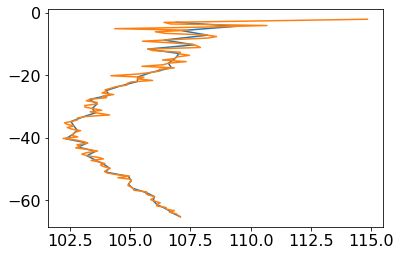

In [65]:
plt.plot(ek_for_profile,profiles_subset[profiles_subset.profile_num == profile_nums[profile_num_idx-1]]['depth (dBars)'].values)
plt.plot(np.nanmedian(echo_reshape[:,dist_arg-20:dist_arg+20],axis=1),Yecho[:127,0])

In [66]:
vmag_for_profile = np.interp(abs(profiles_subset[profiles_subset.profile_num == profile_nums[profile_num_idx-1]]['depth (dBars)'].values), abs(Y[:69,0]), np.nanmedian(vMag_reshape[:,dist_arg-20:dist_arg+20],axis=1),left=np.nan, right=np.nan)

/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


Just make sure the interpolated version looks good compared to the actual data

/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


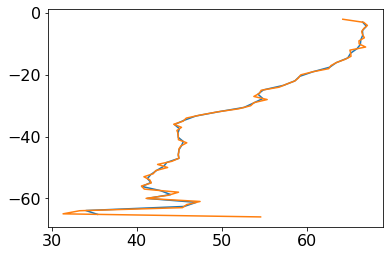

In [67]:
plt.plot(vmag_for_profile,profiles_subset[profiles_subset.profile_num == profile_nums[profile_num_idx-1]]['depth (dBars)'].values)
plt.plot(np.nanmedian(vMag_reshape[:,dist_arg-20:dist_arg+20],axis=1),Y[:69,0])

#### Setting up the grid for T-S diagrams

In [48]:
import gsw
# Figure out boudaries (mins and maxs)
smin = 32-.7
smax = 37+.7
tmin = 8-.7 
tmax = 30+.7

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000

Just grab start and stop times

In [56]:
front_transects = []
front_locations = []
time_starts = []
time_stops = []

for idx,fn in enumerate(filenames):
#     if idx not in tentative_good_idxs:
# #         continue
    if idx in [0,1,2,3]:
        continue
#     if idx not in [16, 17, 30, 36,43, 49,52,64]:
#         continue
#     if idx != 9:
#         continue
#     if idx not in [38,58]:
#         continue

    print(idx)
    print(fn)
    print('---')
    print(datetimes[idx].strftime("%d. %B %Y %I:%M%p UTC"))
    
    try:

        dist = scipy.io.loadmat(fn+'_distance.mat')['distance']
        sst = scipy.io.loadmat(fn+'_SST.mat')['SST']
        time = scipy.io.loadmat(fn+'_time.mat')['time']
        timestamps = pd.to_datetime(time[0,:]-719529, unit='D')
            
#         if idx in [5,28,39,40,41]:
#             dist = (dist - dist[-1])*-1
        
        X = scipy.io.loadmat(fn+'_X.mat')['X']
        Y = scipy.io.loadmat(fn+'_Y.mat')['Y']
        vMag = scipy.io.loadmat(fn+'_vmag.mat')['C']

        vDir = scipy.io.loadmat(fn+'_vdir.mat')['C']
        
        vShear = scipy.io.loadmat(fn+'_vshear.mat')['C']
        
        echo = scipy.io.loadmat(fn+'_echo.mat')['C']
        Xecho = scipy.io.loadmat(fn+'_Xecho.mat')['X']
        Yecho = scipy.io.loadmat(fn+'_Yecho.mat')['Y']
        
        # correcting for the smaller bin size
        Yecho = (Yecho*0.502)-1
        
        lat = scipy.io.loadmat(fn+'_lat.mat')['lat']
        long = scipy.io.loadmat(fn+'_long.mat')['long']
        
        # the distances are crazy wrong sometimes so re-calcuating the distance
        coords_1 = (lat[0], long[0])
        distances = []
        for i in range(len(lat)):
            coords_2 = (lat[i], long[i])
            distances.append(distance.geodesic(coords_1, coords_2).meters)
        dist = np.array(distances)       
#         bogus_dist_locations = dist > 35000        
#         dist[dist > 25000] = np.nan
#         dist = pd.Series(dist).interpolate().values
        # checking if the current point is within 500 of one that was good, assuming the first point is good
        # then if not setting it to nan and interpolating it out
        last_good_idx = 0
        bad_idxs = []
        for di,d in enumerate(dist):
            if dist[di] - dist[last_good_idx] < 500:
                last_good_idx = di
            else:
                bad_idxs.append(di)
        dist[bad_idxs] = np.nan
        dist = pd.Series(dist).interpolate().values

        dist = dist.reshape(-1,1)
        
        adcp_df = pd.DataFrame({'dt':timestamps,
                    'datetime':timestamps,
                    'sst':sst[:,0],
                    'lat': lat[:,0],
                    'lon':long[:,0],
                    'dist':dist[:,0]})

        adcp_df = adcp_df.set_index('dt')
        adcp_df = adcp_df.sort_index(ascending=True)
        
        adcp_gdf = gpd.GeoDataFrame(
            adcp_df, geometry=gpd.points_from_xy(adcp_df.lon, adcp_df.lat))
        
        ##################
        # calculate the front
        
        sal_vmp, temp_vmp, chla_vmp, turb_vmp, dt_vmp, dist_vmp  = grab_vmp_data(profiles, adcp_df, timestamps[0],timestamps[-1])
        
        # find the location using the salinity gs threshold I made and then find where the change happens
        sal_est = provide_gs_sal_threshold(timestamps[0].timetuple().tm_yday, buffer=0.6)
        gs_water = sal_vmp > sal_est
        idx_of_sal_front = np.where(gs_water[:-1] != gs_water[1:])[0]
        sal_front_location = (dist_vmp[idx_of_sal_front]+dist_vmp[idx_of_sal_front+1])/2
#         if not sal_front_location.size > 0:
#             continue
            
        front_transects.append(idx)
        front_locations.append(sal_front_location)
        time_starts.append(timestamps[0])
        time_stops.append(timestamps[-1])
#         if True:
#             continue
        


    except Exception as e: 
        print('had an error')
        print(e)
    print('#############################################################')
#         print('##################################################################################################################################################')
#         print('##################################################################################################################################################')

4
data/all_adcp/processed/101706_20201010T132417UTC_100s
---
10. October 2020 01:00PM UTC
#############################################################
5
data/all_adcp/processed/101706_20201010T141504UTC_100s
---
10. October 2020 02:00PM UTC
#############################################################
6
data/all_adcp/processed/101706_20201011T135347UTC_100s
---
11. October 2020 01:00PM UTC
#############################################################
7
data/all_adcp/processed/101706_20201015T142907UTC_100s
---
15. October 2020 02:00PM UTC
#############################################################
8
data/all_adcp/processed/101706_20201015T164414UTC_100s
---
15. October 2020 04:00PM UTC
#############################################################
9
data/all_adcp/processed/101706_20201016T130156UTC_100s
---
16. October 2020 01:00PM UTC
#############################################################
10
data/all_adcp/processed/101706_20201016T161245UTC_100s
---
16. October 2020 04:00PM U

The transects that seem to actually be in the GS and cross a current front are:

The chla and turbidity data have some issues, the chla is offset but generally clean and the turbidity has more issues

In [56]:
import gsw
chla = profiles['chla (ppb)'].values.copy()
chla[chla > 1.5] = 2
chla[chla < -0.3] = -0.3
chla = chla + abs(chla.min())

profiles['chla_clean'] = chla

###

turbidity = profiles['turbidity (FTU)'].values.copy()
turbidity[turbidity > 4] = 4

profiles['turbidity_clean'] = turbidity

profiles['spice'] = gsw.spiciness0(profiles['salinity (PSU)'], profiles['temp (C)'])

In [46]:
profiles_shelf = profiles[profiles['salinity (PSU)'] < 34.8]
profiles_shelf = profiles_shelf[profiles_shelf['depth (dBars)']>-50]

In [47]:
profiles_gs = profiles[profiles['salinity (PSU)'] > 34.8]
profiles_gs = profiles_gs[profiles_gs['depth (dBars)']>-50]

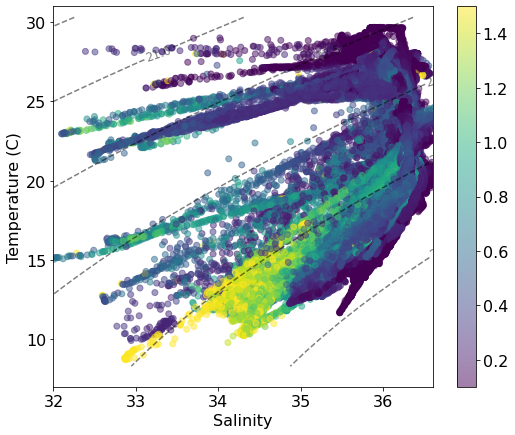

In [212]:
# plot T and S diagrams first with distance from coast and then with other variables
fig, ax = plt.subplots(figsize=(8.5,7))
markersize=40

ax.set_xlim(32,36.6)
ax.set_ylim(7,31)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level

# im = ax.scatter(profiles[profiles['depth (dBars)'] < -35]['salinity (PSU)'], profiles[profiles['depth (dBars)'] < -35]['temp (C)'], c=profiles[profiles['depth (dBars)'] < -35].datetime.dt.day_of_year, cmap=cmocean.cm.phase, alpha=0.1)
im = ax.scatter(profiles['salinity (PSU)'], profiles['temp (C)'], c=profiles.chla_clean, cmap='viridis',alpha=0.5,vmin=.1,vmax=1.5)

fig.colorbar(im)
plt.show()

In [41]:
pd.options.mode.chained_assignment = None  # default='warn'

In [43]:
from natsort import natsorted

### Go through all the transects and calculate a wide range of parameters

In [241]:
list_of_sst_gdf = []
list_of_sst_adcp_gdf = []
list_of_chla_prof = []
list_of_distances_bw_gs_coast = []

list_of_chla_zero_corr_list = []
list_of_spice_zero_corr_list = []
list_of_sal_zero_corr_list = []
list_of_depth_chla_zero_corr_list = []
list_of_depth_spice_zero_corr_list = []
list_of_depth_sal_zero_corr_list = []

list_of_spectra_chla = []
list_of_spectra_spice = []
list_of_spectra_f_chla = []
list_of_spectra_f_spice = []

list_of_idx_for_corr = []
list_of_adcp_gdf_for_corr = []
list_of_sat_gdf_for_corr = []

list_of_prof_num = []

time_starts = []
time_stops = []

idx_list = []

counter = 0
idx_counter = 0
for idx,fn in enumerate(filenames):
    if idx in [0,1,2,3]:
        continue
#     if idx <35:
#         continue
    #     if idx not in gs_current_idxs:
    #     if idx not in archetype_idxs:
    #         continue
    #     if idx not in [gs_index_list_for_enhanced_test[x] for x in [2,7,15,17,18,23,25]]: # these are the ones I saw are clearly enhanced at or near the front
    #         continue
    #     if idx not in [38, 40, 58]:
    #         continue
    #     if idx != 64:
    #         continue
    print(idx)
    print(fn)

    try:
        
        dist = scipy.io.loadmat(fn+'_distance.mat')['distance']
        sst = scipy.io.loadmat(fn+'_SST.mat')['SST']
        time = scipy.io.loadmat(fn+'_time.mat')['time']
        timestamps = pd.to_datetime(time[0,:]-719529, unit='D')

        X = scipy.io.loadmat(fn+'_X.mat')['X']
        Y = scipy.io.loadmat(fn+'_Y.mat')['Y']
        vMag = scipy.io.loadmat(fn+'_vmag.mat')['C']

        vDir = scipy.io.loadmat(fn+'_vdir.mat')['C']

        echo = scipy.io.loadmat(fn+'_echo.mat')['C']
        Xecho = scipy.io.loadmat(fn+'_Xecho.mat')['X']
        Yecho = scipy.io.loadmat(fn+'_Yecho.mat')['Y']
        # correcting for the smaller bin size
        Yecho = (Yecho*0.502)-1

        lat = scipy.io.loadmat(fn+'_lat.mat')['lat']
        long = scipy.io.loadmat(fn+'_long.mat')['long']

        # the distances are crazy wrong sometimes so re-calcuating the distance
        coords_1 = (lat[0], long[0])
        distances = []
        for i in range(len(lat)):
            coords_2 = (lat[i], long[i])
            distances.append(distance.geodesic(coords_1, coords_2).meters)
        dist = np.array(distances)       
    #         bogus_dist_locations = dist > 35000        
    #         dist[dist > 25000] = np.nan
    #         dist = pd.Series(dist).interpolate().values
        # checking if the current point is within 500 of one that was good, assuming the first point is good
        # then if not setting it to nan and interpolating it out
        last_good_idx = 0
        bad_idxs = []
        for di,d in enumerate(dist):
            if dist[di] - dist[last_good_idx] < 500:
                last_good_idx = di
            else:
                bad_idxs.append(di)
        dist[bad_idxs] = np.nan
        sst[bad_idxs] = np.nan
        dist = pd.Series(dist).interpolate().values

        dist = dist.reshape(-1,1)

        adcp_df = pd.DataFrame({'dt':timestamps,
                        'datetime':timestamps,
                                'sst':sst[:,0],
                       'lat': lat[:,0],
                       'lon':long[:,0],
                               'dist':dist[:,0]})

        adcp_df = adcp_df.set_index('dt')
        adcp_df = adcp_df.sort_index(ascending=True)
        
        adcp_gdf = gpd.GeoDataFrame(
            adcp_df, geometry=gpd.points_from_xy(adcp_df.lon, adcp_df.lat))
        
        adcp_gdf['current_mag'] = np.nan
        adcp_gdf['current_grad'] = np.nan
        
        list_of_sst_adcp_gdf.append(adcp_gdf)
        
        sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[idx])
        
        #######################
        
        mid_lat = adcp_gdf.lat.median()
        mid_lon = adcp_gdf.lon.median()
        sst_lat_list = xr.DataArray(np.arange(mid_lat+.5,mid_lat-0.5,step=-0.02), dims='z')
        sst_lon_list = xr.DataArray(np.arange(mid_lon-.5,mid_lon+0.5,step=0.02), dims='z')

        sst_loc_df = pd.DataFrame(
            {'value': np.arange(0,50),
             'Latitude': sst_lat_list.values,
             'Longitude': sst_lon_list.values})

        sst_loc_gdf = gpd.GeoDataFrame(
            sst_loc_df, geometry=gpd.points_from_xy(sst_loc_df.Longitude, sst_loc_df.Latitude))

        sst_loc_gdf['sst'] = sst_ds.sel(longitude=sst_lon_list, latitude=sst_lat_list, method="nearest", tolerance=0.02).sea_surface_temperature[1].values
        list_of_sst_gdf.append(sst_loc_gdf)


        time_starts.append(timestamps[0])
        time_stops.append(timestamps[-1])
        

        ##################################
        
        profiles_subset = profiles.loc[timestamps[0]:timestamps[-1]]

        profiles_subset = profile_locs(profiles_subset, adcp_df)
        
        list_of_chla_prof.append(profiles_subset[(profiles_subset['depth (dBars)'] < -1.5) & (profiles_subset['depth (dBars)'] > -8)].groupby('profile_num',dropna=False).mean())
        
#         surf_profs = profiles_subset[profiles_subset['depth (dBars)']>-10]
#         surf_profs = surf_profs.groupby('profile_num').mean().sort_values('dist')
        
        profiles_subset = profiles_subset[profiles_subset['depth (dBars)'] < -3]
             
        
        ### calc decorrelation scales

        chla_zero_corr_list = []
        spice_zero_corr_list = []
        sal_zero_corr_list = []
        depth_chla_zero_corr_list = []
        depth_spice_zero_corr_list = []
        depth_sal_zero_corr_list = []
        
        profiles_subset = profiles_subset[profiles_subset['depth (dBars)']>-80]
        
        depth_max = [0,-15,-25,-35,-45,0]
        depth_min = [-10,-25,-35,-45,-55,-55]
        vars_for_calc = ['spice','salinity (PSU)','chla_clean']

        spice_list_autocorr = []
        chla_list_autocorr = []
        sal_list_autocorr = []

        for var_i, ax in enumerate([1,2,3]):

            var_for_cal = vars_for_calc[var_i]

            for depth_i in range(len(depth_max)):
                input_df = profiles_subset[(profiles_subset['depth (dBars)'] < depth_max[depth_i]) & (profiles_subset['depth (dBars)'] > depth_min[depth_i])].groupby('profile_num',dropna=False).mean()
                input_df = input_df.reindex(index=natsorted(input_df.index))
                nlags = len(input_df)-1

                if var_for_cal == 'spice':
                    autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
                    below_zero_idx = np.argmax(autocorr<0)
                    spice_zero_corr_list.append(input_df['dist'].iloc[below_zero_idx].astype(int))

                    spice_list_autocorr.append(autocorr)
                elif var_for_cal == 'chla_clean':
                    autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
                    below_zero_idx = np.argmax(autocorr<0)
                    chla_zero_corr_list.append(input_df['dist'].iloc[below_zero_idx].astype(int))

                    chla_list_autocorr.append(autocorr)
                elif var_for_cal == 'salinity (PSU)':
                    autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
                    below_zero_idx = np.argmax(autocorr<0)
                    sal_zero_corr_list.append(input_df['dist'].iloc[below_zero_idx].astype(int))

                    sal_list_autocorr.append(autocorr)

     
        ### calc decorrelation scales

   
        vars_for_calc = ['spice','salinity (PSU)','chla_clean']
        
        profiles_subset[profiles_subset['depth (dBars)']>-80]

        spice_list_autocorr = []
        chla_list_autocorr = []
        sal_list_autocorr = []

        for var_i, ax in enumerate([1,2,3]):

            var_for_cal = vars_for_calc[var_i]

            for prof_i in natsorted(np.unique(profiles_subset.profile_num)):
                input_df = profiles_subset[profiles_subset.profile_num == prof_i]
                nlags = len(input_df)-1

                if var_for_cal == 'spice':
                    list_of_prof_num.append(input_df.profile_num.iloc[0])

                    autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
                    below_zero_idx = np.argmax(autocorr<0)
                    depth_spice_zero_corr_list.append(input_df['depth (dBars)'].iloc[below_zero_idx])

                    spice_list_autocorr.append(autocorr)
                elif var_for_cal == 'chla_clean':

                    autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
                    below_zero_idx = np.argmax(autocorr<0)
                    depth_chla_zero_corr_list.append(input_df['depth (dBars)'].iloc[below_zero_idx])

                    chla_list_autocorr.append(autocorr)
                elif var_for_cal == 'salinity (PSU)':

                    autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
                    below_zero_idx = np.argmax(autocorr<0)
                    depth_sal_zero_corr_list.append(input_df['depth (dBars)'].iloc[below_zero_idx])

                    sal_list_autocorr.append(prof_i)
                    
                
        
        list_of_chla_zero_corr_list.append(chla_zero_corr_list)
        list_of_spice_zero_corr_list.append(spice_zero_corr_list)
        list_of_sal_zero_corr_list.append(sal_zero_corr_list)
        
        list_of_depth_chla_zero_corr_list.append(depth_chla_zero_corr_list)
        list_of_depth_spice_zero_corr_list.append(depth_spice_zero_corr_list)
        list_of_depth_sal_zero_corr_list.append(depth_sal_zero_corr_list)
        
        list_of_idx_for_corr.append(idx)
        list_of_adcp_gdf_for_corr.append(adcp_gdf)
        list_of_sat_gdf_for_corr.append(sst_loc_gdf)

        ###################################
        

        idx_list.append(idx)
        
        print('--------------------------------------')

    except Exception as e: 
        print(e)
    

4
data/all_adcp/processed/101706_20201010T132417UTC_100s
--------------------------------------
5
data/all_adcp/processed/101706_20201010T141504UTC_100s
--------------------------------------
6
data/all_adcp/processed/101706_20201011T135347UTC_100s
--------------------------------------
7
data/all_adcp/processed/101706_20201015T142907UTC_100s
--------------------------------------
8
data/all_adcp/processed/101706_20201015T164414UTC_100s


/srv/conda/envs/notebook/lib/python3.8/site-packages/statsmodels/tsa/stattools.py:681: RuntimeWarning: invalid value encountered in true_divide
  acf = avf[: nlags + 1] / avf[0]


--------------------------------------
9
data/all_adcp/processed/101706_20201016T130156UTC_100s
--------------------------------------
10
data/all_adcp/processed/101706_20201016T161245UTC_100s
--------------------------------------
11
data/all_adcp/processed/101706_20201020T131543UTC_100s
--------------------------------------
12
data/all_adcp/processed/101706_20201020T133400UTC_100s
--------------------------------------
13
data/all_adcp/processed/101706_20201020T155242UTC_100s
--------------------------------------
14
data/all_adcp/processed/101706_20210414T131027UTC_100s
--------------------------------------
15
data/all_adcp/processed/101706_20210414T155313UTC_100s
--------------------------------------
16
data/all_adcp/processed/101706_20210420T123333UTC_100s
--------------------------------------
17
data/all_adcp/processed/101706_20210420T151905UTC_100s
--------------------------------------
18
data/all_adcp/processed/101706_20210421T123205UTC_100s
-------------------------------

/srv/conda/envs/notebook/lib/python3.8/site-packages/statsmodels/tsa/stattools.py:467: RuntimeWarning: Mean of empty slice.
  xo = x - x.mean()
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


negative dimensions are not allowed
29
data/all_adcp/processed/101706_20210826T120738UTC_100s
--------------------------------------
30
data/all_adcp/processed/101706_20210826T210853UTC_100s
--------------------------------------
31
data/all_adcp/processed/101706_20210827T112801UTC_100s
--------------------------------------
32
data/all_adcp/processed/101706_20210827T160913UTC_100s


/srv/conda/envs/notebook/lib/python3.8/site-packages/statsmodels/tsa/stattools.py:467: RuntimeWarning: Mean of empty slice.
  xo = x - x.mean()
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


negative dimensions are not allowed
33
data/all_adcp/processed/101706_20210827T222427UTC_100s


/srv/conda/envs/notebook/lib/python3.8/site-packages/statsmodels/tsa/stattools.py:467: RuntimeWarning: Mean of empty slice.
  xo = x - x.mean()
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


negative dimensions are not allowed
34
data/all_adcp/processed/101706_20210828T104556UTC_100s
--------------------------------------
35
data/all_adcp/processed/101706_20210828T151028UTC_100s
--------------------------------------
36
data/all_adcp/processed/101706_20210828T201542UTC_100s
--------------------------------------
37
data/all_adcp/processed/101706_20210829T110409UTC_100s
cannot convert input with unit 'D'
38
data/all_adcp/processed/101706_20210829T162104UTC_100s
--------------------------------------
39
data/all_adcp/processed/101706_20210905T145056UTC_100s
--------------------------------------
40
data/all_adcp/processed/101706_20210906T121429UTC_100s
--------------------------------------
41
data/all_adcp/processed/101706_20210906T164454UTC_100s
--------------------------------------
42
data/all_adcp/processed/101706_20210907T123502UTC_100s
--------------------------------------
43
data/all_adcp/processed/101706_20211005T124141UTC_100s
-------------------------------------

/srv/conda/envs/notebook/lib/python3.8/site-packages/statsmodels/tsa/stattools.py:467: RuntimeWarning: Mean of empty slice.
  xo = x - x.mean()
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


negative dimensions are not allowed
61
data/all_adcp/processed/101706_20220403T143129UTC_100s
--------------------------------------
62
data/all_adcp/processed/101706_20220403T164356UTC_100s


/srv/conda/envs/notebook/lib/python3.8/site-packages/statsmodels/tsa/stattools.py:467: RuntimeWarning: Mean of empty slice.
  xo = x - x.mean()
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


negative dimensions are not allowed
63
data/all_adcp/processed/101706_20220404T120954UTC_100s
--------------------------------------
64
data/all_adcp/processed/101706_20220404T145648UTC_100s
--------------------------------------
65
data/all_adcp/processed/101706_20220404T194713UTC_100s
--------------------------------------
66
data/all_adcp/processed/101706_20220405T120045UTC_100s
--------------------------------------
67
data/all_adcp/processed/101706_20220405T150549UTC_100s
--------------------------------------
68
data/all_adcp/processed/101706_20220405T184629UTC_100s
--------------------------------------


### Check if a transect crosses the GS temp front

In [60]:
crosses_gs = []
for g in list_of_adcp_gdf_for_corr:
    coastal_sst = provide_coastal_temp_threshold(g.datetime.dt.day_of_year[0], buffer=-1.5)
    gs_sst = provide_gs_temp_threshold(g.datetime.dt.day_of_year[0], buffer=0.5)
    crosses_gs.append(((g.sst > gs_sst).any()) & ((g.sst < gs_sst).any()))

In [92]:
cross_gs_idx = np.array(list_of_idx_for_corr)[crosses_gs]
cross_gs_idx

array([ 5,  6,  7,  8,  9, 10, 12, 13, 16, 17, 19, 20, 22, 23, 24, 26, 27,
       29, 31, 34, 35, 38, 40, 41, 42, 43, 44, 45, 46, 48, 50, 51, 52, 53,
       54, 55, 57, 58, 59, 63, 64, 65, 66, 67, 68])

In [49]:
cross_gs_idx = np.array([ 5,  6,  7,  8,  9, 10, 12, 13, 16, 17, 19, 20, 22, 23, 24, 26, 27,
       29, 31, 34, 35, 38, 40, 41, 42, 43, 44, 45, 46, 48, 50, 51, 52, 53,
       54, 55, 57, 58, 59, 63, 64, 65, 66, 67, 68])

In [49]:
len(cross_gs_idx)

45

## This generates the full vizualization for each transect

In [2]:
list_of_sst_gdf = []
list_of_sst_adcp_gdf = []
list_of_chla_prof = []
list_of_distances_bw_gs_coast = []

list_of_chla_zero_corr_list = []
list_of_spice_zero_corr_list = []
list_of_sal_zero_corr_list = []
list_of_depth_chla_zero_corr_list = []
list_of_depth_spice_zero_corr_list = []
list_of_depth_sal_zero_corr_list = []

list_of_spectra_chla = []
list_of_spectra_spice = []
list_of_spectra_f_chla = []
list_of_spectra_f_spice = []

list_of_idx_for_corr = []
list_of_adcp_gdf_for_corr = []
list_of_sat_gdf_for_corr = []

time_starts = []
time_stops = []

idx_list = []

counter = 0
idx_counter = 0
for idx,fn in enumerate(filenames):
    if idx in [0,1,2,3]:
        continue
#     if idx not in [38,41,58]:# cross_gs_idx:
    if idx not in cross_gs_idx:
        continue
#     if idx not in [52]:
#         continue

#     if idx <35:
#         continue
    #     if idx not in gs_current_idxs:
    #     if idx not in archetype_idxs:
    #         continue
    #     if idx not in [gs_index_list_for_enhanced_test[x] for x in [2,7,15,17,18,23,25]]: # these are the ones I saw are clearly enhanced at or near the front
    #         continue
    #     if idx not in [38, 40, 58]:
    #         continue
    #     if idx != 64:
    #         continue
    print(idx)
    print(fn)

    try:
        
        dist = scipy.io.loadmat(fn+'_distance.mat')['distance']
        sst = scipy.io.loadmat(fn+'_SST.mat')['SST']
        time = scipy.io.loadmat(fn+'_time.mat')['time']
        timestamps = pd.to_datetime(time[0,:]-719529, unit='D')

        X = scipy.io.loadmat(fn+'_X.mat')['X']
        Y = scipy.io.loadmat(fn+'_Y.mat')['Y']
        vMag = scipy.io.loadmat(fn+'_vmag.mat')['C']

        vDir = scipy.io.loadmat(fn+'_vdir.mat')['C']

        echo = scipy.io.loadmat(fn+'_echo.mat')['C']
        Xecho = scipy.io.loadmat(fn+'_Xecho.mat')['X']
        Yecho = scipy.io.loadmat(fn+'_Yecho.mat')['Y']
        # correcting for the smaller bin size
        Yecho = (Yecho*0.502)-1

        lat = scipy.io.loadmat(fn+'_lat.mat')['lat']
        long = scipy.io.loadmat(fn+'_long.mat')['long']

        # the distances are crazy wrong sometimes so re-calcuating the distance
        coords_1 = (lat[0], long[0])
        distances = []
        for i in range(len(lat)):
            coords_2 = (lat[i], long[i])
            distances.append(distance.geodesic(coords_1, coords_2).meters)
        dist = np.array(distances)       
    #         bogus_dist_locations = dist > 35000        
    #         dist[dist > 25000] = np.nan
    #         dist = pd.Series(dist).interpolate().values
        # checking if the current point is within 500 of one that was good, assuming the first point is good
        # then if not setting it to nan and interpolating it out
        last_good_idx = 0
        bad_idxs = []
        for di,d in enumerate(dist):
            if dist[di] - dist[last_good_idx] < 500:
                last_good_idx = di
            else:
                bad_idxs.append(di)
        dist[bad_idxs] = np.nan
        sst[bad_idxs] = np.nan
        dist = pd.Series(dist).interpolate().values

        dist = dist.reshape(-1,1)

        adcp_df = pd.DataFrame({'dt':timestamps,
                        'datetime':timestamps,
                                'sst':sst[:,0],
                       'lat': lat[:,0],
                       'lon':long[:,0],
                               'dist':dist[:,0]})

        adcp_df = adcp_df.set_index('dt')
        adcp_df = adcp_df.sort_index(ascending=True)
        
        adcp_gdf = gpd.GeoDataFrame(
            adcp_df, geometry=gpd.points_from_xy(adcp_df.lon, adcp_df.lat))
        
        adcp_gdf['current_mag'] = np.nan
        adcp_gdf['current_grad'] = np.nan
        
        list_of_sst_adcp_gdf.append(adcp_gdf)
        
        sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[idx])
        
        
        ax, front_dist = plot_profiles(profiles, adcp_df, timestamps[0],timestamps[-1], ['potential density (kg/m^3 -1000)'], plot=True)
        plt.close()
        sal_vmp, temp_vmp, chla_vmp, turb_vmp, dt_vmp, dist_vmp  = grab_vmp_data(profiles, adcp_df, timestamps[0],timestamps[-1])
        
        #######################
        
        mid_lat = adcp_gdf.lat.median()
        mid_lon = adcp_gdf.lon.median()
        sst_lat_list = xr.DataArray(np.arange(mid_lat+.5,mid_lat-0.5,step=-0.02), dims='z')
        sst_lon_list = xr.DataArray(np.arange(mid_lon-.5,mid_lon+0.5,step=0.02), dims='z')

        sst_loc_df = pd.DataFrame(
            {'value': np.arange(0,50),
             'Latitude': sst_lat_list.values,
             'Longitude': sst_lon_list.values})

        sst_loc_gdf = gpd.GeoDataFrame(
            sst_loc_df, geometry=gpd.points_from_xy(sst_loc_df.Longitude, sst_loc_df.Latitude))

        sst_loc_gdf['sst'] = sst_ds.sel(longitude=sst_lon_list, latitude=sst_lat_list, method="nearest", tolerance=0.02).sea_surface_temperature[1].values
        list_of_sst_gdf.append(sst_loc_gdf)

        # Now we can select data
        fig, [ax,ax3] = plt.subplots(1,2,figsize=(18,6))
#         ax.plot(sst_loc_gdf.Longitude,sst_loc_gdf.sst, c='grey')
        ax.scatter(sst_loc_gdf.Longitude,sst_loc_gdf.sst, c='red', marker='^', label='Satellite SST')
        ax.plot(adcp_df.lon, adcp_df.sst,lw=3, c='red', label='ADCP SST')
        
        ax.set_title('Large-scale SST Context')
        ax.legend()

        coastal_sst = provide_coastal_temp_threshold(adcp_gdf.datetime.dt.day_of_year[0],buffer=-1.5)
        gs_sst = provide_gs_temp_threshold(adcp_gdf.datetime.dt.day_of_year[0],buffer=0.5)

        try:
            dist_between_gs_coastal = distance.distance((sst_loc_gdf[sst_loc_gdf['sst']<coastal_sst].iloc[-1].Latitude, sst_loc_gdf[sst_loc_gdf['sst']<coastal_sst].iloc[-1].Longitude),
                          (sst_loc_gdf[sst_loc_gdf['sst']>gs_sst].iloc[0].Latitude,sst_loc_gdf[sst_loc_gdf['sst']>gs_sst].iloc[0].Longitude)).meters
            print('Distance b/w GS and Coastal water is '+ str(dist_between_gs_coastal))
        except Exception as e: 
#             print(e)
            dist_between_gs_coastal = np.nan
            print('Transect does not cross into coastal water')
        list_of_distances_bw_gs_coast.append(dist_between_gs_coastal)
        
        
        ax.axhline(coastal_sst,c='green')
        ax.axhline(gs_sst,c='blue')
        
        ax.set_xlim(adcp_gdf.lon.median()-.5,adcp_gdf.lon.median()+.5)

        ax.set_ylabel('SST (C)')
        ax.set_xlabel('longitude')
#         plt.savefig('trans_sst_idx_'+str(idx)+'.png',dpi=300)
        # ax3.scatter(sal_vmp,temp_vmp, c=dist_vmp)

        ax3.scatter(dist_vmp-front_dist,temp_vmp, color='red', label='Profiler SST')
        ax3_twin = ax3.twinx()
        ax3_twin.scatter(dist_vmp-front_dist,sal_vmp, color='black', label='Salinity',alpha=0.7)
        ax3_twin.set_ylim(30,36.5)

        temp_est = provide_gs_temp_threshold(timestamps[0].timetuple().tm_yday, buffer=0.5)
        coastal_temp_est = provide_coastal_temp_threshold(timestamps[0].timetuple().tm_yday, buffer=-1.5)
        ax3.axhline(temp_est, ls='--', c='blue', label='GS T')
        ax3.axhline(coastal_temp_est, ls='--', c='green', label='Shelf T')


        ax3.plot(dist-front_dist,sst, color='red', label='ADCP SST')
        ax3.set_title("Ship-based SST and SSS Transects")
        ax3.set_ylabel('Temp (C)')
        ax3_twin.set_ylabel('Salinity (PSU)')
        ax3.set_xlabel('Distance (m)')
        ax3.set_ylim(15,30)
        
        ax3_twin.legend(loc='lower left')
        ax3.legend(loc='lower right')
        #         ax3.axvline(dist[front_location],color='grey', ls='--')

        if idx not in [5,28,39,40,41]:
            ax3.set_xlim(9500,-3500)    
        else:
            ax3.set_xlim(-9500,3500)
    
        plt.show()
        
        #####################
        
        fig,ax = plt.subplots(1,3,figsize=(22,5.5),subplot_kw=dict(projection=crs.PlateCarree()))

        sst_ds = xr.open_dataset('data/all_front_sst/'+sst_files[idx])

        
        for i in range(3):
            ax[i].coastlines(resolution='10m')
            sst_ds.sea_surface_temperature[i].plot(ax=ax[i], cmap='inferno')
#             sst_loc_gdf.plot(ax=ax[i],c='grey',alpha=0.3)
            adcp_gdf.plot(ax=ax[i],c='red',alpha=0.5)
            
        #     ax[i].set_xlim(-75.75,-73.75)
        #     ax[i].set_ylim(34.5,36.5)
        
#         plt.savefig('sst_idx_'+str(idx)+'.png',dpi=300)
        plt.show()

    #     if enhanced_bool[counter]:
    #         print("This is an enhanced transect.")
    #     counter += 1
    
        ##################
        # calculate the front
        # this is the old calculation based on S and T
        
        
        # find the location using the salinity gs threshold I made and then find where the change happens
#         sal_est = provide_gs_sal_threshold(timestamps[0].timetuple().tm_yday, buffer=0.6)
#         gs_water = sal_vmp > sal_est
#         idx_of_sal_front = np.where(gs_water[:-1] != gs_water[1:])[0]
#         sal_front_location = (dist_vmp[idx_of_sal_front]+dist_vmp[idx_of_sal_front+1])/2
#         if not sal_front_location.size > 0:
#             continue
            
#         front_transects.append(idx)
#         front_locations.append(sal_front_location)
        time_starts.append(timestamps[0])
        time_stops.append(timestamps[-1])
#         if True:
#             continue
        
        ################### this section is for context mostly
        # GOES STUFF
        
        # find the time step with the most data
#         da_subset = goes_ds.sel(time=slice((adcp_df.datetime.min()-timedelta(hours=24)), (adcp_df.datetime.max()+timedelta(hours=24)))).sea_surface_temperature
#         max_coverage_index = da_subset.count(dim=['latitude','longitude']).argmax()
        
        ########################################
        
#         f = plt.figure(figsize=(30,5))
#         ax = f.add_subplot(141, projection=crs.PlateCarree())
#         ax2 = f.add_subplot(142, projection=crs.PlateCarree())
#         ax3 = f.add_subplot(143)
        
        
#         ax4 = f.add_subplot(144)
        
#         ax.set_title('Location of Transect and SSH Front (0.25m)')
#         ax2.set_title('Location Zoom')
#         ax4.set_title('Annual SST Cycle')
        
# #         da_subset[max_coverage_index].plot(ax=ax, cmap='inferno')
# #         goes_ds.sel(time=slice((adcp_df.datetime.min()-timedelta(hours=18)), (adcp_df.datetime.max()+timedelta(hours=18)))).sea_surface_temperature.mean(dim='time').plot(ax=ax, cmap=cmocean.cm.thermal)

#         ax.coastlines(resolution='10m')
#         adcp_gdf.plot(ax=ax, markersize=2, color='green', alpha=1)
# #         front_gdf.iloc[front_gdf.index.get_loc(timestamps[0],method='nearest')-1:front_gdf.index.get_loc(timestamps[0],method='nearest')].plot(ax=ax, label='Todays SSH Front')
# #         front_gdf_median.plot(ax=ax, color='black',alpha=0.3, label='Average SSH Front')
        
# #         ax.legend()
                                                    
# #         ax.set_ylim(35.13000031,36.40999985)
# #         ax.set_xlim(-75.99000549,-74.11000061)
#         # ax.set_ylim(35.43000031,36.40999985)
#         # ax.set_xlim(-74.99000549,-74.11000061)
        
        
#         adcp_gdf.plot(ax=ax2, markersize=2, column='sst', alpha=1,  cmap='inferno', legend=True)
# #         da_subset[max_coverage_index].plot(ax=ax2, vmin=24.5, vmax=30, cmap='inferno')
        
        
#         ##################
        
# #         ax3.scatter(sal_vmp,temp_vmp, c=dist_vmp)
#         ax3.scatter(dist_vmp,temp_vmp, color='red', label='Temp')
#         for sal_front in sal_front_location:
#             ax3.axvline(sal_front, c='k', ls='--')
#         ax3_twin = ax3.twinx()
#         ax3_twin.scatter(dist_vmp,sal_vmp, color='blue', label='Salinity')
#         ax3_twin.set_ylim(30,36.5)
            
#         temp_est = provide_gs_temp_threshold(timestamps[0].timetuple().tm_yday)
#         ax3.axhline(temp_est, ls='--', c='red', label='T Gulf Stream')
#         ax3_twin.axhline(sal_est, ls='--', c='blue', label='S Gulf Stream')
        
#         ax3_twin.legend(loc='lower left')
#         ax3.legend(loc='lower right')
    
#         ax3.plot(dist,sst, color='red')
#         ax3.set_title("T and S (from 0 to 10 m)")
#         ax3.set_ylabel('Temp (C)')
#         ax3.set_xlabel('Dist from Start (m)')
#         ax3.set_ylim(15,30)
# #         ax3.axvline(dist[front_location],color='grey', ls='--')

#         if idx not in [5,28,39,40,41]:
#             ax3.set_xlim(dist.max(),0)    
#         else:
#             ax3.set_xlim(0,dist.max())
        

# #         ax2.scatter(long[front_location],lat[front_location],s=100,c='grey')

#         ####################
#         # this plots the annual chla data 

# #         ax3.plot(dates_x_chla,chla_mean.gs_chla, c='blue', label='Gulf Stream')
# #         ax3.plot(dates_x_chla,chla_mean.gs_chla+chla_std.gs_chla, c='blue', alpha=0.2)
# #         ax3.plot(dates_x_chla,chla_mean.gs_chla-chla_std.gs_chla, c='blue', alpha=0.2)

# #         ax3.plot(dates_x_chla,chla_mean.coastal_chla, c='green', label='Coastal')
# #         ax3.plot(dates_x_chla,chla_mean.coastal_chla+chla_std.coastal_chla, c='green', alpha=0.2)
# #         ax3.plot(dates_x_chla,chla_mean.coastal_chla-chla_std.coastal_chla, c='green', alpha=0.2)

# #         ax3.set_ylim(0,2.75)
        
# #         ax3.axvline(timestamps[0].timetuple().tm_yday, c='black')
# #         ax3.set_xlim(0,365)
        
# #         ax3.legend()

# #         ax3.set_ylabel('Chla (mg/m3)')
# #         ax3.set_xlabel('Day of Year')
        
#         #################
        
# #         ax4.scatter([dt_element.timetuple().tm_yday for dt_element in datetimes_subset],np.nanmax(interp_sst_list,axis=1)+273, color='blue')
# #         ax4.scatter([dt_element.timetuple().tm_yday for dt_element in datetimes_subset],np.nanmin(interp_sst_list,axis=1)+273, color='green')
        

#         ax4.plot(dates_x_sst,sst_mean.gs_sst, c='blue', label='Gulf Stream')
#         ax4.plot(dates_x_sst,sst_mean.gs_sst+sst_std.gs_sst, c='blue', alpha=0.2)
#         ax4.plot(dates_x_sst,sst_mean.gs_sst-sst_std.gs_sst, c='blue', alpha=0.2)

#         ###################

#         ax4.plot(dates_x_sst,sst_mean.coastal_sst, c='green', label='Coastal')
#         ax4.plot(dates_x_sst,sst_mean.coastal_sst+sst_std.coastal_sst, c='green', alpha=0.2)
#         ax4.plot(dates_x_sst,sst_mean.coastal_sst-sst_std.coastal_sst, c='green', alpha=0.2)

#         ################3

#         ax4.legend(loc='lower right')

#         ax4.set_ylabel('SST (K)')
#         ax4.set_xlabel('Day of Year')
        
#         ax4.axvline(timestamps[0].timetuple().tm_yday, c='black', label='Current Day')
#         ax4.set_xlim(0,365)
#         ax4.legend()
        
        
        ################################# end context

        ax, front_dist = plot_profiles(profiles, adcp_df, timestamps[0],timestamps[-1], ['potential density (kg/m^3 -1000)','temp (C)', 'salinity (PSU)', 'chla_clean'], plot=True)
        if idx not in [5,28,39,40,41]:
            for i in range(4):
#                 ax[i].set_xlim(dist.max(),0)    
                ax[i].set_xlim(9500,-3500)    
        else:
            for i in range(4):
                ax[i].set_xlim(-9500,3500)
        for i in range(4):
            ax[i].set_ylim(-80,0)
    #             for sal_front in sal_front_location:
    #                 ax[i].axvline(sal_front, c='k', ls='--')
    #         plt.savefig('profiles'+str(idx)+'.png',dpi=300)
        plt.show()

#         ax, front_dist = plot_profiles(profiles, adcp_df, timestamps[0],timestamps[-1], ['potential density (kg/m^3 -1000)','temp (C)', 'salinity (PSU)', 'chla_clean'], plot=True,global_lims=True)
#         if idx not in [5,28,39,40,41]:
#             for i in range(4):
# #                 ax[i].set_xlim(dist.max(),0)    
#                 ax[i].set_xlim(9500,-3500)    
#         else:
#             for i in range(4):
#                 ax[i].set_xlim(-9500,3500)
#         for i in range(4):
#             ax[i].set_ylim(-80,0)
#     #             for sal_front in sal_front_location:
#     #                 ax[i].axvline(sal_front, c='k', ls='--')
#     #         plt.savefig('profiles'+str(idx)+'.png',dpi=300)
# #         plt.savefig('vmp_idx_52.png',dpi=300)
# #         plt.savefig('vmp_idx_'+str(idx)+'.png',dpi=300)
#         plt.show()

        ax, front_dist = plot_profiles(profiles, adcp_df, timestamps[0],timestamps[-1], ['turbidity (FTU)', 'chla_bb', 'spice', 'turb kinetic energy 2 (W/kg)'], plot=True)
        if idx not in [5,28,39,40,41]:
            for i in range(4):
                ax[i].set_xlim(9500,-3500)    
        else:
            for i in range(4):
                ax[i].set_xlim(-9500,3500)
        for i in range(4):
            ax[i].set_ylim(-80,0)
    #             for sal_front in sal_front_location:
    #                 ax[i].axvline(sal_front, c='k', ls='--')
    #         plt.savefig('profiles'+str(idx)+'.png',dpi=300)
        plt.show()
        
        ############## ADCP DATA ##############

#         vMag_reshape = vMag.reshape(-1,69).T
#         vDir_reshape = vDir.reshape(-1,69).T

#         vgradient = []

#         N=180
#         current_speed = np.mean(vMag_reshape[8:18,:],axis=0)
#         current_speed_smooth = pd.Series(current_speed).rolling(window=N).mean().iloc[N-1:].values
#         vgradient = []
        
#         adcp_gdf['current_mag'] = current_speed

#         step = 1

#         for i in range(len(current_speed)-N):
#             du = current_speed_smooth[i] - current_speed_smooth[i+step]
#             dx = dist[i] - dist[i+step]
#             current_grad = du/dx
#             vgradient.append(current_grad)

#         dudx = scipy.signal.savgol_filter(current_speed_smooth, window_length=501, polyorder=2, deriv=1)
        
#         adcp_gdf['current_grad'] = np.concatenate([np.array([np.nan]*179),dudx])
        
        # taking off the first 100 points because those are often noisy and never the front
#         front_location = np.argmax(np.abs(dudx[100:-30]))+100
        

#         front_centric_dist = dist-dist[front_location]
#         front_centric_dist = dist-front_dist
        
#         fig, ax = plt.subplots(1,1, figsize=(7,4))
#         x, y = np.meshgrid(front_centric_dist,Y[:69,0])  # come back here 
#         im = ax.pcolormesh(x,y,vMag_reshape,shading='gouraud', vmin=0,vmax=250)
#         fig.colorbar(im,ax=ax)
#         ax.set_title("Current Magnitude (cm/s)")

# #         ax_twin = ax.twinx()
# #     #         ax_twin.plot(dist[15:-15-N], vgradient_smooth[15:-16], c='k', alpha=0.5)
# #         ax_twin.plot(front_centric_dist[:-N+1], dudx, c='grey', ls='--')
# #         ax_twin.set_ylim(-0.6,0.6)

# #         ax_twin2 = ax.twinx()
# #         ax_twin2.plot(front_centric_dist[:-N],current_speed_smooth[:-1],c='black')
# #         ax_twin2.set_ylim(0,250)

# #         ax_twin3 = ax.twinx()
# #         ax_twin3.plot(front_centric_dist,sst, color='red')
# #         ax_twin3.set_ylim(18,30)

# #         ax_twin.yaxis.label.set_color('grey')
# #         ax_twin.spines['right'].set_position(('outward', 90))

# #         ax_twin2.yaxis.label.set_color('black')
# #         ax_twin2.spines['right'].set_position(('outward', 180))

# #         ax_twin3.yaxis.label.set_color('red')
# #         ax_twin3.spines['right'].set_position(('outward', 260))

# #         ax_twin.set_ylabel('current gradient')
# #         ax_twin2.set_ylabel('top 10m current speed (cm/s)')
# #         ax_twin3.set_ylabel('SST (C)')


#         if idx not in [5,28,39,40,41]:
# #             ax.set_xlim(dist.max(),0)
#             ax.set_xlim(9500,-3500)
#         else:
# #             ax.set_xlim(0,dist.max())
#             ax.set_xlim(-9500,3500)
       
# #         ax.axvline(front_centric_dist[front_location],color='k', ls='--')
#         ax.set_ylim(-80,-2)
#         ax.set_ylabel('Depth (m)')
#         ax.set_xlabel('Dist from Start (m)')
# #         ax.axvline(front_centric_dist[front_location],color='k', ls='--')


#         fig.tight_layout()
# #         plt.savefig('current_mag_idx_'+str(idx)+'.png',dpi=300)
#     #         fig.savefig('mag_dir_echo'+str(idx)+'.png',dpi=400)
#         plt.show()
        
        # my ADCP data plots
                
        fig, ax = plt.subplots(1,4, figsize=(30,5))


        vMag_reshape = vMag.reshape(-1,69).T
        vDir_reshape = vDir.reshape(-1,69).T
        vShear_reshape = vShear.reshape(-1,68).T

        front_centric_dist = dist-front_dist

        x, y = np.meshgrid(front_centric_dist,Y[:69,0])  # come back here 
        #         x, y = np.meshgrid(dist,Y[:69,0])    
        im = ax[0].pcolormesh(x,y,vMag_reshape,shading='gouraud', vmin=0,vmax=200)
        fig.colorbar(im,ax=ax[0])
        ax[0].set_title("Current Magnitude (cm/s)")
        ax[0].set_ylabel('Depth (m)')
        ax[0].set_xlabel('Distance (m)')

        im = ax[1].pcolormesh(x,y,vDir_reshape,shading='gouraud', vmin=0,vmax=360, cmap='hsv')
        fig.colorbar(im,ax=ax[1])
        ax[1].set_title("Current Direction (Deg from North)")
        ax[1].set_ylabel('Depth (m)')
        ax[1].set_xlabel('Distance (m)')

        vgradient = []

        N=180
        current_speed = np.mean(vMag_reshape[0:4,:],axis=0)
        current_speed_smooth = pd.Series(current_speed).rolling(window=N).mean().iloc[N-1:].values
        vgradient = []

        step = 1

        for i in range(len(current_speed)-N):
            du = current_speed_smooth[i] - current_speed_smooth[i+step]
            dx = dist[i] - dist[i+step]
            current_grad = du/dx
            vgradient.append(current_grad)

        dudx = scipy.signal.savgol_filter(current_speed_smooth, window_length=11, polyorder=2, deriv=1)

        #         ax_twin = ax[0].twinx()
        #         ax_twin.plot(dist[:-N+1], dudx, c='grey')
        #         ax_twin.set_ylim(-0.6,0.6)

        #         ax_twin2 = ax[0].twinx()
        #         ax_twin2.plot(dist[:-N],current_speed_smooth[:-1],c='black')
        #         ax_twin2.set_ylim(0,200)

        Ndir=90
        current_dir = np.mean(vDir_reshape[0:4,:],axis=0)
        current_dir_smooth = pd.Series(current_dir).rolling(window=Ndir).mean().iloc[Ndir-1:].values

        #         ax_dir = ax[1].twinx()
        #         ax_dir.plot(dist[:-Ndir+1],current_dir_smooth)
        #         ax_dir.set_ylim(0,360)

        # taking off the first 100 points because those are often noisy and never the front
        #         front_location = np.argmax(np.abs(dudx[100:-30]))+100

        echo_reshape = echo.reshape(-1,127).T

        x_trim = dist.shape[0] - echo_reshape.shape[1]

        x, y = np.meshgrid(front_centric_dist[:,0],Yecho[:127,0])      

        # this is actually maybe stupid so need to pull in the shear X and Y data
        if x_trim >=0:
            im = ax[3].pcolormesh(x[:,x_trim:],y[:,x_trim:],echo_reshape,shading='gouraud', vmin=96,vmax=115, cmap='jet')
        else:
            im = ax[3].pcolormesh(x,y,echo_reshape[:,:x_trim],shading='gouraud', vmin=96,vmax=115, cmap='jet')


        #         im = ax[3].pcolormesh(x,y,echo_reshape,shading='gouraud', vmin=96,vmax=115, cmap='jet')
        fig.colorbar(im,ax=ax[3])
        #         ax[3].axvline(dist[front_location],color='grey', ls='--')
        ax[3].set_title("Echo Volume Backscatter (sV)")
        ax[3].set_ylabel('Depth (m)')
        ax[3].set_xlabel('Distance (m)')
        ax[3].set_ylim(-100,-1)


        for i in range(4):
            ax[i].set_ylim(-80,-1)
            if idx not in [5,28,39,40,41]:
        #             ax.set_xlim(dist.max(),0)
                ax[i].set_xlim(9500,-3500)
            else:
        #             ax.set_xlim(0,dist.max())
                ax[i].set_xlim(-9500,3500)
        #             ax[i].axvline(dist[front_location],color='grey', ls='--', label='current front')

        #             ax[i].scatter(dist[bad_idxs],[-68]*len(dist[bad_idxs]),color='red')
        # #             for sal_front in sal_front_location:
        #                 ax[i].axvline(sal_front, c='k', ls='--', label='sal front')
        #         ax[0].legend(loc='lower right')

        #     fig.savefig('sst_mag_dir_'+str(transect_num[idx])+'.png',dpi=400)
        #         fig.tight_layout()

        x_trim = dist.shape[0] - vShear_reshape.shape[1]

        x, y = np.meshgrid(front_centric_dist[:,0],Y[:68,0])  

        # this is actually maybe stupid so need to pull in the shear X and Y data
        if x_trim >=0:
            im = ax[2].pcolormesh(x[:,x_trim:],y,vShear_reshape,shading='gouraud', vmin=0.01,vmax=.09, cmap='cividis')
        else:
            im = ax[2].pcolormesh(x,y,vShear_reshape[:,:x_trim],shading='gouraud', vmin=0.01,vmax=.09, cmap='cividis')
        fig.colorbar(im,ax=ax[2])
        ax[2].set_title("Current Shear")
        ax[2].set_ylabel('Depth (m)')
        ax[2].set_xlabel('Distance (m)')

        #         plt.savefig('adcp'+str(idx)+'.png',dpi=300)

        plt.show()
        
        ################################
        ### SHOW INTERMITTANCY
        
#         profiles_subset = profiles.loc[timestamps[0]:timestamps[-1]]

#         profiles_subset = profile_locs(profiles_subset, adcp_df)
        
#         window_t = None
#         win_sizes = [2,3,5,7,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80]
#         total_chla_var = []
#         total_sal_var = []
#         for trans in natsorted(profiles_subset.transect.unique()):
#         #     if trans != 't25':
#         #         continue
#             t = profiles_subset[profiles_subset.transect==trans]
#             # for p in t.profile_num.unique():
#             #     if p in complete_profs:
#             #         ps.append(p)
#             #     ps = complete_profs in t.profile_num]
#             ps = t.profile_num.unique()

#             if len(ps) > 0:
#                 transect_c_slope = []
#                 transect_s_slope = []
#                 chla_mean = []
#                 for i, pn in enumerate(ps):
#                     prof = profiles_subset[profiles_subset.profile_num == pn]
#                     prof = prof[prof['depth (dBars)']<-5]
#                     chla_var = []
#                     sal_var = []

#                     for window_s in win_sizes:
#                         chla_var.append(np.mean(prof['chla_clean'].rolling(window_s,win_type=window_t,center=True).var()))
#                         sal_var.append(np.mean(prof['salinity (PSU)'].rolling(window_s,win_type=window_t,center=True).var()))

#                     chla_mean.append(np.mean(prof['dist'])-front_dist)
#                     total_chla_var.append(chla_var)
#                     total_sal_var.append(sal_var)
#                     c_var = np.array(chla_var)
#                     s_var = np.array(sal_var)
#                     win_sizes = np.array(win_sizes)
#                     m_chla,b = np.polyfit(np.log(win_sizes[c_var == c_var]),np.log(c_var[c_var == c_var]), 1)
#                     transect_c_slope.append(m_chla)
#                     m_sal,b = np.polyfit(np.log(win_sizes[s_var == s_var]),np.log(s_var[s_var == s_var]), 1)
#                     transect_s_slope.append(m_sal)
#                 print(trans)
#                 print(t.iloc[0].datetime )
#                 fig, ax = plt.subplots(figsize=(6.2,5))
#                 im = ax.scatter(transect_c_slope,transect_s_slope,c=np.array(chla_mean))
#                 fig.colorbar(im)
#                 ax.set_xlabel('chla slope')
#                 ax.set_ylabel('sal slope')
#                 ax.plot([0,1.5],[0,1.5])
#                 plt.show()

        ##################################
        
#         profiles_subset = profiles.loc[timestamps[0]:timestamps[-1]]

#         profiles_subset = profile_locs(profiles_subset, adcp_df)
        
#         list_of_chla_prof.append(profiles_subset[(profiles_subset['depth (dBars)'] < -1.5) & (profiles_subset['depth (dBars)'] > -8)].groupby('profile_num',dropna=False).mean())
        
# #         surf_profs = profiles_subset[profiles_subset['depth (dBars)']>-10]
# #         surf_profs = surf_profs.groupby('profile_num').mean().sort_values('dist')
        
#         profiles_subset = profiles_subset[profiles_subset['depth (dBars)'] < -3]
        
        
        
        ####################
        
#         max_d = profiles_subset['potential density (kg/m^3 -1000)'].max()
#         min_d = profiles_subset['potential density (kg/m^3 -1000)'].min()
#         mins = np.arange(min_d,max_d,step=0.3)[:-1]
#         maxes = np.arange(min_d,max_d,step=0.3)[1:]

#         chla_subsets = []
#         sal_subsets = []
#         fig, ax = plt.subplots(figsize=(7,7))
#         for mmin, mmax in zip(mins,maxes):
#             chla_subsets.append(profiles_subset[(profiles_subset['potential density (kg/m^3 -1000)']>mmin)&(profiles_subset['potential density (kg/m^3 -1000)']<mmax)].chla_clean)
#             sal_subsets.append(profiles_subset[(profiles_subset['potential density (kg/m^3 -1000)']>mmin)&(profiles_subset['potential density (kg/m^3 -1000)']<mmax)]['salinity (PSU)'])
#         for i_an, c in enumerate(chla_subsets):
#             s = sal_subsets[i_an]
#             ax.scatter(c,s,label=round(maxes[i_an],1))
#         ax.legend()
#         ax.set_xlabel('chla')
#         ax.set_ylabel('sal')
#     #     ax[1].set_xlim(22,24)
#         plt.show()


        ##################################
        
        
        
#         chla_length_scales = []
#         sst_length_scales = []

#         for i in range(1, len(surf_profs)):
#             chla_length_scales.append(1/((1/surf_profs.iloc[i].chla_clean) * ((surf_profs.iloc[i].chla_clean-surf_profs.iloc[i-1].chla_clean)/(surf_profs.iloc[i].dist-surf_profs.iloc[i-1].dist))))
#             sst_length_scales.append(1/((1/surf_profs.iloc[i]['temp (C)']) * ((surf_profs.iloc[i]['temp (C)']-surf_profs.iloc[i-1]['temp (C)'])/(surf_profs.iloc[i].dist-surf_profs.iloc[i-1].dist))))

#         fig, ax = plt.subplots()
#         ax.plot(surf_profs.dist[1:],chla_length_scales, c='green')
#         ax.plot(surf_profs.dist[1:],sst_length_scales, c='red')

#         ax.set_ylim(-100000,100000)

#         ax2 = ax.twinx()
#         ax2.plot(surf_profs.dist,surf_profs.chla_clean/surf_profs.chla_clean.mean(),c='green', ls='--')
#         ax2.plot(surf_profs.dist,surf_profs['temp (C)']/surf_profs['temp (C)'].mean(),c='red', ls='--')

#         plt.show()

        
        ##################################
        
#         fig, ax = plt.subplots(1,2,figsize=(20,7))
#         cmap=cmocean.cm.dense

#         x_interp = np.linspace(1,profiles_subset['dist'].max(), num=20)
#         y_interp = np.arange(-1,-83, -1)
#         xx, yy = np.meshgrid(x_interp, y_interp)

#         # I needed to map the transect identifiers to numbers
#         d = {ni: indi for indi, ni in enumerate(np.unique(profiles_subset.profile_num.values))}
#         numbers = [d[ni] for ni in profiles_subset.profile_num.values]

#         Z_table = profiles_subset['potential density (kg/m^3 -1000)'].values
#         Z = scipy.interpolate.griddata(np.array(list(zip(profiles_subset['dist'].values, profiles_subset['depth (dBars)'].values ))), Z_table, (xx, yy), method='linear')

#         Z_table = profiles_subset['chla_clean'].values
#         Z_chla = scipy.interpolate.griddata(np.array(list(zip(profiles_subset['dist'].values, profiles_subset['depth (dBars)'].values ))), Z_table, (xx, yy), method='linear')

#         sc = ax[0].imshow(Z, aspect='auto', extent=[1,profiles_subset['dist'].max(), -83, -1], cmap=cmap, alpha=0.8, vmin=23,vmax=25)
#         cb = fig.colorbar(sc,ax=ax[0])
#         cb.set_label('density')
#         sc = ax[1].imshow(Z_chla, aspect='auto', extent=[1,profiles_subset['dist'].max(), -83, -1], cmap=cmocean.cm.algae, vmin=0,vmax=1.4,alpha=0.8)
#         cb = fig.colorbar(sc,ax=ax[1])
#         cb.set_label('density')
        
#         if idx not in [5,28,39,40,41]:
#             ax[0].set_xlim(dist.max(),0)
#             ax[1].set_xlim(dist.max(),0)
#         else:
#             ax[0].set_xlim(0,dist.max())
#             ax[1].set_xlim(0,dist.max())

#         spaced_xticks = np.floor(np.linspace(0,profiles_subset['dist'].max(), num=len(x_interp)))

#         contours = ax[0].contour(xx, yy, Z, colors='black', vmin=23,vmax=25)
#         ax[0].clabel(contours, inline=True, fontsize=8)
#         contours = ax[1].contour(xx, yy, Z_chla, colors='black', vmin=0,vmax=1.4,)
#         ax[1].clabel(contours, inline=True, fontsize=8)
        
#         ax[0].set_ylabel('Depth')
#         ax[1].set_ylabel('Depth')
#         fig.autofmt_xdate(rotation=30)
        
#         plt.show()
        
        ##################################
        
#         fig,ax = plt.subplots(1,3,figsize=(18,4))
#         ax[0].scatter(profiles_subset['salinity (PSU)'],profiles_subset['chla_clean'])
#         ax[1].scatter(profiles_subset['temp (C)'],profiles_subset['chla_clean'])
#         ax[2].scatter(profiles_subset['depth (dBars)'],profiles_subset['chla_clean'])
#         ax[0].set_xlabel('Salinity')
#         ax[1].set_xlabel('Temp')
#         ax[2].set_xlabel('Depth')
#         fig.colorbar(im, ax=ax.ravel().tolist())
#         plt.show()
        
#         # plot T and S diagrams first with distance from coast and then with other variables
#         fig, ax = plt.subplots(figsize=(5.5,4))
#         markersize=40

#         ax.set_xlim(32,36.6)
#         ax.set_ylim(7,31)
#         ax.set_xlabel('Salinity')
#         ax.set_ylabel('Temperature (C)')

#         CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
#         ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level

#         # im = ax.scatter(profiles[profiles['depth (dBars)'] < -35]['salinity (PSU)'], profiles[profiles['depth (dBars)'] < -35]['temp (C)'], c=profiles[profiles['depth (dBars)'] < -35].datetime.dt.day_of_year, cmap=cmocean.cm.phase, alpha=0.1)
#         im = ax.scatter(profiles_subset['salinity (PSU)'], profiles_subset['temp (C)'], c=profiles_subset.chla_clean, cmap=cmocean.cm.algae,alpha=1)

#         fig.colorbar(im)
#         plt.show()
        
        
        ###################################
        
        
        ### calc decorrelation scales

#         chla_zero_corr_list = []
#         spice_zero_corr_list = []
#         sal_zero_corr_list = []
#         depth_chla_zero_corr_list = []
#         depth_spice_zero_corr_list = []
#         depth_sal_zero_corr_list = []
        
#         profiles_subset = profiles_subset[profiles_subset['depth (dBars)']>-80]
        

#         fig, axes = plt.subplots(1,4,figsize=(30,7))

#         depth_max = [0,-15,-25,-35,-45,0]
#         depth_min = [-10,-25,-35,-45,-55,-55]
#         vars_for_calc = ['spice','salinity (PSU)','chla_clean']

#         spice_list_autocorr = []
#         chla_list_autocorr = []
#         sal_list_autocorr = []

#         for var_i, ax in enumerate([axes[0],axes[1],axes[2]]):

#             var_for_cal = vars_for_calc[var_i]

#         #     ax2=ax.twinx()
#             ax.axhline(0,ls='--', c='k')
#             for depth_i in range(len(depth_max)):
#                 input_df = profiles_subset[(profiles_subset['depth (dBars)'] < depth_max[depth_i]) & (profiles_subset['depth (dBars)'] > depth_min[depth_i])].groupby('profile_num',dropna=False).mean()
#                 input_df = input_df.reindex(index=natsorted(input_df.index))
#                 nlags = len(input_df)-1

#                 if var_for_cal == 'spice':
#                     autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
#                     below_zero_idx = np.argmax(autocorr<0)
#                     spice_zero_corr_list.append(input_df['dist'].iloc[below_zero_idx].astype(int))

#                     spice_list_autocorr.append(autocorr)
#                 elif var_for_cal == 'chla_clean':
#                     autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
#                     below_zero_idx = np.argmax(autocorr<0)
#                     chla_zero_corr_list.append(input_df['dist'].iloc[below_zero_idx].astype(int))

#                     chla_list_autocorr.append(autocorr)
#                 elif var_for_cal == 'salinity (PSU)':
#                     autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
#                     below_zero_idx = np.argmax(autocorr<0)
#                     sal_zero_corr_list.append(input_df['dist'].iloc[below_zero_idx].astype(int))

#                     sal_list_autocorr.append(autocorr)

#         #         ax2.plot(input_df['dist'],input_df[var_for_cal],label=var_for_cal+' '+str(depth_max[depth_i]) + ' to ' +str(depth_min[depth_i]),ls='--')
#                 ax.plot(input_df['dist'],sm.tsa.acf(input_df[var_for_cal],nlags=nlags), label='autocorr '+var_for_cal+' '+str(depth_max[depth_i]) + ' to ' +str(depth_min[depth_i]))
#                 ax.set_title(var_for_cal)
#                 ax.legend(loc='lower left',bbox_to_anchor=(-0.1, -0.25))
#         #         ax2.legend(loc='lower right',bbox_to_anchor=(1.05, -0.25))
#         for j in range(len(depth_max)):
#             axes[3].plot(spice_list_autocorr[j], chla_list_autocorr[j])
#         axes[3].set_xlabel('spice autocorr')
#         axes[3].set_ylabel('chla autocorr')
#         axes[3].plot([-1,1],[-1,1],c='black',lw=2)
#         plt.show()

        ### calc decorrelation scales

#         fig, axes = plt.subplots(1,4,figsize=(30,7))
#         vars_for_calc = ['spice','salinity (PSU)','chla_clean']
        
#         profiles_subset[profiles_subset['depth (dBars)']>-80]

#         spice_list_autocorr = []
#         chla_list_autocorr = []
#         sal_list_autocorr = []

#         for var_i, ax in enumerate([axes[0],axes[1],axes[2]]):

#             var_for_cal = vars_for_calc[var_i]

#         #     ax2=ax.twinx()
#             ax.axhline(0,ls='--', c='k')
#             for prof_i in natsorted(np.unique(profiles_subset.profile_num)):
#                 input_df = profiles_subset[profiles_subset.profile_num == prof_i]
#                 nlags = len(input_df)-1

#                 if var_for_cal == 'spice':

#                     autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
#                     below_zero_idx = np.argmax(autocorr<0)
#                     depth_spice_zero_corr_list.append(input_df['depth (dBars)'].iloc[below_zero_idx])

#                     spice_list_autocorr.append(autocorr)
#                 elif var_for_cal == 'chla_clean':

#                     autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
#                     below_zero_idx = np.argmax(autocorr<0)
#                     depth_chla_zero_corr_list.append(input_df['depth (dBars)'].iloc[below_zero_idx])

#                     chla_list_autocorr.append(autocorr)
#                 elif var_for_cal == 'salinity (PSU)':

#                     autocorr = sm.tsa.acf(input_df[var_for_cal],nlags=nlags)
#                     below_zero_idx = np.argmax(autocorr<0)
#                     depth_sal_zero_corr_list.append(input_df['depth (dBars)'].iloc[below_zero_idx])

#                     sal_list_autocorr.append(autocorr)

#         #         ax2.plot(input_df['dist'],input_df[var_for_cal],label=var_for_cal+' '+str(depth_max[depth_i]) + ' to ' +str(depth_min[depth_i]),ls='--')
#                 ax.plot(input_df['depth (dBars)'],sm.tsa.acf(input_df[var_for_cal],nlags=nlags), label='autocorr '+var_for_cal+' '+prof_i)
#                 ax.set_title(var_for_cal)
#         #         ax.legend(loc='lower left',bbox_to_anchor=(-0.1, -0.25))
#         #         ax2.legend(loc='lower right',bbox_to_anchor=(1.05, -0.25))

#         for j in range(len(np.unique(profiles_subset.profile_num))):
#             axes[3].plot(spice_list_autocorr[j], chla_list_autocorr[j])
#         axes[3].set_xlabel('spice autocorr')
#         axes[3].set_ylabel('chla autocorr')
#         axes[3].plot([-1,1],[-1,1],c='black',lw=2)
#         plt.show()
        
#         list_of_chla_zero_corr_list.append(chla_zero_corr_list)
#         list_of_spice_zero_corr_list.append(spice_zero_corr_list)
#         list_of_sal_zero_corr_list.append(sal_zero_corr_list)
        
#         list_of_depth_chla_zero_corr_list.append(depth_chla_zero_corr_list)
#         list_of_depth_spice_zero_corr_list.append(depth_spice_zero_corr_list)
#         list_of_depth_sal_zero_corr_list.append(depth_sal_zero_corr_list)
        
#         list_of_idx_for_corr.append(idx)
#         list_of_adcp_gdf_for_corr.append(adcp_gdf)
#         list_of_sat_gdf_for_corr.append(sst_loc_gdf)
        
        ####################################
        
#         fig, ax = plt.subplots(1,len(profiles_subset.profile_num.unique()),figsize=(2.5*len(profiles_subset.profile_num.unique()),4))
#         for i, pn in enumerate(natsorted(np.unique(profiles_subset.profile_num))):
#             ax0 = ax[i]
#             prof = profiles[profiles.profile_num == pn]
#             ax1 = ax0.twiny()

#             ax0.plot(prof.chla_clean,prof['depth (dBars)'],c='green',alpha=1)
#             ax1.plot(prof['salinity (PSU)'],prof['depth (dBars)'],'blue',alpha=1)
#             ax0.set_ylim(-100,0)
#             ax0.set_title(pn)
# #         plt.savefig('individual_prof_idx_52.png',dpi=300)
#         plt.show()

        ###################################
        
        
#         spice = []
#         spice_f = []
#         chla = []
#         chla_f = []
        

#         fig, ax = plt.subplots(figsize=(12,8))

#         for prof_i in natsorted(np.unique(profiles_subset.profile_num)):
#             input_df = profiles_subset[profiles_subset.profile_num == prof_i]

#             # f contains the frequency components
#             # S is the PSD
#             signal = input_df['salinity (PSU)']
#             (f, S) = scipy.signal.welch(signal, fs=1, window=window, scaling='density',detrend=detrend,nfft=nfft)
#             ax.semilogy(f, S, label='salinity (PSU)',c='blue')
#             spice.append(S)
#             spice_f.append(f)

#             signal = input_df['chla_clean']
#             (f, S) = scipy.signal.welch(signal, fs=1, window=window, scaling='density',detrend=detrend,nfft=nfft)
#             ax.semilogy(f, S, label='chla',c='green')
#             chla.append(S)
#             chla_f.append(f)
#         #     signal = np.random.uniform(0,1,78)
#         #     (f, S) = scipy.signal.welch(signal, fs=1, window=window, scaling='density',detrend=detrend,nfft=nfft)
#         #     ax.semilogy(f, S, label='noise',c='orange')

#         # ax.semilogy(f, np.mean(chla,axis=1), label='chla',c='green',lw=5)
        
#         list_of_spectra_chla.append(chla)
#         list_of_spectra_spice.append(spice)
        
#         list_of_spectra_f_chla.append(chla_f)
#         list_of_spectra_f_spice.append(spice_f)

#         ax.axvline(nyquist)
#         ax.axvline(rayleigh)
        
#         ax.axvline(0.1)
#         # ax.legend()

#         ax.set_ylim([1e-8, 1e1])
#         # ax.set_xlim([-0.01,.55])
#         ax.set_xlabel('frequency [Hz]')
#         ax.set_ylabel('PSD [V**2/Hz]')
#         plt.show()
        
        idx_list.append(idx)
        
        #####################################

#         fig, ax = plt.subplots(1,1, figsize=(5.5,5))

#         ax.axvline(dist[front_location],color='k', ls='--')

#         #         integrate down to z depth
#         depths = [-10,-40,-70]

#         colors = list(Color("blue").range_to(Color("green"),len(depths)))
#         hex_colors = [j.hex for j in colors]

#         colors = list(Color("red").range_to(Color("yellow"),len(depths)))
#         hex_colors_red = [j.hex for j in colors]

#         #     dist_centered = dist - single_front_locations[counter]

#         ax_norm = ax.twinx()

#         for idx_profs, z in enumerate(depths):
#             # cut it off at depth (dBars) >= z
#             df_tmp = profiles_subset[profiles_subset['depth (dBars)'] >= z] 
#             df_tmp_grouped = df_tmp.groupby('profile_num').median()
#             df_tmp_grouped['datetime'] = pd.to_datetime('2021-1-1') + pd.to_timedelta(df_tmp_grouped.time, unit='D') - pd.Timedelta(days=1)
#             df_tmp_grouped = df_tmp_grouped.sort_values('dist')


#             ax.plot(df_tmp_grouped.dist,df_tmp_grouped['chla_clean'], label='chla mean(0'+str(z)+')', color=hex_colors[idx_profs], ls='-')
#             ax.scatter(df_tmp_grouped.dist,df_tmp_grouped['chla_clean'], color=hex_colors[idx_profs], ls='--')

#             coastal_chla = df_tmp_grouped.iloc[-1]['chla_clean']
#             ax_norm.plot(df_tmp_grouped.dist,df_tmp_grouped['chla_clean']/coastal_chla, label='norm chla mean(0'+str(z)+')', color=hex_colors_red[idx_profs], ls='-')
#             ax_norm.scatter(df_tmp_grouped.dist,df_tmp_grouped['chla_clean']/coastal_chla, color=hex_colors_red[idx_profs], ls='--')
#     #         ax_mag.plot(df_tmp_grouped.dist,df_tmp_grouped['current_mag'], label='mag mean(0'+str(z)+')', color=hex_colors_red[idx_profs], ls='--')
#     #         ax_mag.scatter(df_tmp_grouped.dist,df_tmp_grouped['current_mag'], color=hex_colors_red[idx_profs], ls='--')

#     #         if idx_profs == 1:
#     #             dudx = scipy.signal.savgol_filter(df_tmp_grouped['current_mag'], window_length=3, polyorder=2, deriv=1)
#     #             front_location = np.argmax(np.abs(dudx))
#     #             print(front_location)
#     #             ax.axvline(df_tmp_grouped.dist[front_location],color='grey', ls='--')

#         ax.set_ylim(0,2)
#         ax_norm.set_ylim(0.,2)
#         ax.set_ylabel('chla')


#         if idx not in [5,28,39,40,41]:
#             ax.set_xlim(dist.max(),0)
#         else:
#             ax.set_xlim(0,dist.max())

#         ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

#         plt.show()

        #############################################

        print('--------------------------------------')

    except Exception as e: 
        print(e)
    

## Test for sargasso upweling 

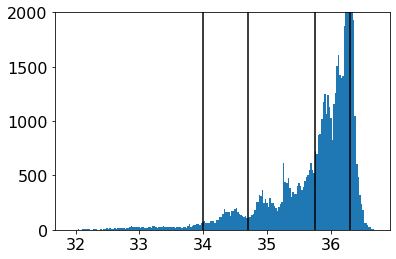

In [220]:
plt.hist(profiles['salinity (PSU)'].values,bins=200)
plt.axvline(34,c='k')
plt.axvline(34.7,c='k')
plt.axvline(35.75,c='k')
plt.axvline(36.3,c='k')
plt.ylim(0,2000)
plt.show()

In [228]:
max_sal_per_transect = []
max_t_sal_per_transect = []

for trans in natsorted(profiles.transect.unique()):
    t = profiles[profiles.transect==trans]
    max_sal_per_transect.append(t['salinity (PSU)'].max())
    max_t_sal_per_transect.append(t.loc[t['temp (C)'].idxmax()]['salinity (PSU)'])

In [279]:
sargasso_transect = []
dates = []
depth_of_max_sal = []
gs_crosser = []

for trans in natsorted(profiles.transect.unique()):
    t = profiles[profiles.transect==trans]
    
    dates.append(t.datetime.dt.day_of_year[0])
    depth_of_max_sal.append(t.loc[t['salinity (PSU)'].idxmax()]['depth (dBars)'])
    
    gs_threshold = provide_gs_temp_threshold(t.datetime.dt.day_of_year[0],buffer=0.5)
    crosses_threshold = 0
    s_trans = 0
    if (t['temp (C)'].max() > gs_threshold) & (t['temp (C)'].min() < gs_threshold):
        crosses_threshold = 1
        if t['salinity (PSU)'].max() > 36.4:
            s_trans = 1
        
    sargasso_transect.append(s_trans)
    gs_crosser.append(crosses_threshold)
        
sargasso_transect = np.array(sargasso_transect)
dates = np.array(dates)
gs_crosser = np.array(gs_crosser)
depth_of_max_sal = np.array(depth_of_max_sal)

In [72]:
complete_profs = []
for pn in profiles.profile_num.unique(): 
    prof = profiles[profiles.profile_num == pn]
    if prof['depth (dBars)'].min() < -79:
        if prof['depth (dBars)'].max() > -5:
            complete_profs.append(pn)

In [73]:
len(complete_profs)

461

In [498]:
from scipy import interpolate

In [539]:
chla_standardized_list = []
for pn in complete_profs:
    prof = profiles[profiles.profile_num == pn]
    prof = prof[prof['depth (dBars)'] > -80]
#     prof_zero_min = prof.chla_clean-prof.chla_clean.min()
#     prof_normalized = prof_zero_min/prof_zero_min.max()
#     prof_zero_min = prof.spice-prof.spice.min()
#     prof_normalized = prof_zero_min/prof_zero_min.max()
    
    f = interpolate.interp1d(prof['depth (dBars)'],prof['potential density (kg/m^3 -1000)'])#['potential density (kg/m^3 -1000)'])
    chla_standardized_list.append(f(np.arange(-5,-79,step=-1)))

In [540]:
chla_standardized_list[10].shape

(74,)

In [541]:
chla_standardized_list = np.array(chla_standardized_list)
chla_standardized_list.shape

(461, 74)

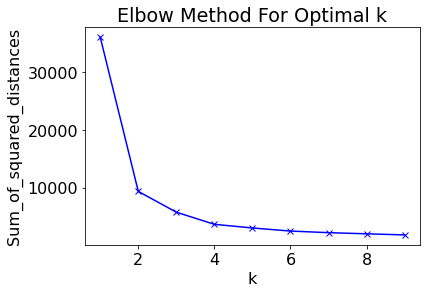

In [282]:
from sklearn.cluster import KMeans

Sum_of_squared_distances = []
K = range(1,10)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(chla_standardized_list)
    Sum_of_squared_distances.append(km.inertia_)
    
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

2
3
4
5
6
7
8
10
15


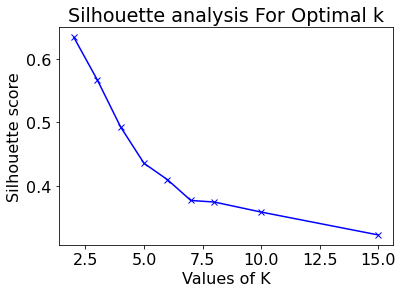

In [283]:
range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 10,15]
from sklearn.metrics import silhouette_score
silhouette_avg = []

for num_clusters in range_n_clusters:
    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(chla_standardized_list)
    cluster_labels = kmeans.labels_
    # silhouette score
    silhouette_avg.append(silhouette_score(chla_standardized_list, cluster_labels))
    print(num_clusters)
    
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()

In [293]:
n_clusters = 3
km = KMeans(n_clusters=n_clusters)
km = km.fit(chla_standardized_list)

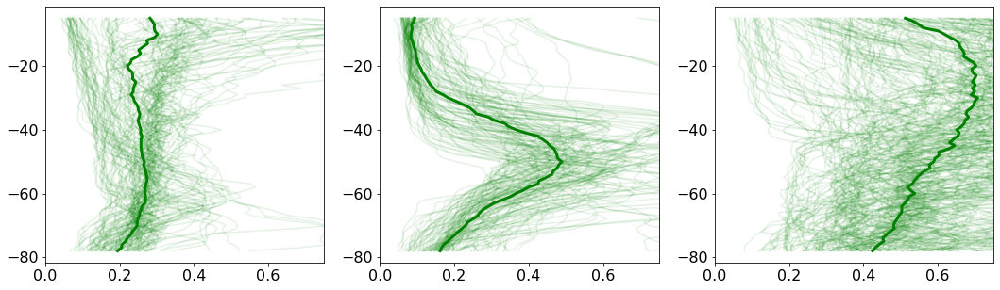

In [399]:
fig, ax = plt.subplots(1,n_clusters,figsize=(18,5))
for i,clust in enumerate(range(n_clusters)):
#     ax[i].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='black',alpha=0.1)
    for p in chla_standardized_list[km.labels_==i]:
        ax[i].plot(p,np.arange(-5,-79,step=-1),c='green',alpha=0.1)
    ax[i].plot(np.median(chla_standardized_list[km.labels_==i],axis=0),np.arange(-5,-79,step=-1),c='green',lw=3)
#     ax[i].plot(np.std(chla_standardized_list[km.labels_==i],axis=0),np.arange(-5,-79,step=-1),c='k',ls='--')
    ax[i].set_xlim(0,0.75)
plt.show()

### just order them by peak chla depth

In [542]:
chla_standardized_list.shape

(461, 74)

In [559]:
max_depth = np.nanargmax(chla_standardized_list[:,25:],axis=1)+25
sum_density = np.sum(chla_standardized_list[:,18:25],axis=1)

In [560]:
arr1inds = sum_density.argsort()
sorted_chla_standardized_list = chla_standardized_list[arr1inds[::]]

In [405]:
doys = []
for c in [0,1,2]:
    doy_c = []
    for pn in np.array(complete_profs)[km.labels_==c]:
        prof = profiles[profiles.profile_num == pn]
        doy_c.append(prof.datetime.dt.day_of_year.iloc[0])
    doys.append(doy_c)
    

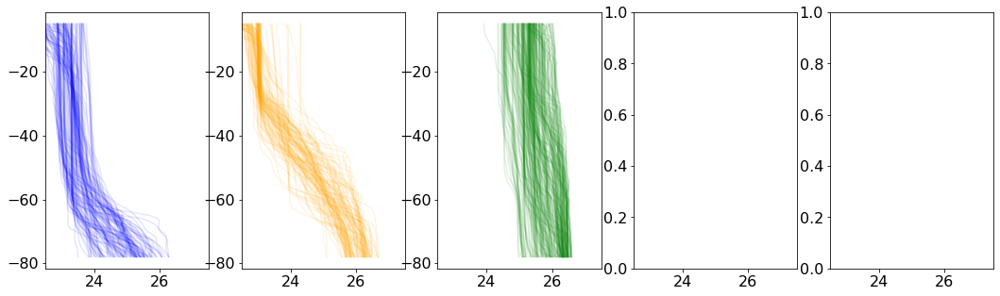

In [295]:
fig, ax = plt.subplots(1,5,figsize=(18,5))
for i,clust in enumerate(km.labels_):
    if clust == 0:
        ax[0].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='blue',alpha=0.1)
    elif clust == 1:
        ax[1].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='orange',alpha=0.1)
    elif clust == 2:
        ax[2].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='green',alpha=0.1)
    elif clust == 3:
        ax[3].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='black',alpha=0.1)
    elif clust == 4:
        ax[4].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='gold',alpha=0.1)
for a in ax:
    a.set_xlim(22.5,27.5)
plt.show()

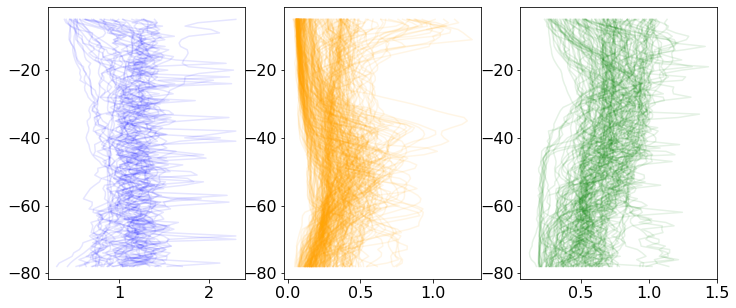

In [157]:
fig, ax = plt.subplots(1,3,figsize=(12,5))
for i,clust in enumerate(km.labels_):
    if clust == 0:
        ax[0].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='blue',alpha=0.1)
    elif clust == 1:
        ax[1].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='orange',alpha=0.1)
    elif clust == 2:
        ax[2].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='green',alpha=0.1)

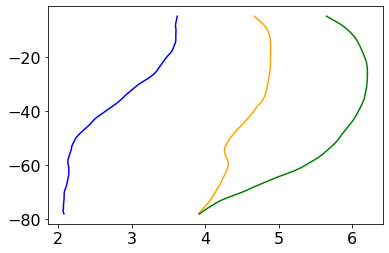

In [213]:
fig, ax = plt.subplots()
ax.plot(np.mean(chla_standardized_list[km.labels_==0],axis=0),np.arange(-5,-79,step=-1),c='blue',alpha=1)
# ax.plot(np.std(chla_standardized_list[km.labels_==0],axis=0),np.arange(-5,-79,step=-1),c='blue',alpha=.3)
ax.plot(np.mean(chla_standardized_list[km.labels_==1],axis=0),np.arange(-5,-79,step=-1),c='orange',alpha=1)
# ax.plot(np.std(chla_standardized_list[km.labels_==1],axis=0),np.arange(-5,-79,step=-1),c='orange',alpha=.3)
ax.plot(np.mean(chla_standardized_list[km.labels_==2],axis=0),np.arange(-5,-79,step=-1),c='green',alpha=1)
# ax.plot(np.std(chla_standardized_list[km.labels_==2],axis=0),np.arange(-5,-79,step=-1),c='green',alpha=.3)

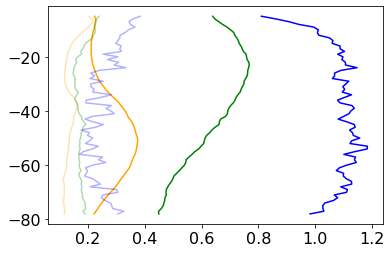

In [162]:
fig, ax = plt.subplots()
ax.plot(np.mean(chla_standardized_list[km.labels_==0],axis=0),np.arange(-5,-79,step=-1),c='blue',alpha=1)
ax.plot(np.mean(chla_standardized_list[km.labels_==1],axis=0),np.arange(-5,-79,step=-1),c='orange',alpha=1)
ax.plot(np.mean(chla_standardized_list[km.labels_==2],axis=0),np.arange(-5,-79,step=-1),c='green',alpha=1)

ax.plot(np.std(chla_standardized_list[km.labels_==0],axis=0),np.arange(-5,-79,step=-1),c='blue',alpha=0.3)
ax.plot(np.std(chla_standardized_list[km.labels_==1],axis=0),np.arange(-5,-79,step=-1),c='orange',alpha=0.3)
ax.plot(np.std(chla_standardized_list[km.labels_==2],axis=0),np.arange(-5,-79,step=-1),c='green',alpha=0.3)
#     elif clust == 1:
#         ax[1].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='orange',alpha=0.1)
#     elif clust == 2:
#         ax[2].plot(chla_standardized_list[i],np.arange(-5,-79,step=-1),c='green',alpha=0.1)

In [34]:
gs_profs = []
for pn in profiles.profile_num.unique(): 
    prof = profiles[profiles.profile_num == pn]
    if prof['salinity (PSU)'].min() > 35.75:
        gs_profs.append(pn)


In [312]:
for pn in np.array(complete_profs)[km.labels_==1]: 
    prof = profiles[profiles.profile_num == pn]
#     print(prof.datetime[0])

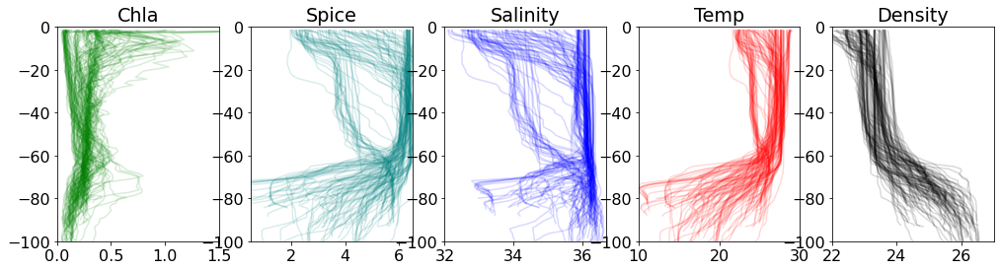

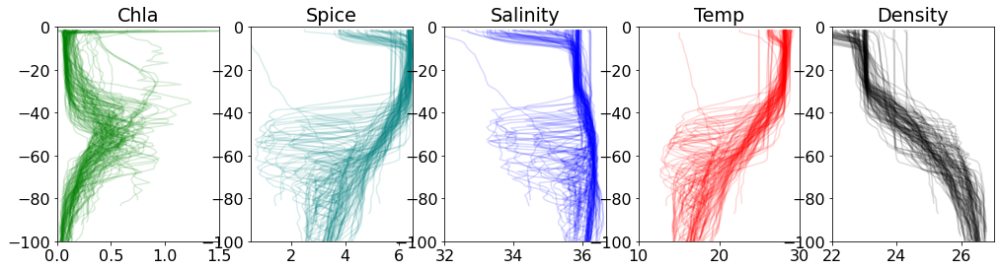

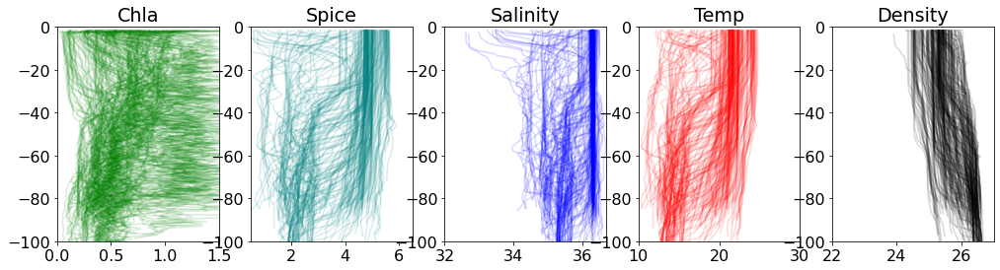

In [319]:
mean_chla = []
for i in range(n_clusters):
    fig, ax = plt.subplots(1,5,figsize=(17,4))
    for pn in np.array(complete_profs)[km.labels_==i]:
        prof = profiles[profiles.profile_num == pn]
        ax[0].plot(prof.chla_clean,prof['depth (dBars)'],c='green',alpha=0.15)
        mean_chla.append(prof[(prof['depth (dBars)']>-80)&(prof['depth (dBars)']<-5)].chla_clean.mean())
        ax[0].set_title("Chla")
        ax[0].set_xlim(0,1.5)
        ax[1].plot(prof.spice,prof['depth (dBars)'],'teal',alpha=0.15)
        ax[1].set_title("Spice")
        ax[1].set_xlim(.5,6.5)
        ax[2].plot(prof['salinity (PSU)'],prof['depth (dBars)'],'blue',alpha=0.15)
        ax[2].set_title("Salinity")
        ax[2].set_xlim(32,36.7)
        ax[3].plot(prof['temp (C)'],prof['depth (dBars)'],'red',alpha=0.15)
        ax[3].set_title("Temp")
        ax[3].set_xlim(10,30)
        ax[4].plot(prof['potential density (kg/m^3 -1000)'],prof['depth (dBars)'],'k',alpha=0.15)
        ax[4].set_title("Density")
        ax[4].set_xlim(22,27)
#         ax[5].plot(prof['turbidity_clean'],prof['depth (dBars)'],'brown',alpha=0.15)
#     #     ax[5].set_ylim(prof['depth (dBars)'].min(),prof['depth (dBars)'].max())
#         ax[5].set_title("Turbidity")
#         ax[5].set_xlim(.9,1.8)
        for a in ax:
            a.set_ylim(-100,0)
    plt.show()

0.2786056400772179
0.28519433551236767
0.6197329213764307


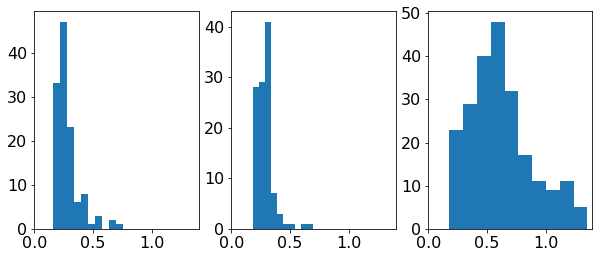

In [323]:
fig, ax = plt.subplots(1,n_clusters,figsize=(10,4))
for i in range(n_clusters):
    ax[i].hist(np.array(mean_chla)[km.labels_==i])
    ax[i].set_xlim(0,1.4)
    print(np.mean(np.array(mean_chla)[km.labels_==i]))
plt.show()

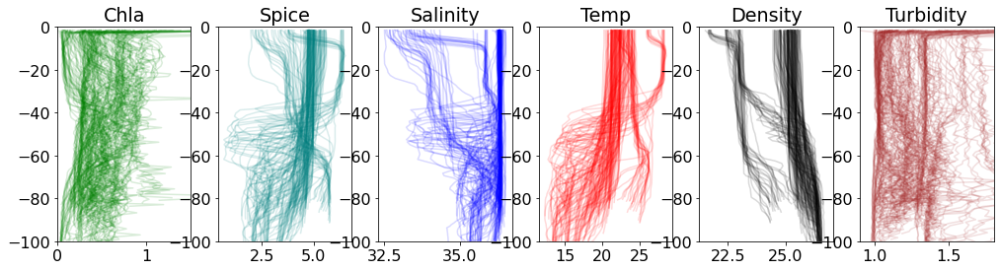

In [215]:
fig, ax = plt.subplots(1,6,figsize=(17,4))
for pn in np.array(complete_profs)[km.labels_==1]:
    prof = profiles[profiles.profile_num == pn]
    ax[0].plot(prof.chla_clean,prof['depth (dBars)'],c='green',alpha=0.15)
    ax[0].set_title("Chla")
    ax[0].set_xlim(0,1.5)
    ax[1].plot(prof.spice,prof['depth (dBars)'],'teal',alpha=0.15)
    ax[1].set_title("Spice")
    ax[2].plot(prof['salinity (PSU)'],prof['depth (dBars)'],'blue',alpha=0.15)
    ax[2].set_title("Salinity")
    ax[3].plot(prof['temp (C)'],prof['depth (dBars)'],'red',alpha=0.15)
    ax[3].set_title("Temp")
    ax[4].plot(prof['potential density (kg/m^3 -1000)'],prof['depth (dBars)'],'k',alpha=0.15)
    ax[4].set_title("Density")
    ax[5].plot(prof['turbidity_clean'],prof['depth (dBars)'],'brown',alpha=0.15)
#     ax[5].set_ylim(prof['depth (dBars)'].min(),prof['depth (dBars)'].max())
    ax[5].set_title("Turbidity")
    ax[5].set_xlim(.9,1.8)
    for a in ax:
        a.set_ylim(-100,0)
plt.show()

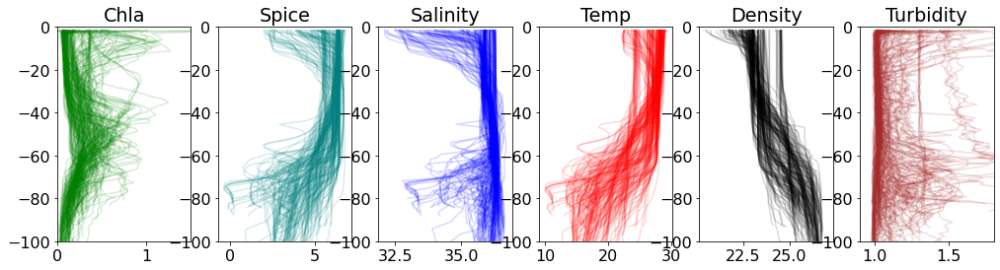

In [216]:
fig, ax = plt.subplots(1,6,figsize=(17,4))
for pn in np.array(complete_profs)[km.labels_==2]:
    prof = profiles[profiles.profile_num == pn]
    ax[0].plot(prof.chla_clean,prof['depth (dBars)'],c='green',alpha=0.15)
    ax[0].set_title("Chla")
    ax[0].set_xlim(0,1.5)
    ax[1].plot(prof.spice,prof['depth (dBars)'],'teal',alpha=0.15)
    ax[1].set_title("Spice")
    ax[2].plot(prof['salinity (PSU)'],prof['depth (dBars)'],'blue',alpha=0.15)
    ax[2].set_title("Salinity")
    ax[3].plot(prof['temp (C)'],prof['depth (dBars)'],'red',alpha=0.15)
    ax[3].set_title("Temp")
    ax[4].plot(prof['potential density (kg/m^3 -1000)'],prof['depth (dBars)'],'k',alpha=0.15)
    ax[4].set_title("Density")
    ax[5].plot(prof['turbidity_clean'],prof['depth (dBars)'],'brown',alpha=0.15)
#     ax[5].set_ylim(prof['depth (dBars)'].min(),prof['depth (dBars)'].max())
    ax[5].set_title("Turbidity")
    ax[5].set_xlim(.9,1.8)
    for a in ax:
        a.set_ylim(-100,0)
plt.show()

### let's look at the sub 10m variability of chla and sal and see periods where it is high and low

2020-09-25 14:08:11.798016


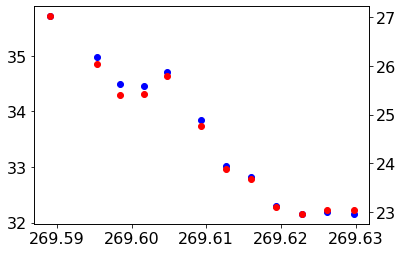

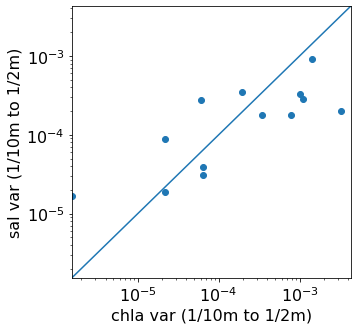

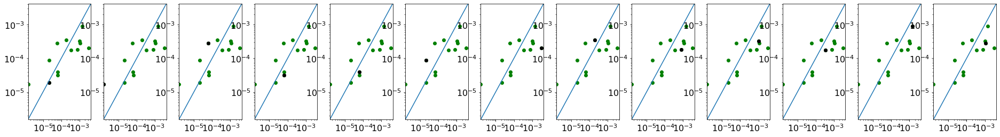

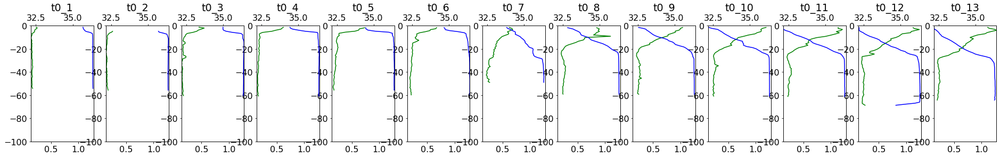

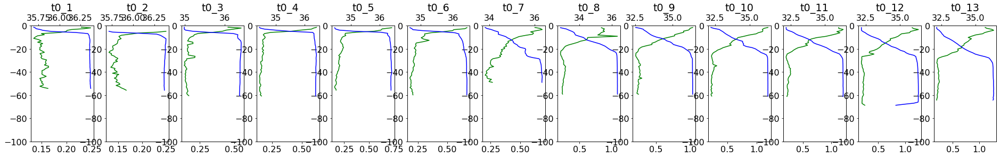

##################################
##################################
2020-09-25 16:14:01.673404800


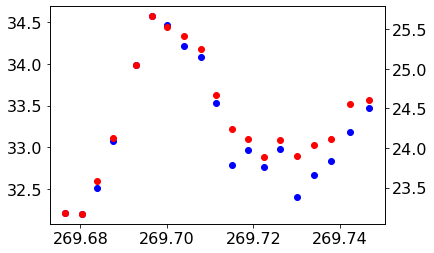

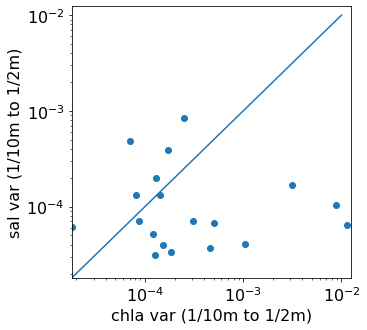

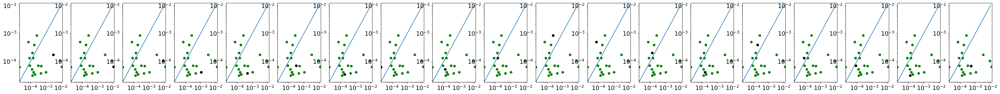

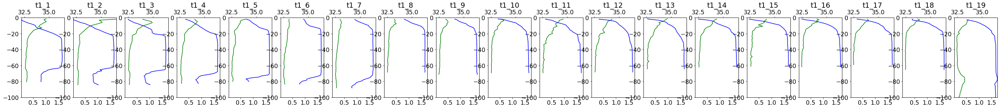

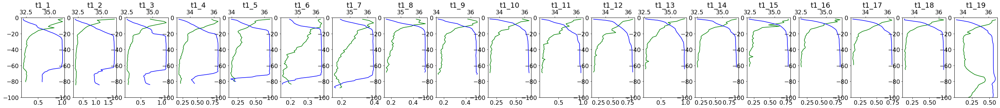

##################################
##################################
2020-09-28 13:13:43.483612800


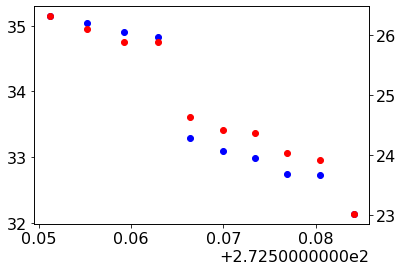

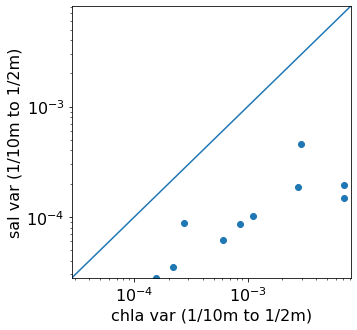

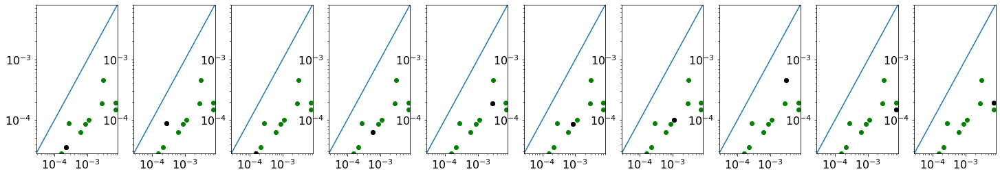

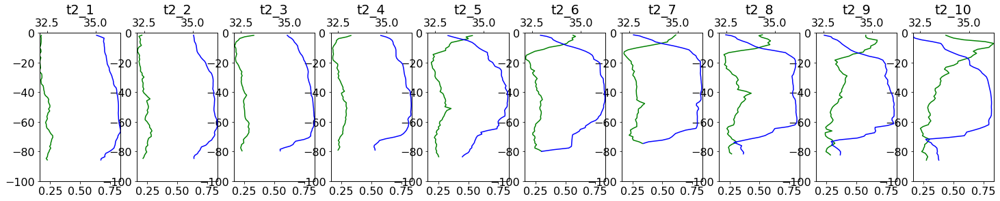

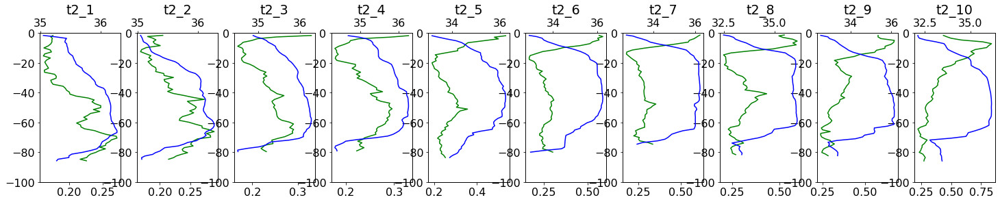

##################################
##################################
2020-09-28 14:09:55.902844800


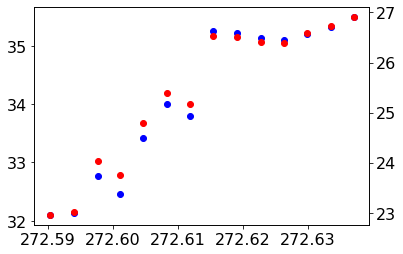

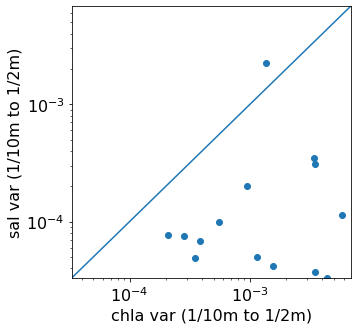

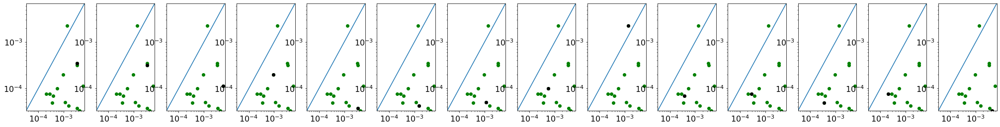

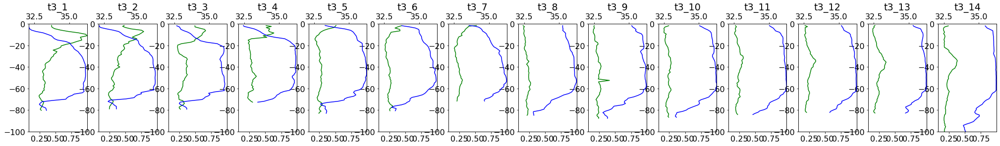

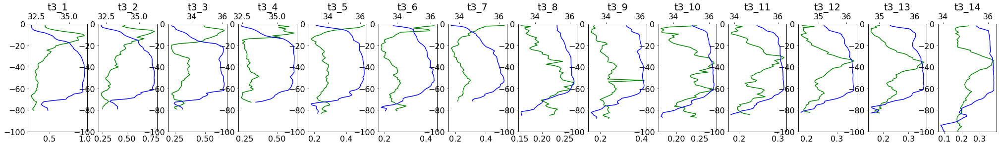

##################################
##################################
2020-10-10 13:27:32.742345600


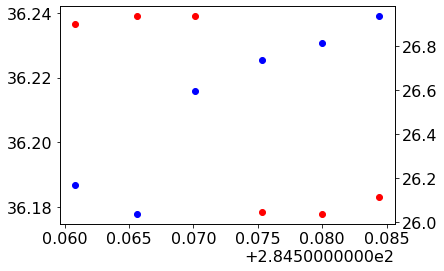

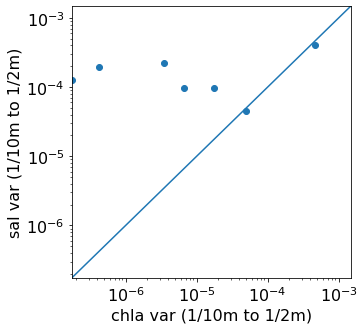

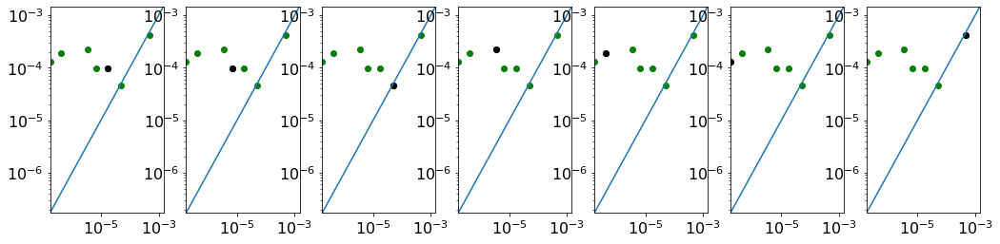

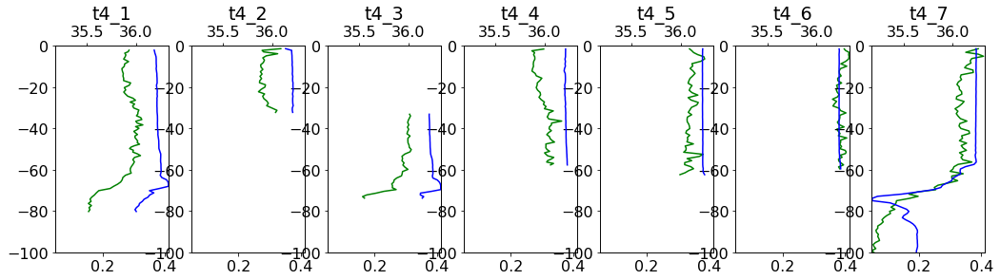

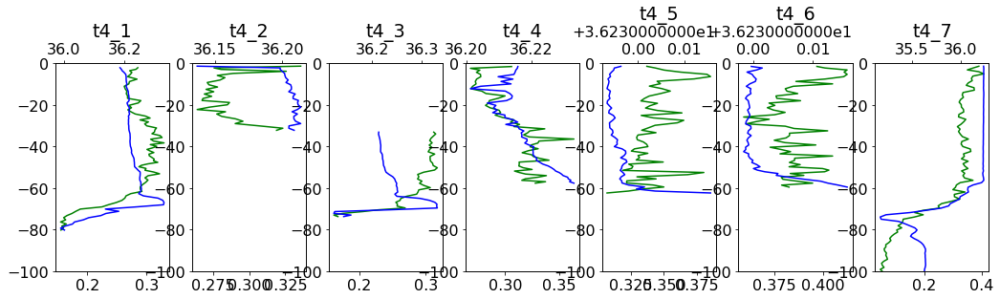

##################################
##################################
2020-10-10 15:34:08.731142400


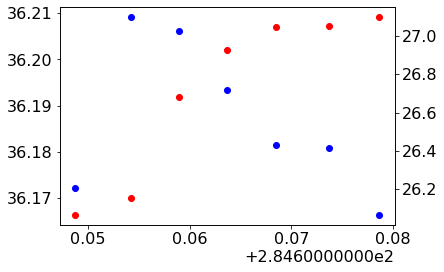

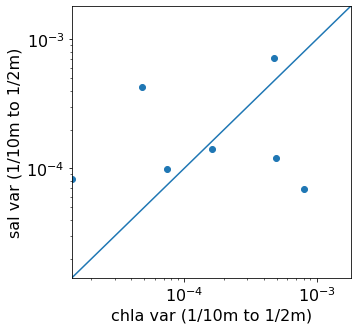

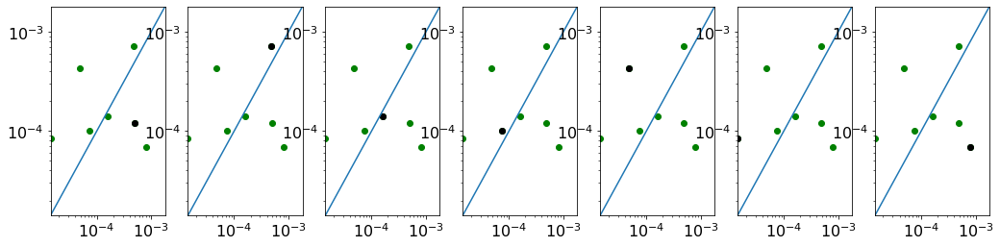

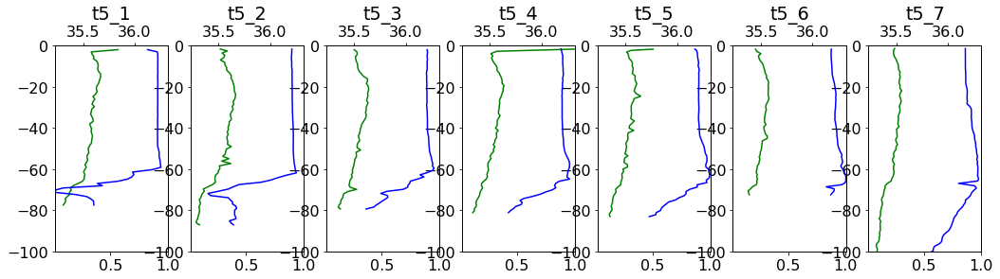

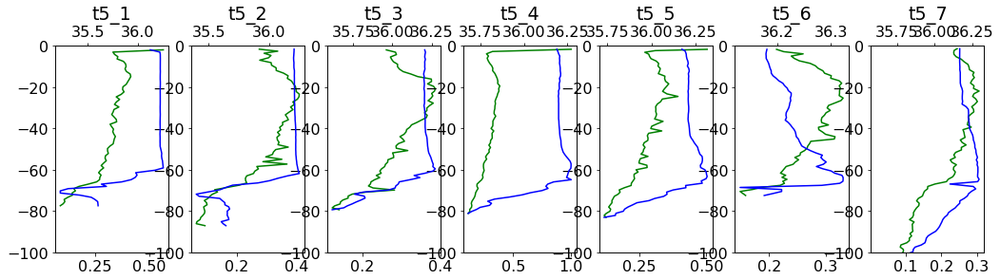

##################################
##################################
2020-10-11 14:00:50.514249600


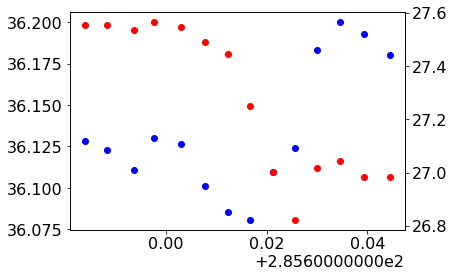

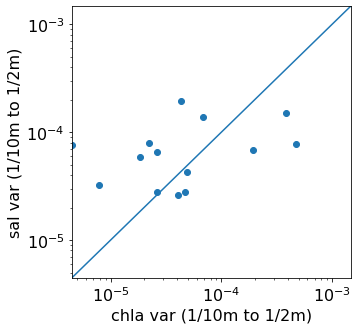

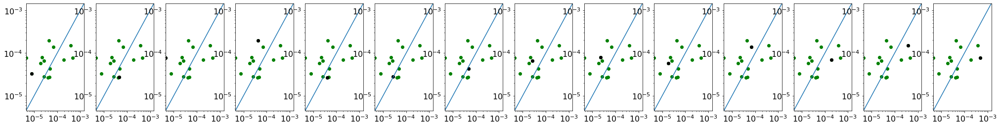

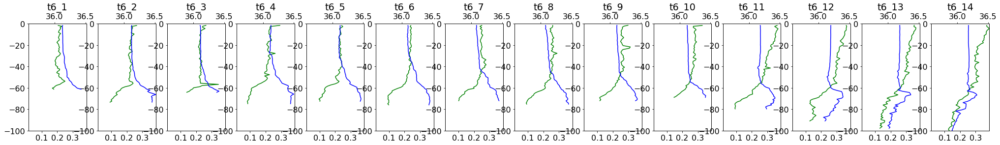

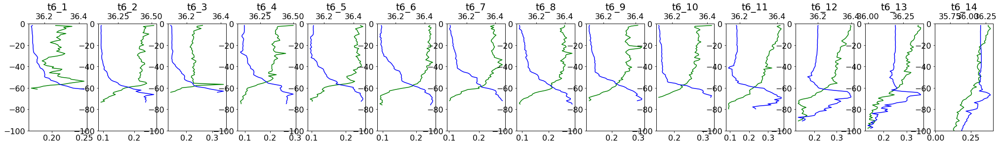

##################################
##################################
2020-10-15 14:05:14.807875200


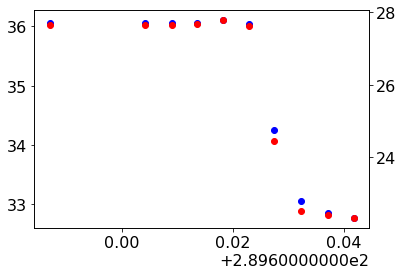

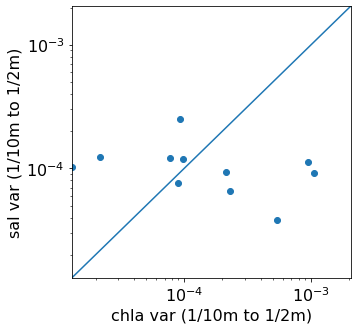

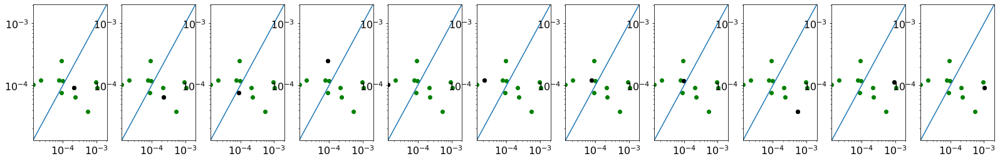

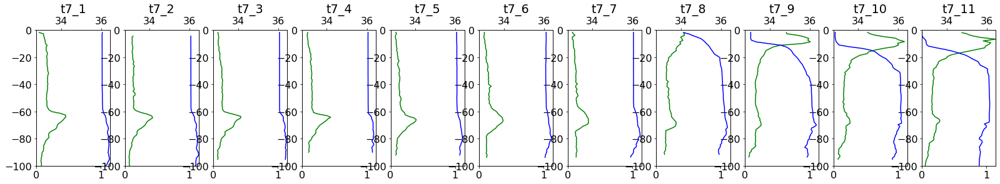

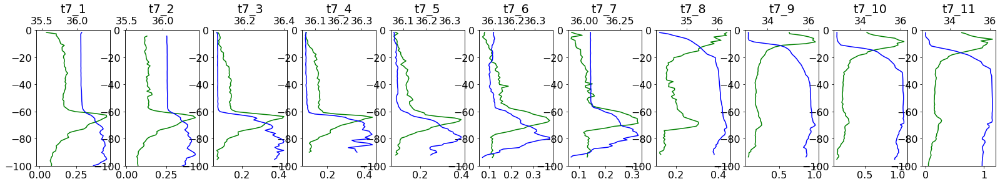

##################################
##################################
2020-10-15 16:46:39.110419200


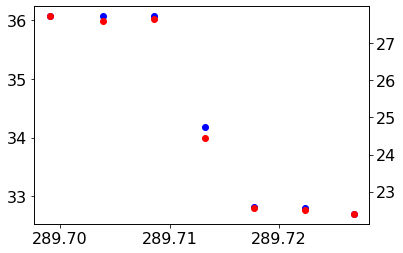

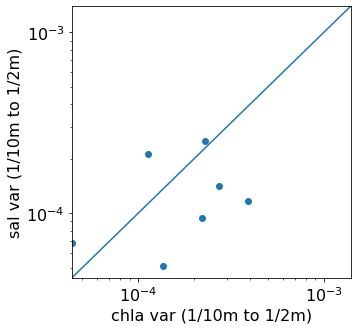

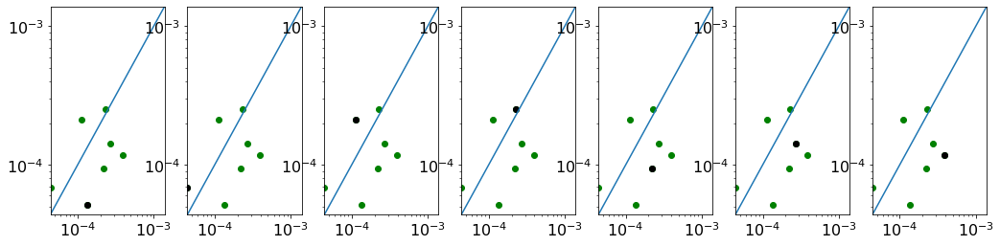

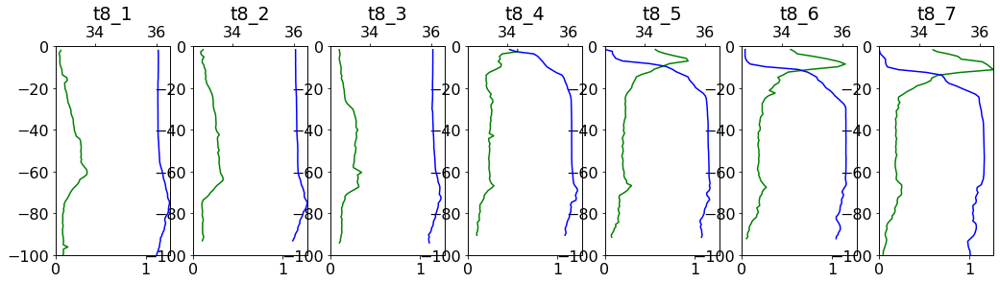

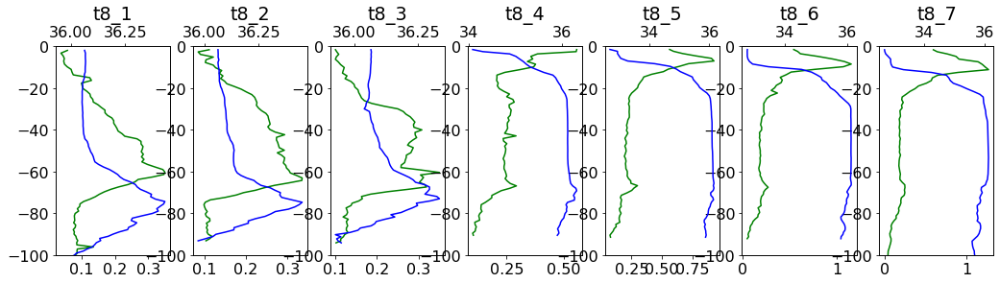

##################################
##################################
2020-10-16 13:06:31.260787200


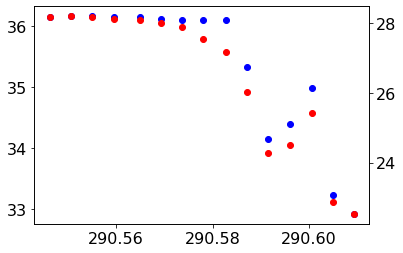

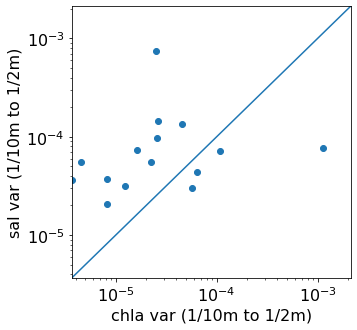

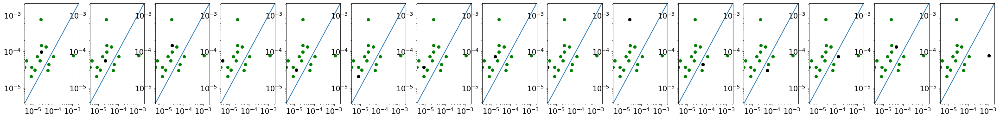

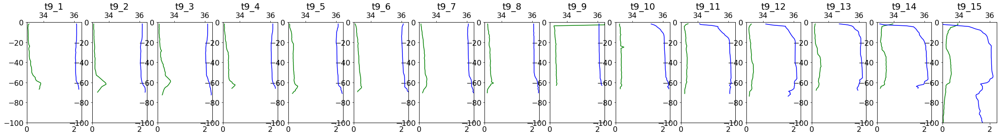

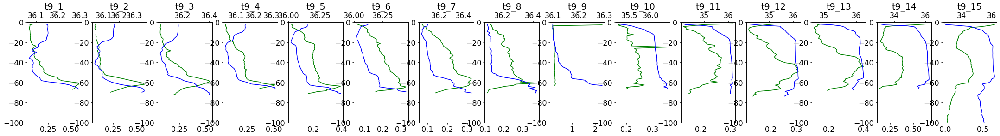

##################################
##################################
2020-10-16 16:17:37.783046400


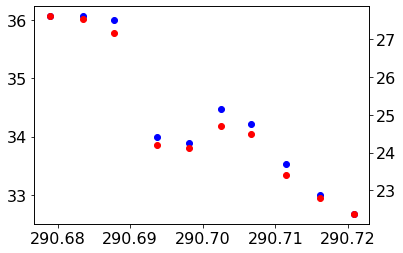

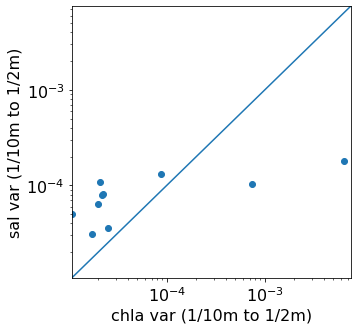

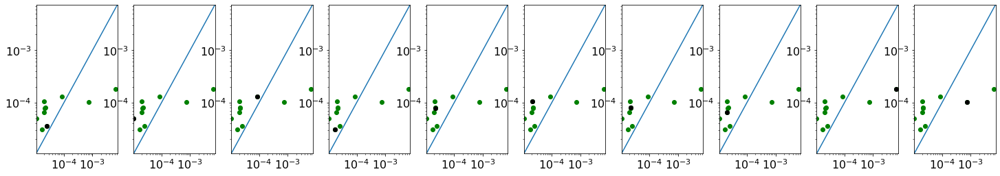

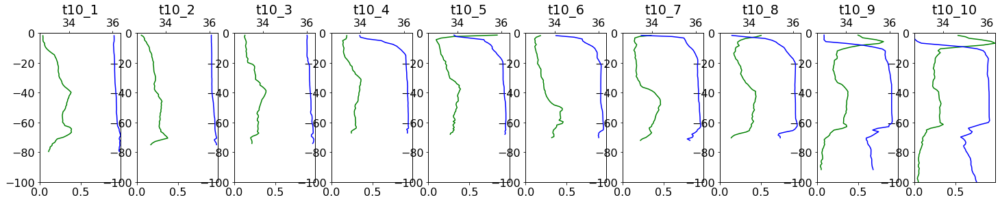

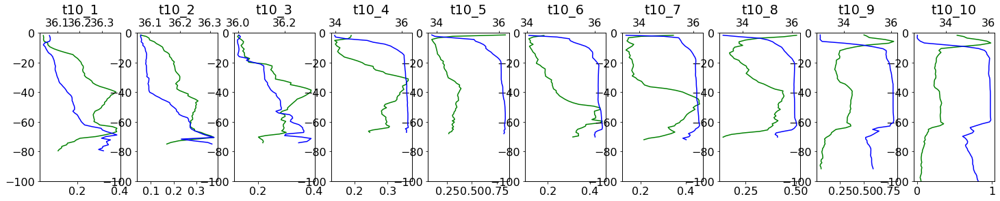

##################################
##################################
2020-10-20 13:17:44.596809600


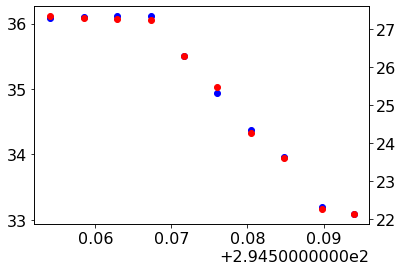

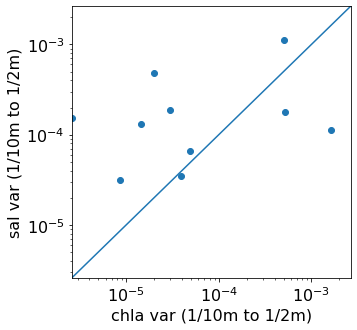

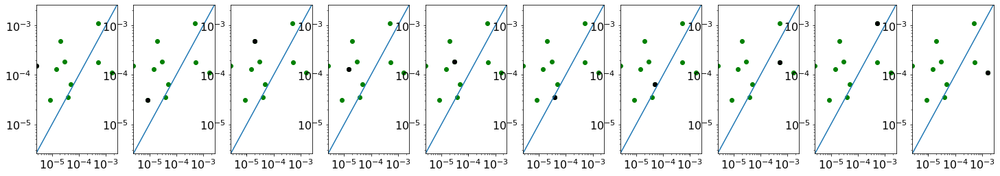

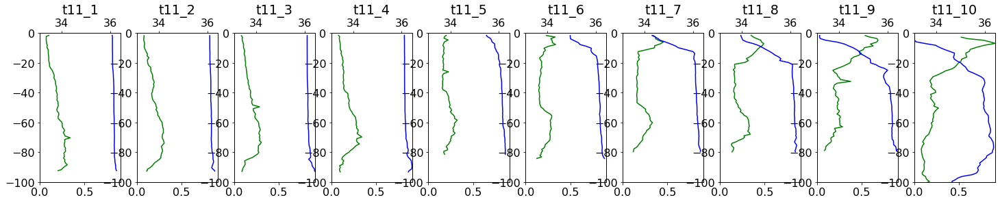

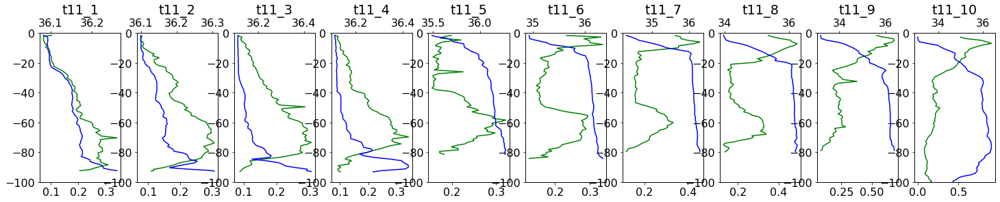

##################################
##################################
2020-10-20 15:54:06.420470400


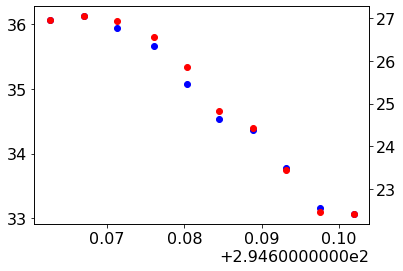

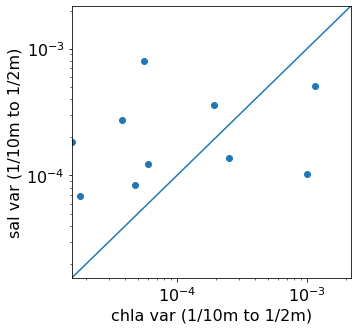

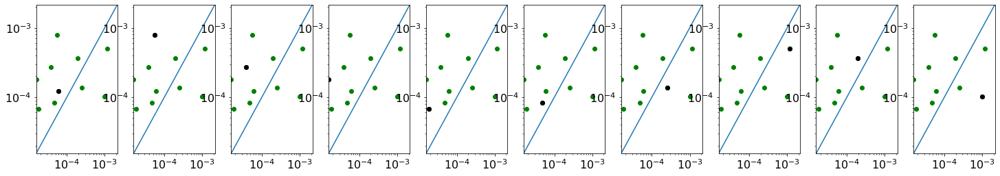

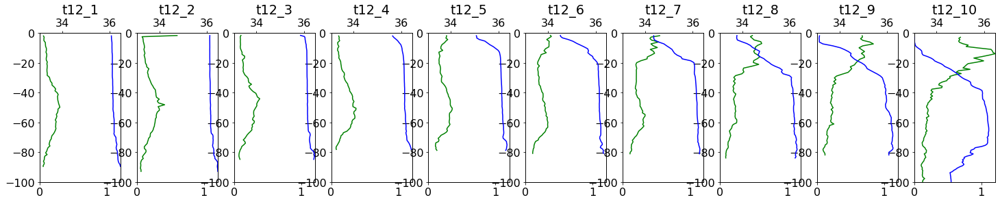

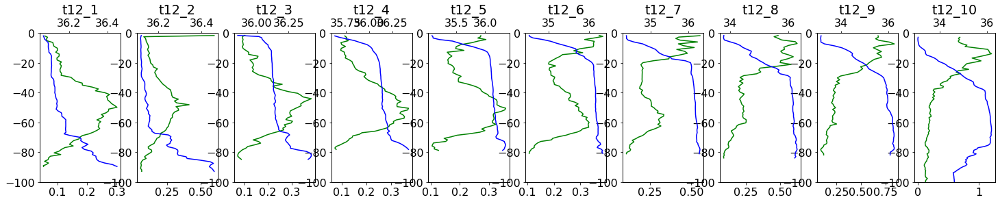

##################################
##################################
2021-08-26 12:21:04.162809600


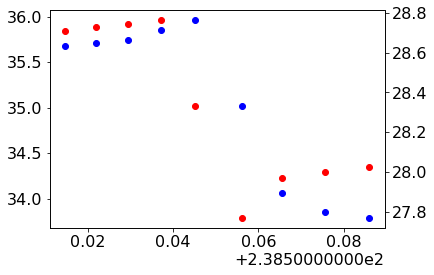

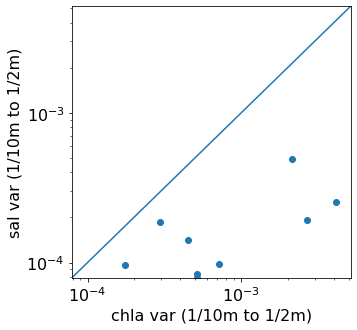

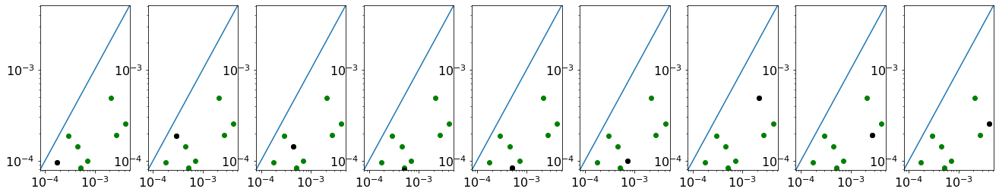

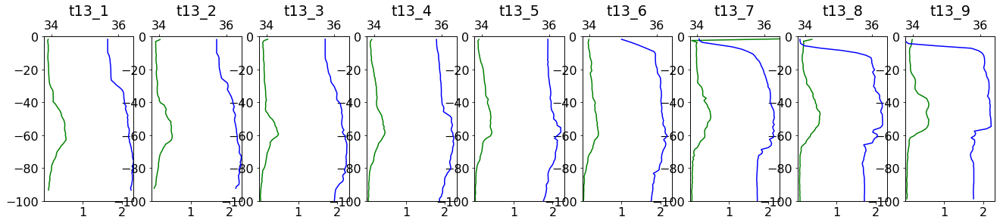

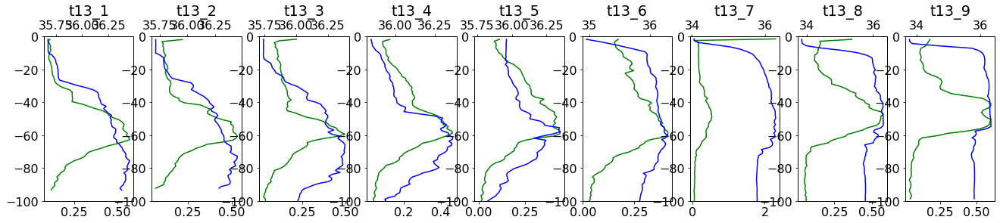

##################################
##################################
2021-08-26 21:53:31.621574400


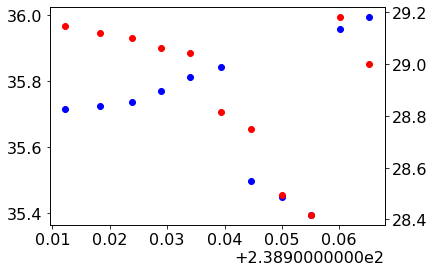

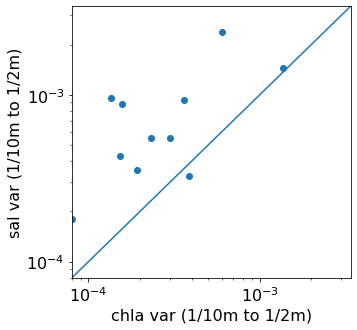

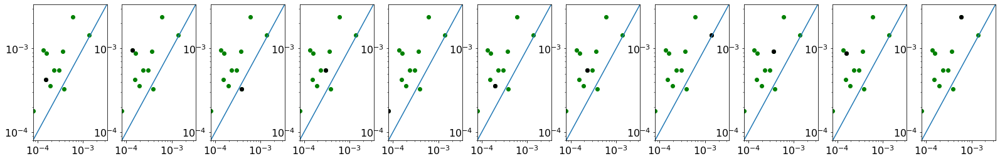

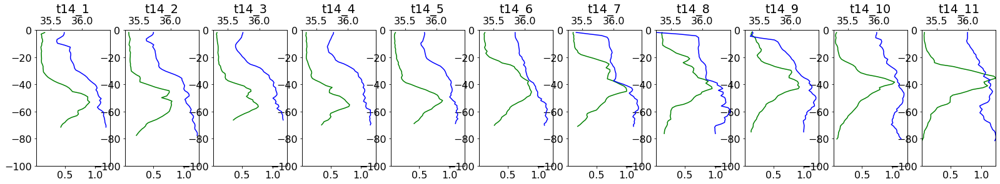

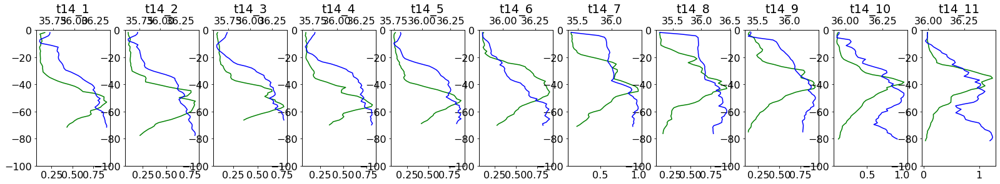

##################################
##################################
2021-08-27 11:08:08.414851200


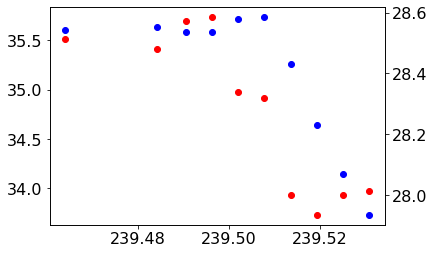

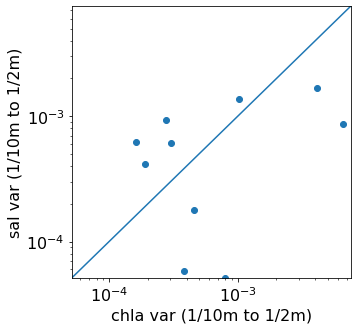

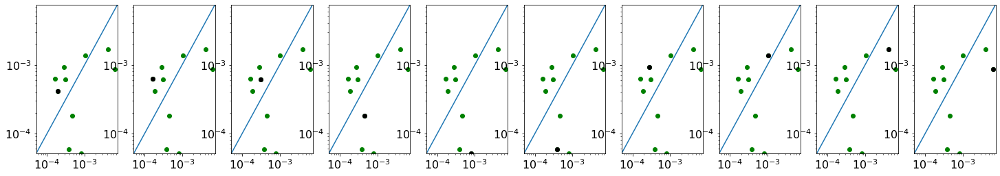

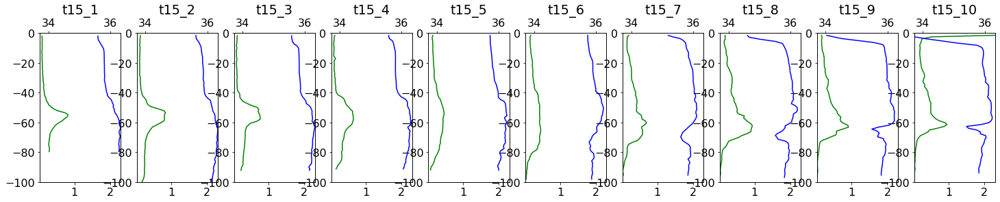

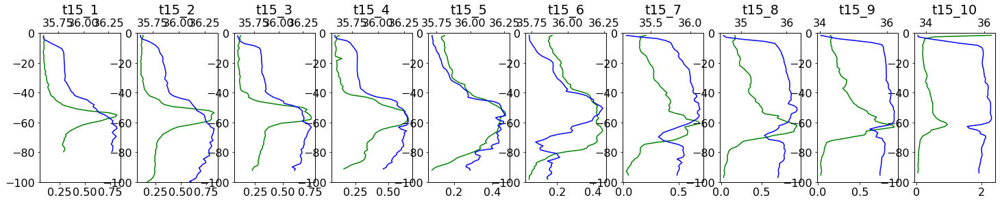

##################################
##################################
2021-08-28 10:52:31.826668800


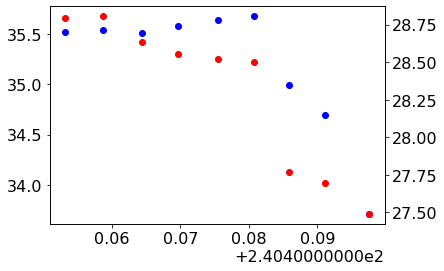

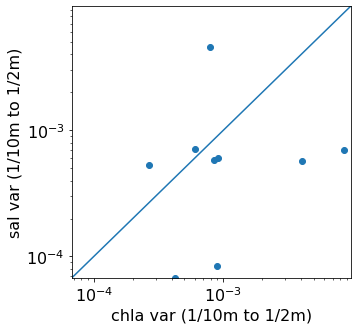

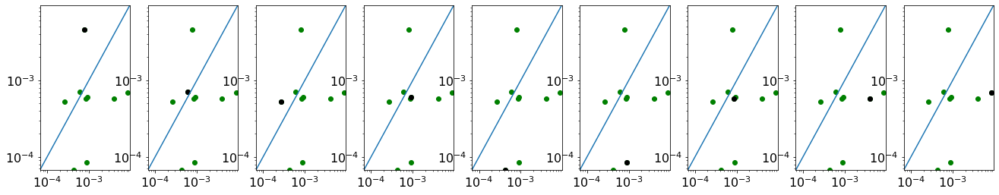

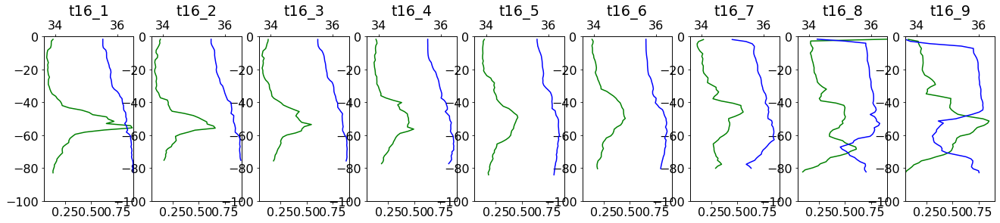

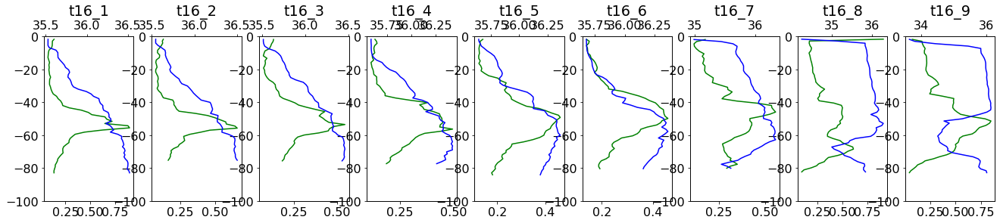

##################################
##################################
2021-08-28 15:15:03.339993600


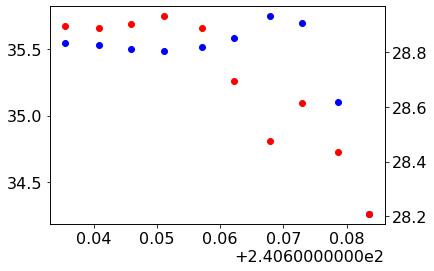

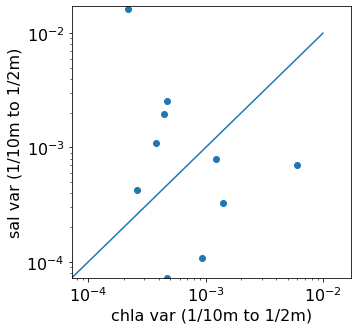

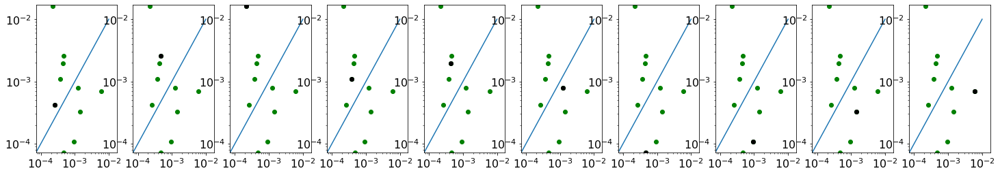

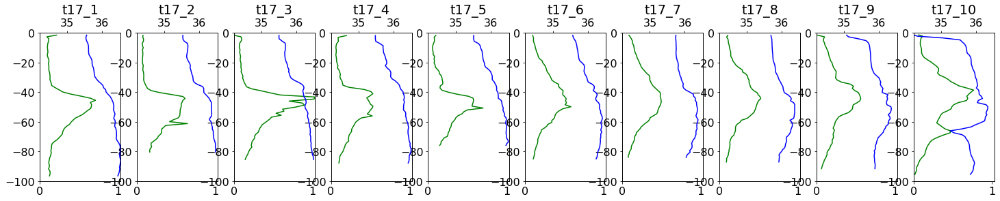

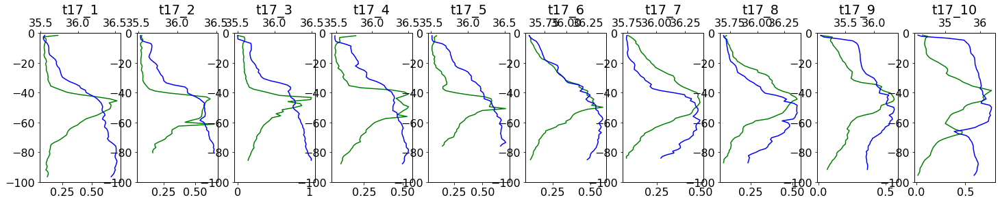

##################################
##################################
2021-08-28 20:18:51.646521600


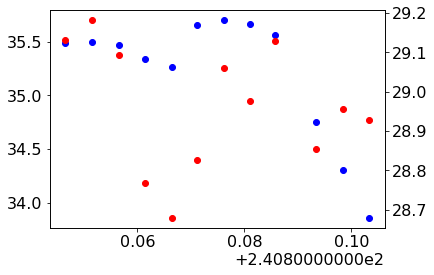

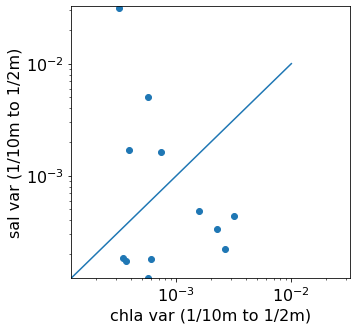

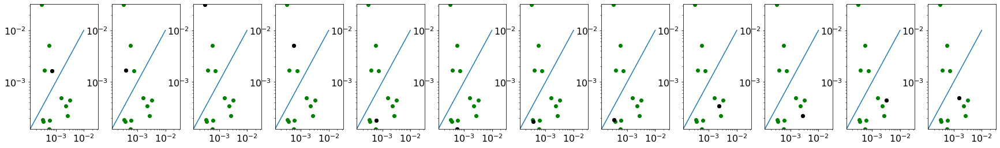

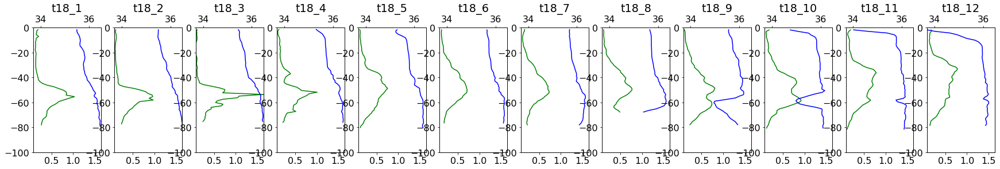

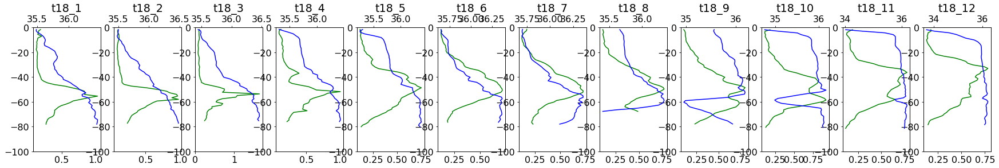

##################################
##################################
2021-08-29 11:11:05.203248


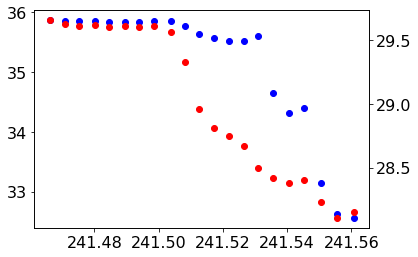

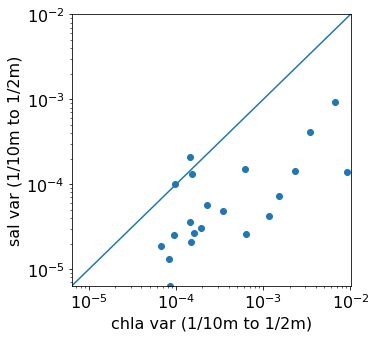

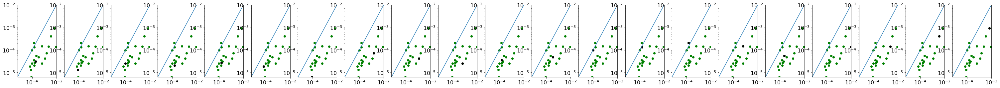

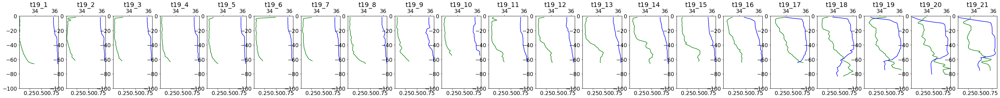

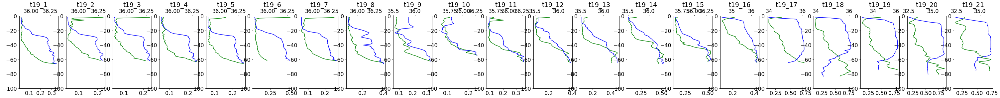

##################################
##################################
2021-08-29 16:31:38.620502400


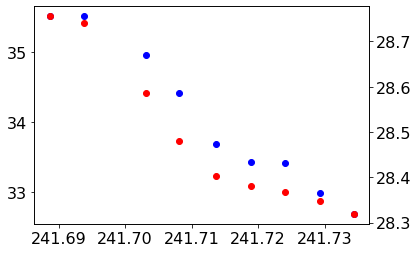

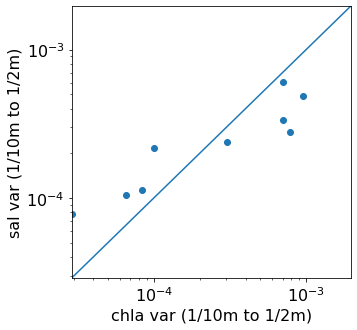

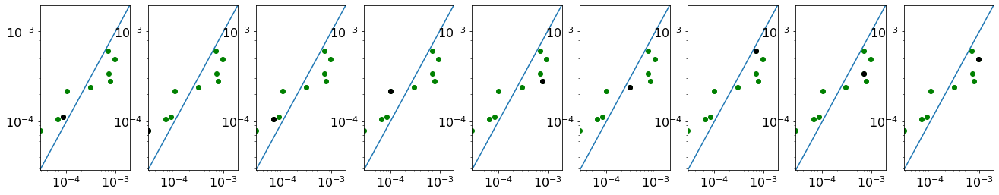

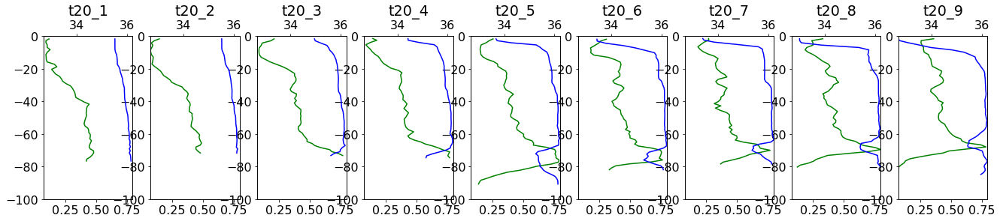

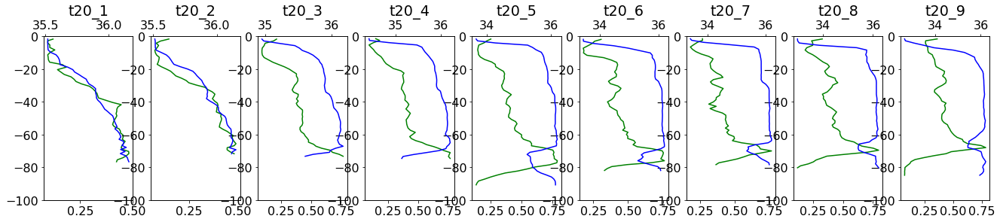

##################################
##################################
2021-09-05 13:52:21.803404800


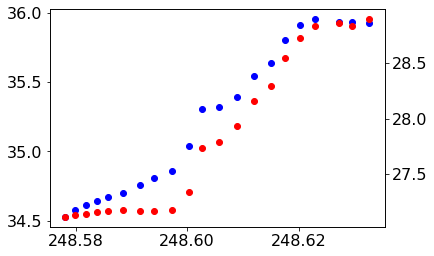

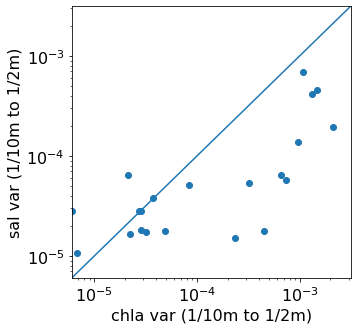

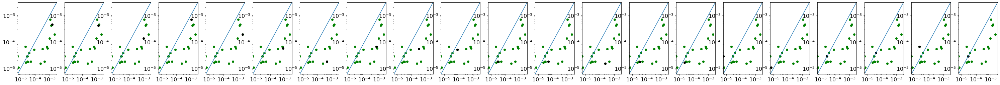

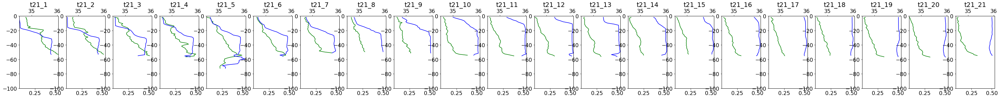

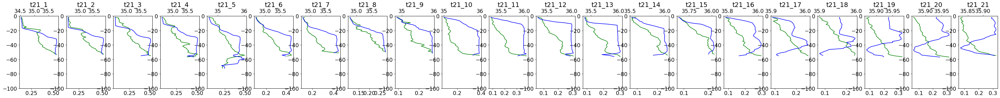

##################################
##################################
2021-09-05 15:57:05.065257600


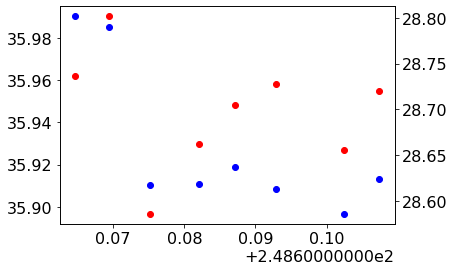

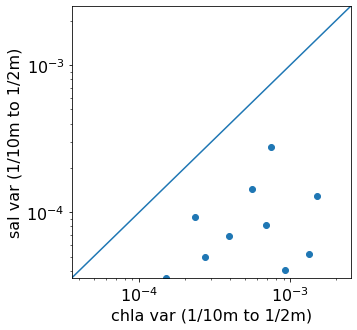

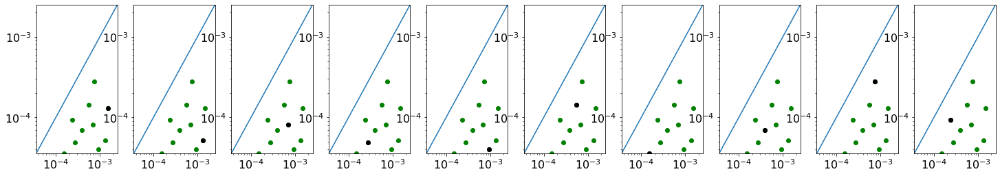

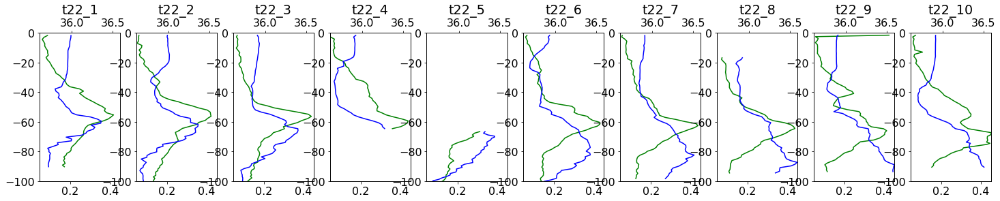

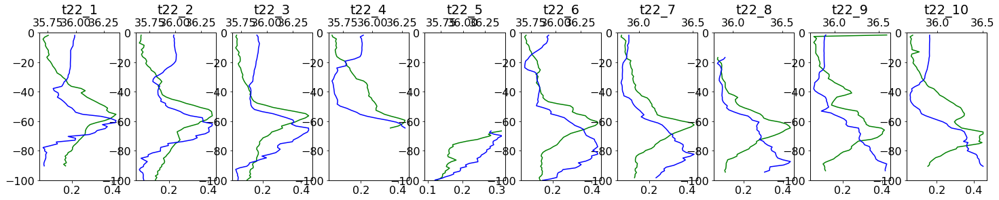

##################################
##################################
2021-09-05 18:18:08.140608


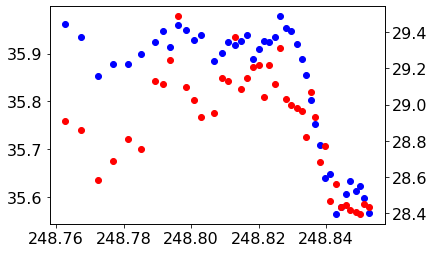

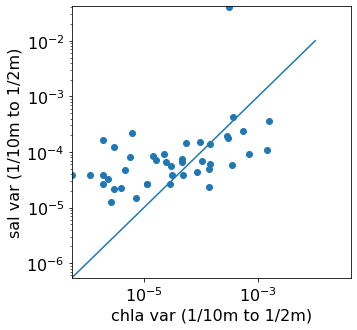

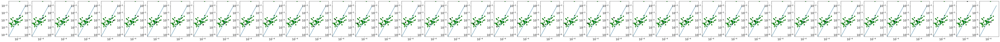

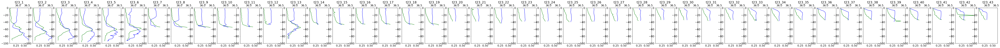

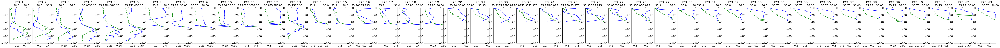

##################################
##################################
2021-09-06 12:31:11.284896


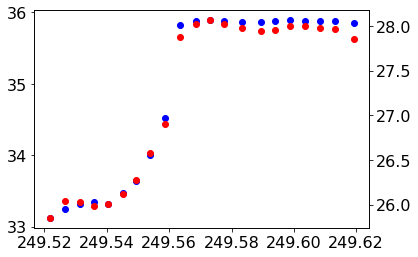

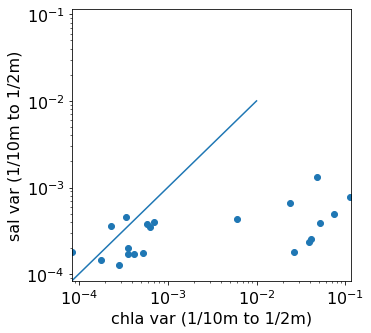

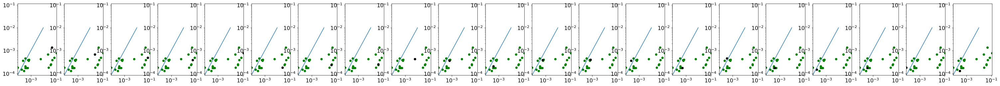

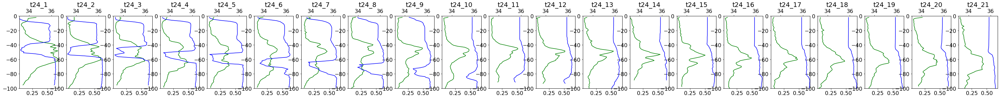

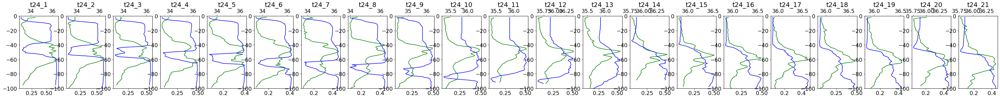

##################################
##################################
2021-09-06 16:49:43.314873600


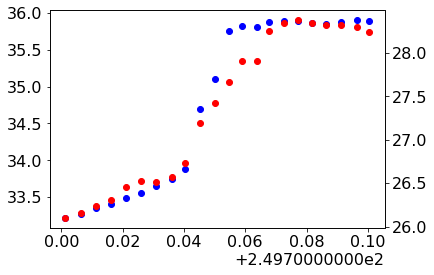

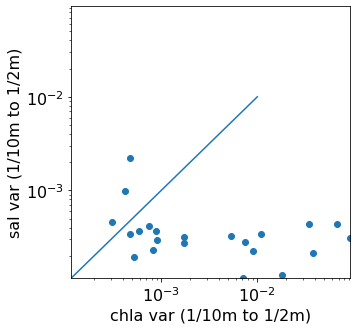

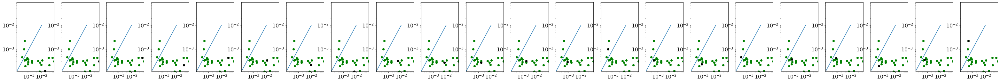

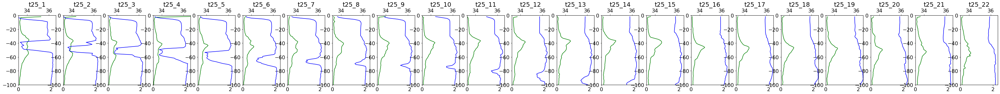

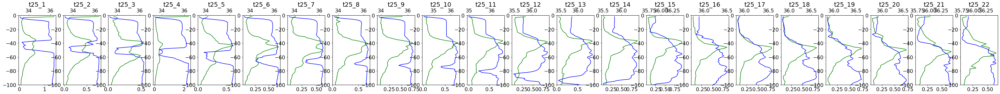

##################################
##################################
2021-09-07 12:43:16.611427200


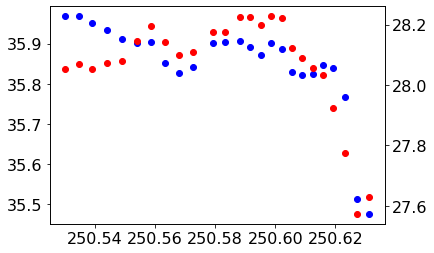

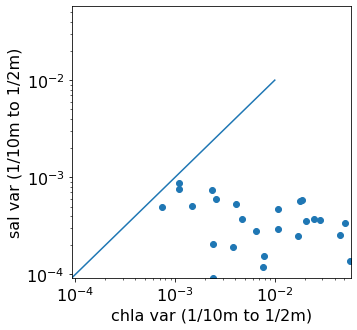

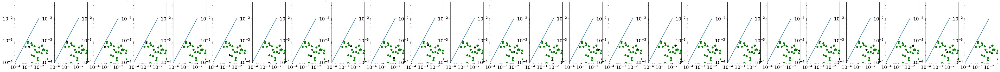

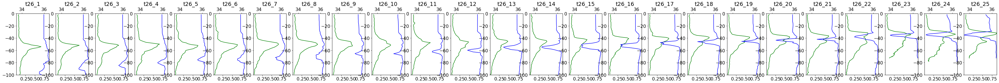

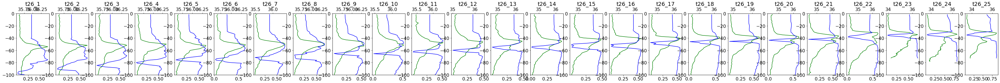

##################################
##################################
2021-04-14 13:20:36.012076800


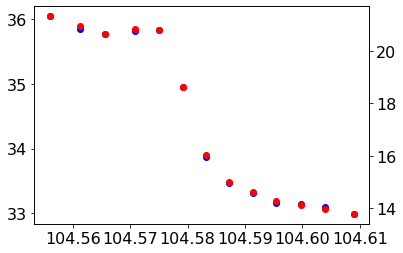

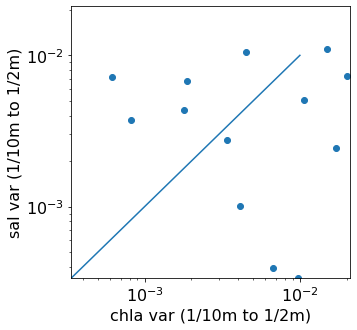

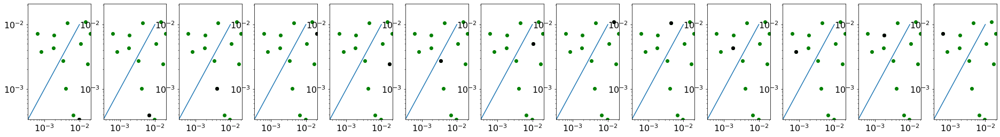

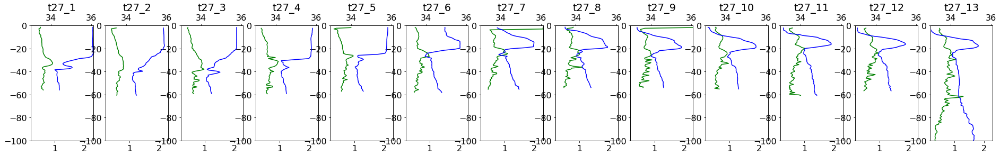

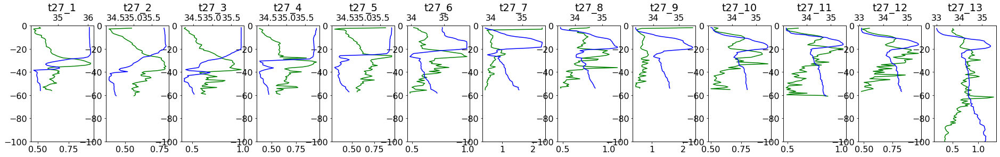

##################################
##################################
2021-04-14 16:02:01.889174400


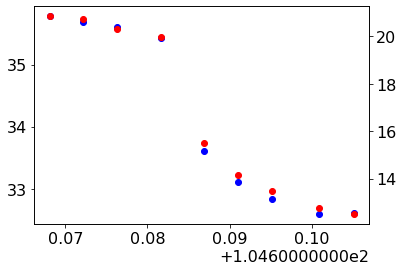

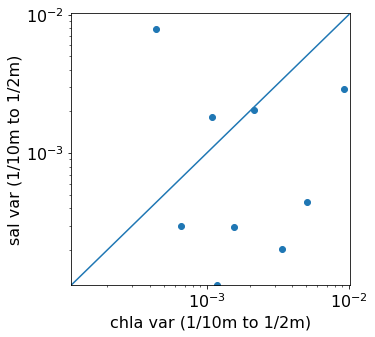

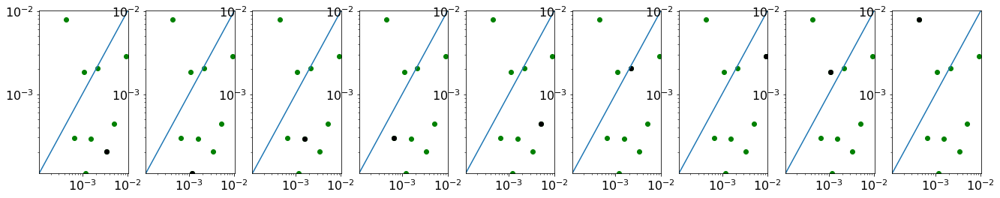

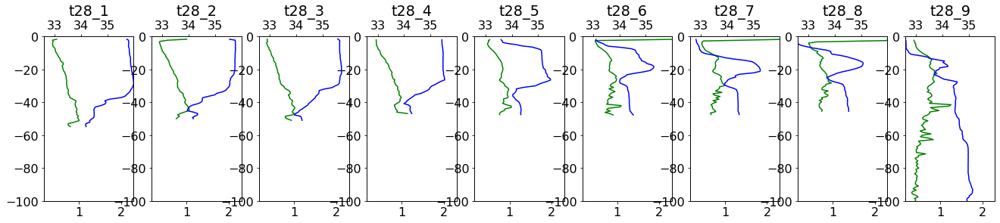

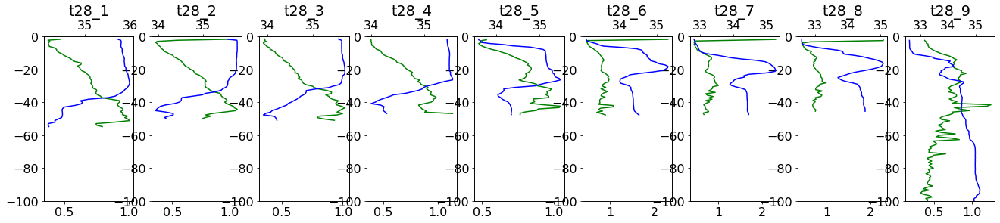

##################################
##################################
2021-04-20 12:42:11.619619200


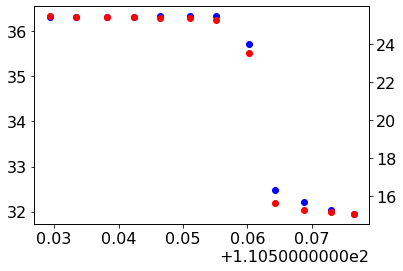

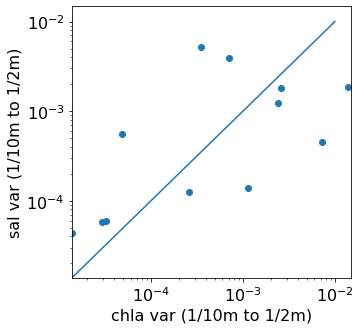

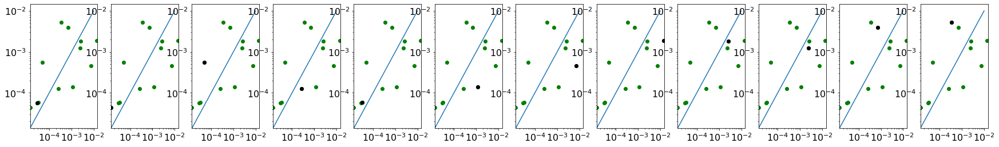

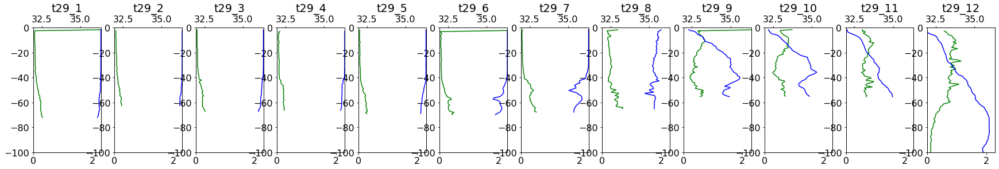

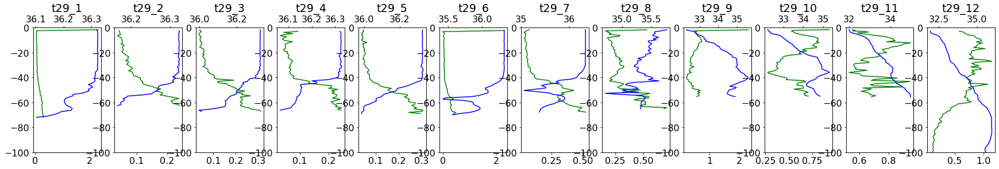

##################################
##################################
2021-04-20 15:20:16.051833599


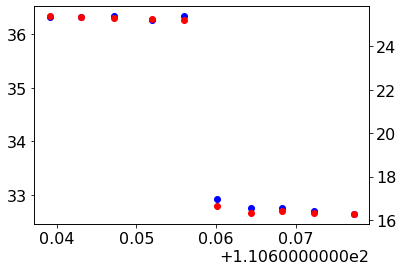

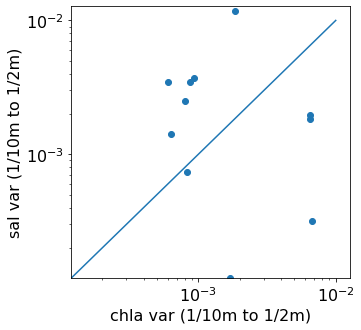

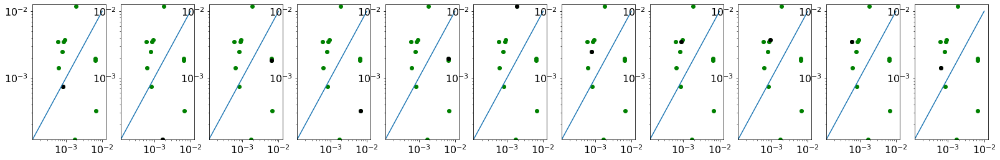

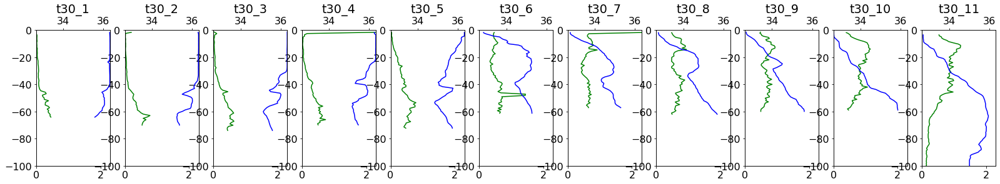

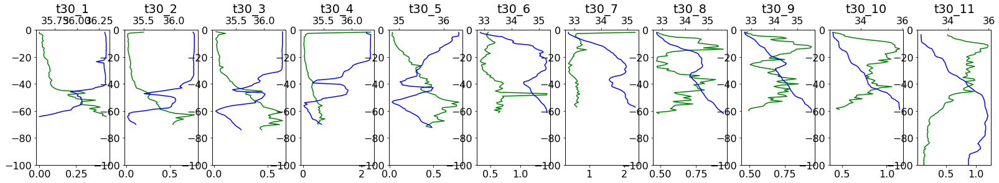

##################################
##################################
2021-04-21 12:39:53.788982400


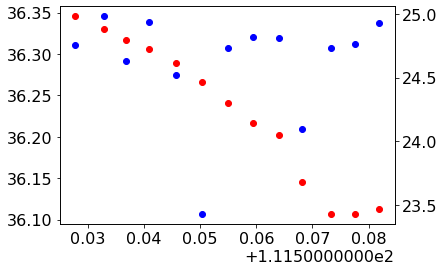

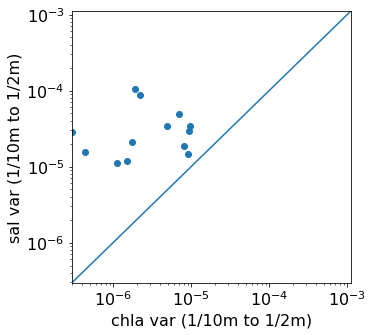

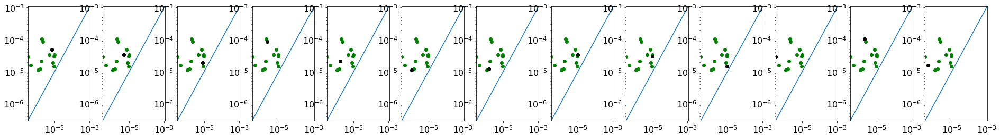

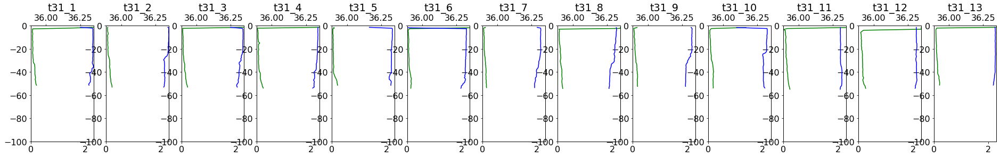

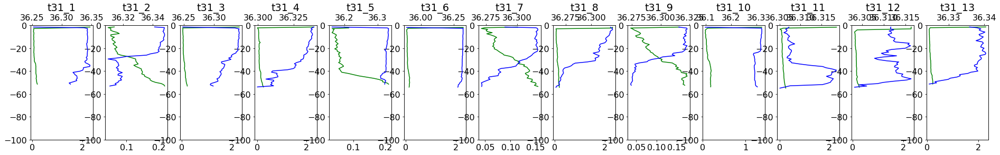

##################################
##################################
2021-04-21 15:06:25.058880


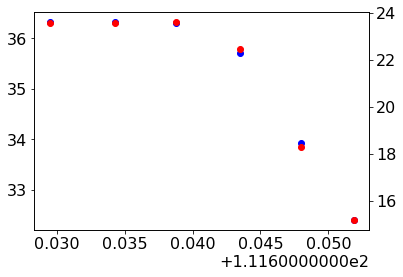

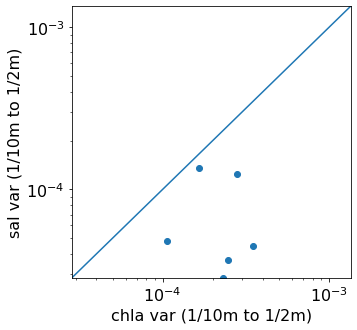

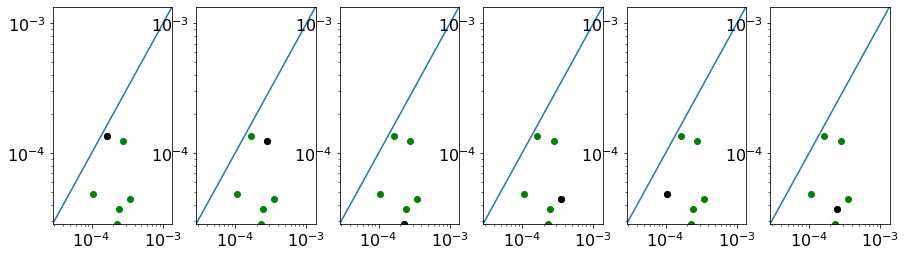

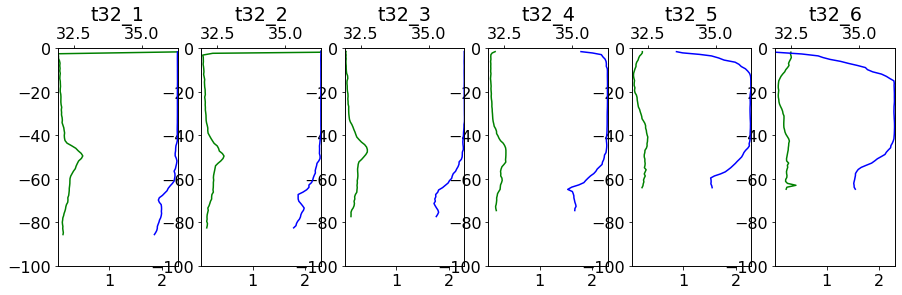

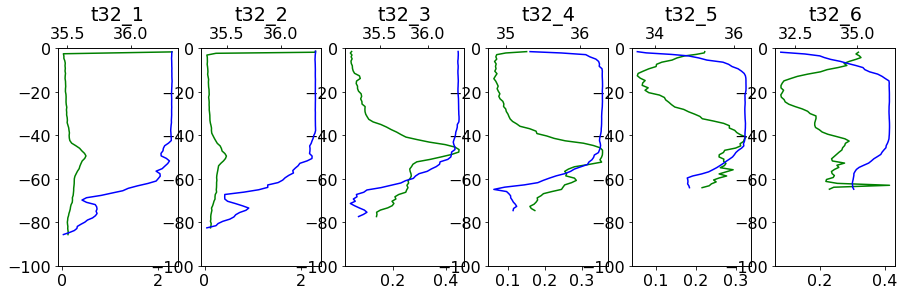

##################################
##################################
2021-04-27 12:33:31.537238400


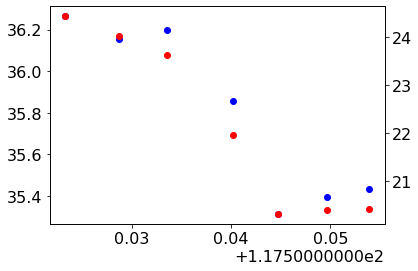

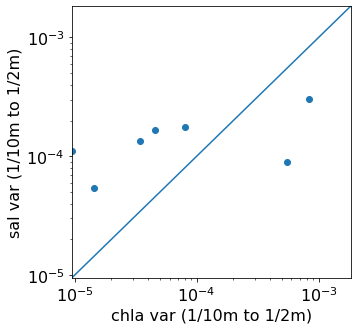

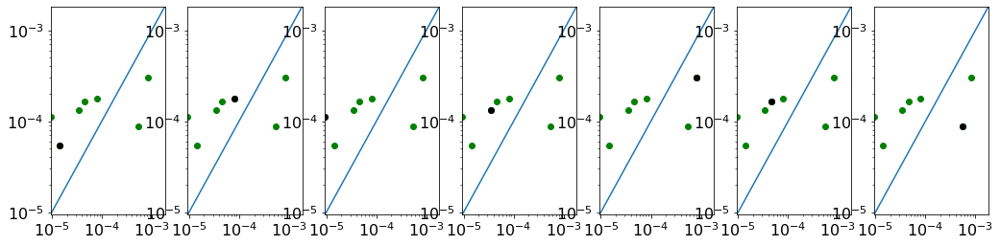

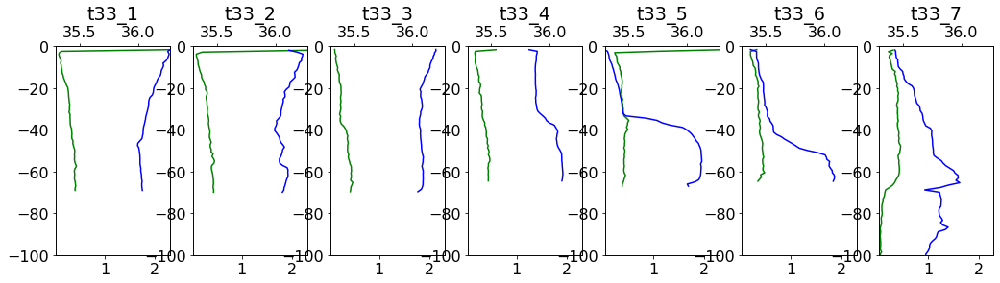

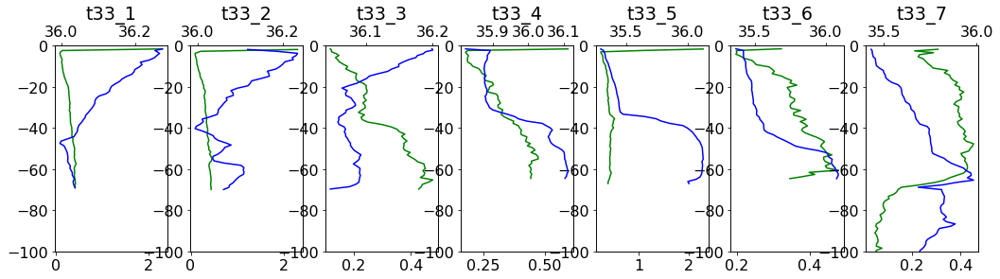

##################################
##################################
2021-04-27 16:07:52.050057600


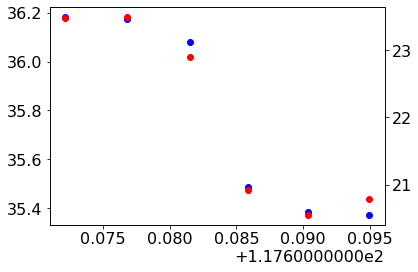

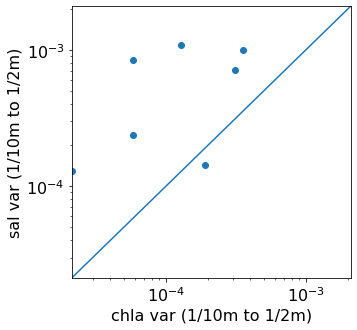

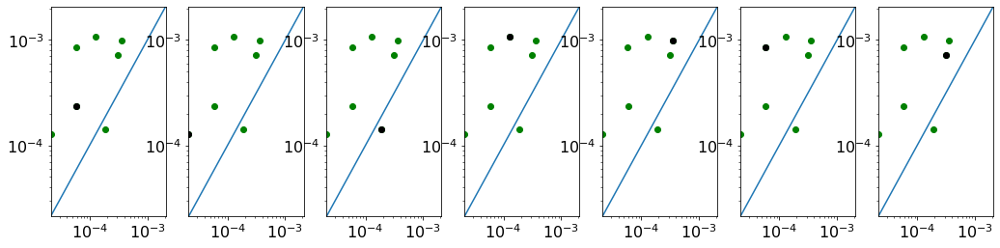

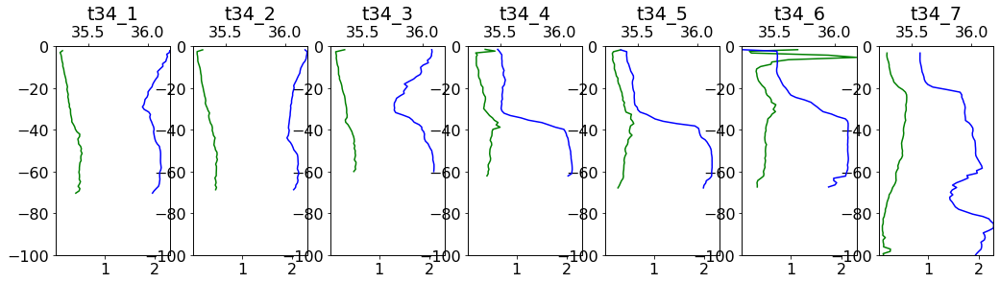

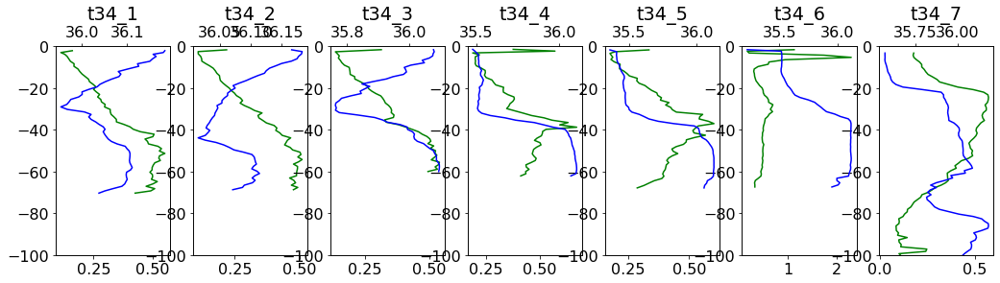

##################################
##################################
2021-06-15 12:25:11.518838400


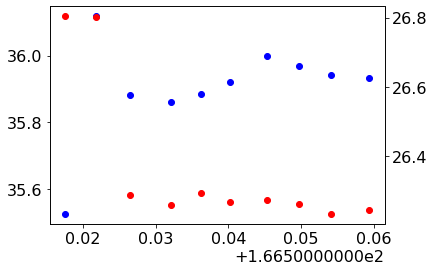

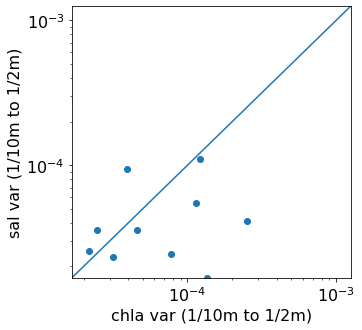

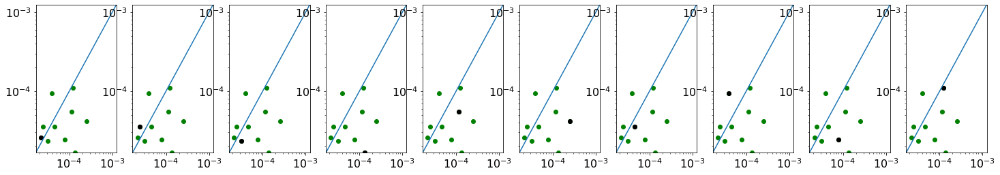

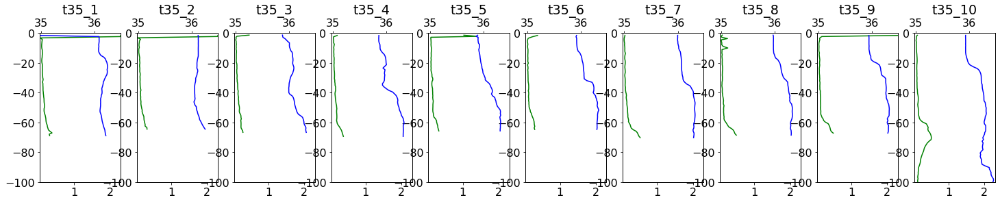

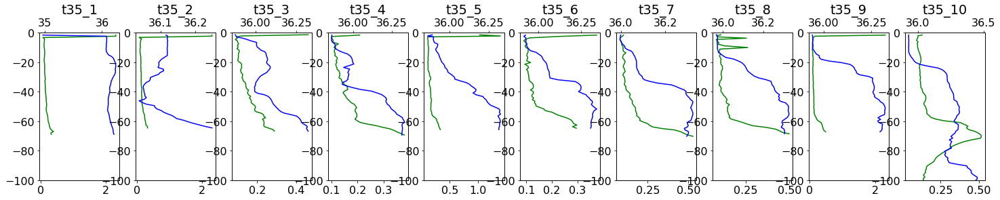

##################################
##################################
2021-06-15 14:55:49.508169600


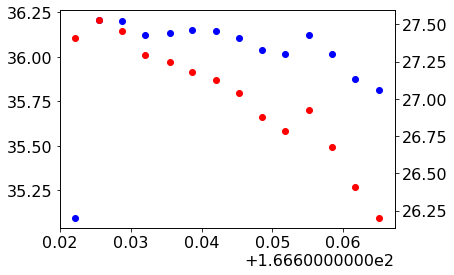

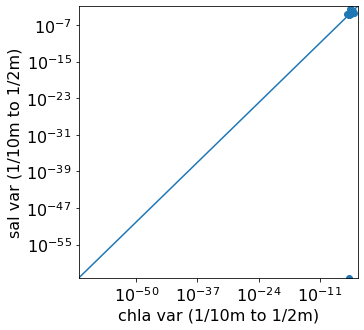

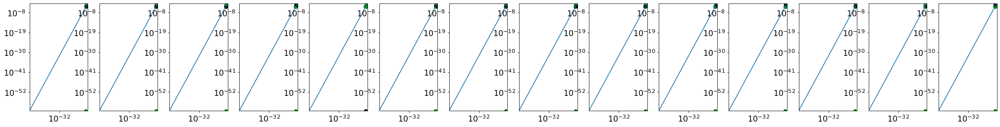

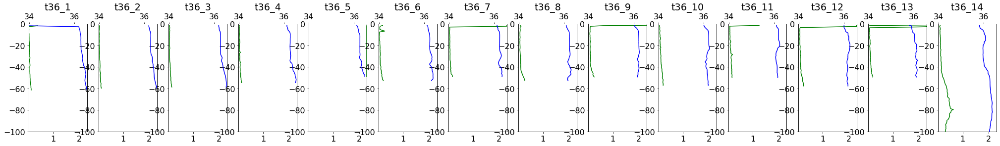

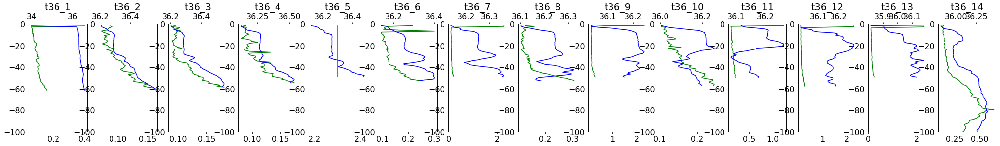

##################################
##################################
2021-06-16 12:40:12.584092799


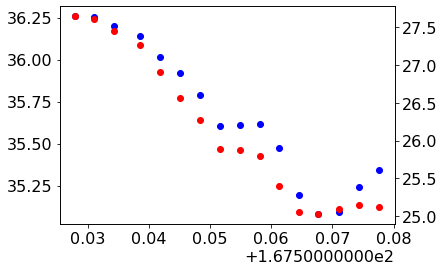

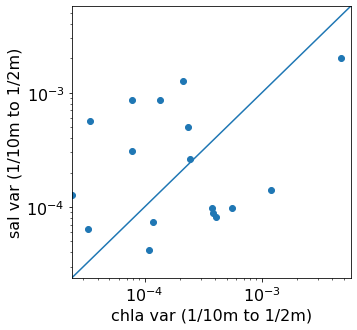

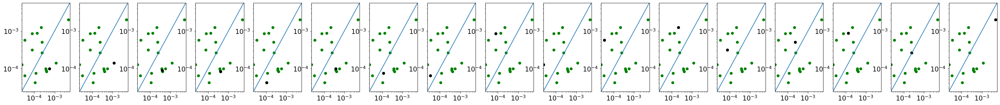

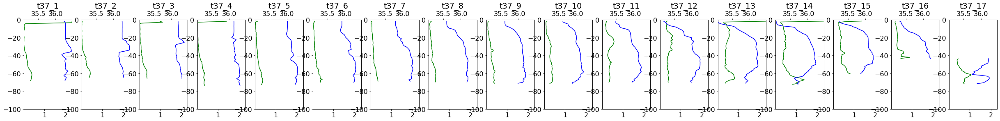

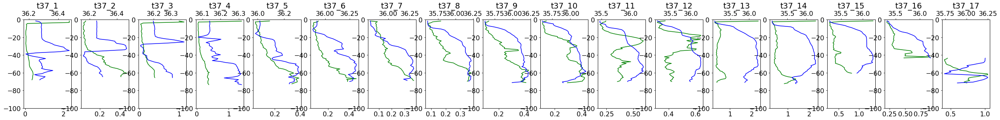

##################################
##################################
2021-06-16 16:06:16.864387200


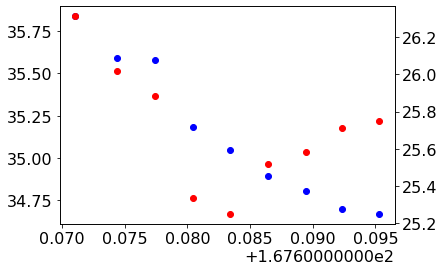

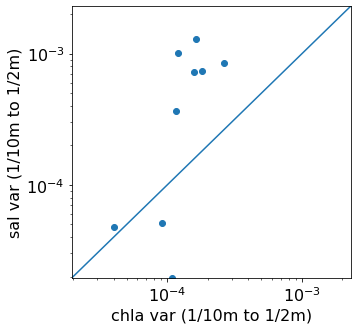

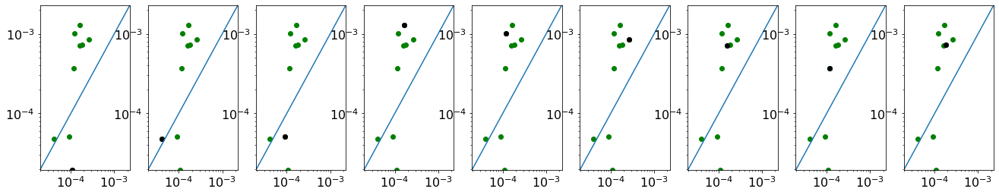

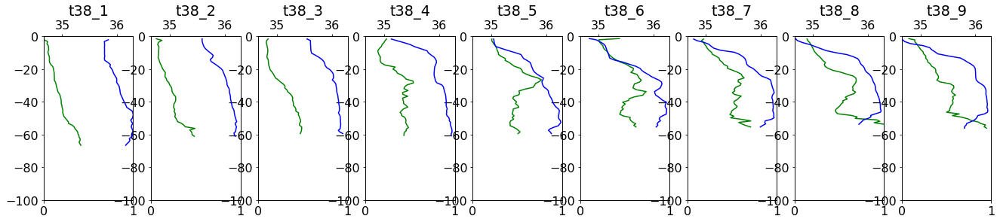

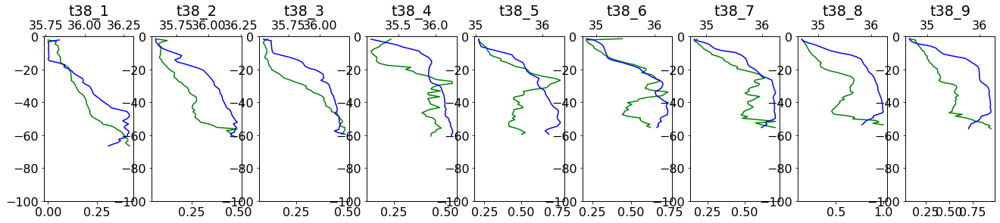

##################################
##################################
2021-06-17 12:48:49.583894400


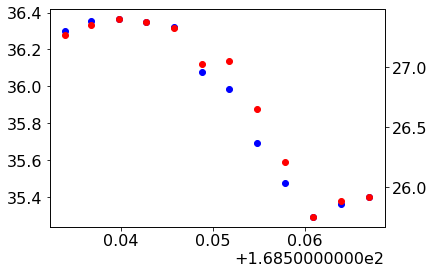

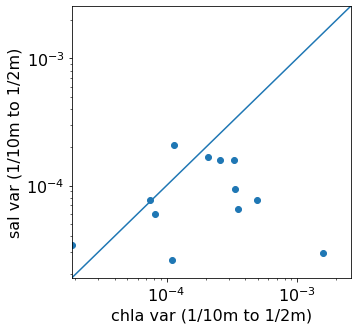

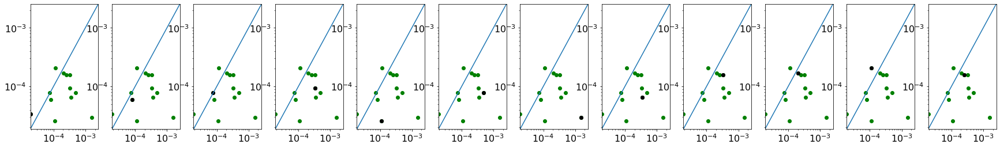

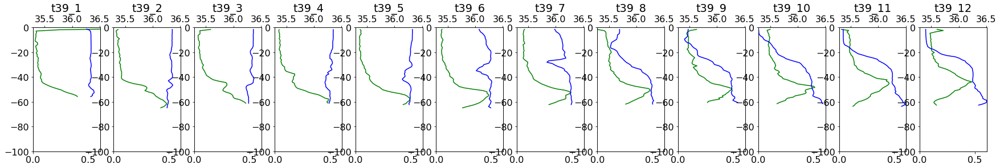

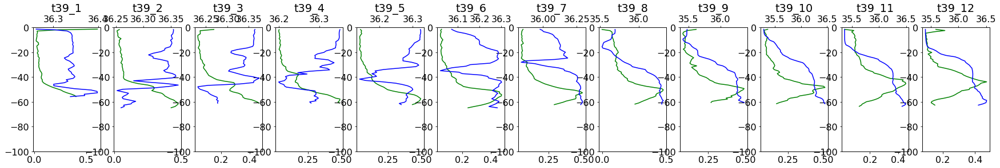

##################################
##################################
2021-06-17 14:18:21.848976


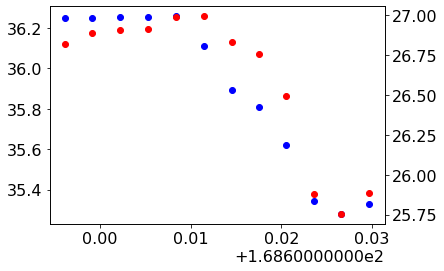

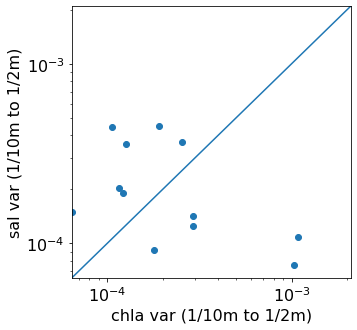

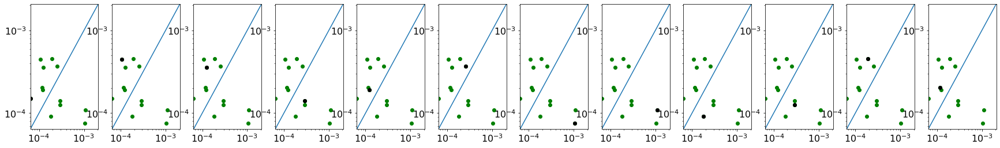

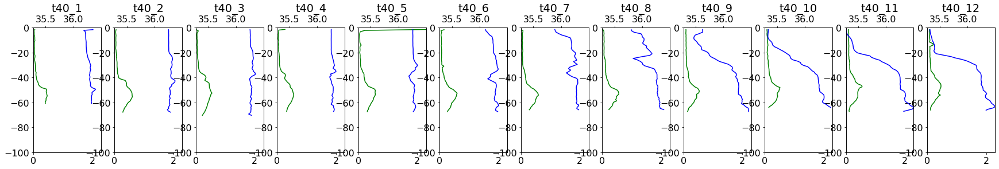

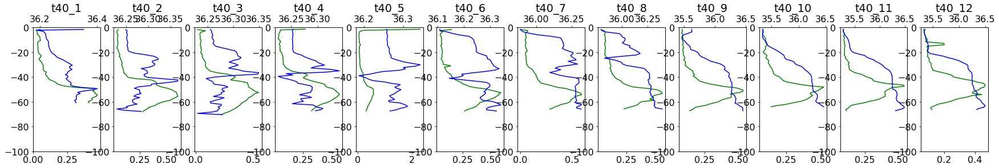

##################################
##################################
2021-10-05 12:50:43.270396800


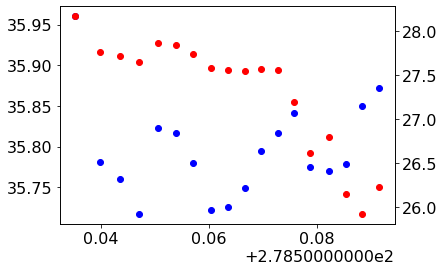

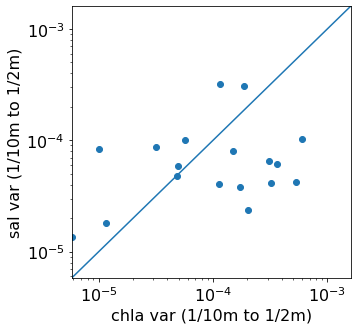

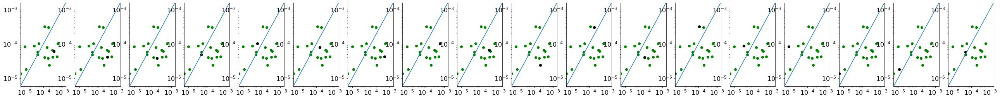

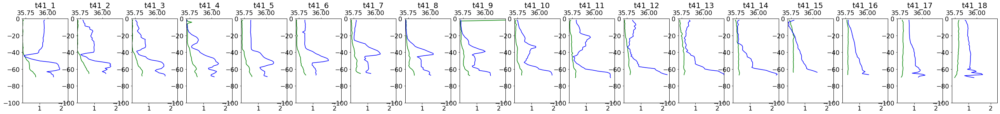

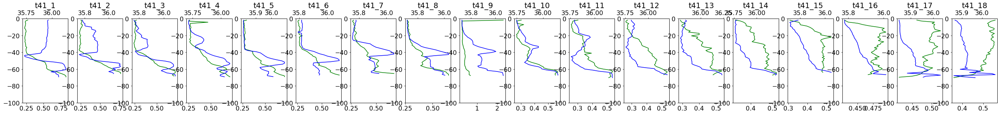

##################################
##################################
2021-10-05 15:47:44.396390400


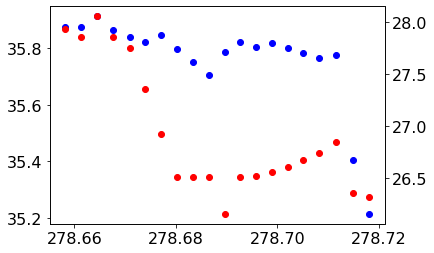

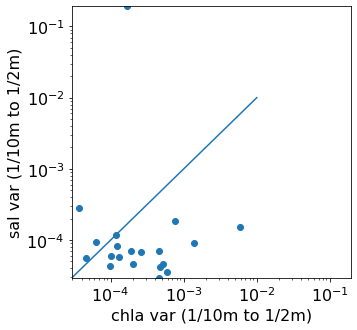

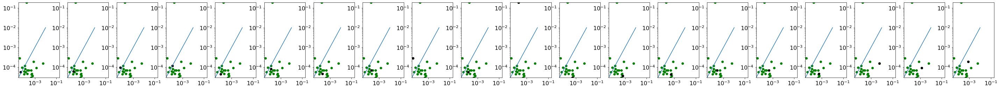

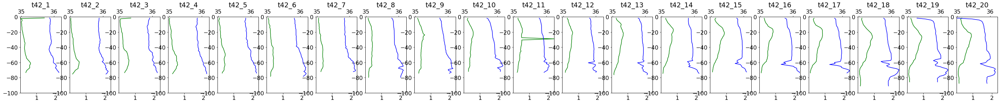

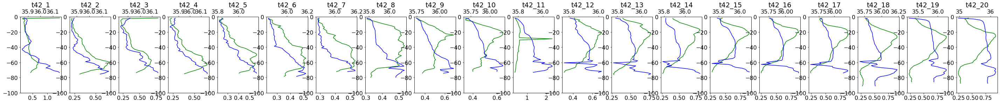

##################################
##################################
2021-10-06 13:15:55.708272


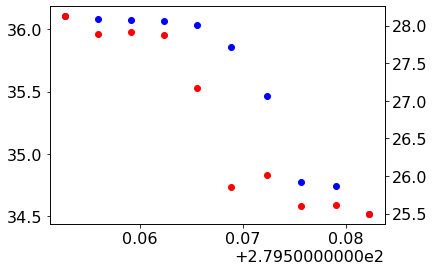

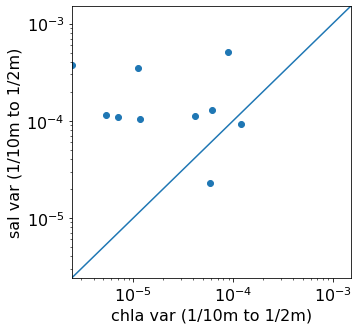

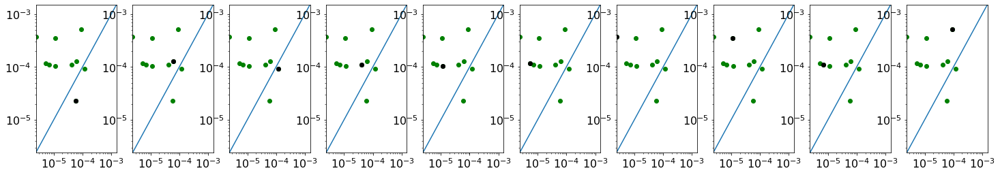

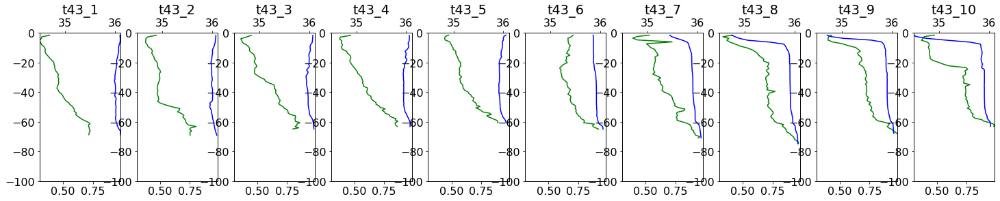

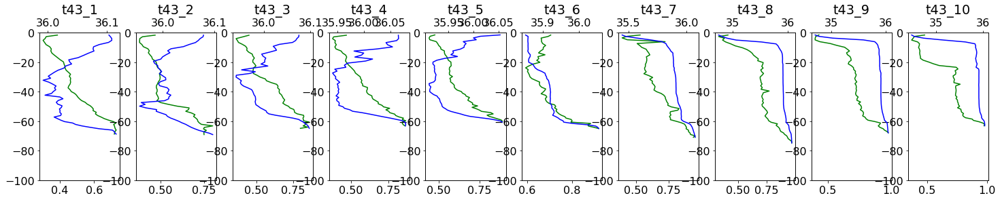

##################################
##################################
2021-10-06 15:10:19.973481600


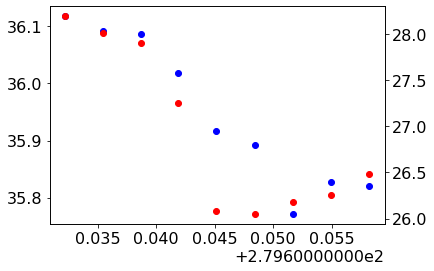

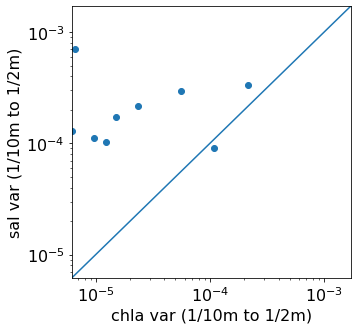

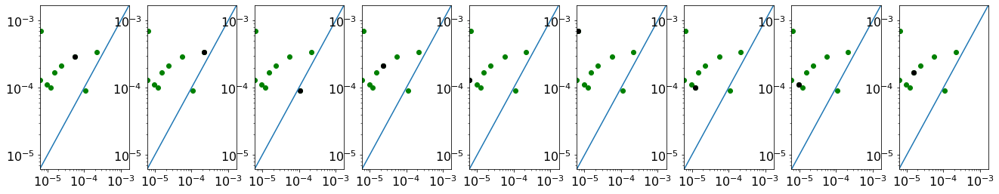

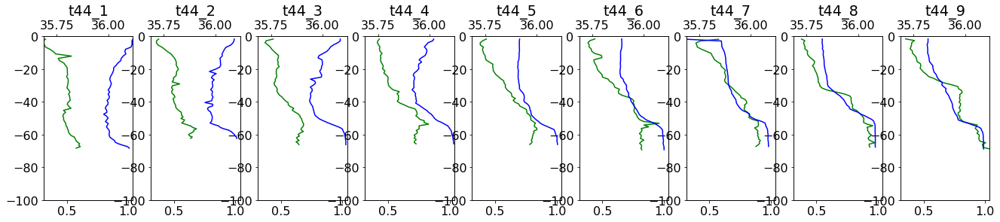

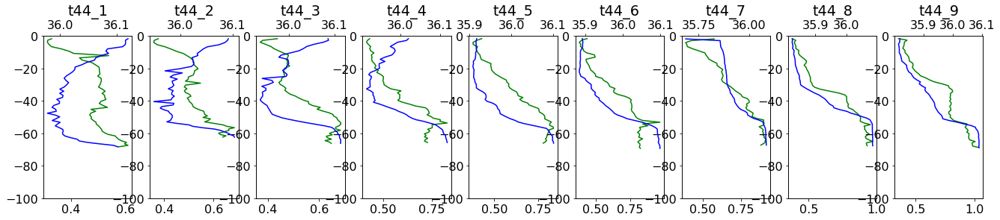

##################################
##################################
2021-10-20 13:25:58.408579200


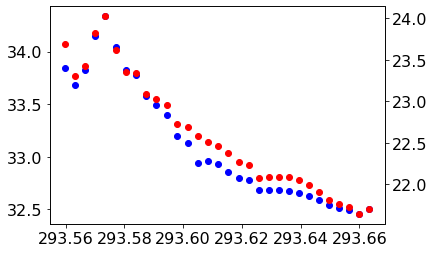

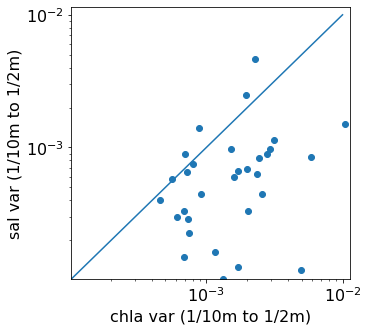

KeyboardInterrupt: 

In [170]:
for trans in natsorted(profiles.transect.unique()):
    t = profiles[profiles.transect==trans]
    # for p in t.profile_num.unique():
    #     if p in complete_profs:
    #         ps.append(p)
    #     ps = complete_profs in t.profile_num]
    ps = t.profile_num.unique()
    if len(ps) > 0:
        print(t.iloc[0].datetime)
        fig, ax = plt.subplots()
        ax.scatter(t[t['depth (dBars)']>-3].groupby('profile_num').mean()['time'],t[t['depth (dBars)']>-3].groupby('profile_num').mean()['salinity (PSU)'],c='blue')
        ax1 = ax.twinx()
        ax1.scatter(t[t['depth (dBars)']>-3].groupby('profile_num').mean()['time'],t[t['depth (dBars)']>-3].groupby('profile_num').mean()['temp (C)'],c='red')
        plt.show()
        
        chla_fine_scale = [] 
        sal_fine_scale = []
        
        

        for prof_i in ps:
            input_df = profiles[profiles.profile_num == prof_i]

            # f contains the frequency components
            # S is the PSD
            signal = input_df['salinity (PSU)']
            (f, S) = scipy.signal.welch(signal, fs=1, window=window, scaling='density',detrend=detrend,nfft=nfft, nperseg=len(input_df))
            ax.semilogy(f, S, label='salinity (PSU)',c='blue')
            chla_fine_scale.append(S[(f>0.2)&(f<0.5)].mean())

            signal = input_df['chla_clean']
            (f, S) = scipy.signal.welch(signal, fs=1, window=window, scaling='density',detrend=detrend,nfft=nfft, nperseg=len(input_df))
            ax.semilogy(f, S, label='chla',c='green')
            sal_fine_scale.append(S[(f>0.2)&(f<0.5)].mean())
            
        fig, ax = plt.subplots(figsize=(5,5))
        ax.scatter(chla_fine_scale,sal_fine_scale)
        ax.set_xlabel('chla var (1/10m to 1/2m)')
        ax.set_ylabel('sal var (1/10m to 1/2m)')
        ax.plot([0,.01],[0,.01])
        ax.set_xlim(np.min([chla_fine_scale,sal_fine_scale]),np.max([chla_fine_scale,sal_fine_scale])+.001)
        ax.set_ylim(np.min([chla_fine_scale,sal_fine_scale]),np.max([chla_fine_scale,sal_fine_scale])+.001)
        ax.set_yscale('log')
        ax.set_xscale('log')

        fig, ax = plt.subplots(1,len(ps),figsize=(2.5*len(ps),4))
        for i, pn in enumerate(ps):
            ax0 = ax[i]
            ax0.scatter(chla_fine_scale,sal_fine_scale,c='green')
            ax0.scatter(chla_fine_scale[i],sal_fine_scale[i],c='k')
#             ax0.set_xlabel('chla var (1/10m to 1/2m)')
#             ax0.set_ylabel('sal var (1/10m to 1/2m)')
            ax0.plot([0,.01],[0,.01])
            ax0.set_xlim(np.min([chla_fine_scale,sal_fine_scale]),np.max([chla_fine_scale,sal_fine_scale])+.001)
            ax0.set_ylim(np.min([chla_fine_scale,sal_fine_scale]),np.max([chla_fine_scale,sal_fine_scale])+.001)
            ax0.set_yscale('log')
            ax0.set_xscale('log')
        plt.show()
        
        fig, ax = plt.subplots(1,len(ps),figsize=(2.5*len(ps),4))
        for i, pn in enumerate(ps):
            ax0 = ax[i]
            prof = profiles[profiles.profile_num == pn]
            ax1 = ax0.twiny()

            ax0.plot(prof.chla_clean,prof['depth (dBars)'],c='green',alpha=1)
            ax1.plot(prof['salinity (PSU)'],prof['depth (dBars)'],'blue',alpha=1)
            ax0.set_ylim(-100,0)
            ax0.set_title(pn)
            ax0.set_xlim(t.chla_clean.min(),t.chla_clean.max())
            ax1.set_xlim(t['salinity (PSU)'].min(),t['salinity (PSU)'].max())
        plt.show()
        fig, ax = plt.subplots(1,len(ps),figsize=(2.5*len(ps),4))
        for i, pn in enumerate(ps):
            ax0 = ax[i]
            prof = profiles[profiles.profile_num == pn]
            ax1 = ax0.twiny()

            ax0.plot(prof.chla_clean,prof['depth (dBars)'],c='green',alpha=1)
            ax1.plot(prof['salinity (PSU)'],prof['depth (dBars)'],'blue',alpha=1)
            ax0.set_ylim(-100,0)
            ax0.set_title(pn)
        plt.show()
        print('##################################')
        print('##################################')

### Looking at some individual profiles

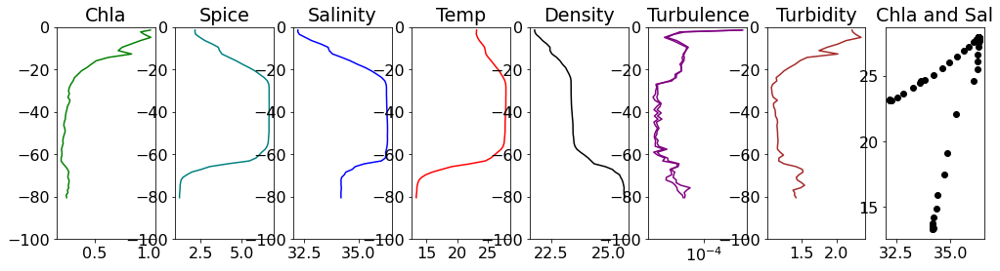

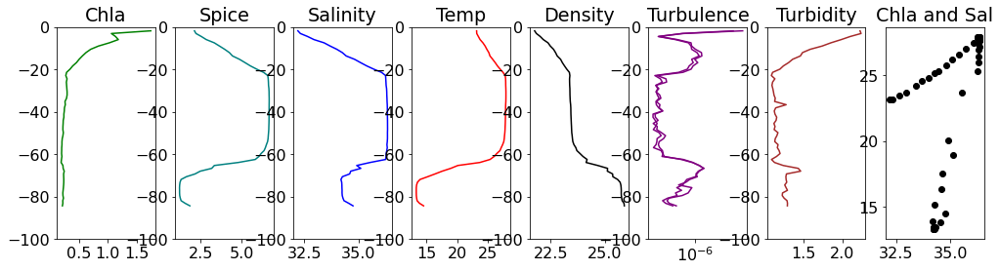

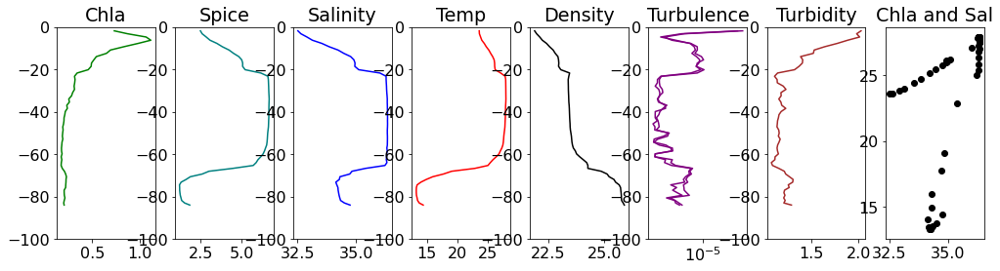

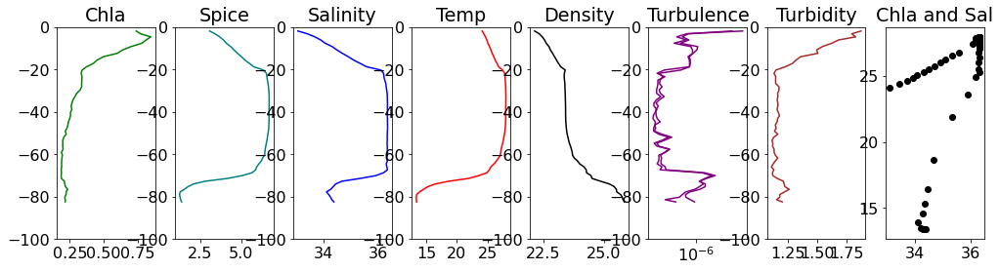

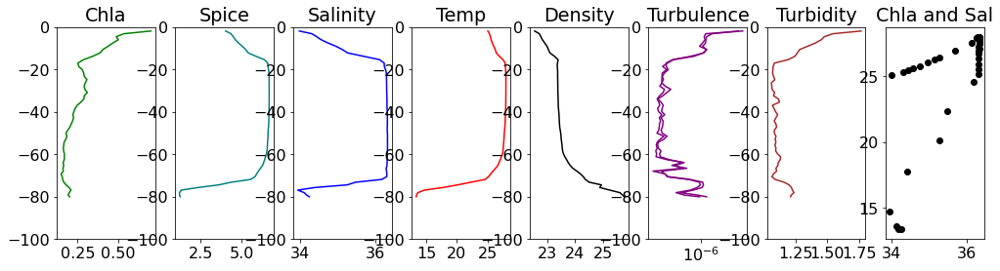

...

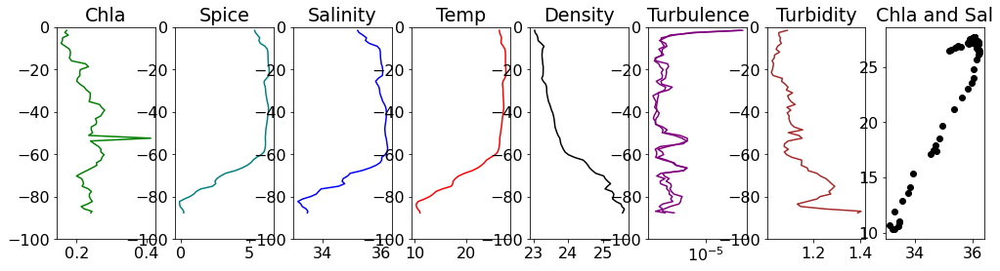

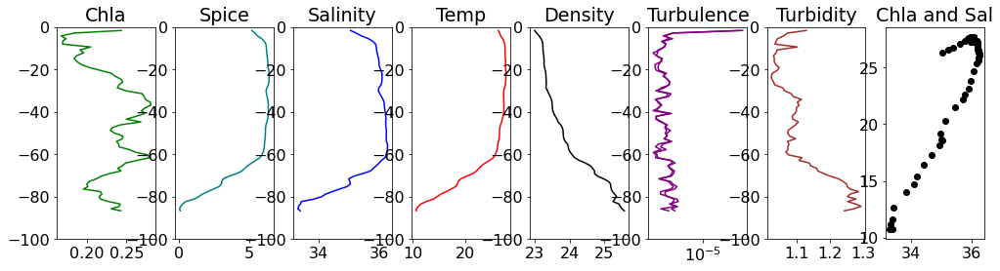

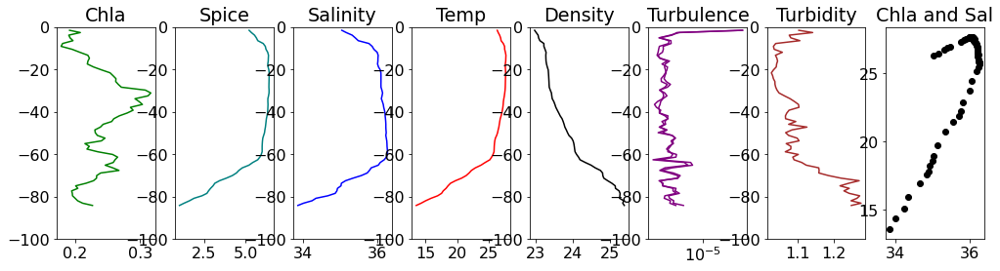

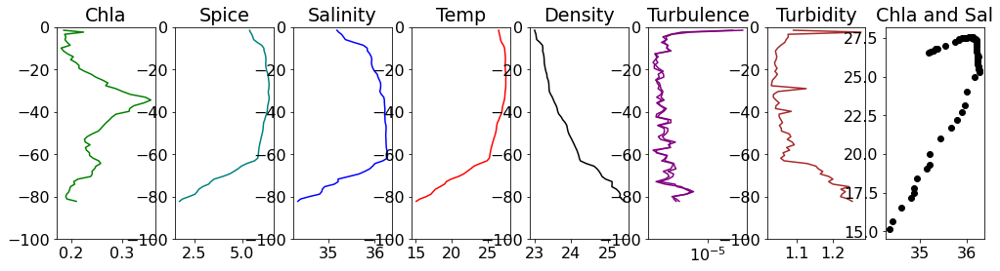

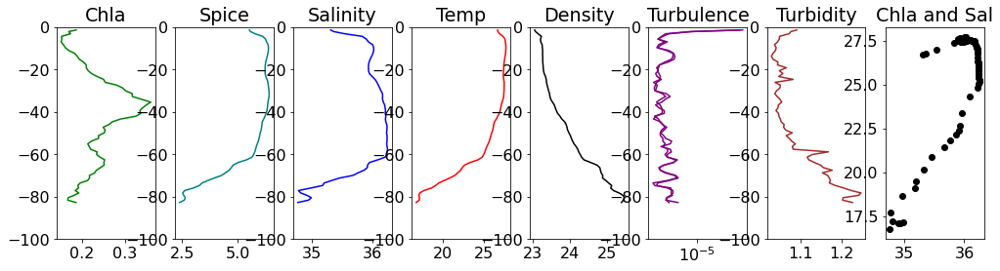

KeyboardInterrupt: 

In [396]:

for pn in complete_profs:
    fig, ax = plt.subplots(1,8,figsize=(17,4))
    prof = profiles[profiles.profile_num == pn]
    ax[0].plot(prof.chla_clean,prof['depth (dBars)'],c='green',alpha=1)
    ax[0].set_title("Chla")
    ax[1].plot(prof.spice,prof['depth (dBars)'],'teal',alpha=1)
    ax[1].set_title("Spice")
    ax[2].plot(prof['salinity (PSU)'],prof['depth (dBars)'],'blue',alpha=1)
    ax[2].set_title("Salinity")
#     ax[2].axvline(34,c='k')
#     ax[2].axvline(34.7,c='k')
#     ax[2].axvline(35.75,c='k')
    ax[3].plot(prof['temp (C)'],prof['depth (dBars)'],'red',alpha=1)
    ax[3].set_title("Temp")
    ax[4].plot(prof['potential density (kg/m^3 -1000)'],prof['depth (dBars)'],'k',alpha=1)
    ax[4].set_title("Density")
    ax[5].plot(prof['turb kinetic energy 1 (W/kg)'],prof['depth (dBars)'],'purple',alpha=1)
    ax[5].plot(prof['turb kinetic energy 2 (W/kg)'],prof['depth (dBars)'],'purple',alpha=1)
    ax[5].set_title("Turbulence")
    ax[5].set_xscale('log')
    ax[6].plot(prof['turbidity (FTU)'],prof['depth (dBars)'],'brown',alpha=1)
    ax[6].set_title("Turbidity")
    ax[7].scatter(prof['salinity (PSU)'],prof['temp (C)'],c='black',alpha=1)
#     ax[5].set_ylim(prof['depth (dBars)'].min(),prof['depth (dBars)'].max())
    ax[7].set_title("Chla and Sal")
    for a in ax[:-1]:
        a.set_ylim(-100,0)
    plt.show()

t57_5


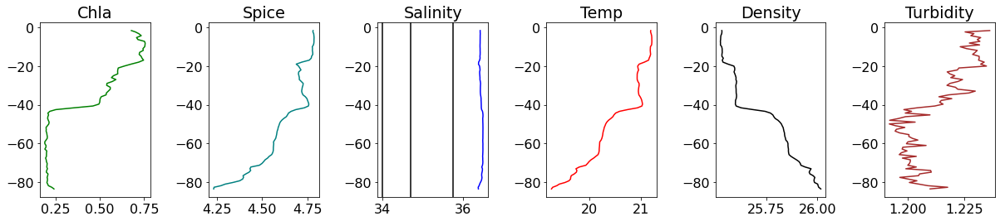

t48_14


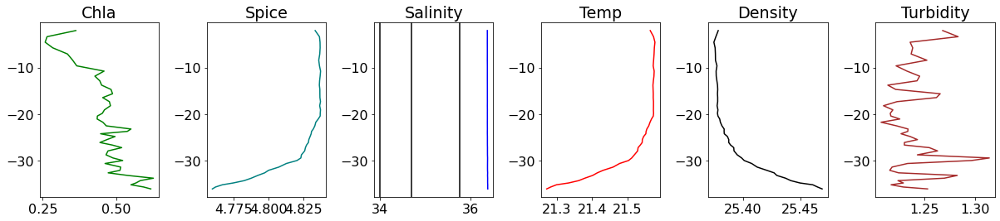

t49_3


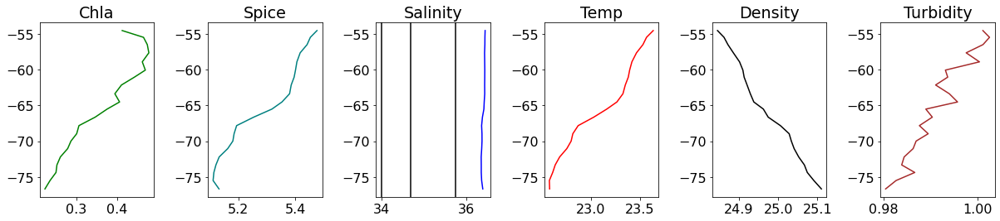

t46_4


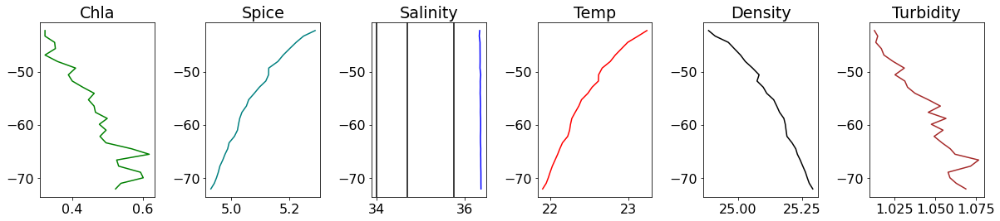

t49_5


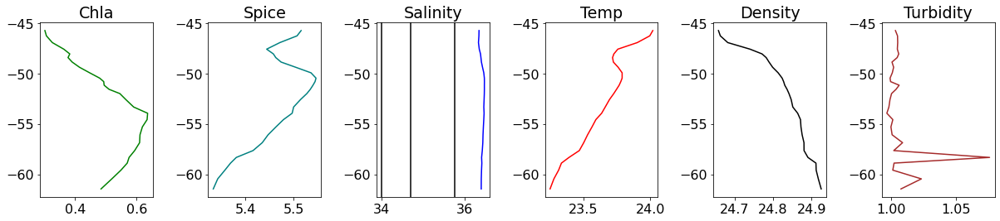

t51_11


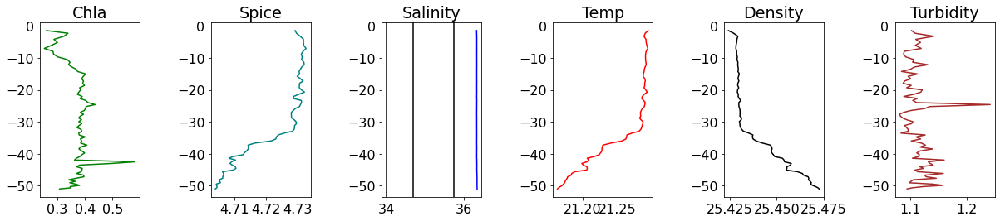

t31_13


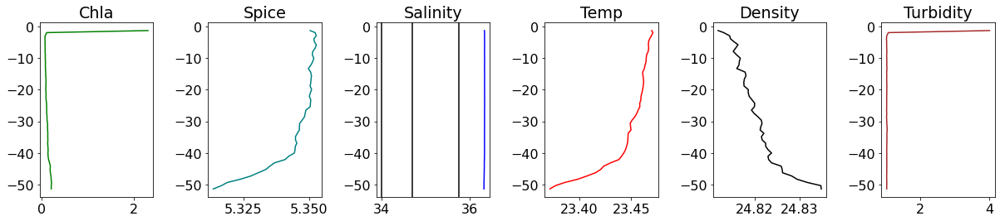

t31_2


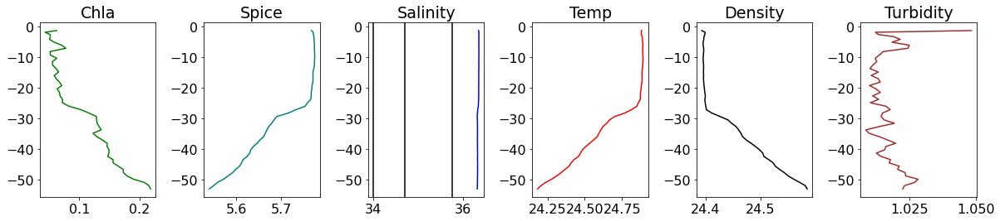

t51_2


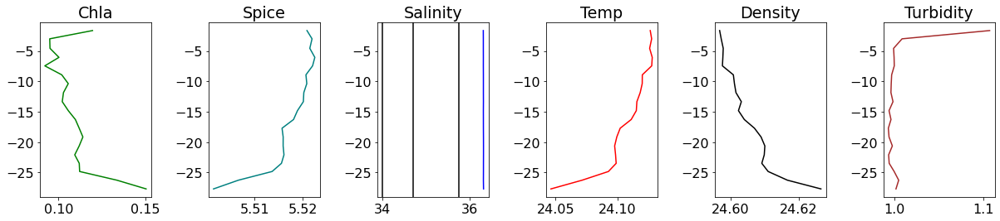

t31_11


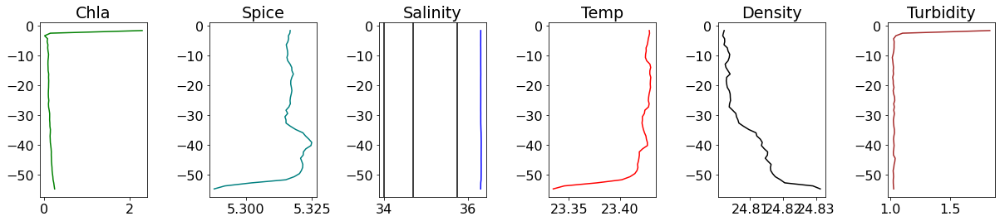

t46_10


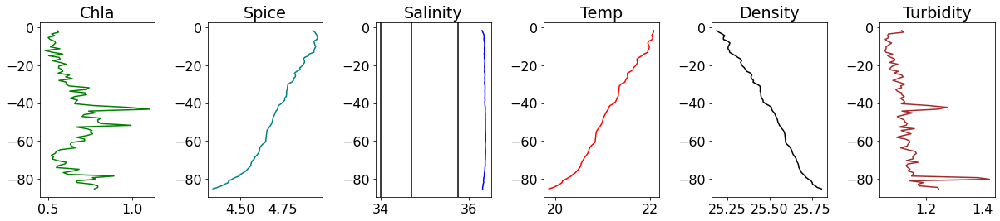

t31_12


KeyboardInterrupt: 

In [379]:
# for pn in decorr_df.sort_values('thorpe_disp',ascending=False).profile_num.values: 
for pn in profiles.groupby('profile_num').min().sort_values('salinity (PSU)',ascending=False).index.values: 
    print(pn)
    prof = profiles[profiles.profile_num == pn]
#     prof = prof[(prof['depth (dBars)'] <-5) & (prof['depth (dBars)'] >-80)]
    fig, ax = plt.subplots(1,6,figsize=(17,4))
    ax[0].plot(prof.chla_clean,prof['depth (dBars)'],c='green')
    ax[0].set_title("Chla")
#     ax.set_xlim(0,2)
    ax[1].plot(prof.spice,prof['depth (dBars)'],'teal')
    ax[1].set_title("Spice")
    ax[2].plot(prof['salinity (PSU)'],prof['depth (dBars)'],'blue')
    ax[2].set_title("Salinity")
    ax[2].axvline(34,c='k')
    ax[2].axvline(34.7,c='k')
    ax[2].axvline(35.75,c='k')
    ax[3].plot(prof['temp (C)'],prof['depth (dBars)'],'red')
    ax[3].set_title("Temp")
    ax[4].plot(prof['potential density (kg/m^3 -1000)'],prof['depth (dBars)'],'k')
    ax[4].set_title("Density")
    ax[5].plot(prof['turbidity_clean'],prof['depth (dBars)'],'brown')
#     ax[5].set_ylim(prof['depth (dBars)'].min(),prof['depth (dBars)'].max())
    ax[5].set_title("Turbidity")
#     ax[5].set_xscale('log')
#     ax[6].plot(prof.chla_clean/(prof.turbidity_clean-1),prof['depth (dBars)'],'gold')
#     ax[6].set_title("Chla / Turb")
    fig.tight_layout()
    plt.show()

In [113]:
! pip install mixsea

     |████████████████████████████████| 228 kB 3.1 MB/s eta 0:00:01


In [282]:
import mixsea as mx

In [283]:
dnoise = 5e-4  # Noise parameter
alpha = 0.95  # Coefficient relating the Thorpe and Ozmidov scales.
# Background value of epsilon applied where no overturns are detected.
background_eps = np.nan
# Do not use the intermediate profile method
use_ip = False
# Critical value of the overturn ratio
Roc = 0.3

In [127]:
# Calculate Thorpe scales and diagnostics.
eps, N2, diag = mx.overturn.eps_overturn(
    abs(prof['depth (dBars)']),
    prof['temp (C)'],
    prof['salinity (PSU)'],
    -75,
    35,
    dnoise=dnoise,
    alpha=alpha,
    Roc=Roc,
    background_eps=background_eps,
    use_ip=use_ip,
    return_diagnostics=True,
)

In [285]:
decorr_df['thorpe_disp'] = thorpe_disp

In [284]:
thorpe_disp = []
for pn in decorr_df.profile_num.values:
    prof = profiles[profiles.profile_num == pn]
    prof = prof[(prof['depth (dBars)'] <-5) & (prof['depth (dBars)'] >-80)]
    try:
        # Calculate Thorpe scales and diagnostics.
        eps, N2, diag = mx.overturn.eps_overturn(
        abs(prof['depth (dBars)']),
        prof['temp (C)'],
        prof['salinity (PSU)'],
        -75,
        35,
        dnoise=dnoise,
        alpha=alpha,
        Roc=Roc,
        background_eps=background_eps,
        use_ip=use_ip,
        return_diagnostics=True,
        )
        thorpe_disp.append(np.nanquantile(abs(diag["thorpe_disp"]), .85))
    except Exception as e: 
        print(e)
        thorpe_disp.append(np.nan)

/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/s

The entire profile is unstable, q[0] > q[-1].


/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(


### Brunt–Väisälä and Thorpe Scale Exploration

t29_8


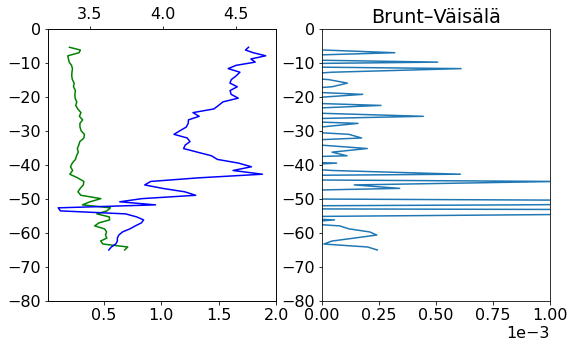

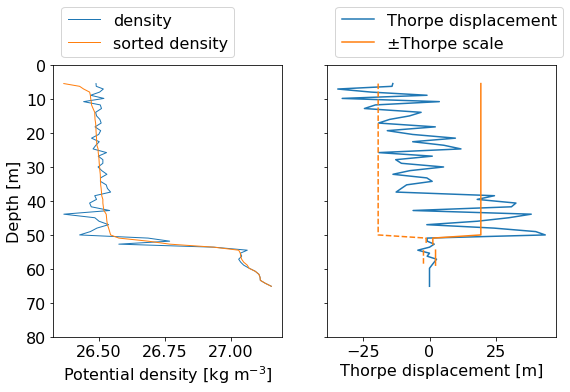

t5_1


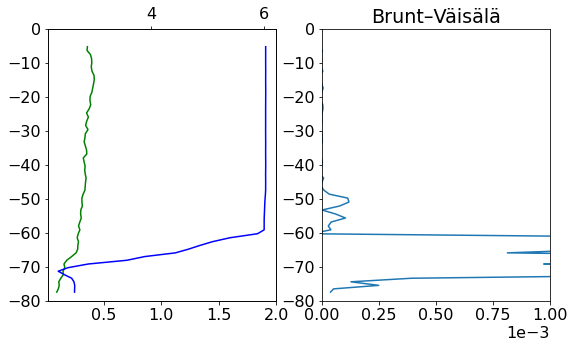

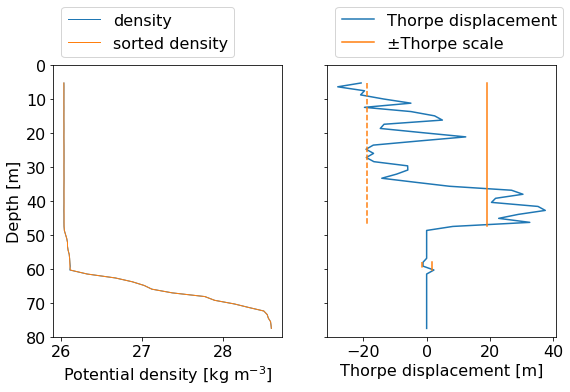

t4_6


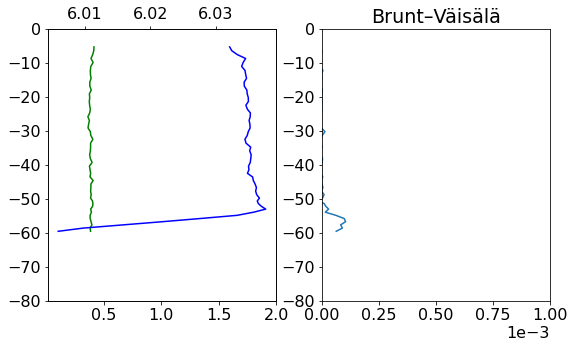

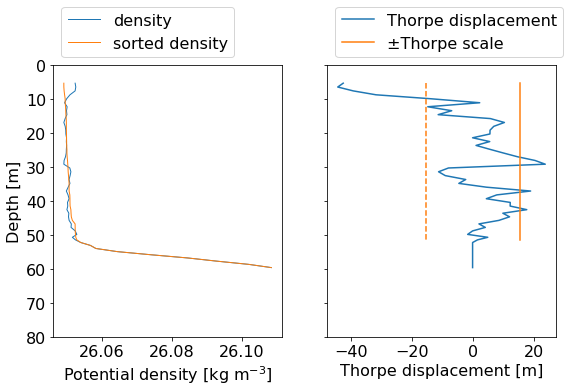

t49_1


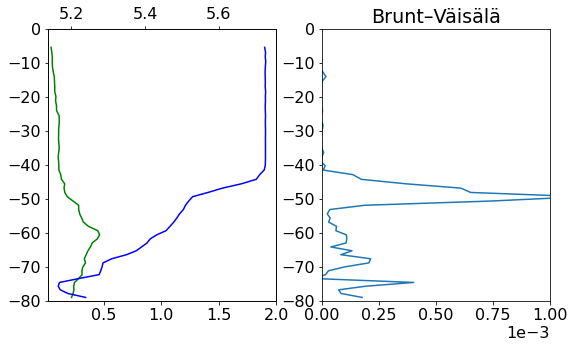

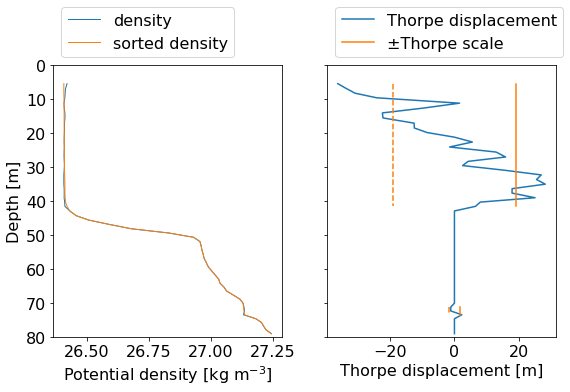

t63_3


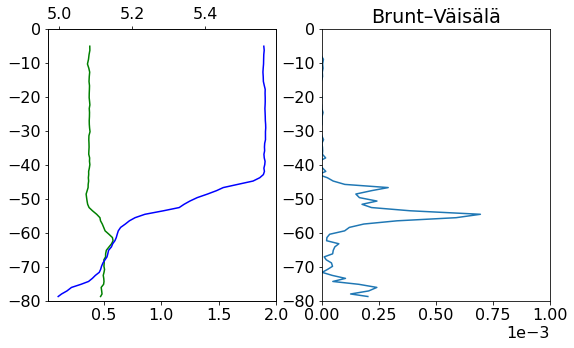

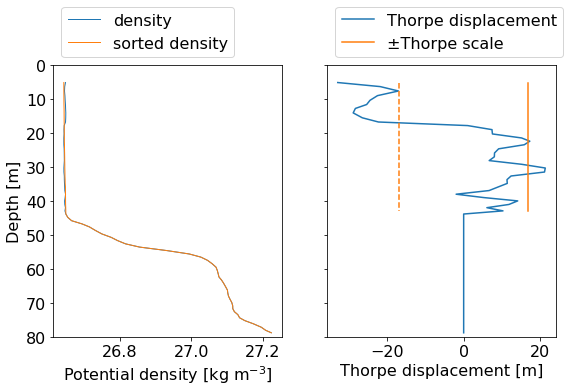

t61_11


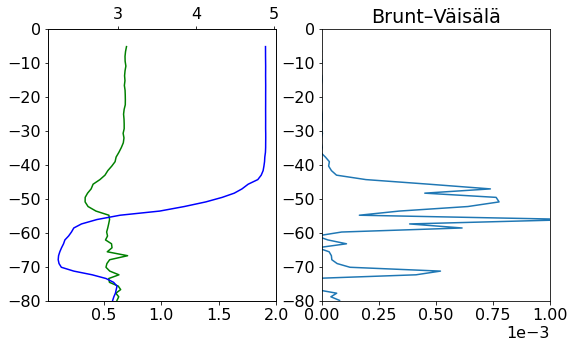

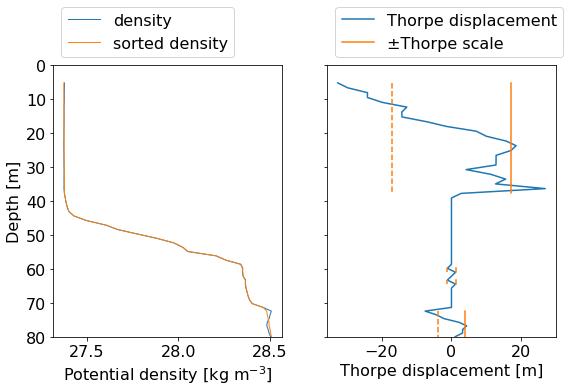

t61_13


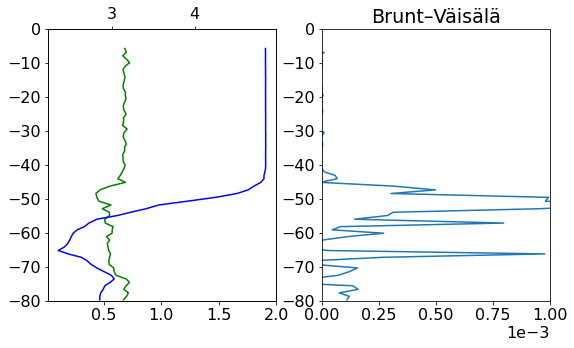

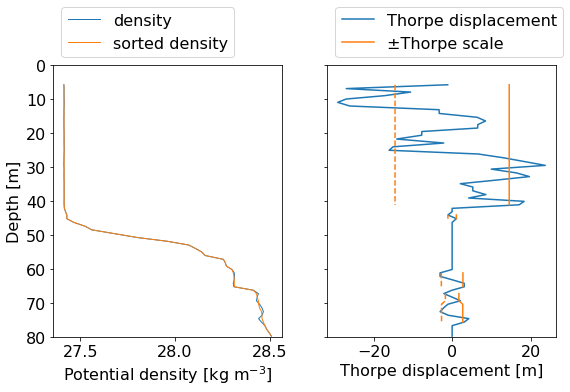

t61_8


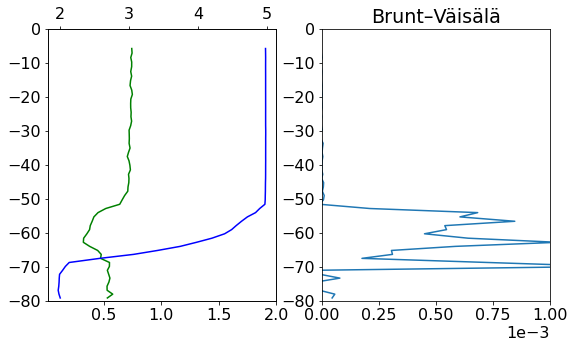

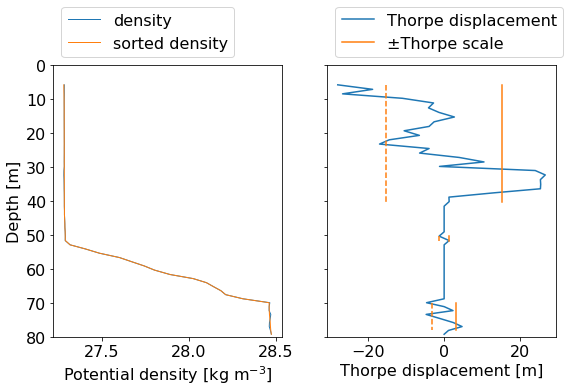

t63_1


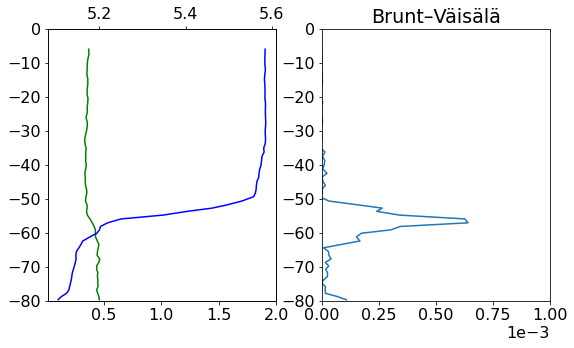

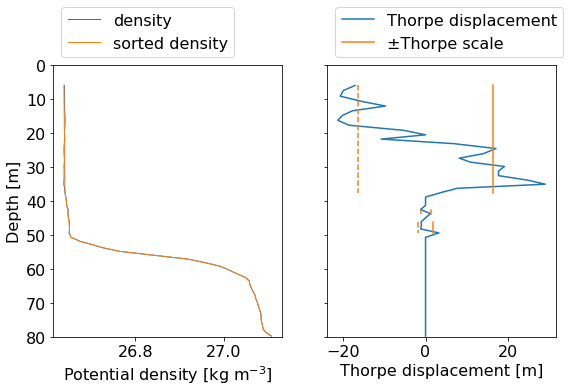

t49_4


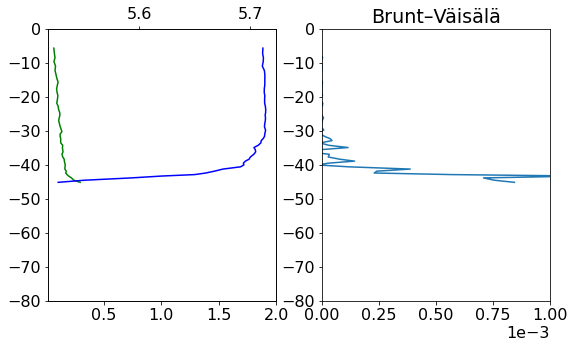

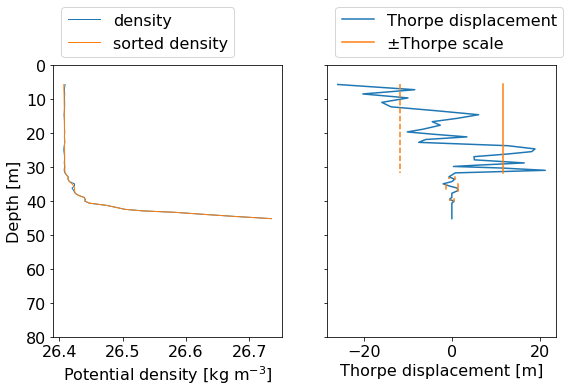

t48_1


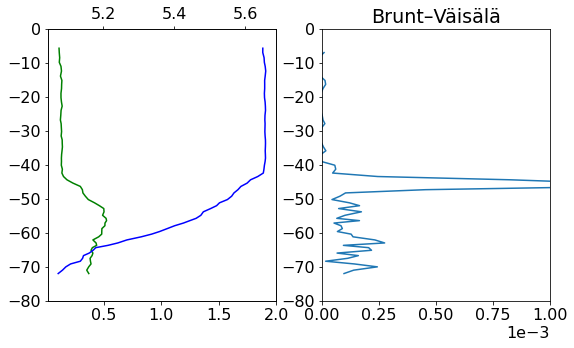

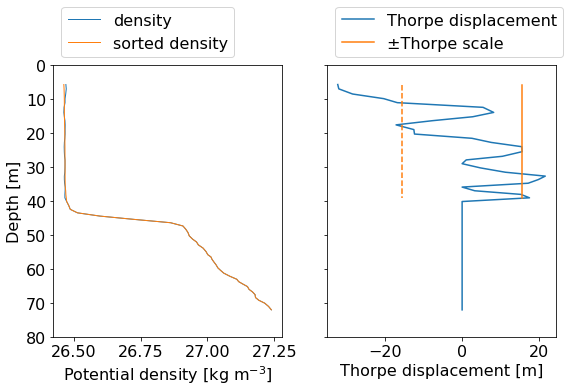

t7_5


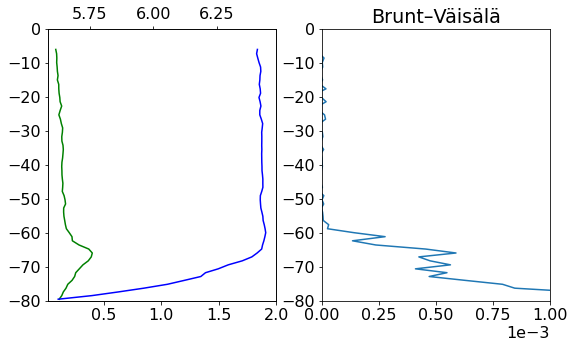

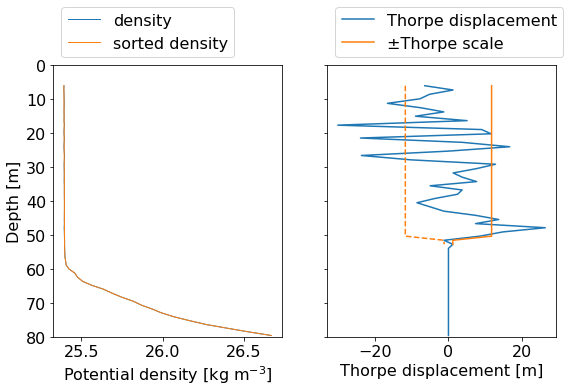

t41_2


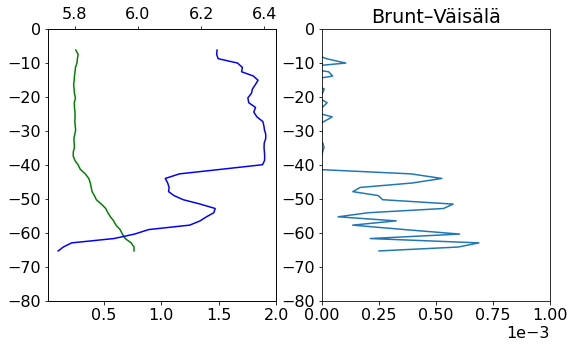

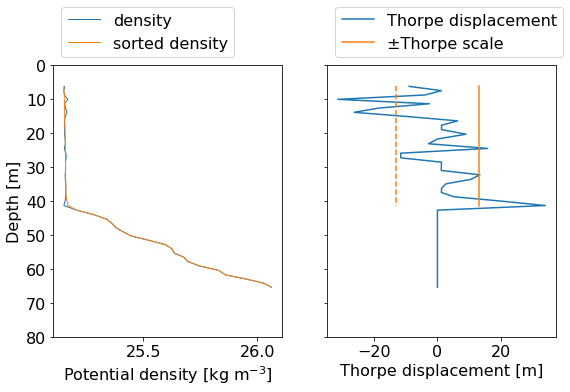

t4_5


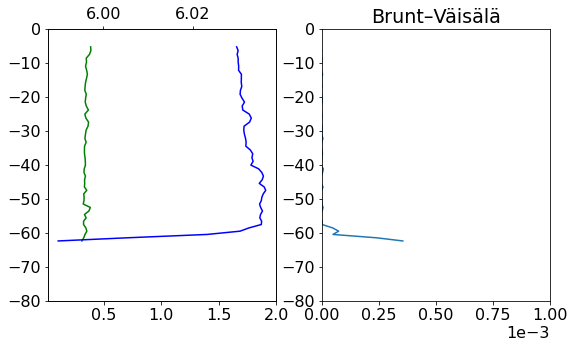

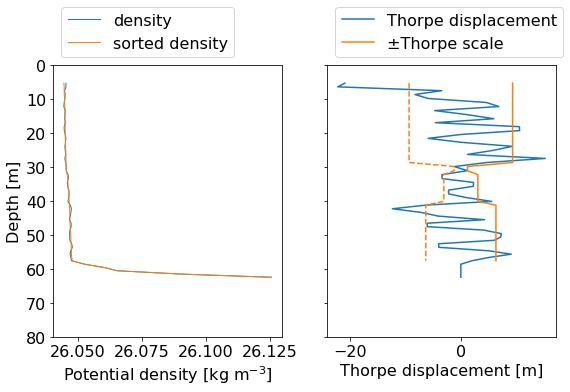

t41_1


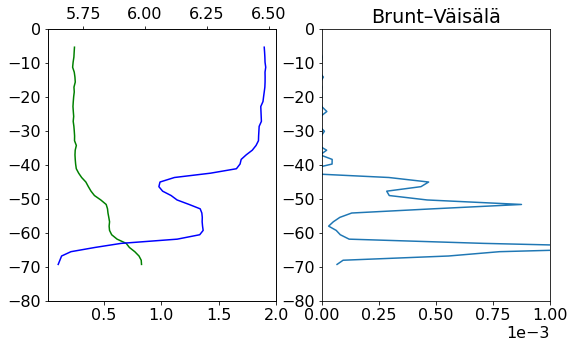

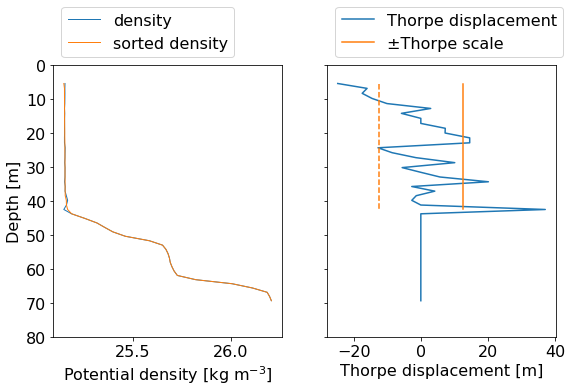

t61_6


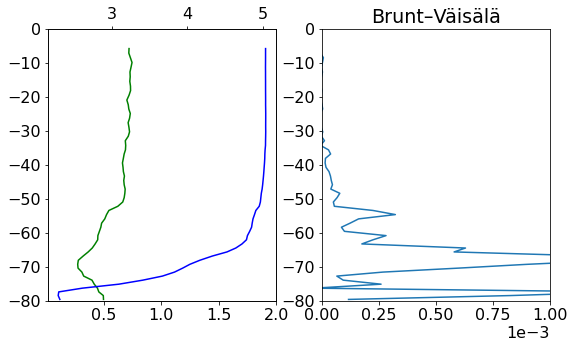

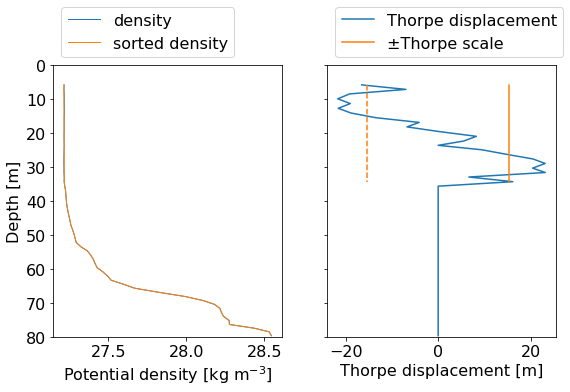

t59_7


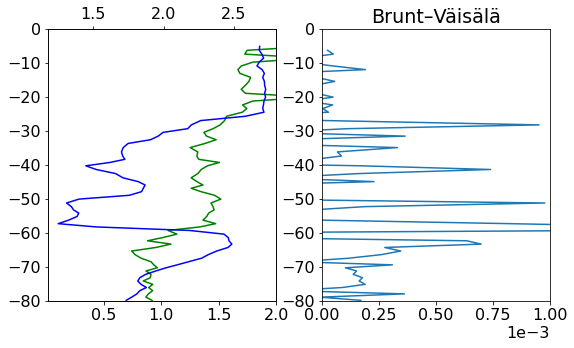

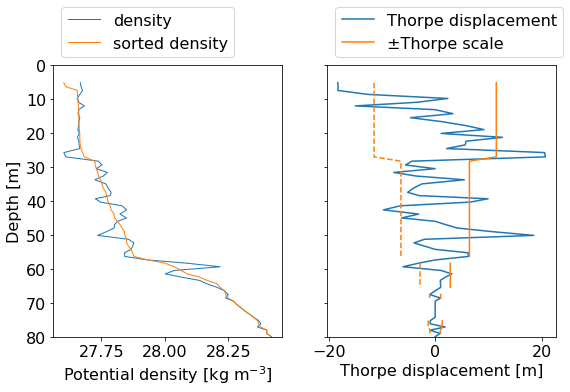

t63_2


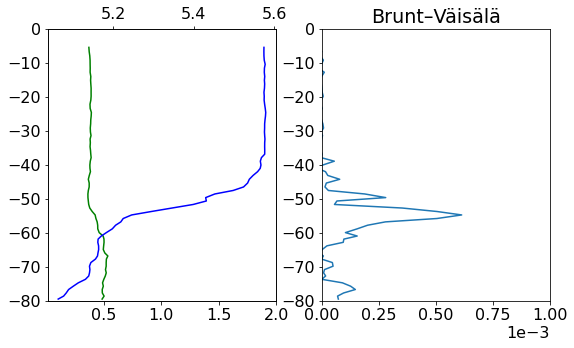

KeyboardInterrupt: 

In [108]:
for pn in decorr_df.sort_values('thorpe_disp',ascending=False).profile_num.values:
    print(pn)
    prof = profiles[profiles.profile_num == pn]
    prof = prof[(prof['depth (dBars)'] <-5) & (prof['depth (dBars)'] >-80)]
    fig, ax = plt.subplots(1,2,figsize=(9,5))
    ax[0].plot(prof.chla_clean,prof['depth (dBars)'],c='green')
    ax[0].set_xlim(0.01,2)
#     ax.set_xscale('log')
    ax[0].set_ylim(-80,0)
    ax_spice = ax[0].twiny()
    ax_spice.plot(prof.spice,prof['depth (dBars)'],'blue')
    
    n2, p_mid = gsw.stability.Nsquared(prof['salinity (PSU)'], prof['temp (C)'], abs(prof['depth (dBars)']), lat=35.5, axis=0)
    
    ax[1].plot(n2,prof['depth (dBars)'][1:])
    ax[1].ticklabel_format(style='sci',axis='x',scilimits=(0,0))
    ax[1].set_xlim(0,1e-3)
    ax[1].set_ylim(-80,0)
    ax[1].set_title('Brunt–Väisälä')
    
    plt.show()
    
    # Calculate Thorpe scales and diagnostics.
    eps, N2, diag = mx.overturn.eps_overturn(
    abs(prof['depth (dBars)']),
    prof['temp (C)'],
    prof['salinity (PSU)'],
    -75,
    35,
    dnoise=dnoise,
    alpha=alpha,
    Roc=Roc,
    background_eps=background_eps,
    use_ip=use_ip,
    return_diagnostics=True,
    )
    # Plot only in the depth range:
    # cut = (depth > 4260) & (depth < 4500)
    zc = abs(prof['depth (dBars)'])

    # finding unsorting indices for intuitive Thorpe displacements
    #idx_unsorted = np.argsort(idx_sorted)

    #axs[1].plot(thorpe_displacement[idx_unsorted][inoverturn_unsorted], z[inoverturn_unsorted])

    fig, axs = plt.subplots(1, 2, sharey=True, figsize=(9, 5))
    axs[0].plot(diag["dens"]-1000, zc, label="density", lw=1.)
    axs[0].plot(diag["dens_sorted"]-1000, zc, label="sorted density", lw=1.)
    axs[1].plot(diag["thorpe_disp"], zc, label="Thorpe displacement")
    axs[1].plot(diag["Lt"], zc, label="±Thorpe scale")
    axs[1].plot(-diag["Lt"], zc, "C1--")
    axs[0].invert_yaxis()
    axs[0].legend(loc="lower left", bbox_to_anchor=(0, 1))
    axs[1].legend(loc="lower left", bbox_to_anchor=(0, 1))
    axs[0].set_ylabel("Depth [m]")
    axs[0].set_xlabel("Potential density [kg m$^{-3}$]")
    axs[1].set_xlabel("Thorpe displacement [m]")
    
#     axs[1].set_xlim(-15,15)
    
    for a in axs:
        a.set_ylim(80,0)

    fig.align_labels()
    plt.show()

### Primary Seasonal Figure

Wind speed downloaded from https://www.ndbc.noaa.gov/station_page.php?station=41001
    
located at: 34.703 N 72.242 W

In [104]:
data_src

'data/'

In [130]:
wind_dfs = []
for fn in glob.glob(data_src+"41001*.txt"):
# for fn in glob.glob(data_src+"44014*.txt"):
    wind_dfs.append(pd.read_csv(fn, delim_whitespace=True))

wind_df = pd.concat(wind_dfs, axis=0, ignore_index=True)

wind_df['utc_dt'] = pd.to_datetime(wind_df['#YY'].astype(str)+'/'+wind_df['MM'].astype(str)+'/'+wind_df['DD'].astype(str)+' '+wind_df['hh'].astype(str)+':'+wind_df['mm'].astype(str), format='%Y/%m/%d %H:%M')

wind_df['datetime'] = wind_df['utc_dt']


wind_df = wind_df.set_index('utc_dt')

In [131]:
len(wind_df)

188832

In [132]:
wind_df.columns

Index(['#YY', 'MM', 'DD', 'hh', 'mm', 'WDIR', 'WSPD', 'GST', 'WVHT', 'DPD',
       'APD', 'MWD', 'PRES', 'ATMP', 'WTMP', 'DEWP', 'VIS', 'TIDE',
       'datetime'],
      dtype='object')

(0.0, 11.0)

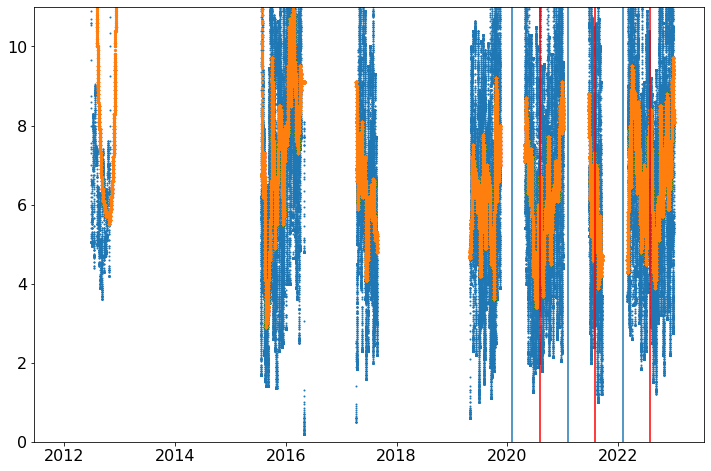

In [133]:
fig, ax = plt.subplots(figsize=(12,8))
ax.scatter(wind_df.datetime, wind_df.WSPD.rolling(6*24).median(), s=1)
ax.scatter(wind_df.datetime, wind_df.WSPD.rolling(144*14).median(), s=5)
ax.axvline(pd.to_datetime('2020/02'))
ax.axvline(pd.to_datetime('2020/08'),c='red')
ax.axvline(pd.to_datetime('2021/02'))
ax.axvline(pd.to_datetime('2021/08'),c='red')
ax.axvline(pd.to_datetime('2022/02'))
ax.axvline(pd.to_datetime('2022/08'),c='red')
ax.set_ylim(0,11)

In [116]:
wind_df[wind_df['WSPD'] > 40] = np.nan

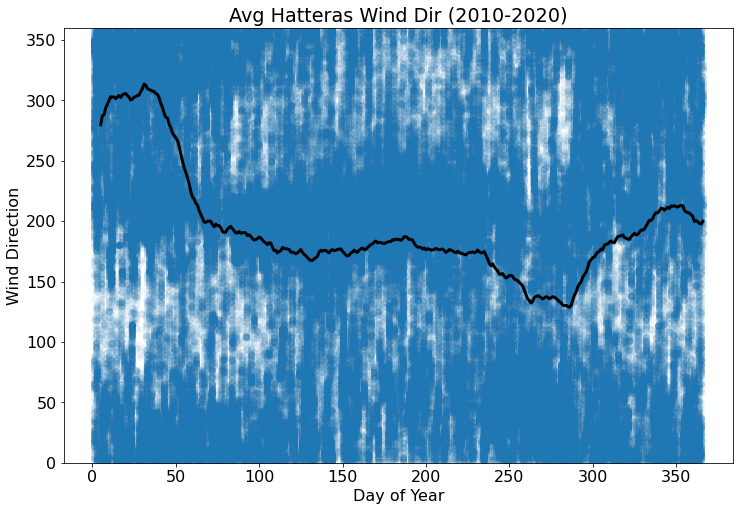

In [117]:
fig, ax = plt.subplots(figsize=(12,8))
ax.scatter(wind_df.datetime.dt.day_of_year, wind_df.WDIR,alpha=0.05)
ax.plot(wind_df.groupby(wind_df.datetime.dt.day_of_year).mean().index, wind_df.groupby(wind_df.datetime.dt.day_of_year).mean().rolling(28, min_periods=5).mean().WDIR,c='k',lw=3)
ax.set_ylim(0,360)
ax.set_ylabel('Wind Direction')
ax.set_xlabel('Day of Year')
ax.set_title('Avg Hatteras Wind Dir (2010-2020)')
plt.show()

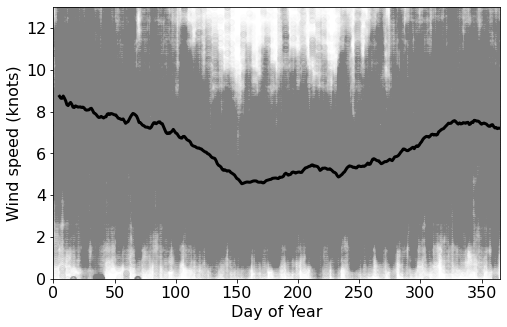

In [124]:
fig, ax = plt.subplots(figsize=(8,5))
ax.scatter(wind_df.datetime.dt.day_of_year, wind_df.WSPD,alpha=0.01,c='grey')
ax.plot(wind_df.groupby(wind_df.datetime.dt.day_of_year).mean().index, wind_df.groupby(wind_df.datetime.dt.day_of_year).mean().rolling(28, min_periods=5).mean().WSPD,c='black',lw=3)
ax.set_ylim(0,13)
ax.set_xlim(0,365)
ax.set_ylabel('Wind speed (knots)')
ax.set_xlabel('Day of Year')
plt.savefig('regional_wind.png',dpi=300)
plt.show()

In [119]:
wind_df[wind_df.WVHT > 40]=np.nan

AttributeError: 'DataFrame' object has no attribute 'WVHT'

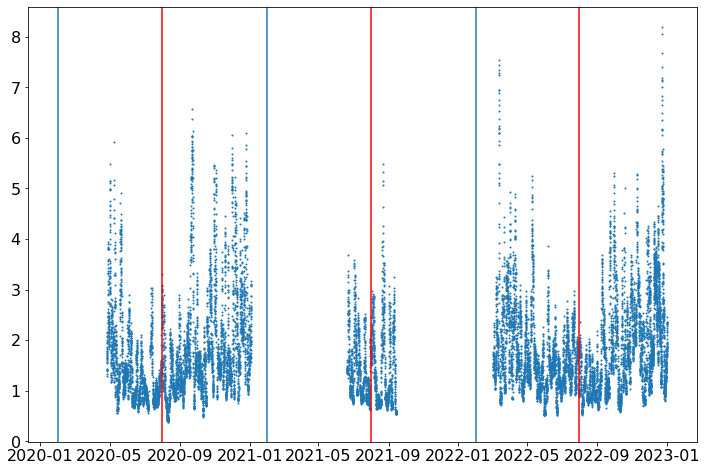

In [773]:
fig, ax = plt.subplots(figsize=(12,8))
ax.scatter(wind_df.datetime, wind_df.WVHT, s=1)
ax.axvline(pd.to_datetime('2020/02'))
ax.axvline(pd.to_datetime('2020/08'),c='red')
ax.axvline(pd.to_datetime('2021/02'))
ax.axvline(pd.to_datetime('2021/08'),c='red')
ax.axvline(pd.to_datetime('2022/02'))
ax.axvline(pd.to_datetime('2022/08'),c='red')
# ax.set_ylim(0,7)
plt.show()

NameError: name 'sst_seasonal' is not defined

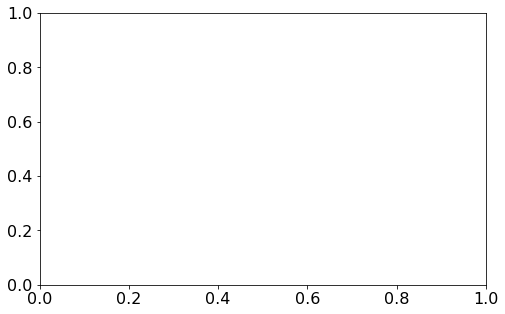

In [121]:
fig,ax = plt.subplots(figsize=(8,5))

dates_x_sst = np.arange(1,366,1)

####################

sst_mean = sst_seasonal.groupby([sst_seasonal.index.month, sst_seasonal.index.day]).mean()
sst_std = sst_seasonal.groupby([sst_seasonal.index.month, sst_seasonal.index.day]).std()

ax.plot(dates_x_sst,sst_mean.gs_sst, c='blue', label='Gulf Stream')
ax.plot(dates_x_sst,sst_mean.gs_sst+sst_std.gs_sst, c='blue', alpha=0.2)
ax.plot(dates_x_sst,sst_mean.gs_sst-sst_std.gs_sst, c='blue', alpha=0.2)

###################

ax.plot(dates_x_sst,sst_mean.coastal_sst, c='green', label='Coastal')
ax.plot(dates_x_sst,sst_mean.coastal_sst+sst_std.coastal_sst, c='green', alpha=0.2)
ax.plot(dates_x_sst,sst_mean.coastal_sst-sst_std.coastal_sst, c='green', alpha=0.2)

################

for i in range(len(list_of_chla_prof)):
    chlas = list_of_chla_prof[i].chla_clean
    doy = list_of_sst_adcp_gdf[i].datetime.dt.day_of_year[0]
    ssts = list_of_sst_adcp_gdf[i].sst
    ax.plot([doy]*len(ssts),ssts+273,c='k',alpha=0.4)

##################

# ax.legend(loc='lower right')

ax.set_ylabel('SST (C)')
ax.set_xlabel('Day of Year')

plt.savefig('gs_coastal_sst.png',dpi=300)


fig,ax = plt.subplots(figsize=(8,5))

chla_mean = chla_seasonal.groupby([chla_seasonal.index.month, chla_seasonal.index.day]).mean()
chla_std = chla_seasonal.groupby([chla_seasonal.index.month, chla_seasonal.index.day]).std()

str_dts = []
for i in range(len(chla_mean.index)):
    str_dts.append(str(chla_mean.index[i][1])+','+str(chla_mean.index[i][0]))
    
day_of_year_chla = [datetime.strptime(dt,"%d,%m").timetuple().tm_yday for dt in str_dts]

dates_x_chla = day_of_year_chla

####################

ax.plot(dates_x_chla,chla_mean.gs_chla, c='blue', label='Gulf Stream')
ax.plot(dates_x_chla,chla_mean.gs_chla+chla_std.gs_chla, c='blue', alpha=0.2)
ax.plot(dates_x_chla,chla_mean.gs_chla-chla_std.gs_chla, c='blue', alpha=0.2)

###################

ax.plot(dates_x_chla,chla_mean.coastal_chla, c='green', label='Coastal')
ax.plot(dates_x_chla,chla_mean.coastal_chla+chla_std.coastal_chla, c='green', alpha=0.2)
ax.plot(dates_x_chla,chla_mean.coastal_chla-chla_std.coastal_chla, c='green', alpha=0.2)

################


# for i in range(len(list_of_chla_prof)):
#     chlas = list_of_chla_prof[i].chla_clean
#     doy = list_of_sst_adcp_gdf[i].datetime.dt.day_of_year[0]
#     ax.plot([doy]*len(chlas),chlas,c='k',alpha=0.4)

##############

ax.set_ylim(0,2.75)

# ax.legend()

ax.set_ylabel('Chla (mg/m3)')
ax.set_xlabel('Day of Year')
plt.savefig('gs_coastal_chla.png',dpi=300)

fig, ax = plt.subplots(figsize=(8,5))
ax.scatter(wind_df.datetime.dt.day_of_year, wind_df.WSPD,alpha=0.02,c='grey')
ax.plot(wind_df.groupby(wind_df.datetime.dt.day_of_year).mean().index, wind_df.groupby(wind_df.datetime.dt.day_of_year).mean().rolling(28, min_periods=5).mean().WSPD,c='blue',lw=3)
ax.set_ylim(0,13)
ax.set_xlim(0,365)
ax.set_ylabel('Wind speed (knots)')
ax.set_xlabel('Day of Year')
plt.savefig('regional_wind.png',dpi=300)
plt.show()

Showing all Satellite and ADCP Transects

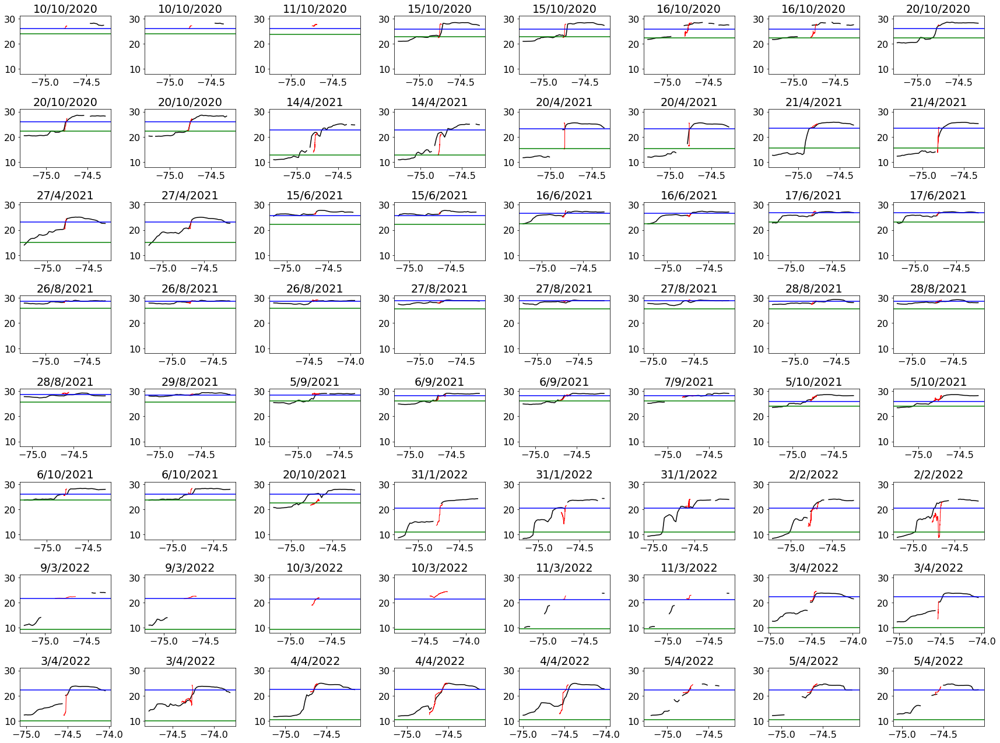

In [186]:
# Now we can select data
fig, axs = plt.subplots(nrows=8,ncols=8,figsize=(24,18))
for i, ax in enumerate(axs.reshape(-1)):
    ax.plot(list_of_sst_gdf[i].Longitude,list_of_sst_gdf[i].sst,alpha=1,c='k')
#     ax.scatter(list_of_sst_gdf[i].Longitude,list_of_sst_gdf[i].sst,c='k',alpha=0.3)
    ax.plot(list_of_sst_adcp_gdf[i].lon, list_of_sst_adcp_gdf[i].sst,lw=1,c='red',alpha=1)
    ax.set_ylim(8,31)
    ax.set_xlim(np.nanmedian(list_of_sst_adcp_gdf[i].lon)-0.55,np.nanmedian(list_of_sst_adcp_gdf[i].lon)+0.55)
    ax.set_title(str(list_of_sst_adcp_gdf[i].datetime.iloc[0].day)+'/'+str(list_of_sst_adcp_gdf[i].datetime.iloc[0].month)+'/'+str(list_of_sst_adcp_gdf[i].datetime.iloc[0].year))

    coastal_sst = sst_avgs.loc[list_of_sst_adcp_gdf[i].datetime.iloc[0].day_of_year]['coastal_sst']-273
    gs_sst = sst_avgs.loc[list_of_sst_adcp_gdf[i].datetime.iloc[0].day_of_year]['gs_sst']-273

#     dist_between_gs_coastal = distance.distance((sst_loc_gdf[sst_loc_gdf['sst']<coastal_sst].iloc[-1].Latitude, sst_loc_gdf[sst_loc_gdf['sst']<coastal_sst].iloc[-1].Longitude),
#                       (sst_loc_gdf[sst_loc_gdf['sst']>gs_sst].iloc[0].Latitude,sst_loc_gdf[sst_loc_gdf['sst']>gs_sst].iloc[0].Longitude)).meters

    ax.axhline(coastal_sst,c='green')
    ax.axhline(gs_sst,c='blue')


# ax.set_ylabel('SST (C)')
# ax.set_xlabel('longitude (but this is diagonal)')
fig.tight_layout()
plt.show()

In [573]:
len(list_of_sst_gdf)

75

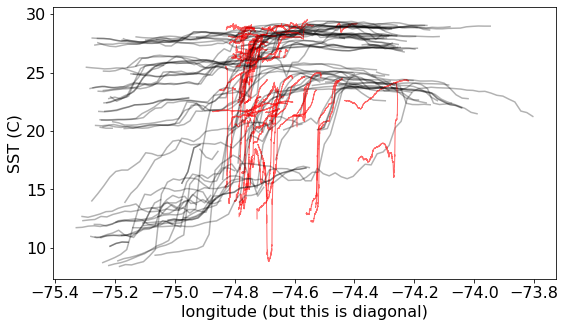

In [525]:
# Now we can select data
fig, ax = plt.subplots(figsize=(9,5))
for i in range(len(list_of_sst_gdf)):
    ax.plot(list_of_sst_gdf[i].Longitude,list_of_sst_gdf[i].sst,c='k',alpha=0.3)
#     ax.scatter(list_of_sst_gdf[i].Longitude,list_of_sst_gdf[i].sst,c='k',alpha=0.3)
    ax.plot(list_of_sst_adcp_gdf[i].lon, list_of_sst_adcp_gdf[i].sst,lw=1,c='red',alpha=0.6)

# coastal_sst = sst_avgs.loc[adcp_gdf.datetime.dt.day_of_year[0]]['coastal_sst']-273
# gs_sst = sst_avgs.loc[adcp_gdf.datetime.dt.day_of_year[0]]['gs_sst']-273

# dist_between_gs_coastal = distance.distance((sst_loc_gdf[sst_loc_gdf['sst']<coastal_sst].iloc[-1].Latitude, sst_loc_gdf[sst_loc_gdf['sst']<coastal_sst].iloc[-1].Longitude),
#                   (sst_loc_gdf[sst_loc_gdf['sst']>gs_sst].iloc[0].Latitude,sst_loc_gdf[sst_loc_gdf['sst']>gs_sst].iloc[0].Longitude)).meters

# ax.axhline(coastal_sst,c='green')
# ax.axhline(gs_sst,c='blue')
       

ax.set_ylabel('SST (C)')
ax.set_xlabel('longitude (but this is diagonal)')

# plt.savefig('all_transects_sst_context.png',dpi=300)

plt.show()

In [119]:
profs_turb_sub = profiles[profiles['turbidity (FTU)']<3]
profs_turb_sub = profs_turb_sub[profs_turb_sub['chla (ppb)']<2.29]

In [120]:
dfs = []
for i in range(len(time_starts)):
    dfs.append(profs_turb_sub.loc[time_starts[i]:time_stops[i]])
profs_turb_frontal = pd.concat(dfs)

In [150]:
profs_turb_frontal.datetime.dt.day_of_year.values
profs_turb_frontal['gs_sal_thresh'] = provide_gs_sal_threshold(profs_turb_frontal.datetime.dt.day_of_year.values, buffer=0.25)

In [153]:
profs_turb_frontal = profs_turb_frontal[profs_turb_frontal['salinity (PSU)'] > profs_turb_frontal['gs_sal_thresh']]

In [154]:
profiles_sub = profs_turb_frontal[profs_turb_frontal['depth (dBars)'] > -80]

chla = profiles_sub['chla (ppb)'].values.copy()
chla[chla > 2] = 2
chla[chla < -0.3] = -0.3
chla = chla + abs(chla.min())

turbidity = profiles_sub['turbidity (FTU)'].values.copy()
turbidity[turbidity > 4] = 4

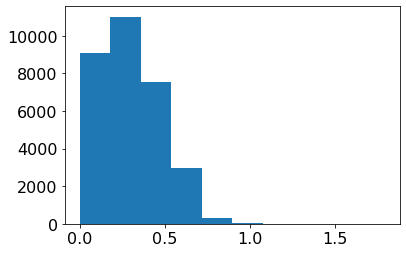

In [155]:
plt.hist(chla/turbidity)
plt.show()

- color a T-S diagram by chla:bb to see if there is clear patterning
- color a depth-DOY diagram by chla:bb

In [117]:
# Figure out boudaries (mins and maxs)
smin = 32-.7
smax = 37+.7
tmin = 8-.7 
tmax = 30+.7

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000

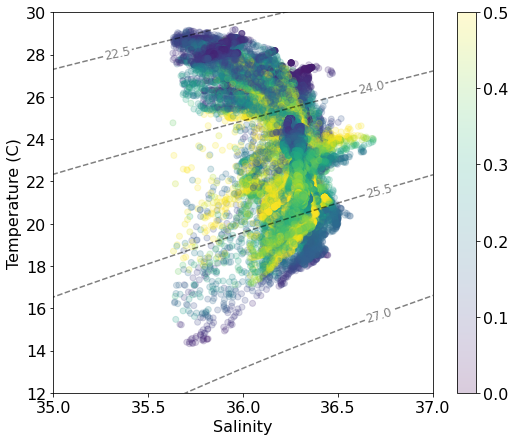

In [159]:
# Figure out boudaries (mins and maxs)
smin = 32-.7
smax = 37+.7
tmin = 8-.7 
tmax = 30+.7

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000

# plot T and S diagrams first with distance from coast and then with other variables
fig, ax = plt.subplots(figsize=(8.5,7))
markersize=40

ax.set_xlim(35,37)
ax.set_ylim(12,30)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level

# im = ax.scatter(profiles[profiles['depth (dBars)'] < -35]['salinity (PSU)'], profiles[profiles['depth (dBars)'] < -35]['temp (C)'], c=profiles[profiles['depth (dBars)'] < -35].datetime.dt.day_of_year, cmap=cmocean.cm.phase, alpha=0.1)
im = ax.scatter(profiles_sub['salinity (PSU)'], profiles_sub['temp (C)'], c=chla/turbidity, cmap='viridis',alpha=0.2,vmin=.0,vmax=.5)

fig.colorbar(im)
plt.show()

Text(0, 0.5, 'Depth (m)')

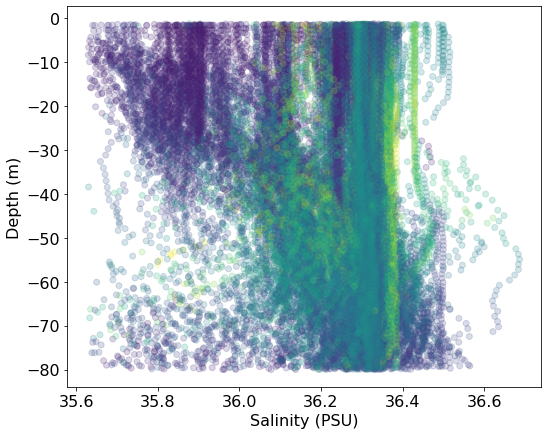

In [160]:
fig, ax = plt.subplots(figsize=(8.5,7))
ax.scatter(profiles_sub['salinity (PSU)'],profiles_sub['depth (dBars)'],c=chla/turbidity, cmap='viridis',alpha=0.2,vmin=.0,vmax=.8)

ax.set_xlabel('Salinity (PSU)')
ax.set_ylabel('Depth (m)')
# ax.set_zlabel('Days from Aug 15')
# fig.savefig('chla_across_TS_DOY.png',dpi=300)

Text(0.5, 0, 'Days from Aug 15')

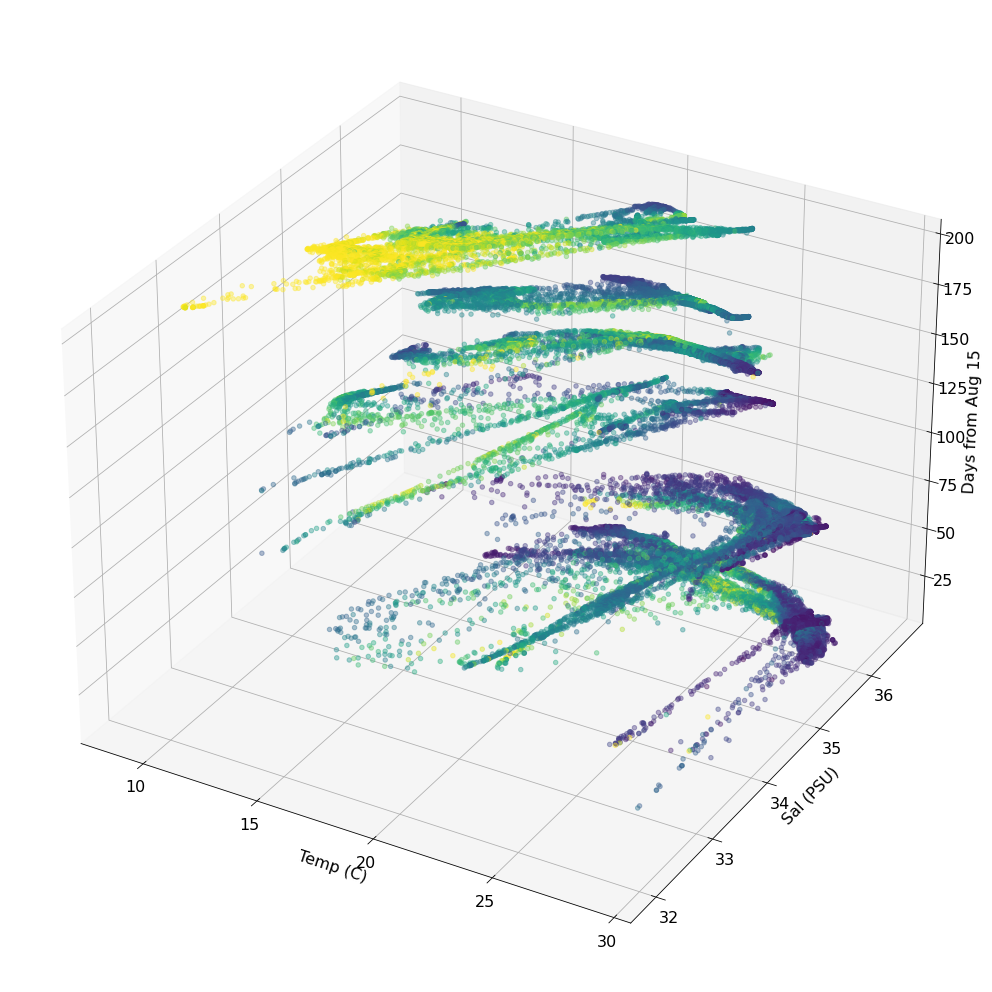

In [138]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(profiles_sub['temp (C)'], profiles_sub['salinity (PSU)'], abs(profiles_sub.datetime.dt.day_of_year.values-225),c=chla/turbidity, cmap='viridis', alpha=0.4,vmin=.0,vmax=.8)

ax.set_ylabel('Sal (PSU)')
ax.set_xlabel('Temp (C)')
ax.set_zlabel('Days from Aug 15')
# fig.savefig('chla_across_TS_DOY.png',dpi=300)

(33.5, 37.0)

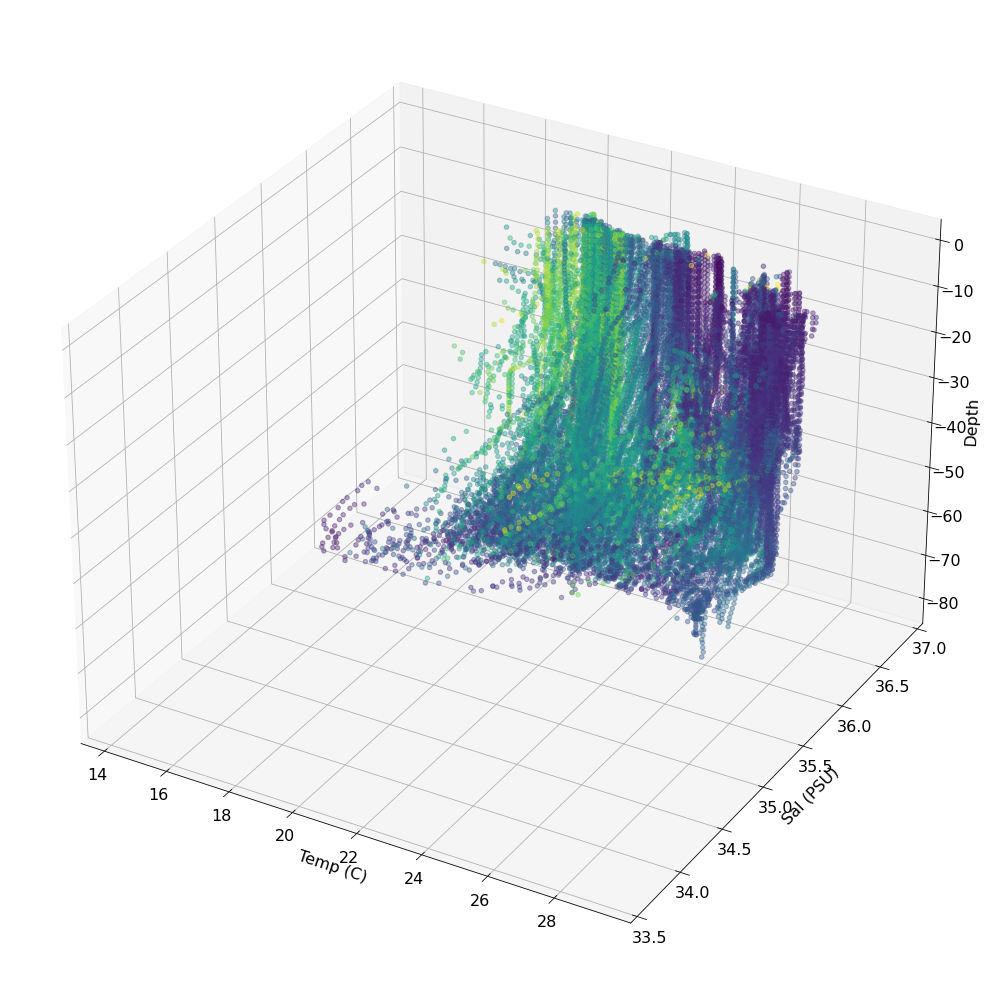

In [161]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(profiles_sub['temp (C)'], profiles_sub['salinity (PSU)'], profiles_sub['depth (dBars)'],c=chla/turbidity, cmap='viridis',alpha=0.4,vmin=.0,vmax=.8)
ax.set_ylabel('Sal (PSU)')
ax.set_xlabel('Temp (C)')
ax.set_zlabel('Depth')

ax.set_ylim(33.5,37)
# fig.savefig('chla_across_TS_d.png',dpi=300)

In [ ]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(profiles_sub['temp (C)'], profiles_sub['salinity (PSU)'], abs(profiles_sub.datetime.dt.day_of_year.values-225),c=chla, cmap='viridis',alpha=0.2,vmin=.0,vmax=1.)

ax.set_ylabel('Sal (PSU)')
ax.set_xlabel('Temp (C)')
ax.set_zlabel('Days from Aug 15')
# fig.savefig('chla_across_TS_DOY.png',dpi=300)

In [ ]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(abs(profiles_sub.datetime.dt.day_of_year.values-225), profiles_sub['temp (C)'], profiles_sub['depth (dBars)'],c=chla, cmap='viridis',alpha=0.5,vmin=.0,vmax=1.)

ax.set_xlabel('Days from Aug 15')
ax.set_ylabel('Temp (C)')
ax.set_zlabel('Depth')
# fig.savefig('chla_across_t_s_d.png',dpi=300)

In [ ]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(abs(profiles_sub.datetime.dt.day_of_year.values-225), profiles_sub['temp (C)'], profiles_sub['depth (dBars)'],c=profiles_sub['ekbackscatter'], cmap='jet',alpha=0.5,vmin=101,vmax=109)

ax.set_xlabel('Days from Aug 15')
ax.set_ylabel('Temp (C)')
ax.set_zlabel('Depth')
# fig.savefig('eksv_across_t_s_d.png',dpi=300)

In [ ]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(profiles_sub['temp (C)'], profiles_sub['salinity (PSU)'], abs(profiles_sub.datetime.dt.day_of_year.values-225),c=profiles_sub['ekbackscatter'], cmap='jet',alpha=0.5,vmin=101,vmax=109)

ax.set_ylabel('Sal (PSU)')
ax.set_xlabel('Temp (C)')
ax.set_zlabel('Days from Aug 15')
# fig.savefig('eksv_across_TS_DOY.png',dpi=300)

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(20,8))
ax[0].scatter(profiles_sub['ekbackscatter'][profiles_sub['salinity (PSU)']>36], chla[profiles_sub['salinity (PSU)'] > 36] ,c= abs(profiles_sub.datetime.dt.day_of_year.values-225)[profiles_sub['salinity (PSU)']>36],alpha=.1)# cmap='jet',alpha=0.5,vmin=101,vmax=109)
ax[0].set_xlim(93,125)

ax[1].scatter(profiles_sub['ekbackscatter'][profiles_sub['salinity (PSU)']<36], chla[profiles_sub['salinity (PSU)'] < 36] ,c= abs(profiles_sub.datetime.dt.day_of_year.values-225)[profiles_sub['salinity (PSU)']<36],alpha=.1)# cmap='jet',alpha=0.5,vmin=101,vmax=109)
ax[1].set_xlim(93,125)

In [ ]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(profiles_sub['ekbackscatter'], chla , profiles_sub['salinity (PSU)'],c=abs(profiles_sub.datetime.dt.day_of_year.values-225))# cmap='jet',alpha=0.5,vmin=101,vmax=109)

ax.set_ylabel('chla')
ax.set_xlabel('acoustic backscatter')
ax.set_zlabel('Days from Aug 15')
# fig.savefig('eksv_across_TS_DOY.png',dpi=300)

In [ ]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(profiles_sub['temp (C)'], profiles_sub['salinity (PSU)'], profiles_sub['depth (dBars)'],c=profiles_sub['ekbackscatter'], cmap='jet',alpha=0.5,vmin=101,vmax=110)

ax.set_ylabel('Sal (PSU)')
ax.set_xlabel('Temp (C)')
ax.set_zlabel('Depth')
# fig.savefig('chla_across_TS_d.png',dpi=300)

In [ ]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(abs(profiles_sub.datetime.dt.day_of_year.values-225), profiles_sub['temp (C)'], profiles_sub['depth (dBars)'],c=turbidity, cmap=cmocean.cm.turbid,alpha=0.5,vmin=.95,vmax=1.7)

ax.set_xlabel('Days from Aug 15')
ax.set_ylabel('Temp (C)')
ax.set_zlabel('Depth')
# fig.savefig('turb_across_t_s_d.png',dpi=300)

In [ ]:
fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(profiles_sub['temp (C)'], profiles_sub['salinity (PSU)'], abs(profiles_sub.datetime.dt.day_of_year.values-225),c=profiles_sub['turbidity (FTU)'], cmap=cmocean.cm.turbid,alpha=0.5,vmin=.95,vmax=1.7)

ax.set_ylabel('Sal (PSU)')
ax.set_xlabel('Temp (C)')
ax.set_zlabel('Days from Aug 15')
# fig.savefig('turb_across_t_s_d.png',dpi=300)

In [ ]:
! pip install pygam

In [ ]:
X

In [ ]:
from pygam import PoissonGAM, s, te
from pygam.datasets import chicago

# X, y = chicago(return_X_y=True)

gam = PoissonGAM(s(0, n_splines=10) + te(2, 3) + s(1)).fit(X, y)
# gam = PoissonGAM(s(0) + s(1) + te(0, 3,n_splines=6)).fit(X, y)

T, S, depth, DOY

In [ ]:
XX = gam.generate_X_grid(term=2, meshgrid=True)
XX

In [ ]:
from mpl_toolkits import mplot3d

plt.ion()
plt.rcParams['figure.figsize'] = (12, 8)

XX = gam.generate_X_grid(term=1, meshgrid=True)
Z = gam.partial_dependence(term=1, X=XX, meshgrid=True)

ax = plt.axes(projection='3d')
ax.plot_surface(XX[0], XX[1], Z, cmap='viridis')
ax.set_xlabel('Depth')
ax.set_ylabel('DOY Dist from Summer')
ax.set_zlabel('Chla Impact')

In [ ]:
from pygam import PoissonGAM, s, te
from pygam.datasets import chicago

# X, y = chicago(return_X_y=True)

# gam = PoissonGAM(s(0, n_splines=10) + te(2, 3) + s(1)).fit(X, y)
gam = PoissonGAM(s(0,n_splines=5) + s(1,n_splines=5) + te(0, 3,n_splines=5)).fit(X, y)

In [ ]:
XX[0].shape

In [ ]:
from mpl_toolkits import mplot3d

plt.ion()
plt.rcParams['figure.figsize'] = (12, 8)

XX = gam.generate_X_grid(term=2, meshgrid=True)
Z = gam.partial_dependence(term=2, X=XX, meshgrid=True)
# ax.plot(XX, gam.partial_dependence(term=i, X=XX, width=.95)[1], c='r', ls='--')

ax = plt.axes(projection='3d')
ax.plot_surface(XX[0], XX[1], Z, cmap='viridis')
ax.set_xlabel('T')
ax.set_ylabel('DOY Dist from Summer')
ax.set_zlabel('Chla Impact')

In [ ]:
titles = ['T', 'S']

fig, axs = plt.subplots(1,len(titles),figsize=(20,6));
for i, ax in enumerate(axs):
    XX = gam.generate_X_grid(term=i)
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX))
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX, width=.95)[1], c='r', ls='--')
#     ax.set_ylim(-2,2)
    ax.set_title(titles[i]);

In [ ]:
from pygam import PoissonGAM, s, te, LinearGAM
from pygam.datasets import chicago

# X, y = chicago(return_X_y=True)

gam = LinearGAM(s(0,n_splines=6) + s(1,n_splines=6) + s(2,n_splines=6) + s(3,n_splines=6)).fit(X, y)
# gam = PoissonGAM(s(0) + s(1) + te(0, 1)).fit(X[:,3:], y)
gam.summary()


In [ ]:
titles = ['T', 'S', 'depth', 'DOY']

fig, axs = plt.subplots(1,len(titles),figsize=(20,6));
for i, ax in enumerate(axs):
    XX = gam.generate_X_grid(term=i)
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX))
    ax.plot(XX[:, i], gam.partial_dependence(term=i, X=XX, width=.95)[1], c='r', ls='--')
#     ax.set_ylim(-2,2)
    ax.set_title(titles[i]);
#     break

### Make a PCA plot with the variable vectors plotted

This isn't used in the paper but was part of the data exploration

In [ ]:
profiles[['depth (dBars)','temp (C)','salinity (PSU)','potential density (kg/m^3 -1000)','chla (ppb)','turbidity (FTU)','ekbackscatter','daysfromaug15']]

In [ ]:
profiles[profiles['turbidity (FTU)']>3]

In [ ]:
plt.hist(profiles[(profiles['turbidity (FTU)']<5) & (profiles['turbidity (FTU)']>2.5)]['turbidity (FTU)'],bins=500)
plt.show()

In [64]:
chla = profiles['chla (ppb)'].values.copy()
chla[chla > 2] = 2
chla[chla < -0.3] = -0.3
chla = chla + abs(chla.min())

profiles['chla_clean'] = chla

###

turbidity = profiles['turbidity (FTU)'].values.copy()
turbidity[turbidity > 4] = 4

profiles['turbidity_clean'] = turbidity

In [ ]:
profiles[profiles['chla (ppb)'] > 2]['chla (ppb)']

In [ ]:
plt.hist(turbidity)

In [ ]:
fig, ax = plt.subplots(figsize=(15,15))
pd.plotting.scatter_matrix(profiles_sub[['depth (dBars)','temp (C)','salinity (PSU)','potential density (kg/m^3 -1000)','chla_clean','turbidity_clean','daysfromaug15', 'cluster']], alpha=0.05,ax=ax)
plt.show()

In [ ]:
plt.hist(profiles['turbidity_clean'])

In [ ]:
profiles.head(3)

In [ ]:
(profiles['salinity (PSU)'] > profiles['gs_sal_thresh']).astype(int)

In [146]:
profiles['doy'] = abs(180-profiles.datetime.dt.day_of_year)

In [135]:
profiles['season'] = [month%12 // 3 + 1 for month in profiles.datetime.dt.month]
profiles_sub = profiles

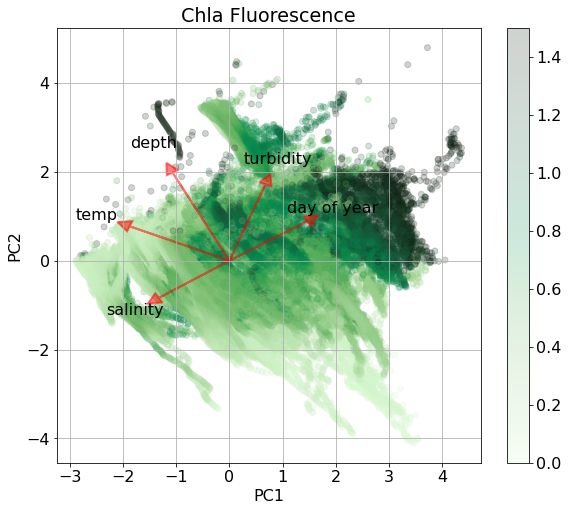

In [311]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

profiles_sub = profiles#[profiles['salinity (PSU)'] > 35.8]

X = profiles_sub[['temp (C)','salinity (PSU)','depth (dBars)', 'turbidity_clean', 'doy']]

#In general it is a good idea to scale the data
scaler = StandardScaler()
scaler.fit(X)
X=scaler.transform(X)

pca = PCA()
pca.fit(X)
x_new = pca.transform(X)   

labels = ['temp','salinity','depth', 'turbidity', 'day of year']

def myplot(score,coeff,ax,labels,j):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]

#     plt.scatter(xs ,ys, c = y,cmap='jet',alpha=.01,vmin=-80,vmax=0)#vmin=1.,vmax=1.5,alpha=0.1) #without scaling
    if j == 0:
#         im = ax.scatter(xs ,ys, color='darkgrey',alpha=0.01)#vmin=1.,vmax=1.5,alpha=0.1) #without scaling
#         im = ax.scatter(xs ,ys, c = (profiles['salinity (PSU)'] > profiles['gs_sal_thresh']).astype(int),cmap='bwr',alpha=.01) #without scaling
        im = ax.scatter(xs ,ys, c=profiles_sub['salinity (PSU)'],cmap=cmocean.cm.haline,alpha=.1,vmin=35,vmax=36.5) #without scaling
        ax.set_title('Sal')
    if j == 1:
        im = ax.scatter(xs ,ys, c=profiles_sub['temp (C)'],cmap=cmocean.cm.thermal,alpha=.1) #without scaling
        ax.set_title('Temp')
        
    if j == 2:
        im = ax.scatter(xs ,ys, c = profiles_sub['potential density (kg/m^3 -1000)'],cmap=cmocean.cm.dense,alpha=.2,vmin=21.2,vmax=27) #without scaling
        ax.set_title('Density')
        
    elif j == 3:
        im = ax.scatter(xs ,ys, c=profiles_sub['depth (dBars)'],cmap='cividis_r',alpha=.1,vmin=-80,vmax=0) #without scaling
        ax.set_title('Depth')
        
    elif j == 4:
        im = ax.scatter(xs ,ys, c = profiles_sub['turbidity_clean'],cmap=cmocean.cm.turbid,alpha=.2,vmin=1.,vmax=1.8) #without scaling
        ax.set_title('Turbidity')
    elif j == 5:
        im = ax.scatter(xs ,ys, c = profiles_sub['chla_clean'],cmap=cmocean.cm.algae,alpha=.2,vmin=0.,vmax=1.5) #without scaling
        ax.set_title('Chla Fluorescence')
    elif j == 6:
        im = ax.scatter(xs ,ys, c = profiles_sub['ekbackscatter'],cmap='jet',alpha=.2,vmin=98,vmax=112) #without scaling
        ax.set_title('EK Backscatter')
        
    fig.colorbar(im,ax=ax)
    
    for i in range(n):
        ax.arrow(0, 0, coeff[i,0]*3, coeff[i,1]*3,color = 'r',alpha = 0.5, lw=2, head_width=.25,head_length=.25)
        if labels is None:
            ax.text(coeff[i,0]* 6, coeff[i,1] * 6, "Var"+str(i+1), color = 'g', ha = 'center', va = 'center')
        else:
            ax.text(coeff[i,0]* 4, coeff[i,1] * 4, labels[i], color = 'black', ha = 'center', va = 'center')

fig, ax = plt.subplots(1,1,figsize=(9.5,8))

for i,ax in enumerate([ax]):
    ax.set_xlabel("PC{}".format(1))
    ax.set_ylabel("PC{}".format(2))
    ax.grid()
#     ax.set_xlim(-3,5)
#     ax.set_ylim(-3,5)

    #Call the function. 
    myplot(x_new[:,0:2], pca.components_.T,ax=ax, labels=labels,j=5) 
# fig.savefig('pca_profiles.png',dpi=300)
plt.show()

In [308]:
pca.explained_variance_ratio_

array([0.47872515, 0.27295124, 0.18208833, 0.06623527])

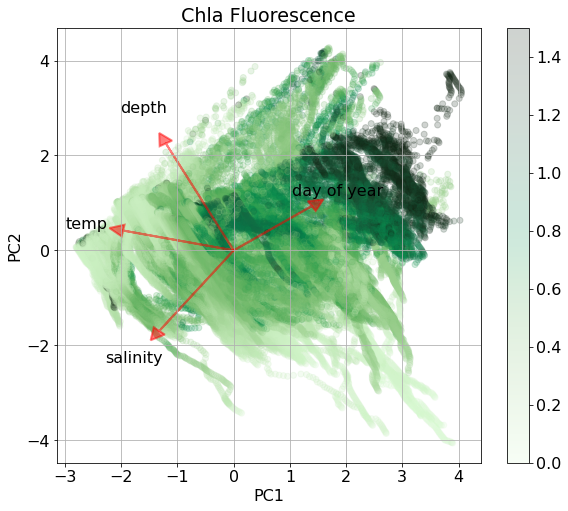

In [310]:
fig, ax = plt.subplots(1,1,figsize=(9.5,8))

for i,ax in enumerate([ax]):
    ax.set_xlabel("PC{}".format(1))
    ax.set_ylabel("PC{}".format(2))
    ax.grid()
#     ax.set_xlim(-3,5)
#     ax.set_ylim(-3,5)

    #Call the function. 
    myplot(x_new[:,0:2], pca.components_.T,ax=ax, labels=labels,j=5) 
fig.savefig('pca_profiles.png',dpi=300)
plt.show()

In [ ]:
single_front_locations = [f[0] for f in front_locations]

now plot all the transects where the calculated front is 0 and the hot side is - and the cold side is +

In [114]:
front_transects

[4, 5, 6, 7, 8, 9]

In [117]:
dist_list = []
front_location_list = []
sst_list = []
current_list = []
echo_list = []
interp_sst_list = []
interp_current_list = []
interp_echo_list = []

sal_front_list = []

vmp_sal_list = []
vmp_temp_list = []
vmp_chla_list = []
vmp_dt_list = []
vmp_dist_list = []


grid_spacing = 20

counter = 0

for idx,fn in enumerate(filenames):
    if idx in [0,1,2,3]:
        continue
    if idx not in tentative_good_idxs:#front_transects:
        continue
    try:
        ##########
        
        dist = scipy.io.loadmat(fn+'_distance.mat')['distance']
        sst = scipy.io.loadmat(fn+'_SST.mat')['SST']
        time = scipy.io.loadmat(fn+'_time.mat')['time']
        timestamps = pd.to_datetime(time[0,:]-719529, unit='D')
       
        
#         if idx in [5,28,39,40,41]:
#             dist = (dist - dist[-1])*-1
        
        X = scipy.io.loadmat(fn+'_X.mat')['X']
        Y = scipy.io.loadmat(fn+'_Y.mat')['Y']
        vMag = scipy.io.loadmat(fn+'_vmag.mat')['C']

        vDir = scipy.io.loadmat(fn+'_vdir.mat')['C']
        
        vShear = scipy.io.loadmat(fn+'_vshear.mat')['C']
        
        echo = scipy.io.loadmat(fn+'_echo.mat')['C']
        Xecho = scipy.io.loadmat(fn+'_Xecho.mat')['X']
        Yecho = scipy.io.loadmat(fn+'_Yecho.mat')['Y']
        
        # correcting for the smaller bin size
        Yecho = (Yecho*0.502)-1
        
        lat = scipy.io.loadmat(fn+'_lat.mat')['lat']
        long = scipy.io.loadmat(fn+'_long.mat')['long']
        
        # the distances are crazy wrong sometimes so re-calcuating the distance
        coords_1 = (lat[0], long[0])
        distances = []
        for i in range(len(lat)):
            coords_2 = (lat[i], long[i])
            distances.append(distance.geodesic(coords_1, coords_2).meters)
        dist = np.array(distances)       
#         bogus_dist_locations = dist > 35000        
#         dist[dist > 25000] = np.nan
#         dist = pd.Series(dist).interpolate().values
        # checking if the current point is within 500 of one that was good, assuming the first point is good
        # then if not setting it to nan and interpolating it out
        last_good_idx = 0
        bad_idxs = []
        for di,d in enumerate(dist):
            if dist[di] - dist[last_good_idx] < 500:
                last_good_idx = di
            else:
                bad_idxs.append(di)
        dist[bad_idxs] = np.nan
        dist = pd.Series(dist).interpolate().values

        dist = dist.reshape(-1,1)
        
        adcp_df = pd.DataFrame({'dt':timestamps,
                    'datetime':timestamps,
                    'sst':sst[:,0],
                    'lat': lat[:,0],
                    'lon':long[:,0],
                    'dist':dist[:,0]})

        adcp_df = adcp_df.set_index('dt')
        adcp_df = adcp_df.sort_index(ascending=True)
        
        
        ##########
        
        sal_vmp, temp_vmp, chla_vmp, turb_vmp, dt_vmp, dist_vmp = grab_vmp_data(profiles, adcp_df, timestamps[0],timestamps[-1])
            
        vmp_sal_list.append(sal_vmp)
        vmp_temp_list.append(temp_vmp)
        vmp_chla_list.append(chla_vmp)
        vmp_dt_list.append(dt_vmp)
        vmp_dist_list.append(dist_vmp)
        
        ################

        """
        
        if idx in [5,28,39,40,41]:
            dist = (dist - dist[-1])*-1
        

        vMag_reshape = vMag.reshape(-1,69).T
        vDir_reshape = vDir.reshape(-1,69).T
        echo_reshape = echo.reshape(-1,127).T
        echo_top_layer = np.mean(echo_reshape[0:8,:],axis=0)
#         x, y = np.meshgrid(Xecho.reshape(-1,127)[:,0],Yecho[:127,0])    



#         x, y = np.meshgrid(X.reshape(-1,69)[:,0],Y[:69,0])    

        N=180
        current_speed = np.mean(vMag_reshape[0:4,:],axis=0)
        current_speed_smooth = pd.Series(current_speed).rolling(window=N).mean().iloc[N-1:].values
        vgradient = []
        step = 1

        for i in range(len(current_speed)-N):
            du = current_speed_smooth[i] - current_speed_smooth[i+step]
            dx = dist[i] - dist[i+step]
            current_grad = du/dx
            vgradient.append(current_grad)

        dudx = scipy.signal.savgol_filter(current_speed_smooth, window_length=11, polyorder=2, deriv=1)
        # taking off the first 100 points because those are often noisy and never the front
        front_location = np.argmax(np.abs(dudx[100:-30]))+100
        
        current_list.append(current_speed)
        sst_list.append(sst)
        dist_list.append(dist)
        echo_list.append(echo_top_layer)
        
#         dist_centered = dist - dist[front_location]
        dist_centered = dist - single_front_locations[counter]
        counter += 1
        
        sst_reg = np.interp(np.arange(-12000,12000, grid_spacing), dist_centered[:,0], sst[:,0], left=np.nan, right=np.nan, period=None)
        interp_sst_list.append(sst_reg)
        
        current_reg = np.interp(np.arange(-12000,12000, grid_spacing), dist_centered[:,0], current_speed, left=np.nan, right=np.nan, period=None)
        interp_current_list.append(current_reg)
        
        dist_centered_echo = dist_centered[:,0]
        while len(dist_centered_echo) != len(echo_top_layer):
            
            if len(dist_centered_echo) > len(echo_top_layer):
                dist_centered_echo = dist_centered_echo[:-1]
                
            elif len(dist_centered[:,0]) < len(echo_top_layer):
                echo_top_layer = echo_top_layer[:-1]

        
        echo_reg = np.interp(np.arange(-12000,12000, grid_spacing), dist_centered_echo, echo_top_layer, left=np.nan, right=np.nan, period=None)
        interp_echo_list.append(echo_reg)
        """
        
#         print('did one')
    except Exception as e: 
        print(e)



In [118]:
1

1

In [119]:
sal_est = provide_gs_sal_threshold(np.concatenate(vmp_dt_list), buffer=0.25)
gs_water = np.concatenate(vmp_sal_list) > sal_est


temp_est = provide_gs_temp_threshold(np.concatenate(vmp_dt_list), buffer=0.25)
gs_water_temp = np.concatenate(vmp_temp_list) > temp_est

In [120]:
tester = []
for i in range(len(gs_water)):
    if gs_water[i] and not gs_water_temp[i]:
        tester.append(True)
    else:
        tester.append(False)

In [121]:
tester = []
for i in range(len(gs_water)):
    if not gs_water[i] or not gs_water_temp[i]:
        tester.append(False)
    else:
        tester.append(True)

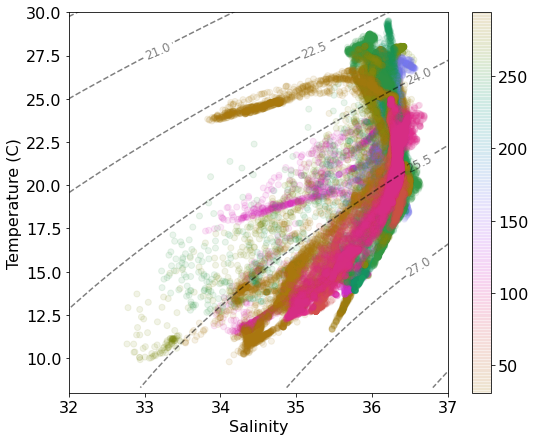

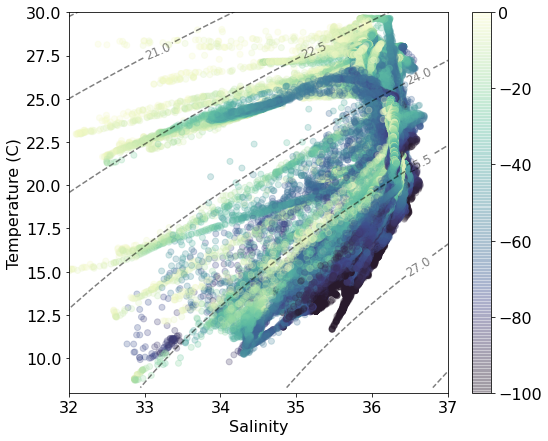

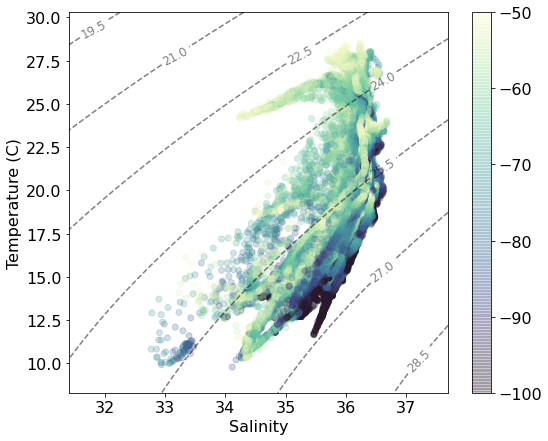

In [124]:
# Figure out boudaries (mins and maxs)
smin = 32-.7
smax = 37+.7
tmin = 8-.7 
tmax = 30+.7

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000
    
# plot T and S diagrams first with distance from coast and then with other variables
fig, ax = plt.subplots(figsize=(8.5,7))
markersize=40

ax.set_xlim(32,37)
ax.set_ylim(8,30)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
# ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                 edgecolor='k', fc='None', ls='--', lw=2)
# ax.add_patch(ellipse)

# im = ax.scatter(np.concatenate(vmp_sal_list), np.concatenate(vmp_temp_list), c=np.concatenate(vmp_chla_list), vmin=-0.5,vmax=0.5,alpha=0.4)#c=np.concatenate(vmp_dt_list), vmin=0,vmax=365, cmap='twilight')

temp_est = provide_gs_temp_threshold(np.concatenate(vmp_dt_list))
sal_est = provide_gs_sal_threshold(np.concatenate(vmp_dt_list))

im = ax.scatter(profiles[profiles['depth (dBars)'] < -35]['salinity (PSU)'], profiles[profiles['depth (dBars)'] < -35]['temp (C)'], c=profiles[profiles['depth (dBars)'] < -35].datetime.dt.day_of_year, cmap=cmocean.cm.phase, alpha=0.1)


fig.colorbar(im)
plt.show()

# plot T and S diagrams first with distance from coast and then with other variables
fig, ax = plt.subplots(figsize=(8.5,7))
markersize=40

ax.set_xlim(32,37)
ax.set_ylim(8,30)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
# ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                 edgecolor='k', fc='None', ls='--', lw=2)
# ax.add_patch(ellipse)

# im = ax.scatter(np.concatenate(vmp_sal_list), np.concatenate(vmp_temp_list), c=np.concatenate(vmp_chla_list), vmin=-0.5,vmax=0.5,alpha=0.4)#c=np.concatenate(vmp_dt_list), vmin=0,vmax=365, cmap='twilight')

temp_est = provide_gs_temp_threshold(np.concatenate(vmp_dt_list))
sal_est = provide_gs_sal_threshold(np.concatenate(vmp_dt_list))

im = ax.scatter(profiles['salinity (PSU)'], profiles['temp (C)'], c=profiles['depth (dBars)'], cmap=cmocean.cm.deep_r, alpha=0.25, vmin=-100,vmax=0)


fig.colorbar(im)
plt.show()

# plot T and S diagrams first with distance from coast and then with other variables
fig, ax = plt.subplots(figsize=(8.5,7))
markersize=40

# ax.set_xlim(32,37)
# ax.set_ylim(8,30)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
# ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                 edgecolor='k', fc='None', ls='--', lw=2)
# ax.add_patch(ellipse)

# im = ax.scatter(np.concatenate(vmp_sal_list), np.concatenate(vmp_temp_list), c=np.concatenate(vmp_chla_list), vmin=-0.5,vmax=0.5,alpha=0.4)#c=np.concatenate(vmp_dt_list), vmin=0,vmax=365, cmap='twilight')

temp_est = provide_gs_temp_threshold(np.concatenate(vmp_dt_list))
sal_est = provide_gs_sal_threshold(np.concatenate(vmp_dt_list))

depth = -50

im = ax.scatter(profiles[profiles['depth (dBars)'] < depth]['salinity (PSU)'], profiles[profiles['depth (dBars)'] < depth]['temp (C)'], c=profiles[profiles['depth (dBars)'] < depth]['depth (dBars)'], cmap=cmocean.cm.deep_r, alpha=0.25, vmin=-100,vmax=depth)


fig.colorbar(im)
plt.show()

In [125]:
markers = []
for i in gs_water.astype(np.int):
    if i == 0:
        markers.append('^')
    else:
        markers.append('o')

In [122]:
profiles[profiles['depth (dBars)'] > depth]

,time,depth (dBars),temp (C),salinity (PSU),potential density (kg/m^3 -1000),chla (ppb),turbidity (FTU),turb kinetic energy 1 (W/kg),turb kinetic energy 2 (W/kg),transect,profile_num,datetime,chla_clean,turbidity_clean,spice
dt,,,,,,,,,,,,,,,
2020-09-25 14:08:11.798016000,269.589025,-1.279868,27.005920,35.693381,23.240417,-0.071010,1.148043,5.813510e+00,2.107535e+00,t0,t0_1,2020-09-25 14:08:11.798016000,0.228990,1.148043,5.917476
2020-09-25 14:08:13.297920000,269.589043,-1.838014,27.007634,35.711348,23.253448,-0.052498,1.160421,3.770330e-01,2.740992e-01,t0,t0_1,2020-09-25 14:08:13.297920000,0.247502,1.160421,5.931736
2020-09-25 14:08:14.797737600,269.589060,-2.584881,27.018837,35.723427,23.259016,-0.066999,1.148858,7.236467e-04,5.042762e-06,t0,t0_1,2020-09-25 14:08:14.797737600,0.233001,1.148858,5.944421
2020-09-25 14:08:16.297641600,269.589078,-3.274835,27.074038,35.770693,23.276987,-0.090413,1.128543,2.886891e-07,2.077802e-07,t0,t0_1,2020-09-25 14:08:16.297641600,0.209587,1.128543,5.997582
2020-09-25 14:08:17.797545600,269.589095,-4.003032,27.134213,35.804298,23.283052,-0.099024,1.124643,5.034633e-07,4.873770e-07,t0,t0_1,2020-09-25 14:08:17.797545600,0.200976,1.124643,6.041861
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-04-05 19:58:07.642819200,95.832033,-8.662894,21.337096,36.312072,25.402264,0.108846,1.076798,5.158953e-08,5.603718e-08,t53,t53_10,2022-04-05 19:58:07.642819200,0.408846,1.076798,4.731076
2022-04-05 19:58:09.142723200,95.832050,-10.186223,21.337406,36.312396,25.402506,0.100346,1.072616,7.719458e-08,6.502808e-08,t53,t53_10,2022-04-05 19:58:09.142723200,0.400346,1.072616,4.731405
2022-04-05 19:58:10.642540800,95.832068,-11.551718,21.338266,36.312406,25.402349,0.102415,1.073002,5.822456e-08,5.108776e-08,t53,t53_10,2022-04-05 19:58:10.642540800,0.402415,1.073002,4.731649


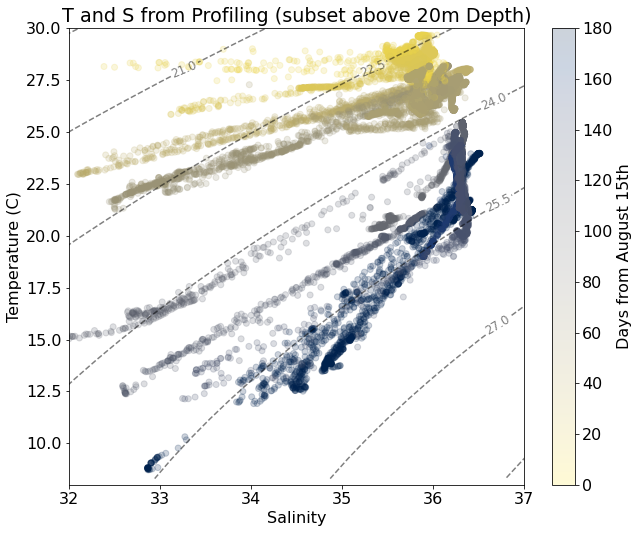

In [130]:
# Figure out boudaries (mins and maxs)
smin = 32-.7
smax = 37+.7
tmin = 8-.7 
tmax = 30+.7

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000

fig, ax = plt.subplots(figsize=(8.5*1.2,7*1.2))
markersize=40

ax.set_xlim(32,37)
ax.set_ylim(8,30)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level

depth=-20



im = ax.scatter(profiles[profiles['depth (dBars)'] > depth]['salinity (PSU)'], profiles[profiles['depth (dBars)'] > depth]['temp (C)'], c=abs(profiles[profiles['depth (dBars)'] > depth].datetime.dt.dayofyear-225), alpha=0.2, cmap='cividis_r',vmin=0,vmax=180)

fig.colorbar(im, label='Days from August 15th')
ax.set_title("T and S from Profiling (subset above 20m Depth)")
fig.savefig('ts_diagram_allprofiles_above20m_DOY.png',dpi=300)

Text(0.5, 1.0, 'Raw S and T')

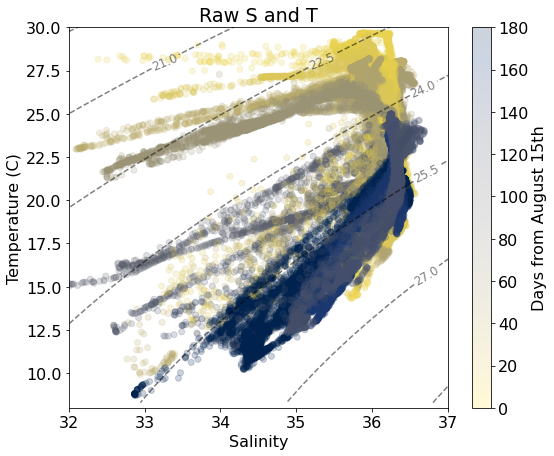

In [125]:
# Figure out boudaries (mins and maxs)
smin = 32-.7
smax = 37+.7
tmin = 8-.7 
tmax = 30+.7

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000

fig, ax = plt.subplots(figsize=(8.5,7))
markersize=40

ax.set_xlim(32,37)
ax.set_ylim(8,30)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level

depth=-80



im = ax.scatter(profiles[profiles['depth (dBars)'] > depth]['salinity (PSU)'], profiles[profiles['depth (dBars)'] > depth]['temp (C)'], c=abs(profiles[profiles['depth (dBars)'] > depth].datetime.dt.dayofyear-225), alpha=0.2, cmap='cividis_r',vmin=0,vmax=180)

fig.colorbar(im, label='Days from August 15th')
ax.set_title("Raw S and T")
# fig.savefig('ts_diagram_allprofiles_DOY.png',dpi=300)

(array([13846.,  3363., 13070.,  3763.,     0.,  5411.,  8914.,  9940.,
            0.,  7086.]),
 array([ 13. ,  31.1,  49.2,  67.3,  85.4, 103.5, 121.6, 139.7, 157.8,
        175.9, 194. ]),
 <BarContainer object of 10 artists>)

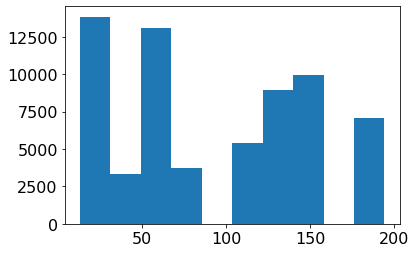

In [118]:
plt.hist(abs(profiles.datetime.dt.dayofyear-225))

Text(0.5, 1.0, 'Raw S and T')

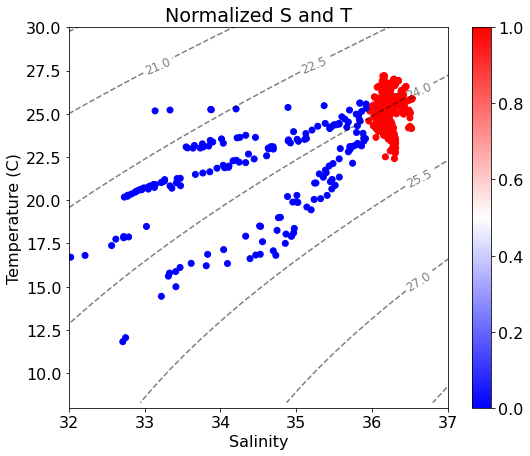

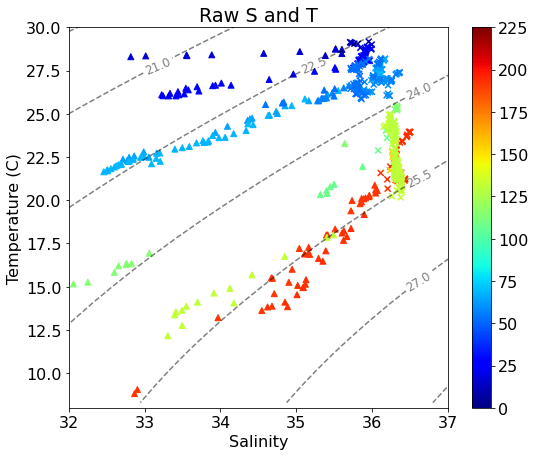

In [126]:
# Figure out boudaries (mins and maxs)
smin = 32-.7
smax = 37+.7
tmin = 8-.7 
tmax = 30+.7

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000


    
# plot T and S diagrams first with distance from coast and then with other variables
fig, ax = plt.subplots(figsize=(8.5,7))
markersize=40

ax.set_xlim(32,37)
ax.set_ylim(8,30)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
# ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                 edgecolor='k', fc='None', ls='--', lw=2)
# ax.add_patch(ellipse)

# im = ax.scatter(np.concatenate(vmp_sal_list), np.concatenate(vmp_temp_list), c=np.concatenate(vmp_chla_list), vmin=-0.5,vmax=0.5,alpha=0.4)#c=np.concatenate(vmp_dt_list), vmin=0,vmax=365, cmap='twilight')

temp_est = provide_gs_temp_threshold(np.concatenate(vmp_dt_list))
sal_est = provide_gs_sal_threshold(np.concatenate(vmp_dt_list))

im = ax.scatter(np.concatenate(vmp_sal_list)-(sal_est-annual_sal_mean), np.concatenate(vmp_temp_list)-(temp_est-annual_temp_mean),c=gs_water.astype(np.int), cmap='bwr',)


fig.colorbar(im)
ax.set_title("Normalized S and T")
# fig.savefig('normed_ts_diagram_allprofiles.png',dpi=300)
    
# ax.legend()
# fig.savefig('figs/simple_t_s_diagram_all_transects_with_divisions.png',dpi=300)

# plot T and S diagrams first with distance from coast and then with other variables
fig, ax = plt.subplots(figsize=(8.5,7))
markersize=40

ax.set_xlim(32,37)
ax.set_ylim(8,30)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
# ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                 edgecolor='k', fc='None', ls='--', lw=2)
# ax.add_patch(ellipse)

# im = ax.scatter(np.concatenate(vmp_sal_list), np.concatenate(vmp_temp_list), c=abs(np.concatenate(vmp_dt_list)-225), vmin=0,vmax=225, cmap=cmocean.cm.ice,alpha=0.4)
im = ax.scatter(np.concatenate(vmp_sal_list)[gs_water.astype(np.int) ==1], np.concatenate(vmp_temp_list)[gs_water.astype(np.int) ==1], c=abs(np.concatenate(vmp_dt_list)-225)[gs_water.astype(np.int) ==1], cmap='jet', marker='x',vmin=0,vmax=225)
im = ax.scatter(np.concatenate(vmp_sal_list)[gs_water.astype(np.int) ==0], np.concatenate(vmp_temp_list)[gs_water.astype(np.int) ==0], c=abs(np.concatenate(vmp_dt_list)-225)[gs_water.astype(np.int) ==0], cmap='jet', marker='^',vmin=0,vmax=225)
fig.colorbar(im)
ax.set_title("Raw S and T")
# fig.savefig('ts_diagram_allprofiles_DOY.png',dpi=300)
    
